# Dependencies

In [1]:
# basic
import pandas as pd
import numpy as np
import os
import math
import itertools
import random
import openpyxl
from IPython.display import clear_output
import gc

# visualization
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_theme()

# model
import tensorflow as tf

2024-12-16 17:35:14.938621: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-12-16 17:35:15.449068: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-16 17:35:15.609426: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-16 17:35:15.654610: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-16 17:35:16.027994: I tensorflow/core/platform/cpu_feature_guar

In [2]:
# GPU validation
tf.config.list_physical_devices('GPU')

I0000 00:00:1734366924.068576     746 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1734366924.474657     746 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1734366924.474828     746 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.


[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [3]:
# data path
data_folder = 'data'
experiment_folder = 'experiment'
archive_folder = 'archive'

# research question
forecast_horizons = [1, 5, 10]

# helper variables
k = 5
window_sizes = [20, 40, 60]
batch_size = 32
shuffle_buffer = 1000

# bilstm_hyperparameters
bilstm_hyperparameters = {
    'window_size': window_sizes,
    'lstm_0_nodes': (4, 16, 32),
    'lstm_1_nodes': (0, 4, 16, 32),
    'perceptron_0_nodes': (4, 16, 32),
    'perceptron_1_nodes': (0, 4, 16, 32),
    'perceptron_2_nodes': (0, 4, 16, 32),
    'dropout_rate': np.arange(.0, .5, .2),
    'learning_rate': np.arange(5e-4, 2.5e-3, 5e-4),
}

# cnn_bilstm_hyperparameters
cnn_bilstm_hyperparameters = {
    'window_size': window_sizes,
    'conv_0_filters': (16, 32, 64),
    'conv_1_filters': (0, 16, 32, 64),
    'lstm_0_nodes': (8, 16, 32),
    'lstm_1_nodes': (0, 8, 16, 32),
    'perceptron_0_nodes': (4, 16, 32),
    'perceptron_1_nodes': (0, 8, 16, 32),
    'perceptron_2_nodes': (0, 8, 16, 32),
    'dropout_rate_0': np.arange(.0, .3, .2),
    'dropout_rate_1': np.arange(.0, .3, .2),
    'learning_rate': np.arange(5e-4, 2.5e-3, 5e-4),
}

In [4]:
def min_max_scaling(vector):
    # get minimum and maximum value of a vector
    min_val = np.min(vector)
    max_val = np.max(vector)

    # return min max scaled vector
    return 2 * (vector - min_val) / (max_val - min_val) - 1


def plot_series(
    time,
    series,
    legend=None,
    format='-',
    start=0,
    end=None,
    xlabel='time',
    ylabel='value'
):
    # set plot image size
    plt.figure(figsize=(10, 6))

    # draw plot by data
    plt.plot(time[start:end], series[start:end], format)
    if legend:
        plt.legend(legend)

    # show plot
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.grid(True)
    plt.show()


def create_window_dataset(
    series,
    window_size,
    forecast_horizon,
    label_col_num=None,
    batch_size=None,
    shuffle_buffer=None,
):
    # create tf.data.Dataset
    dataset = tf.data.Dataset.from_tensor_slices(tf.cast(series, dtype=tf.float32))
    # dataset = tf.data.Dataset.from_tensor_slices(series)

    # create windowed dataset with size "window_size" on each window, ~
    dataset = dataset.window(size=window_size+forecast_horizon, shift=1, drop_remainder=True)
    dataset = dataset.flat_map(lambda window: window.batch(window_size+forecast_horizon))
    if label_col_num or label_col_num == 0:
        dataset = dataset.map(lambda window: (window[:-forecast_horizon], window[window_size+forecast_horizon-1][label_col_num]))
    else:
        dataset = dataset.map(lambda window: (window[:-forecast_horizon], window[window_size+forecast_horizon-1]))

    # shuffle data
    if shuffle_buffer:
        dataset = dataset.shuffle(shuffle_buffer)

    # batching data
    if batch_size:
        dataset = dataset.batch(batch_size).prefetch(1)
    return dataset

# Data

## Create Time Series Data

In [5]:
issuer_series = pd.read_csv(f'{data_folder}/SP100_vol.csv').drop(columns=['Date']).astype(np.float32)
series = issuer_series.mean(axis=1).values
date_series = pd.read_excel(f'{data_folder}/SP100_vol_v2.xlsx')['Date'].values.astype(np.datetime64)
time = np.array(range(len(series)))

# preview
issuer_series.shape, series.shape, date_series.shape, time.shape

((3409, 80), (3409,), (3409,), (3409,))

In [6]:
issuer_series

,AMT,COP,CVX,AXP,BAC,C,CB,CME,GS,JPM,...,TMO,UNH,AMZN,HD,LOW,MCD,NKE,SBUX,TGT,TJX
0,0.014124,0.018373,0.015768,0.012207,0.010291,0.015468,0.009848,0.014583,0.017107,0.013571,...,0.015377,0.013590,0.014877,0.011604,0.014249,0.008126,0.020990,0.012522,0.011658,0.013830
1,0.015762,0.011954,0.011587,0.010778,0.011098,0.013562,0.009857,0.010666,0.014501,0.012888,...,0.011744,0.010659,0.017926,0.009785,0.010404,0.010648,0.015595,0.014401,0.009406,0.012848
2,0.011944,0.014456,0.012986,0.013216,0.008582,0.012972,0.010098,0.012094,0.014643,0.013615,...,0.011072,0.015759,0.011421,0.014842,0.012574,0.011361,0.017018,0.014760,0.008964,0.013771
3,0.009732,0.009799,0.008922,0.009994,0.006183,0.010277,0.006879,0.009909,0.010316,0.008367,...,0.009402,0.008731,0.012612,0.008851,0.007254,0.007875,0.012682,0.011086,0.009220,0.010368
4,0.009956,0.007930,0.007381,0.009133,0.005680,0.007148,0.009542,0.018029,0.009381,0.007802,...,0.009832,0.008183,0.010760,0.009840,0.010354,0.007864,0.010880,0.008781,0.020747,0.011182
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3404,0.006349,0.010963,0.006880,0.007507,0.012272,0.019550,0.007040,0.006024,0.015654,0.010464,...,0.009770,0.013539,0.010484,0.007338,0.006136,0.005391,0.018297,0.005209,0.006616,0.008645
3405,0.008776,0.018038,0.012947,0.014339,0.010546,0.013108,0.009938,0.008899,0.011543,0.009955,...,0.010619,0.009661,0.009743,0.007075,0.009141,0.006245,0.012633,0.007014,0.007333,0.010913
3406,0.007403,0.011434,0.007970,0.011743,0.011523,0.017186,0.009358,0.006418,0.013003,0.009750,...,0.010261,0.006383,0.008275,0.007527,0.007726,0.005798,0.011669,0.007223,0.006017,0.007140
3407,0.009256,0.013957,0.008376,0.009618,0.010790,0.011719,0.008247,0.009674,0.011896,0.010676,...,0.008097,0.007982,0.008298,0.006309,0.005239,0.005146,0.008847,0.005776,0.008158,0.007456


In [7]:
date_series

array(['2007-06-27T00:00:00.000000000', '2007-06-28T00:00:00.000000000',
       '2007-06-29T00:00:00.000000000', ...,
       '2021-06-29T00:00:00.000000000', '2021-06-30T00:00:00.000000000',
       '2021-07-01T00:00:00.000000000'], dtype='datetime64[ns]')

In [8]:
series

array([0.01294014, 0.01229355, 0.01257047, ..., 0.00858375, 0.00831174,
       0.00818002], dtype=float32)

In [9]:
time

array([   0,    1,    2, ..., 3406, 3407, 3408])

## Plotting Time Series Data

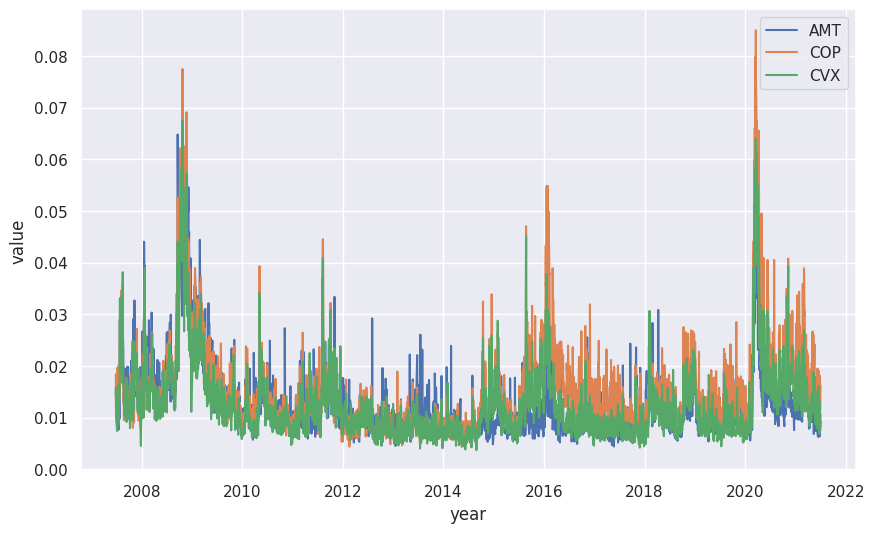

In [10]:
legend = ['AMT', 'COP', 'CVX']

# plot series
plot_series(
    time=date_series,
    series=issuer_series[legend],
    legend=legend,
    format='-',
    start=0,
    end=None,
    xlabel='year',
)

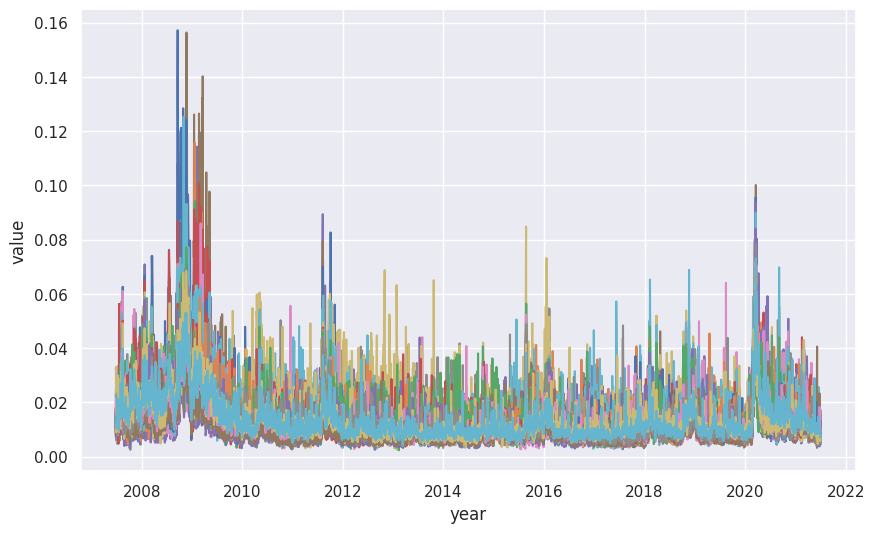

In [11]:
# plot series
plot_series(
    time=date_series,
    series=issuer_series,
    format='-',
    start=0,
    end=None,
    xlabel='year',
)

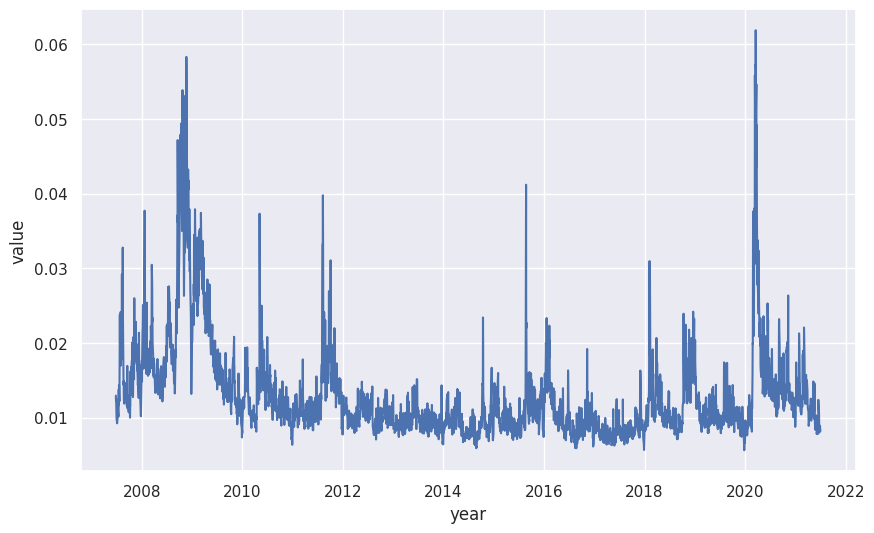

In [12]:
# plot series
plot_series(
    time=date_series,
    series=series,
    format='-',
    start=0,
    end=None,
    xlabel='year',
)

## Create Data Folds (80:20)

In [13]:
num_data = len(series)
fold_size = math.ceil(num_data / k)

for i in range(k):

    # search for first and last index for each fold
    if i+1 == k:
        first_idx = i * fold_size
        last_idx = num_data
    else:
        first_idx = i * fold_size
        last_idx = (i+1) * fold_size

    # preview
    print(i, ' | ', first_idx, last_idx)

    # capture test and train(rest) indices
    test_indices = np.arange(first_idx, last_idx)
    mask = np.ones(len(series), dtype=bool)
    mask[test_indices] = False
    
    # # save each test data fold
    # np.save(f'{data_folder}/fold/test_{i}.npy', series[test_indices])
    # np.save(f'{data_folder}/fold/test_date_{i}.npy', date_series[test_indices])
    # np.save(f'{data_folder}/fold/test_time_{i}.npy', time[test_indices])

    # # save each train data fold
    # np.save(f'{data_folder}/fold/train_{i}.npy', series[mask])
    # np.save(f'{data_folder}/fold/train_date_{i}.npy', date_series[mask])
    # np.save(f'{data_folder}/fold/train_time_{i}.npy', time[mask])

0  |  0 682
1  |  682 1364
2  |  1364 2046
3  |  2046 2728
4  |  2728 3409


In [14]:
# load preview
np.load(f'{data_folder}/fold/train_{1}.npy')

array([0.01294014, 0.01229355, 0.01257047, ..., 0.00858375, 0.00831174,
       0.00818002], dtype=float32)

## Create Data Folds (60:40)

In [15]:
num_data = len(series)
fold_size = math.ceil(num_data / k)

for i in range(k):
    if i+1 == k:
        break

    # search for first and last index for each fold
    if i+1 == k:
        first_idx_1 = i * fold_size
        last_idx_1 = num_data
    else:
        first_idx_1 = i * fold_size
        last_idx_1 = (i+1) * fold_size

    # search for first and last index for each fold
    if (i+1)+1 == k:
        first_idx_2 = (i+1) * fold_size
        last_idx_2 = num_data
    else:
        first_idx_2 = (i+1) * fold_size
        last_idx_2 = ((i+1)+1) * fold_size

    # preview
    print(i, i+1, ' | ', first_idx_1, last_idx_1, first_idx_2, last_idx_2)

    # capture test and train(rest) indices
    test_indices = np.concatenate([
        np.arange(first_idx_1, last_idx_1),
        np.arange(first_idx_2, last_idx_2)
    ])
    mask = np.ones(len(series), dtype=bool)
    mask[test_indices] = False
    
    # # save each test fold
    # np.save(f'{data_folder}/60:40_fold/test_{i}.npy', series[test_indices])
    # np.save(f'{data_folder}/60:40_fold/test_date_{i}.npy', date_series[test_indices])
    # np.save(f'{data_folder}/60:40_fold/test_time_{i}.npy', time[test_indices])

    # # save each train fold
    # np.save(f'{data_folder}/60:40_fold/train_{i}.npy', series[mask])
    # np.save(f'{data_folder}/60:40_fold/train_date_{i}.npy', date_series[mask])
    # np.save(f'{data_folder}/60:40_fold/train_time_{i}.npy', time[mask])

0 1  |  0 682 682 1364
1 2  |  682 1364 1364 2046
2 3  |  1364 2046 2046 2728
3 4  |  2046 2728 2728 3409


## Create Date Folds (50% 80:20)

In [16]:
issuer_series_50 = issuer_series[math.ceil(len(issuer_series)/2):].reset_index(drop=True).copy()
series_50 = series[math.ceil(len(series)/2):]
date_series_50 = date_series[math.ceil(len(date_series)/2):]
time_50 = np.arange(0, len(series_50))

# preview
issuer_series_50.shape, series_50.shape, date_series_50.shape, time_50.shape

((1704, 80), (1704,), (1704,), (1704,))

In [17]:
num_data_50 = len(series_50)
fold_size_50 = math.ceil(num_data_50 / k)

for i in range(k):

    # search for first and last index for each fold
    if i+1 == k:
        first_idx_50 = i * fold_size_50
        last_idx_50 = num_data_50
    else:
        first_idx_50 = i * fold_size_50
        last_idx_50 = (i+1) * fold_size_50

    print(i, ' | ', first_idx_50, last_idx_50)

    # capture test and train(rest) indices
    test_indices_50 = np.arange(first_idx_50, last_idx_50)
    mask_50 = np.ones(len(series_50), dtype=bool)
    mask_50[test_indices_50] = False
    
    # # save each test data fold
    # np.save(f'{data_folder}/50%_80:20_fold/test_{i}.npy', series_50[test_indices_50])
    # np.save(f'{data_folder}/50%_80:20_fold/test_date_{i}.npy', date_series_50[test_indices_50])
    # np.save(f'{data_folder}/50%_80:20_fold/test_time_{i}.npy', time_50[test_indices_50])

    # # save each train data fold
    # np.save(f'{data_folder}/50%_80:20_fold/train_{i}.npy', series_50[mask_50])
    # np.save(f'{data_folder}/50%_80:20_fold/train_date_{i}.npy', date_series_50[mask_50])
    # np.save(f'{data_folder}/50%_80:20_fold/train_time_{i}.npy', time_50[mask_50])

0  |  0 341
1  |  341 682
2  |  682 1023
3  |  1023 1364
4  |  1364 1704


# Model

## Helper Functions

In [33]:
def BidirectionalLSTM2D(arch, name):
    # arch input shape: [units_1, units_2, ...]
    # during looping, if the next units == 0 or the next units is the last units, then the current layer will have 'return_sequences=False' and the loop will break
    lstm_sequence = tf.keras.Sequential(name=name)
    for i in range(len(arch)):
        if i == len(arch)-1 or arch[i+1] == 0:
            lstm_sequence.add(tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(arch[i]), name=f'{name}_{i}'))
            break
        else:
            lstm_sequence.add(tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(arch[i], return_sequences=True), name=f'{name}_{i}'))
    return lstm_sequence

def LSTM2D(arch, name):
    # arch input shape: [units_1, units_2, ...]
    # during looping, if the next units == 0 or the next units is the last units, then the current layer will have 'return_sequences=False' and the loop will break
    lstm_sequence = tf.keras.Sequential(name=name)
    for i in range(len(arch)):
        if i == len(arch)-1 or arch[i+1] == 0:
            lstm_sequence.add(tf.keras.layers.LSTM(arch[i], name=f'{name}_{i}'))
            break
        else:
            lstm_sequence.add(tf.keras.layers.LSTM(arch[i], return_sequences=True, name=f'{name}_{i}'))
    return lstm_sequence

def MultilayerPerceptron(arch, name, activation='relu'):
    # arch input shape: [units_1, units_2, ...]
    # during looping if units == 0, then the layer will not be included and the loop will break
    dense_sequence = tf.keras.Sequential(name=name)
    for i in range(len(arch)):
        if arch[i] == 0:
            break
        dense_sequence.add(tf.keras.layers.Dense(arch[i], activation, name=f'{name}_{i}'))
    return dense_sequence

def MultilayerPerceptronWithInput(arch, input_shape, name, activation='relu'):
    # arch input shape: [units_1, units_2, ...]
    # during looping if units == 0, then the layer will not be included and the loop will break
    dense_sequence = tf.keras.Sequential(name=name)
    dense_sequence.add(tf.keras.Input(shape=input_shape))
    for i in range(len(arch)):
        if arch[i] == 0:
            break
        dense_sequence.add(tf.keras.layers.Dense(arch[i], activation, name=f'{name}_{i}'))
    return dense_sequence

def Conv1DMaxPool(arch, name, activation='relu', padding='causal', batch_normalization=False):
    # arch input shape: [[filters_1, kernel_size_1, pool_size_1], [[filters_2, kernel_size_2, pool_size_2]], ...]
    # during looping, if one of filters/kernel_size/pool_size == 0, then the layer will not be included and the loop will break
    conv_sequence = tf.keras.Sequential(name=name)
    for i in range(len(arch)):
        if 0 in arch[i]:
            break
        conv_sequence.add(tf.keras.layers.Conv1D(filters=arch[i][0], kernel_size=arch[i][1], padding=padding, activation=activation, name=f'{name}_conv_{i}'))
        conv_sequence.add(tf.keras.layers.MaxPooling1D(pool_size=arch[i][2], name=f'{name}_maxpool_{i}'))
        if batch_normalization:
            conv_sequence.add(tf.keras.layers.BatchNormalization())
    return conv_sequence

## Bidirectional LSTM

### Architecture

In [34]:
def VolatilityForecast(
    input_shape,
    bilstm,
    mlp,
    dropout_rate,
):
    input = tf.keras.Input(shape=input_shape, name='input')
    x = bilstm(input)
    x = mlp(x)
    x = tf.keras.layers.Dropout(dropout_rate, name='dropout')(x)
    output = tf.keras.layers.Dense(1, name='output')(x)
    model = tf.keras.Model(input, output, name='VolatilityForecast')
    return model

### FH 1

#### Fold 0

##### Test Train & Predict Model (80:20)

In [35]:
# variables
fh = 1
fold = 0

# bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [36]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

I0000 00:00:1733837630.389177    1052 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1733837630.389417    1052 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1733837630.389497    1052 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1733837632.772149    1052 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1733837632.772719    1052 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-12-10

In [37]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │         2,304 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,505 (21.50 KB)

 Trainable params: 5,505 (21.50 KB)

 Non-trainable params: 0 (0.00 B)

In [38]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 14:34:00.692495: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:531] Loaded cuDNN version 8907
2024-12-10 14:34:04.832278: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
2024-12-10 14:34:04.832381: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[StatefulPartitionedCall/gradient_tape/VolatilityForecast_1/bidirectional_lstm_1/bidirectional_lstm_0_1/mod/_19]]
2024-12-10 14:34:04.832431: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15019536124601605555
2024-12-10 14:34:04.832523: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 9877892613854646338
2024-12-10 14:34:04.832557: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous r

In [39]:
# evaluate model
model.evaluate(example_test_ds)

      1/Unknown 0s 348ms/step - loss: 8.7854 - mean_squared_error: 6.5547e-06 - root_mean_squared_error: 0.0026

21/21 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - loss: 9.4372 - mean_squared_error: 8.0643e-06 - root_mean_squared_error: 0.0028


2024-12-10 14:37:12.625273: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 14:37:12.625369: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 14:37:12.625381: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302


[9.690074920654297, 9.40245263336692e-06, 0.003066341858357191]

In [40]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


In [41]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step


In [42]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [43]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model(80:20)

In [44]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

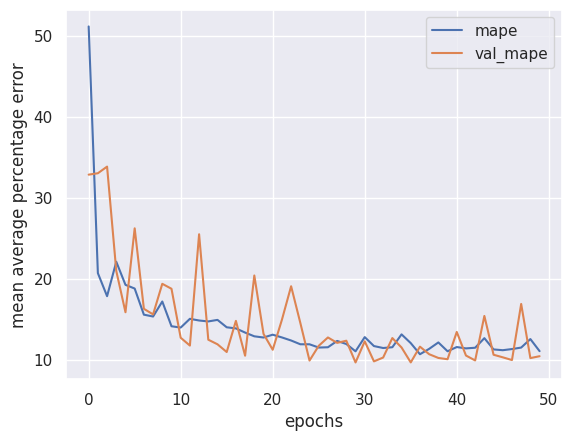

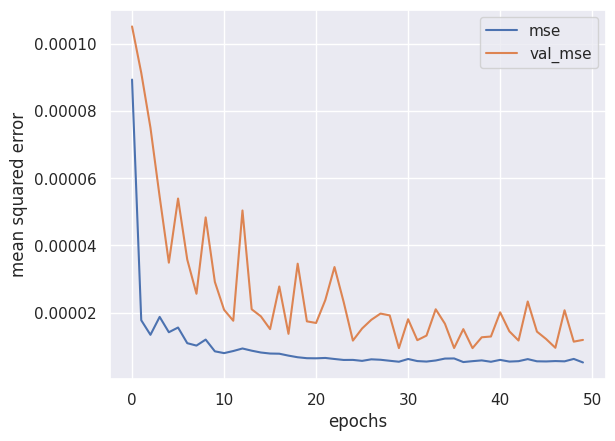

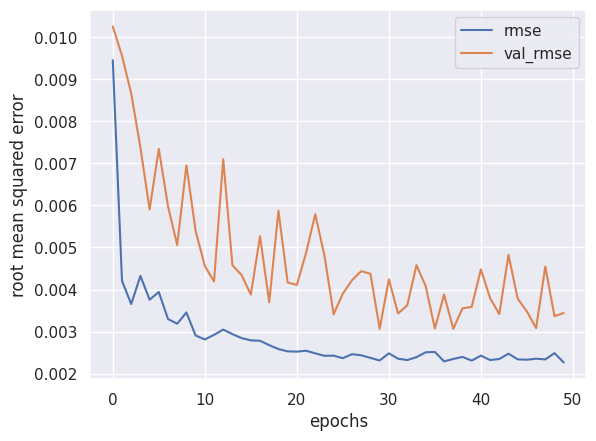

In [45]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

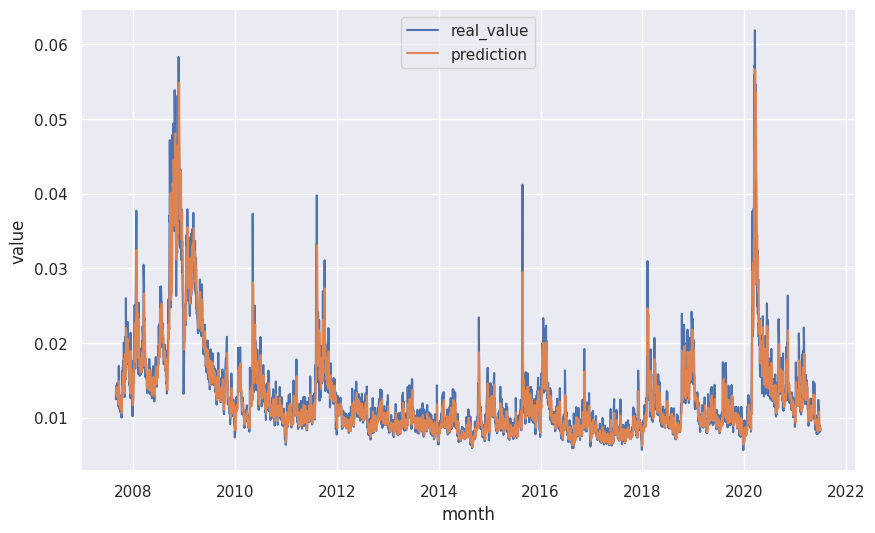

In [46]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

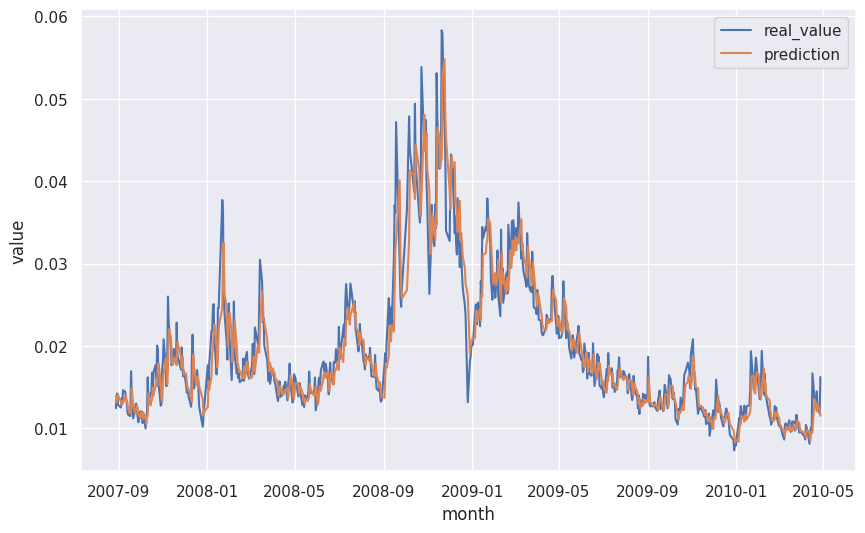

In [47]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (60:40)

In [48]:
# variables
fh = 1
fold = 0

# bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [49]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [50]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │         2,304 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,505 (21.50 KB)

 Trainable params: 5,505 (21.50 KB)

 Non-trainable params: 0 (0.00 B)

In [51]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 14:37:24.766612: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15019536124601605555
2024-12-10 14:37:24.766693: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 9877892613854646338
2024-12-10 14:37:24.766703: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7874542339412371852
2024-12-10 14:37:24.766707: I tensorflow/core/framework/local_rendezvous.cc:427] Local rendezvous send item cancelled. Key hash: 2117965583362554072
2024-12-10 14:37:24.766712: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14019352252734230420
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when b

In [52]:
# evaluate model
model.evaluate(example_test_ds)

42/42 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 9.9216 - mean_squared_error: 6.8951e-06 - root_mean_squared_error: 0.0026


2024-12-10 14:41:55.095345: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 14:41:55.095398: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 14:41:55.095406: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302


[9.827611923217773, 7.488738901884062e-06, 0.0027365561109036207]

In [53]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


In [54]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step


In [55]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv', index=False)

In [56]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (60:40)

In [57]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv')

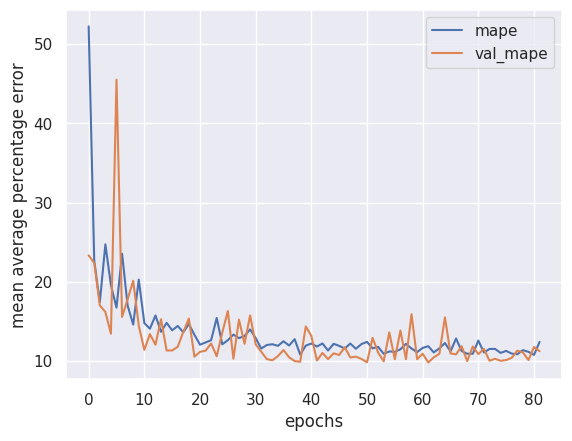

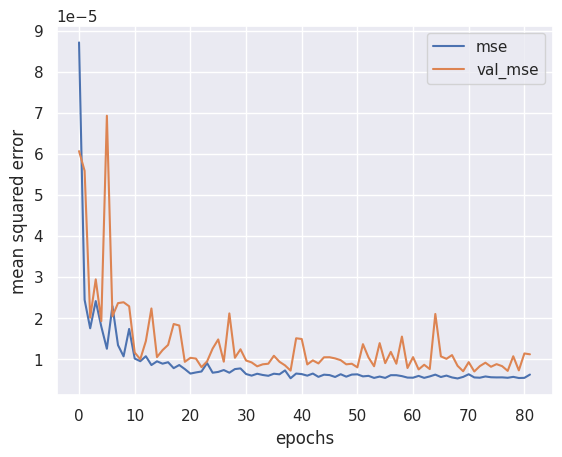

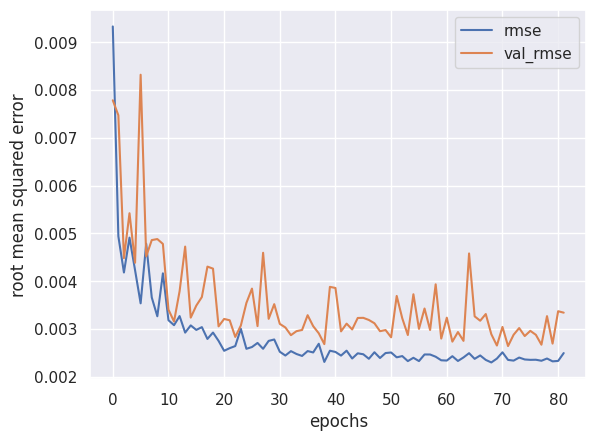

In [58]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

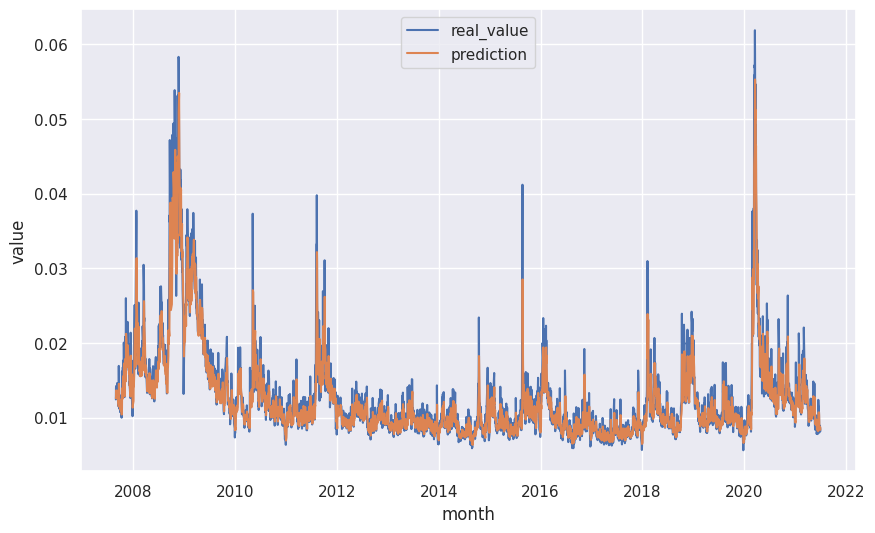

In [59]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

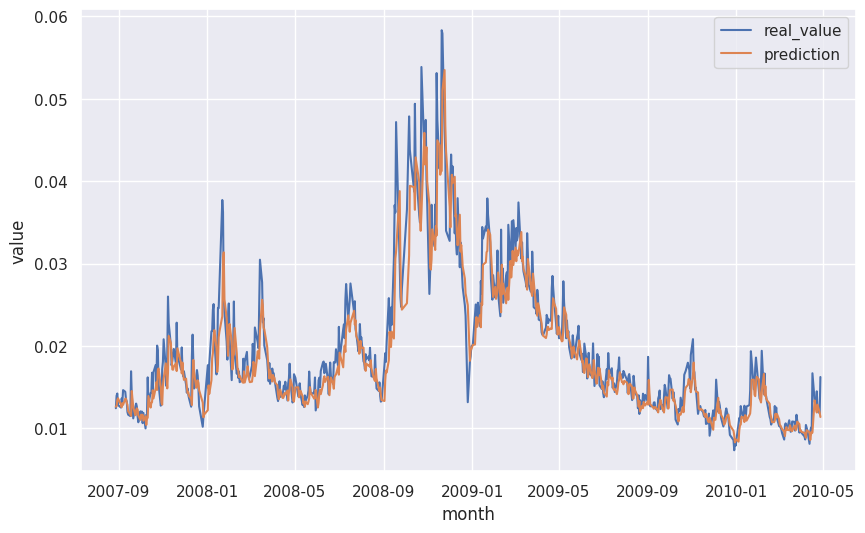

In [60]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [61]:
# variables
fh = 1
fold = 0

# bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [62]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [63]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │         2,304 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,505 (21.50 KB)

 Trainable params: 5,505 (21.50 KB)

 Non-trainable params: 0 (0.00 B)

In [64]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 14:42:06.996991: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15019536124601605555
2024-12-10 14:42:06.997082: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 9877892613854646338
2024-12-10 14:42:06.997091: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7874542339412371852
2024-12-10 14:42:06.997095: I tensorflow/core/framework/local_rendezvous.cc:427] Local rendezvous send item cancelled. Key hash: 2117965583362554072
2024-12-10 14:42:06.997098: I tensorflow/core/framework/local_rendezvous.cc:427] Local r

In [65]:
# evaluate model
model.evaluate(example_test_ds)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 10.6845 - mean_squared_error: 4.6504e-06 - root_mean_squared_error: 0.0021


2024-12-10 14:44:30.409031: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 14:44:30.409091: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 14:44:30.409099: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302


[10.69295597076416, 5.738146683142986e-06, 0.002395442919805646]

In [66]:
# predict using model using all 100% data
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


In [67]:
# predict using model using test data
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


In [68]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [69]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (50% 80:20)

In [70]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

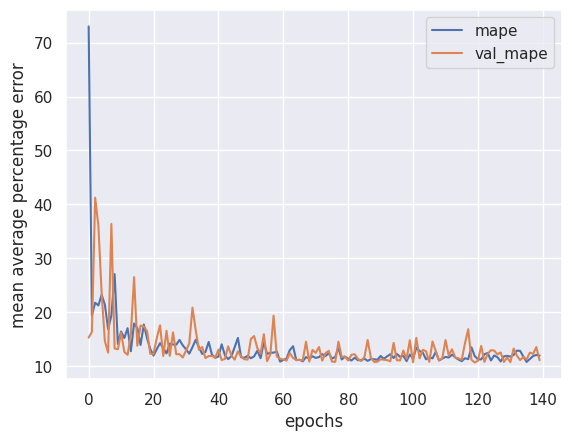

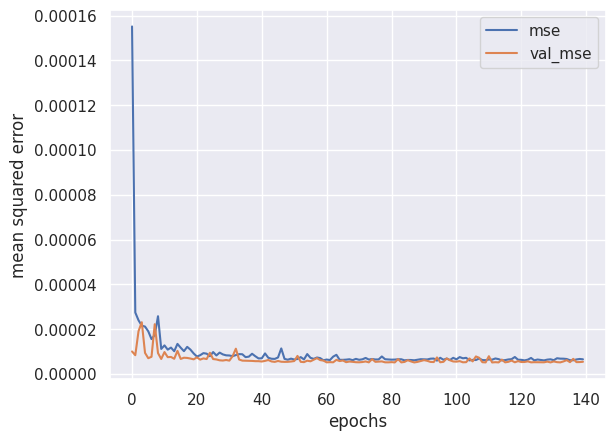

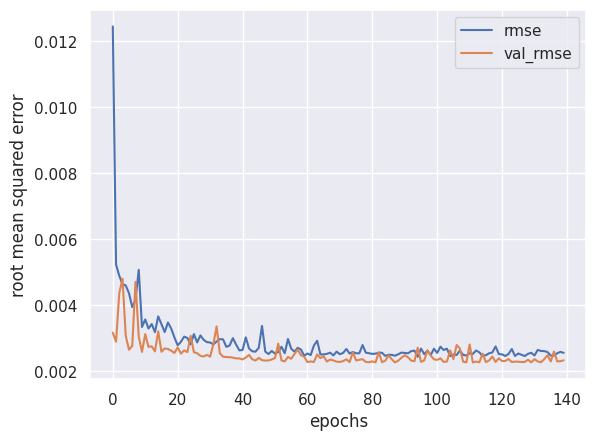

In [71]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

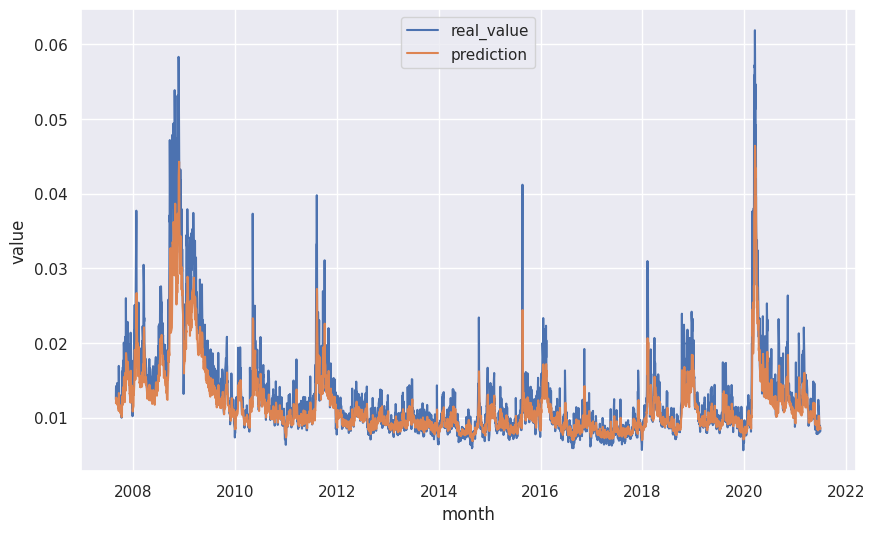

In [72]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

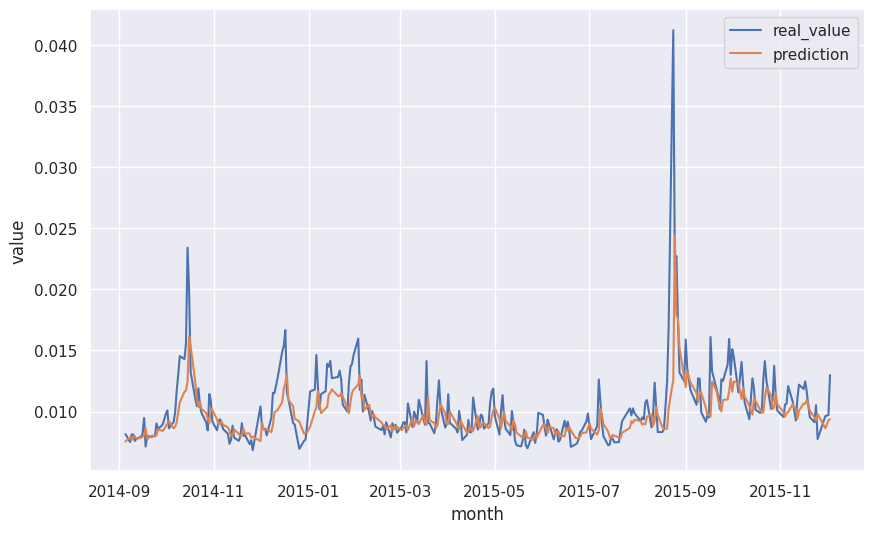

In [73]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Fold 1

##### Test Train & Predict Model (80:20)

In [74]:
# variables
fh = 1
fold = 1

# bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [75]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [76]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │         2,304 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,505 (21.50 KB)

 Trainable params: 5,505 (21.50 KB)

 Non-trainable params: 0 (0.00 B)

In [77]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 14:44:36.354139: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 9877892613854646338
2024-12-10 14:44:36.354182: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7874542339412371852
2024-12-10 14:44:36.354189: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14019352252734230420
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 14:44:36.801494: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 14:44:36.801942: I tensorflow/core/framework/local_rendezvous.cc:423] Local r

In [78]:
# evaluate model
model.evaluate(example_test_ds)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 9.3556 - mean_squared_error: 3.2129e-06 - root_mean_squared_error: 0.0018


2024-12-10 14:46:55.803458: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 14:46:55.803515: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 14:46:55.803524: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302


[9.656705856323242, 3.829685738310218e-06, 0.0019569583237171173]

In [79]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


In [80]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


In [81]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [82]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (80:20)

In [83]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

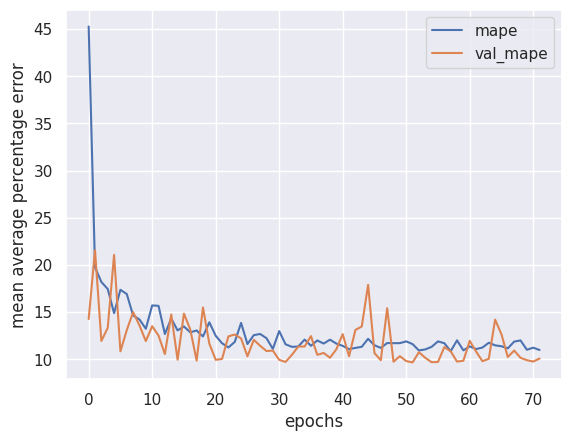

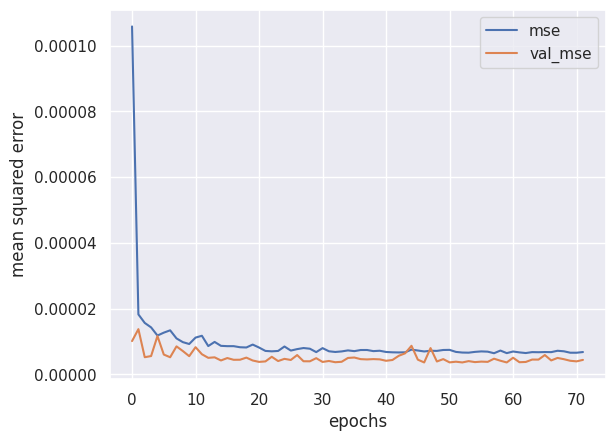

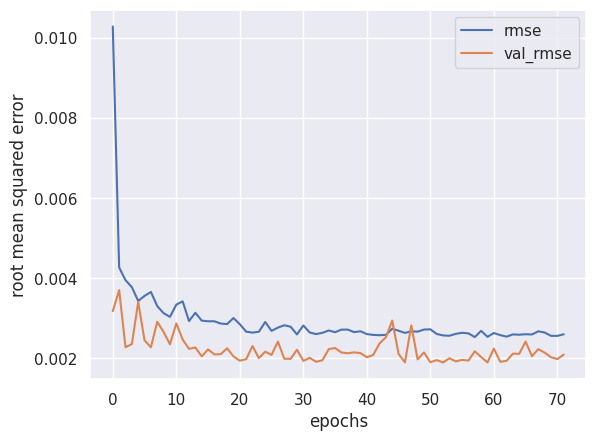

In [84]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

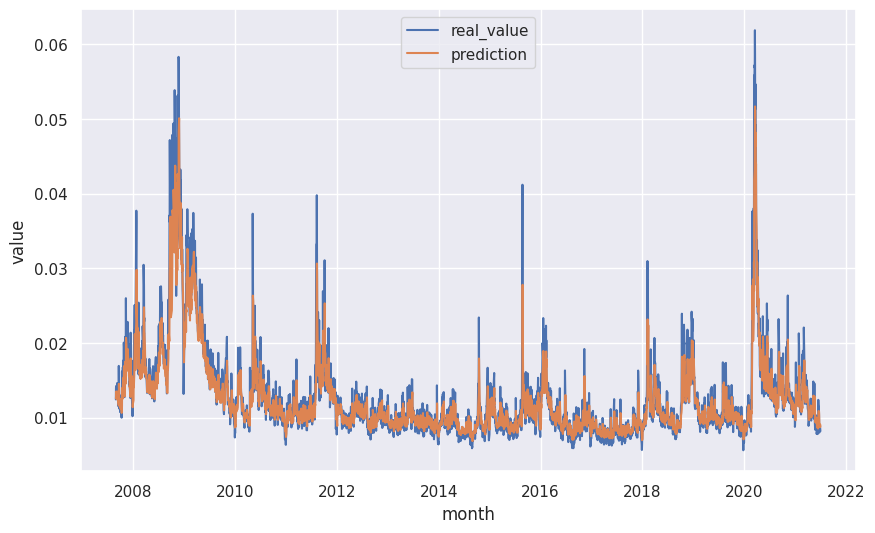

In [85]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

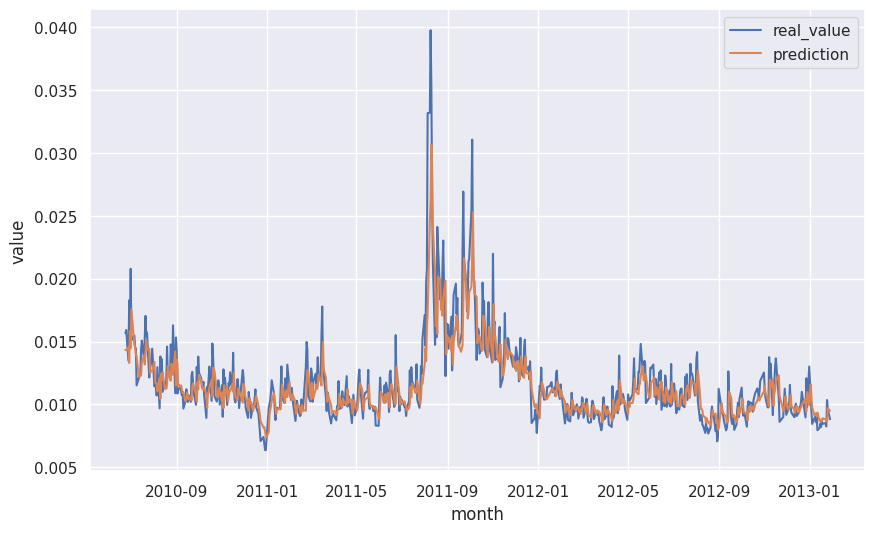

In [86]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (60:40)

In [87]:
# variables
fh = 1
fold = 1

# bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [88]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [89]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │         2,304 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,505 (21.50 KB)

 Trainable params: 5,505 (21.50 KB)

 Non-trainable params: 0 (0.00 B)

In [90]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 14:47:02.261302: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 9877892613854646338
2024-12-10 14:47:02.261368: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14019352252734230420
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 14:47:02.924332: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 14:47:02.924385: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302
2024-12-10 14:47:04.247707: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

In [91]:
# evaluate model
model.evaluate(example_test_ds)

42/42 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 10.0433 - mean_squared_error: 3.0534e-06 - root_mean_squared_error: 0.0017


2024-12-10 14:50:05.552943: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 14:50:05.552992: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 14:50:05.553000: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302


[9.886635780334473, 3.5627481338451616e-06, 0.0018875242676585913]

In [92]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


In [93]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


In [94]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv', index=False)

In [95]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (60:40)

In [96]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv')

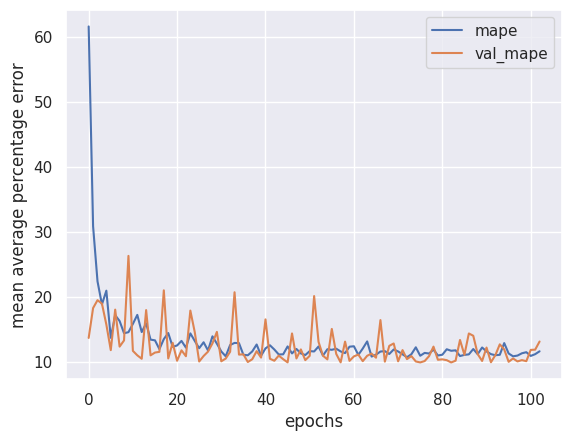

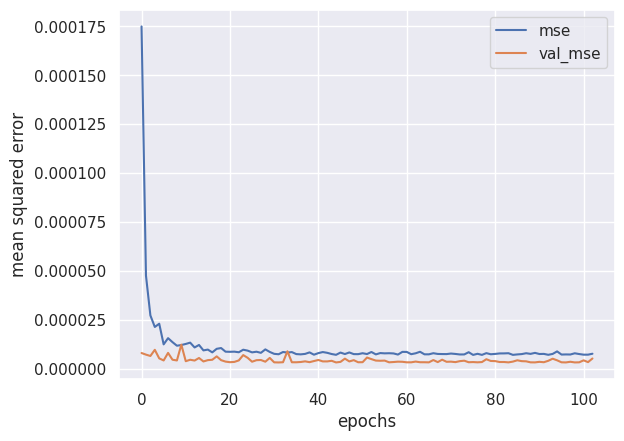

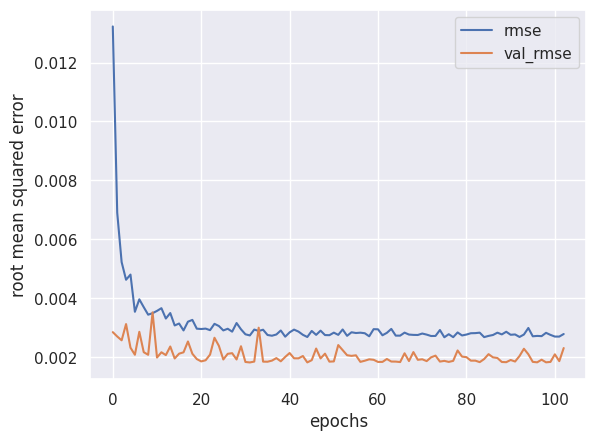

In [97]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

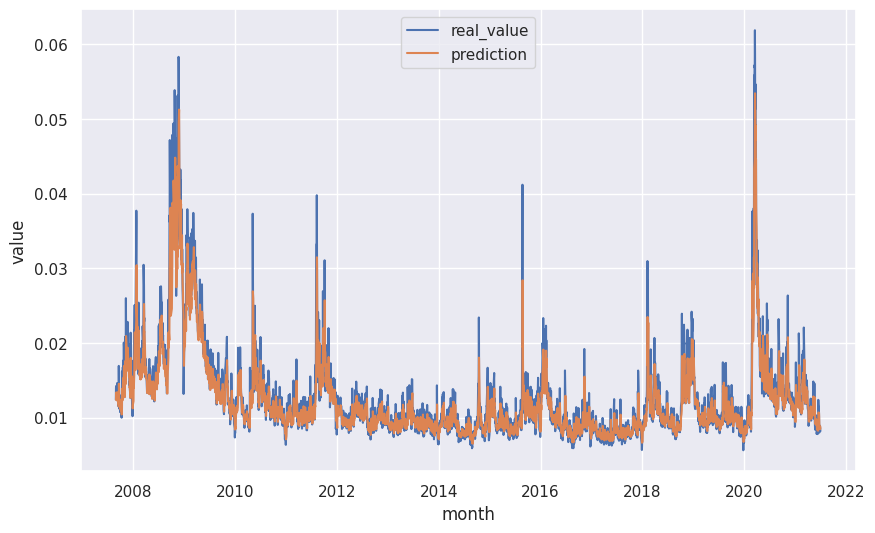

In [98]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

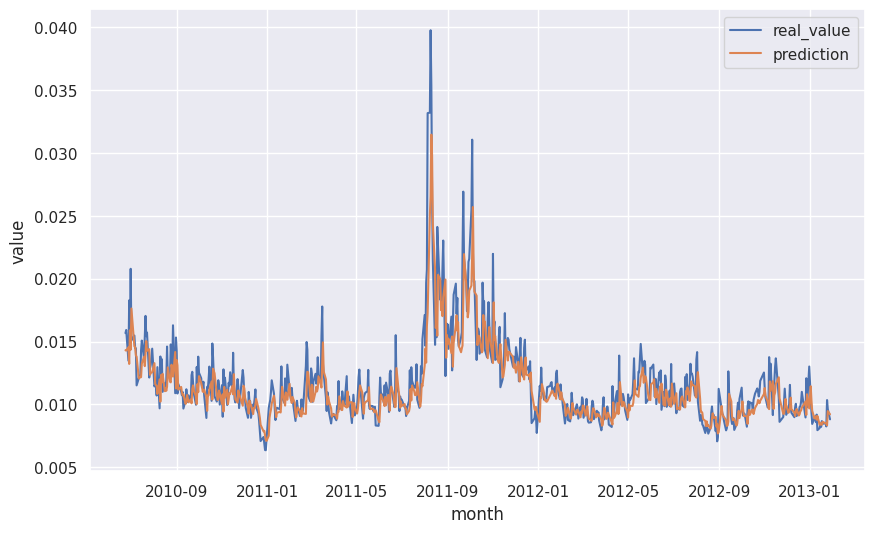

In [99]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [100]:
# variables
fh = 1
fold = 1

# bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [101]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [102]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │         2,304 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,505 (21.50 KB)

 Trainable params: 5,505 (21.50 KB)

 Non-trainable params: 0 (0.00 B)

In [103]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 14:50:11.085888: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14019352252734230420
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 14:50:11.408331: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 14:50:11.408383: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 14:50:11.408390: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302
2024-12-10 14:50:12.425781: I tensorflow/core/framework/local_rendezvous.cc:423] Local

In [104]:
# evaluate model
model.evaluate(example_test_ds)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 9.2871 - mean_squared_error: 1.7647e-06 - root_mean_squared_error: 0.0013


2024-12-10 14:51:14.365934: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 14:51:14.365984: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 14:51:14.365993: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302


[9.273284912109375, 2.137900764864753e-06, 0.0014621561858803034]

In [105]:
# predict using model using all 100% data
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


In [106]:
# predict using model using test data
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


2024-12-10 14:51:15.836220: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


In [107]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [108]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (50% 80:20)

In [109]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

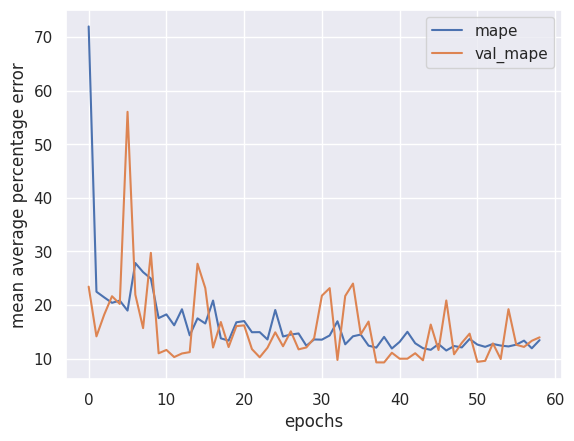

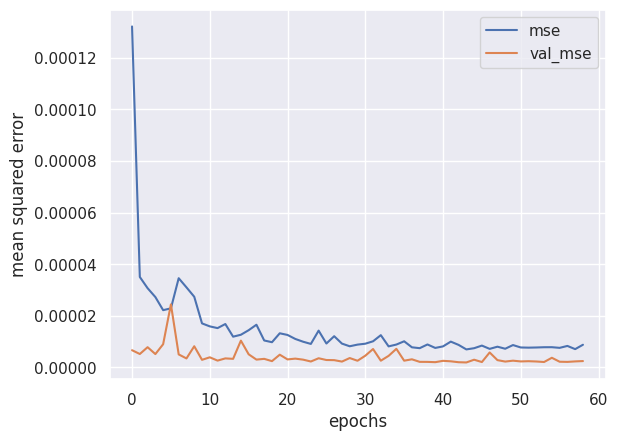

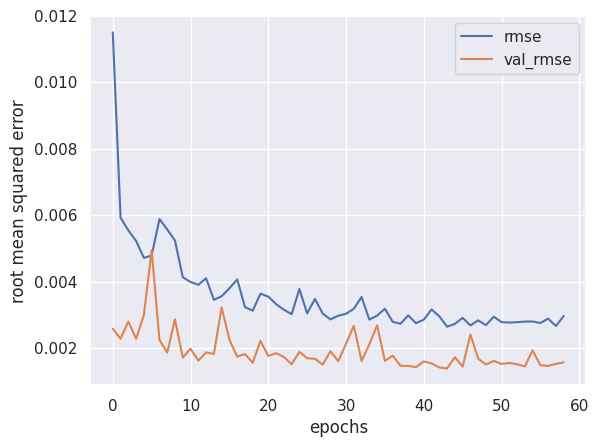

In [110]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

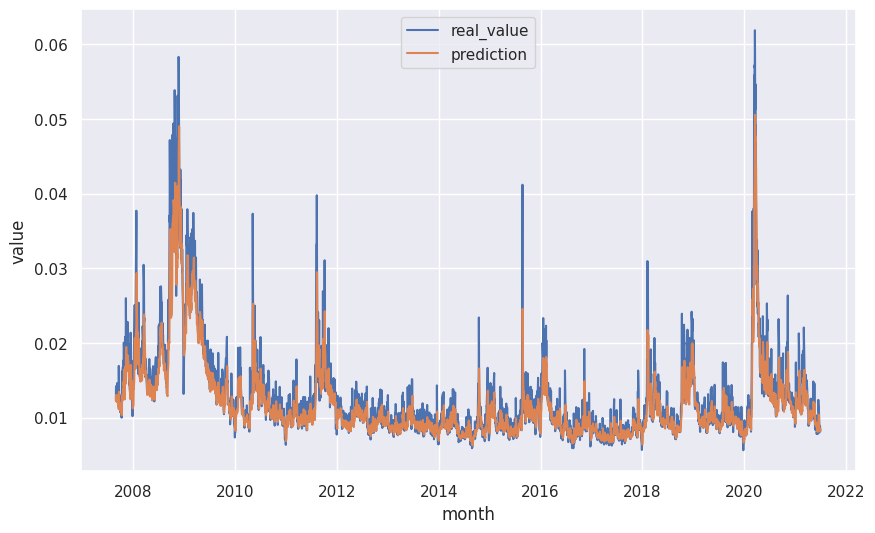

In [111]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

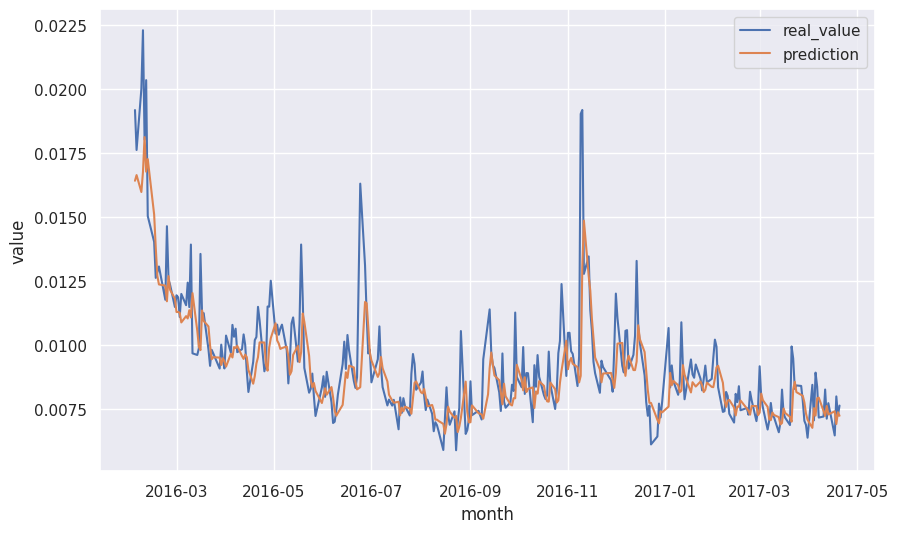

In [112]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Fold 2

##### Test Train & Predict Model (80:20)

In [113]:
# variables
fh = 1
fold = 2

# bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [114]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [115]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │         2,304 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,505 (21.50 KB)

 Trainable params: 5,505 (21.50 KB)

 Non-trainable params: 0 (0.00 B)

In [116]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 14:51:20.612136: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15019536124601605555
2024-12-10 14:51:20.612217: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 9877892613854646338
2024-12-10 14:51:20.612224: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7874542339412371852
2024-12-10 14:51:20.612229: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14019352252734230420
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 14:51:21.035293: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

In [117]:
# evaluate model
model.evaluate(example_test_ds)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 10.3442 - mean_squared_error: 3.9179e-06 - root_mean_squared_error: 0.0020


2024-12-10 14:52:58.982297: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 14:52:58.982348: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 14:52:58.982356: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302


[10.097342491149902, 3.5275888876640238e-06, 0.0018781876424327493]

In [118]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


In [119]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


In [120]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [121]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (80:20)

In [122]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

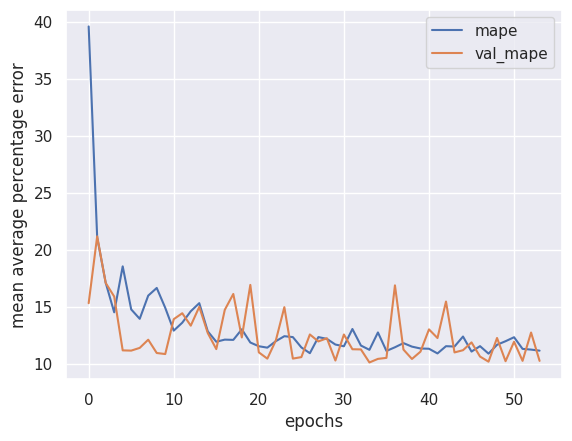

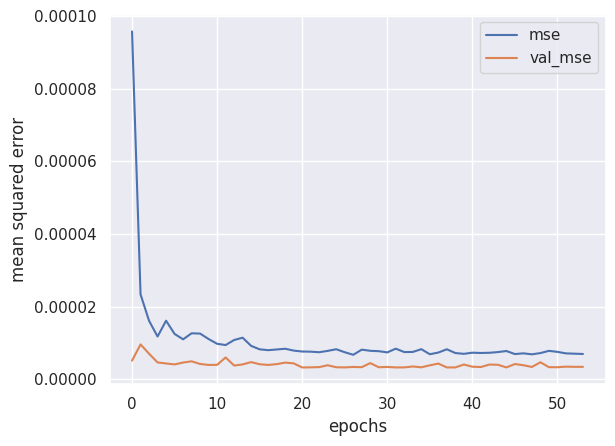

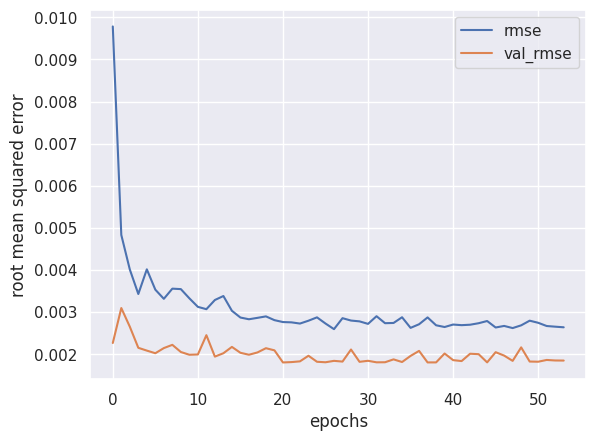

In [123]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

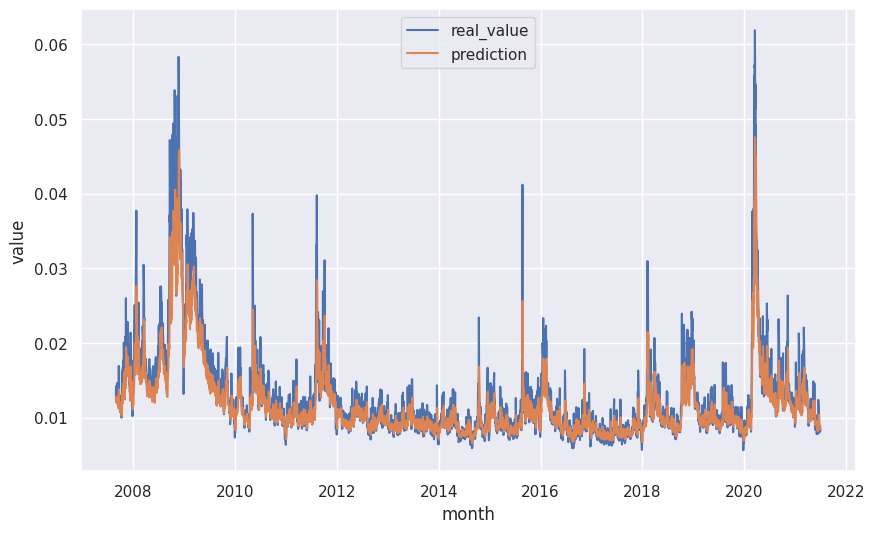

In [124]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

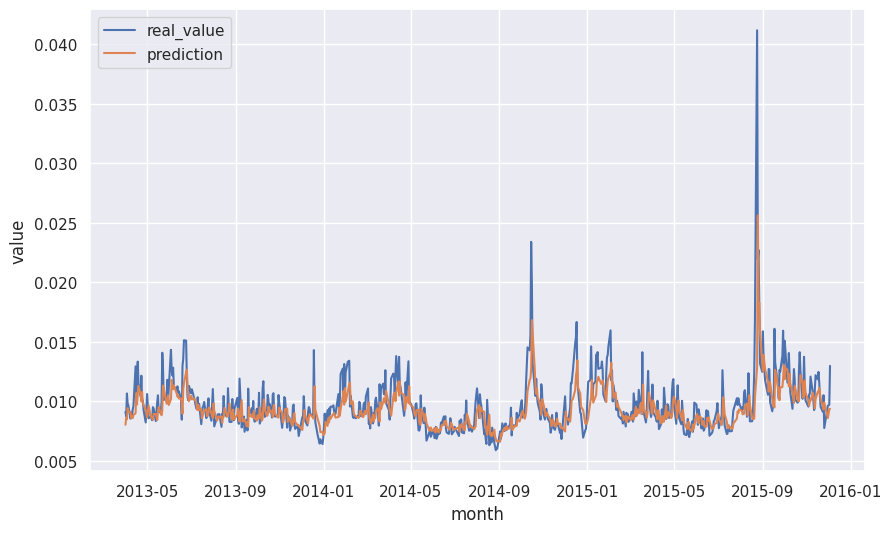

In [125]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (60:40)

In [126]:
# variables
fh = 1
fold = 2

# bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [127]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [128]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │         2,304 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,505 (21.50 KB)

 Trainable params: 5,505 (21.50 KB)

 Non-trainable params: 0 (0.00 B)

In [129]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 14:53:04.622367: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15019536124601605555
2024-12-10 14:53:04.622418: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 9877892613854646338
2024-12-10 14:53:04.622425: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7874542339412371852
2024-12-10 14:53:04.622429: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14019352252734230420
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 14:53:05.199937: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

In [130]:
# evaluate model
model.evaluate(example_test_ds)

42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 9.9287 - mean_squared_error: 2.8498e-06 - root_mean_squared_error: 0.0017


2024-12-10 14:54:59.379221: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 14:54:59.379267: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 14:54:59.379274: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302


[10.009371757507324, 3.3465335036453325e-06, 0.0018293532775714993]

In [131]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


In [132]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


In [133]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv', index=False)

In [134]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (60:40)

In [135]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv')

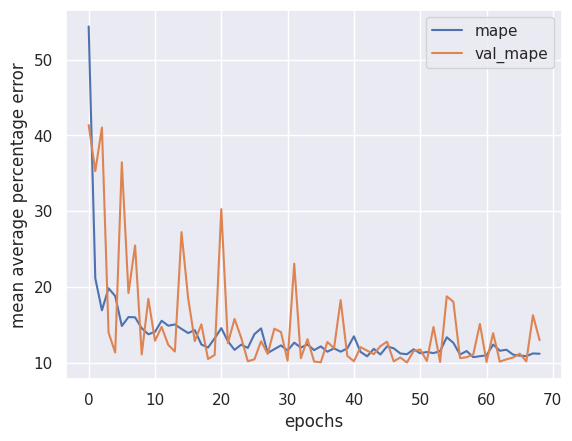

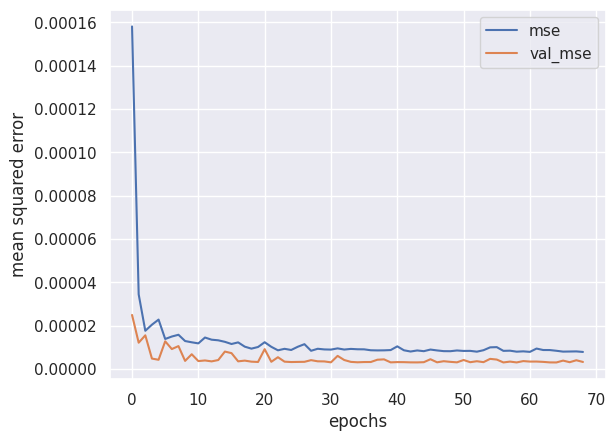

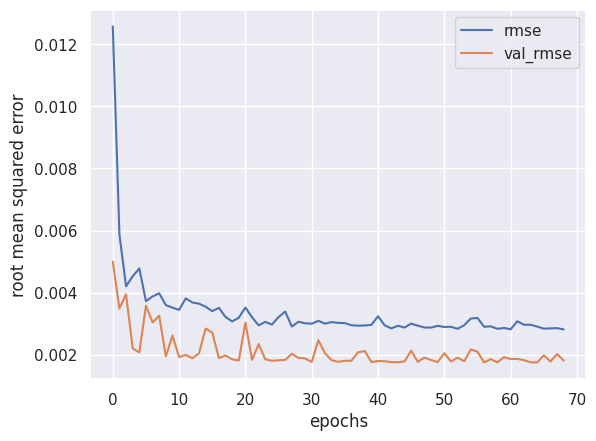

In [136]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

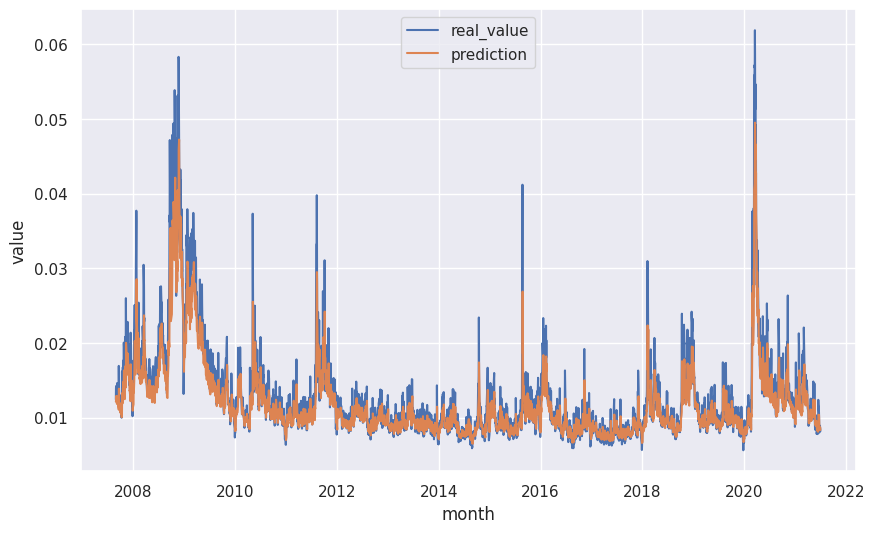

In [137]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

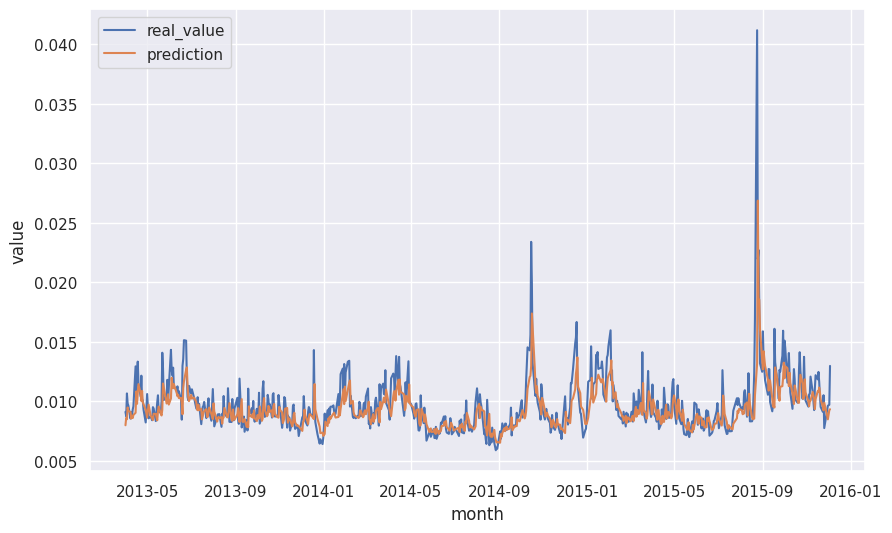

In [138]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [139]:
# variables
fh = 1
fold = 2

# bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [140]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [141]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │         2,304 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,505 (21.50 KB)

 Trainable params: 5,505 (21.50 KB)

 Non-trainable params: 0 (0.00 B)

In [142]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 14:55:04.762965: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 9877892613854646338
2024-12-10 14:55:04.763037: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7874542339412371852
2024-12-10 14:55:04.763055: I tensorflow/core/framework/local_rendezvous.cc:427] Local rendezvous send item cancelled. Key hash: 2117965583362554072
2024-12-10 14:55:04.763060: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15019536124601605555
2024-12-10 14:55:04.763100: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14019352252734230420
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when b

In [143]:
# evaluate model
model.evaluate(example_test_ds)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 9.5158 - mean_squared_error: 3.3030e-06 - root_mean_squared_error: 0.0018


2024-12-10 14:56:35.754067: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 14:56:35.754114: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 14:56:35.754121: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302


[9.681427955627441, 3.745558615264599e-06, 0.0019353445386514068]

In [144]:
# predict using model using all 100% data
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


In [145]:
# predict using model using test data
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


In [146]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [147]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (50% 80:20)

In [148]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

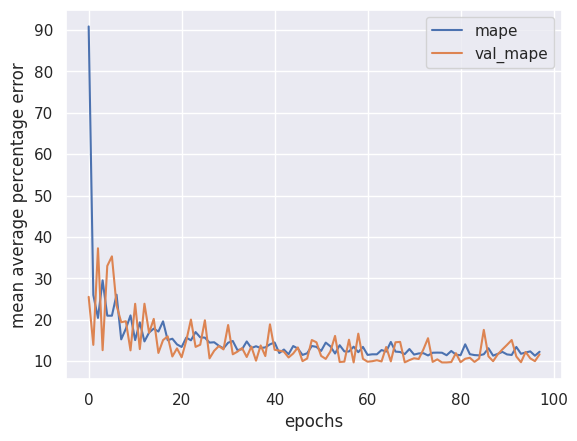

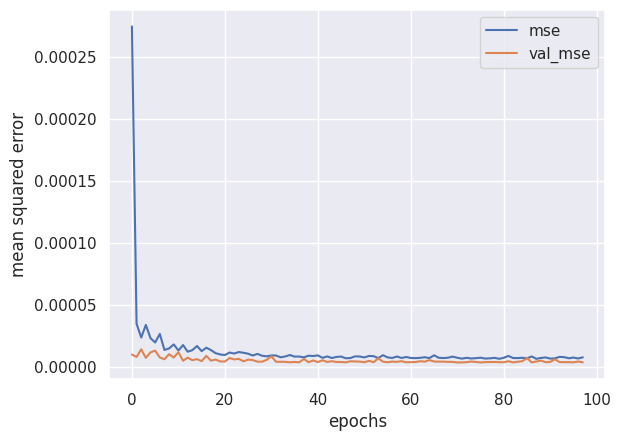

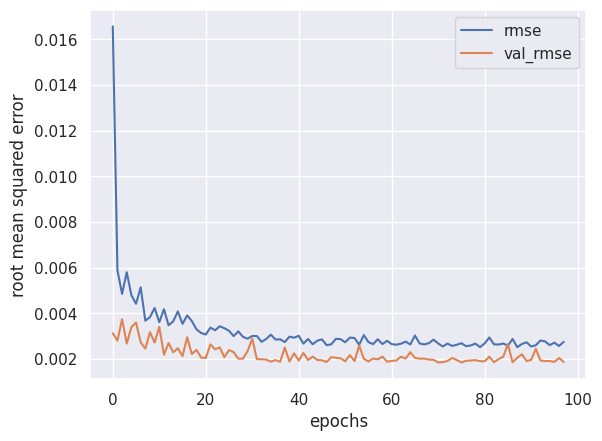

In [149]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

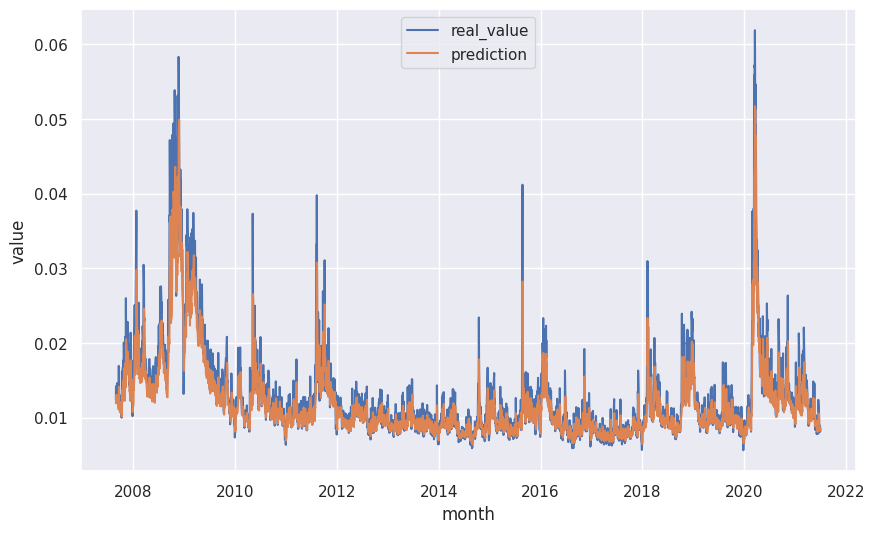

In [150]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

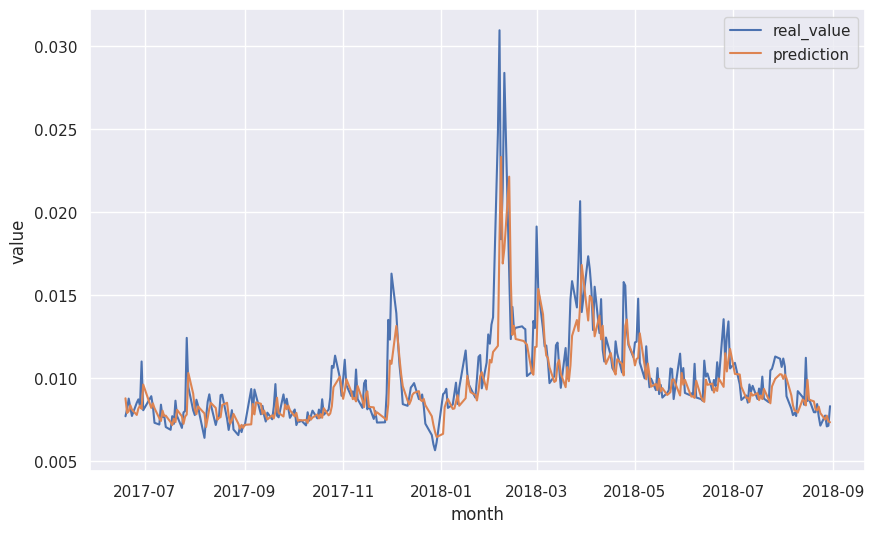

In [151]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Fold 3

##### Test Train & Predict Model (80:20)

In [152]:
# variables
fh = 1
fold = 3

# bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [153]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [154]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │         2,304 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,505 (21.50 KB)

 Trainable params: 5,505 (21.50 KB)

 Non-trainable params: 0 (0.00 B)

In [155]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 14:56:42.170783: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 14:56:42.170827: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 14:56:42.170833: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302
2024-12-10 14:56:44.022003: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 14:56:44.022115: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

In [156]:
# evaluate model
model.evaluate(example_test_ds)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 9.5296 - mean_squared_error: 2.7654e-06 - root_mean_squared_error: 0.0017


2024-12-10 14:58:10.350391: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 14:58:10.350442: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 14:58:10.350449: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302


[9.489691734313965, 2.7529511044122046e-06, 0.0016592019237577915]

In [157]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


In [158]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


In [159]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [160]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (80:20)

In [161]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

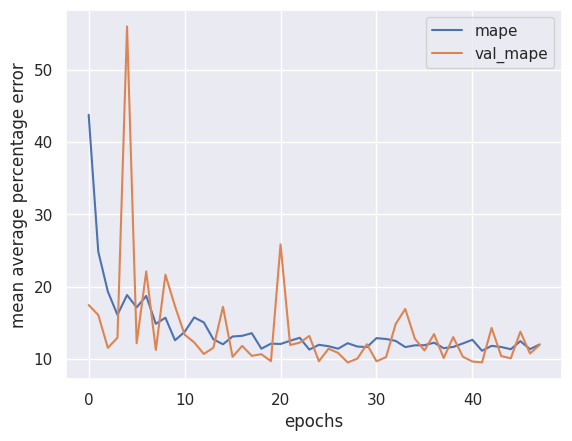

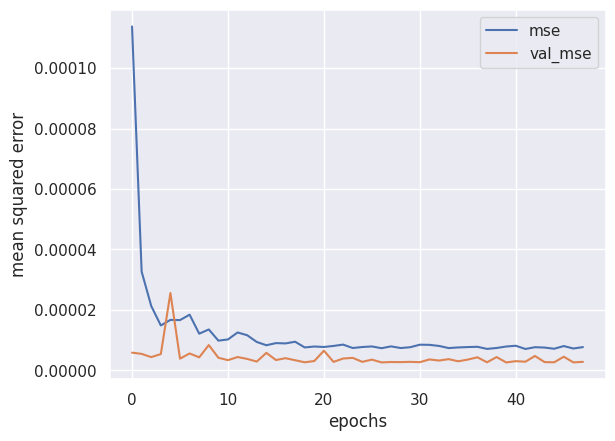

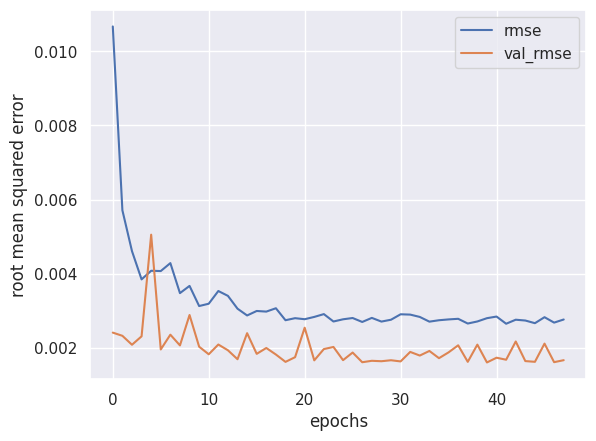

In [162]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

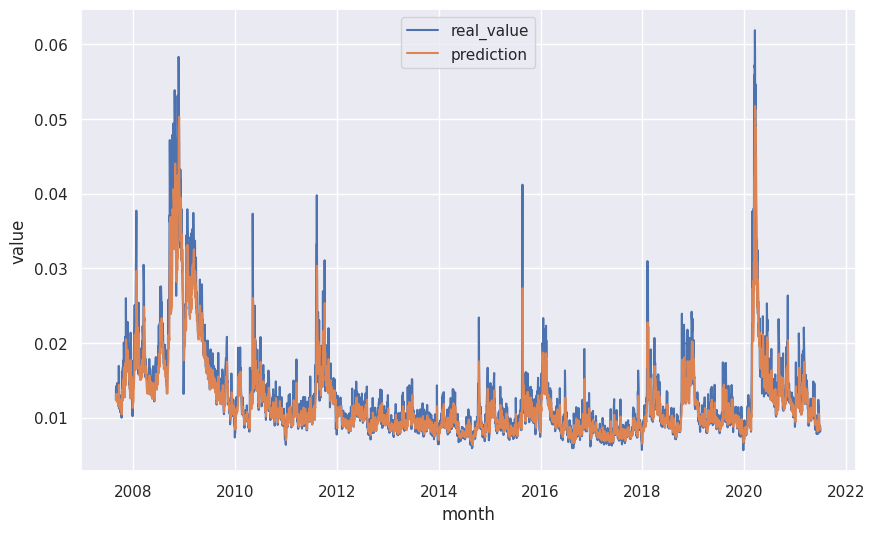

In [163]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

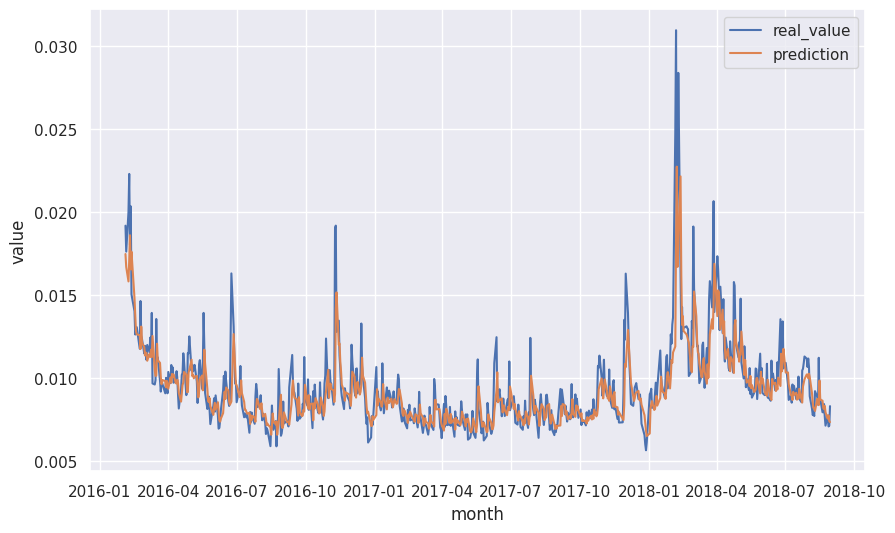

In [164]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (60:40)

In [165]:
# variables
fh = 1
fold = 3

# bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [166]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [167]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │         2,304 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,505 (21.50 KB)

 Trainable params: 5,505 (21.50 KB)

 Non-trainable params: 0 (0.00 B)

In [168]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 14:58:16.015279: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15019536124601605555
2024-12-10 14:58:16.015348: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 9877892613854646338
2024-12-10 14:58:16.015355: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7874542339412371852
2024-12-10 14:58:16.015358: I tensorflow/core/framework/local_rendezvous.cc:427] Local rendezvous send item cancelled. Key hash: 17264493013016797294
2024-12-10 14:58:16.015363: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14019352252734230420
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when 

In [169]:
# evaluate model
model.evaluate(example_test_ds)

42/42 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 10.7721 - mean_squared_error: 7.6221e-06 - root_mean_squared_error: 0.0027


2024-12-10 15:00:05.719226: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 15:00:05.719271: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 15:00:05.719278: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302


[10.529935836791992, 6.197909442562377e-06, 0.0024895600508898497]

In [170]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


In [171]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


In [172]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv', index=False)

In [173]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (60:40)

In [174]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv')

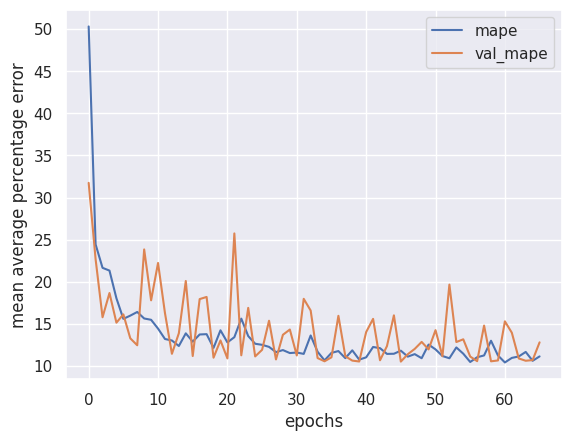

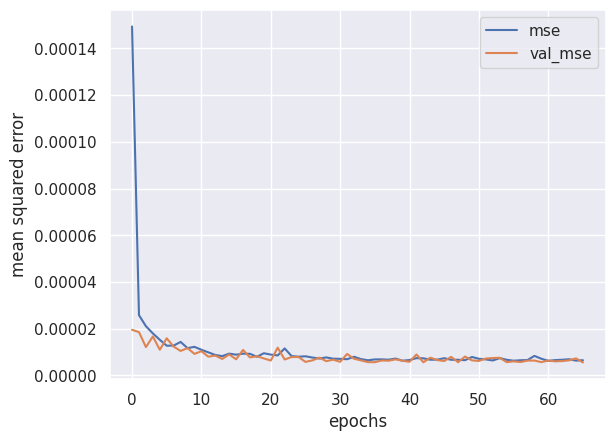

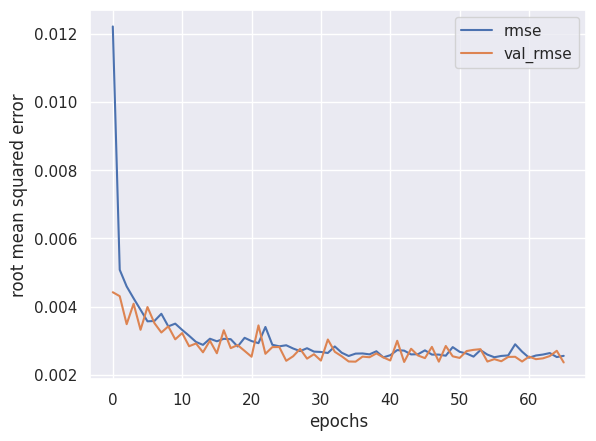

In [175]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

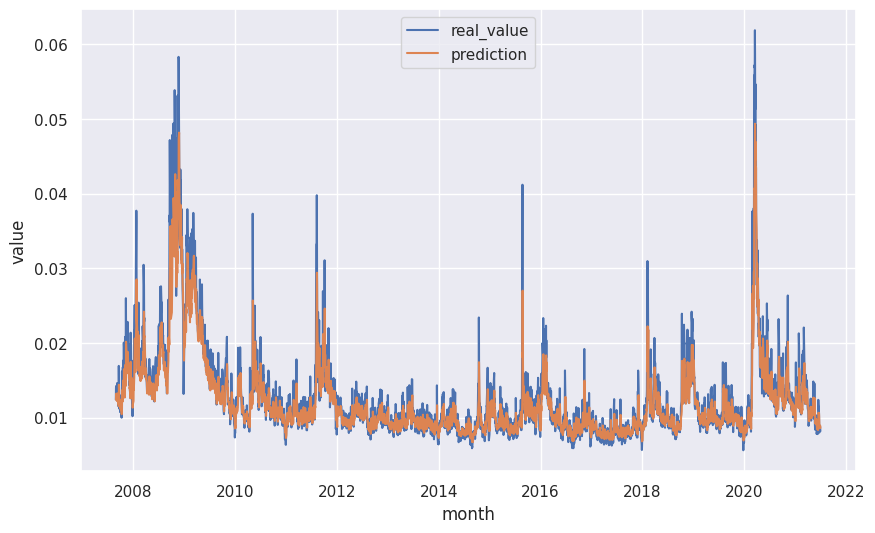

In [176]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

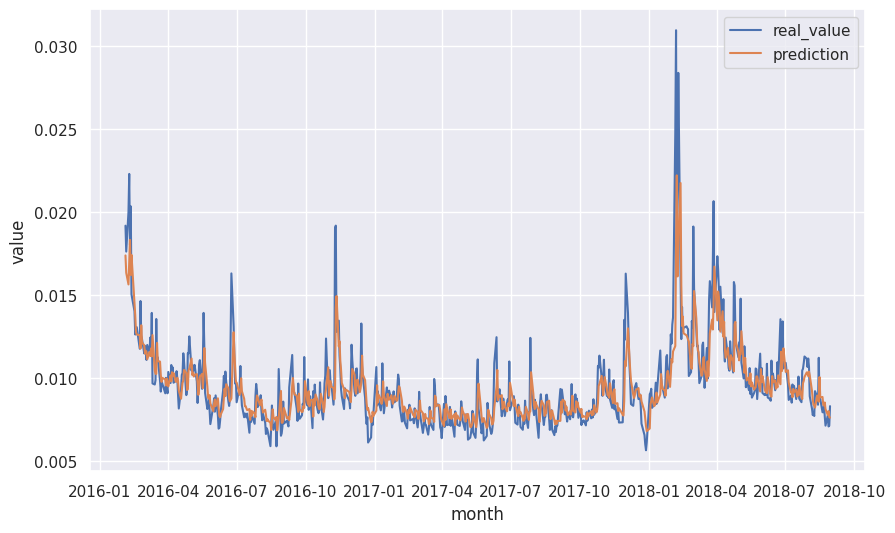

In [177]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [178]:
# variables
fh = 1
fold = 3

# bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [179]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [180]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │         2,304 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,505 (21.50 KB)

 Trainable params: 5,505 (21.50 KB)

 Non-trainable params: 0 (0.00 B)

In [181]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 15:00:11.510290: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 9877892613854646338
2024-12-10 15:00:11.510371: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14019352252734230420
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:00:11.840035: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 15:00:11.840086: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 15:00:11.840092: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

In [182]:
# evaluate model
model.evaluate(example_test_ds)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 11.2967 - mean_squared_error: 4.6922e-06 - root_mean_squared_error: 0.0021


2024-12-10 15:01:17.104074: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 15:01:17.104122: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 15:01:17.104129: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302


[10.612218856811523, 3.498062369544641e-06, 0.0018703107489272952]

In [183]:
# predict using model using all 100% data
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


In [184]:
# predict using model using test data
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


In [185]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [186]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (50% 80:20)

In [187]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

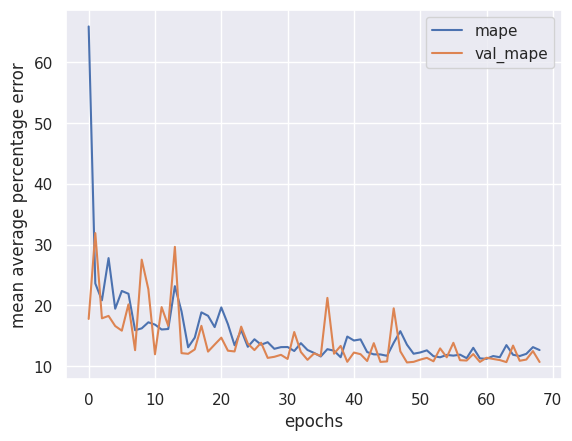

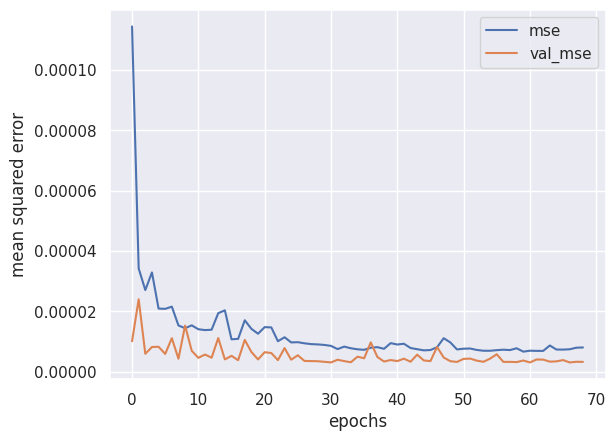

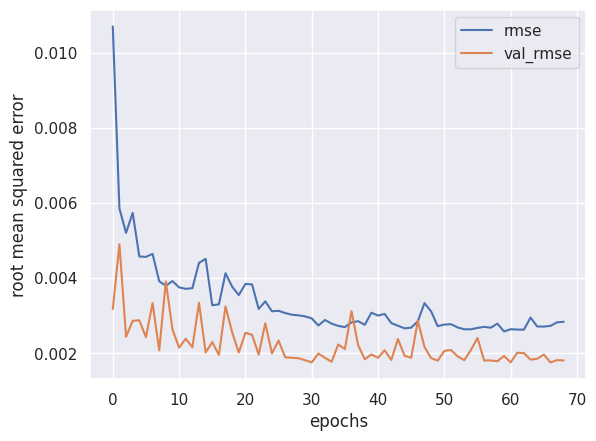

In [188]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

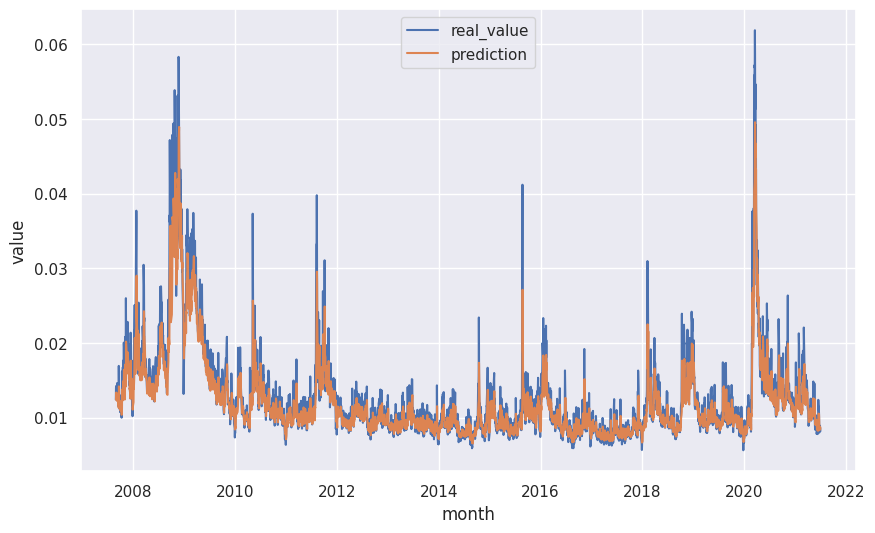

In [189]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

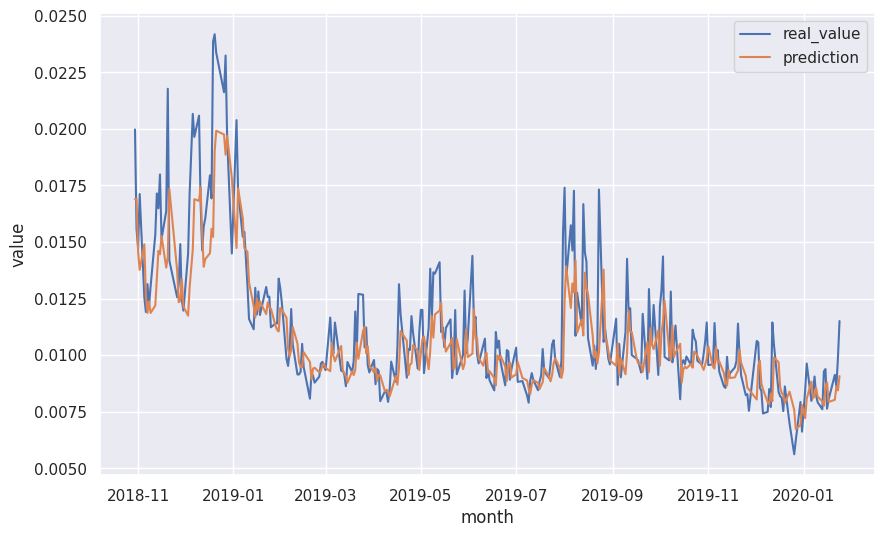

In [190]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Fold 4

##### Test Train & Predict Model (80:20)

In [191]:
# variables
fh = 1
fold = 4

# bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [192]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [193]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │         2,304 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,505 (21.50 KB)

 Trainable params: 5,505 (21.50 KB)

 Non-trainable params: 0 (0.00 B)

In [194]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 15:01:23.494335: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15019536124601605555
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:01:23.494390: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 9877892613854646338
2024-12-10 15:01:23.494396: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7874542339412371852
2024-12-10 15:01:23.494401: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 14019352252734230420
2024-12-10 15:01:23.883981: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

In [195]:
# evaluate model
model.evaluate(example_test_ds)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 10.6897 - mean_squared_error: 9.0389e-06 - root_mean_squared_error: 0.0030


2024-12-10 15:04:01.841265: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 15:04:01.841316: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 15:04:01.841324: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302


[11.264866828918457, 9.121868060901761e-06, 0.0030202430207282305]

In [196]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


In [197]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


In [198]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [199]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (80:20)

In [200]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

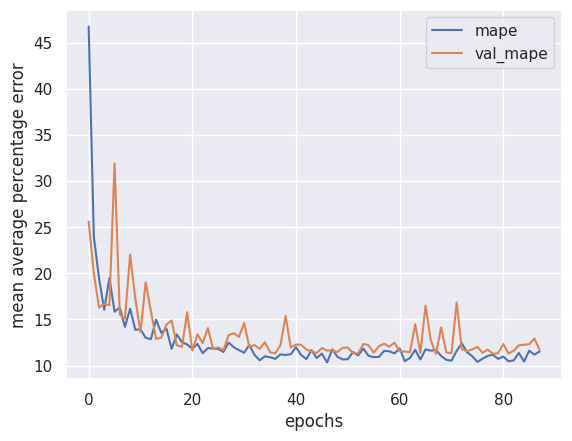

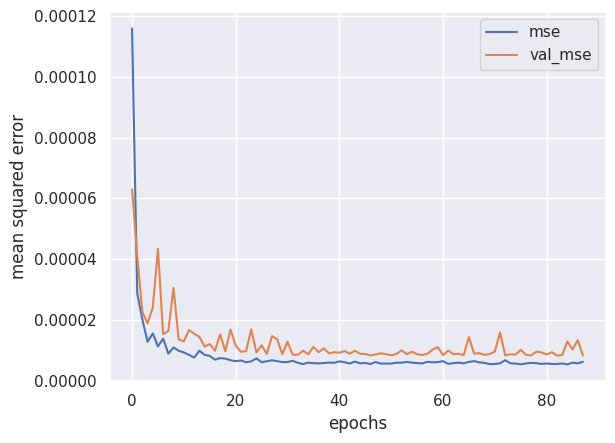

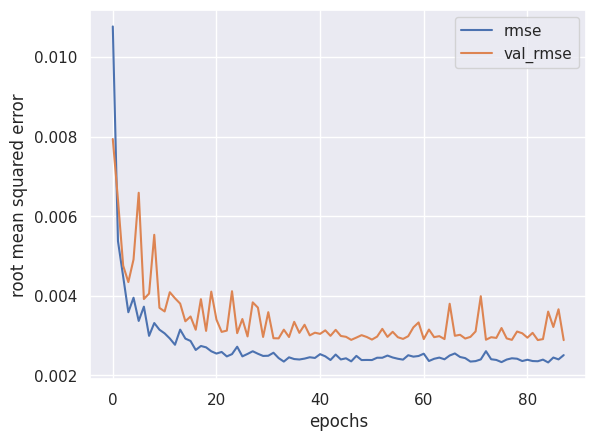

In [201]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

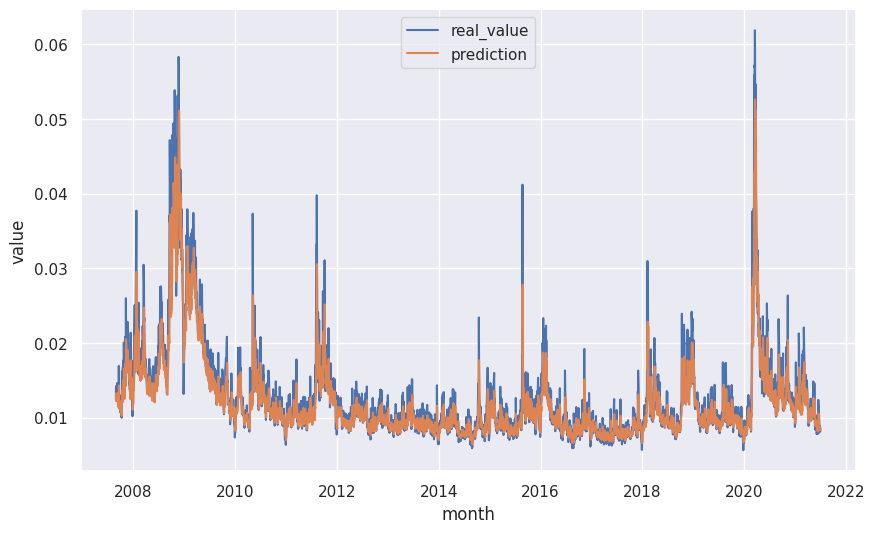

In [202]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

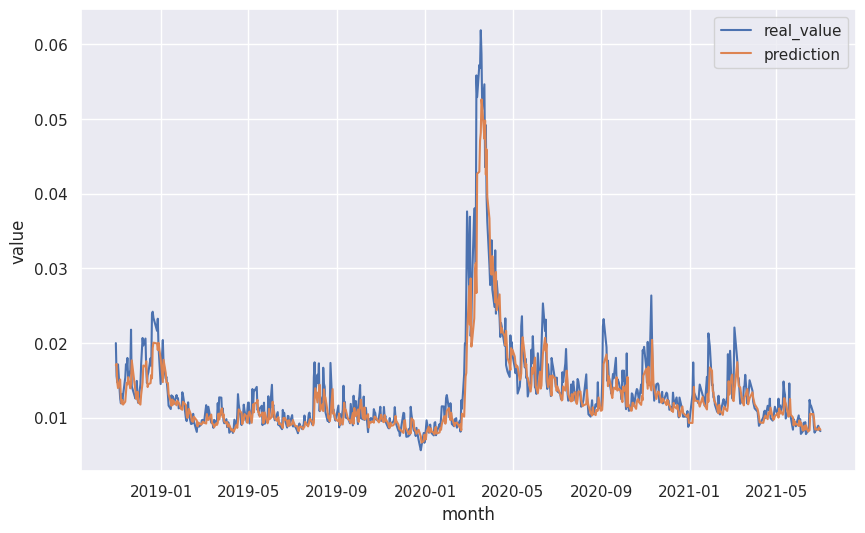

In [203]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [204]:
# variables
fh = 1
fold = 4

# bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [205]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [206]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │         2,304 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,505 (21.50 KB)

 Trainable params: 5,505 (21.50 KB)

 Non-trainable params: 0 (0.00 B)

In [207]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 15:04:07.128958: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15019536124601605555
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:04:07.414650: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 15:04:07.414701: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 15:04:07.414707: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302
2024-12-10 15:04:08.207049: I tensorflow/core/framework/local_rendezvous.cc:423] Local

In [208]:
# evaluate model
model.evaluate(example_test_ds)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 11.0753 - mean_squared_error: 6.7045e-06 - root_mean_squared_error: 0.0026


2024-12-10 15:05:28.650678: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 15:05:28.650728: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 15:05:28.650735: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302


[10.790886878967285, 6.50131369184237e-06, 0.0025497672613710165]

In [209]:
# predict using model using all 100% data
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


In [210]:
# predict using model using test data
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 


In [211]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [212]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (50% 80:20)

In [213]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

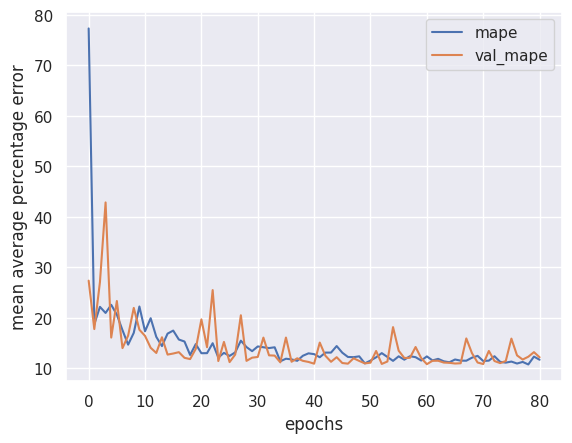

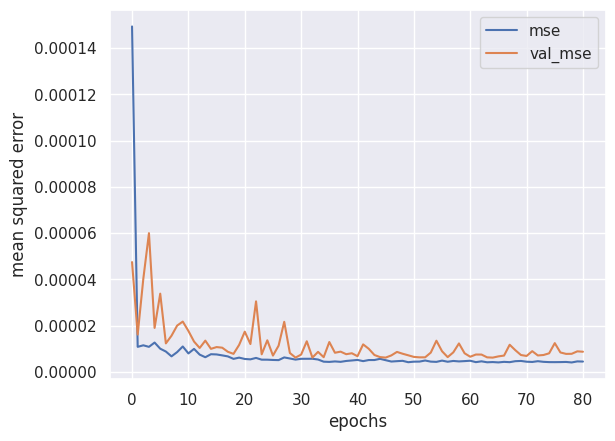

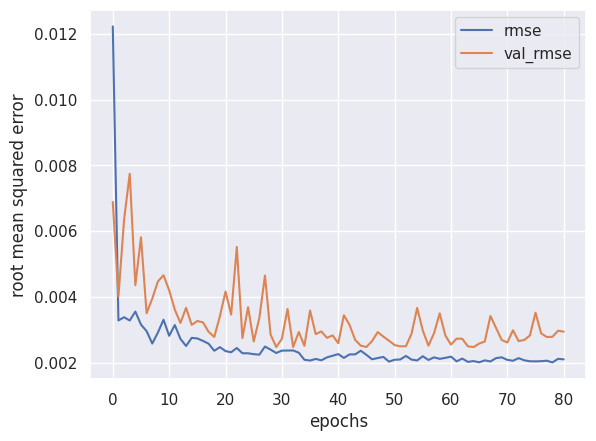

In [214]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

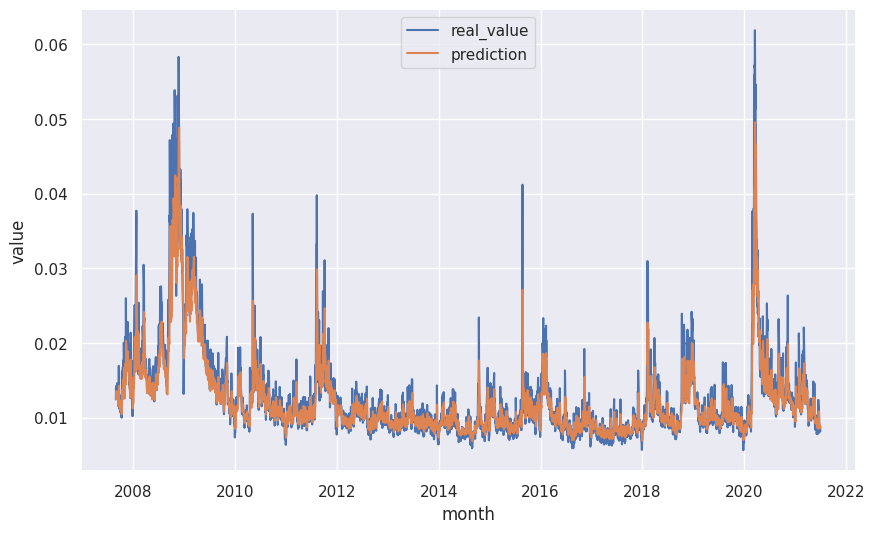

In [215]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

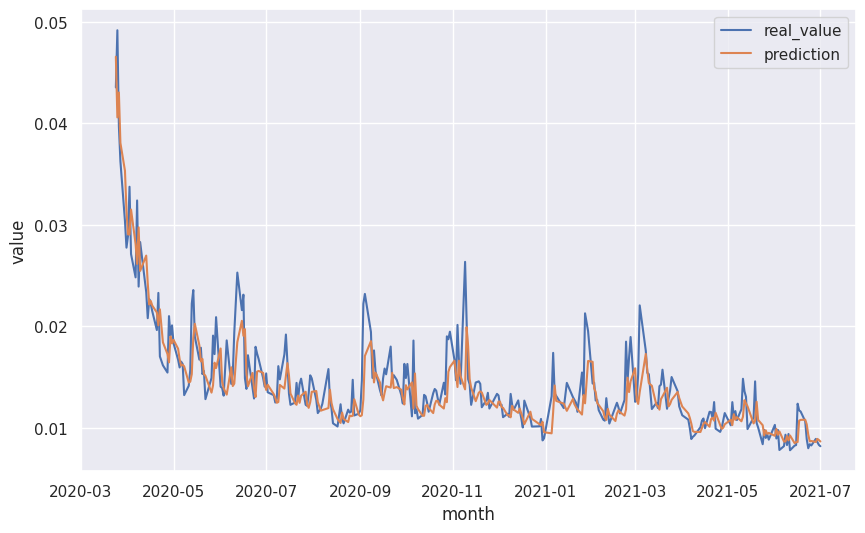

In [216]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Summary

In [217]:
# variables
fh = 1

# bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

60:40

In [218]:
# load model in keras format
bilstm_models = [tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras') for fold in range(4)]

# load test dataset
example_test_dss = []
for fold in range(4):
    example_test_dss.append(create_window_dataset(
        series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/test_{fold}.npy'), axis=-1),
        window_size=example_hps['window_size'],
        forecast_horizon=fh,
        batch_size=batch_size,
        shuffle_buffer=shuffle_buffer,
    ))

In [219]:
# evaluate model
evaluation_results = np.array([bilstm_models[fold].evaluate(example_test_dss[fold]) for fold in range(4)])

42/42 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - loss: 10.2171 - mean_squared_error: 8.7800e-06 - root_mean_squared_error: 0.0029


2024-12-10 15:05:32.834460: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 15:05:32.834518: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 15:05:32.834524: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


42/42 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 9.4592 - mean_squared_error: 2.7061e-06 - root_mean_squared_error: 0.0016


2024-12-10 15:05:33.513555: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 15:05:33.513610: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302


42/42 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 10.3043 - mean_squared_error: 2.9678e-06 - root_mean_squared_error: 0.0017


2024-12-10 15:05:34.190586: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 15:05:34.190630: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 15:05:34.190636: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302


42/42 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 10.3644 - mean_squared_error: 5.9349e-06 - root_mean_squared_error: 0.0024


2024-12-10 15:05:34.839580: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 15:05:34.839630: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 15:05:34.839637: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302


In [220]:
evaluation_results

array([[9.82761192e+00, 7.48873936e-06, 2.73655611e-03],
       [9.88663292e+00, 3.56274859e-06, 1.88752438e-03],
       [1.00093708e+01, 3.34653419e-06, 1.82935339e-03],
       [1.05299377e+01, 6.19790944e-06, 2.48956005e-03]])

In [221]:
np.mean(evaluation_results, axis=0)

array([1.00633883e+01, 5.14898289e-06, 2.23574848e-03])

50% 80:20

In [222]:
# load model in keras format
bilstm_models = [tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras') for fold in range(5)]

# load test dataset
example_test_dss = []
for fold in range(5):
    example_test_dss.append(create_window_dataset(
        series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
        window_size=example_hps['window_size'],
        forecast_horizon=fh,
        batch_size=batch_size,
        shuffle_buffer=shuffle_buffer,
    ))

In [223]:
# evaluate model
evaluation_results = np.array([bilstm_models[fold].evaluate(example_test_dss[fold]) for fold in range(5)])

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 10.1147 - mean_squared_error: 4.1606e-06 - root_mean_squared_error: 0.0020


2024-12-10 15:05:36.079962: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 15:05:36.080021: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 15:05:36.080028: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302


10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 9.0856 - mean_squared_error: 2.1787e-06 - root_mean_squared_error: 0.0015


2024-12-10 15:05:36.432683: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 15:05:36.432752: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 15:05:36.432762: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302


10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 9.9977 - mean_squared_error: 3.5548e-06 - root_mean_squared_error: 0.0019


2024-12-10 15:05:36.784000: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 15:05:36.784054: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 15:05:36.784060: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302


10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 10.3486 - mean_squared_error: 3.3145e-06 - root_mean_squared_error: 0.0018


2024-12-10 15:05:37.142845: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 15:05:37.142906: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 15:05:37.142912: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302


10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 11.2411 - mean_squared_error: 8.2440e-06 - root_mean_squared_error: 0.0029


2024-12-10 15:05:37.490986: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4924380849319368816
2024-12-10 15:05:37.491040: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 18098518768879727010
2024-12-10 15:05:37.491046: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12696982584244498302


In [224]:
evaluation_results

array([[1.06929569e+01, 5.73814714e-06, 2.39544292e-03],
       [9.27328682e+00, 2.13790054e-06, 1.46215619e-03],
       [9.68142796e+00, 3.74555862e-06, 1.93534454e-03],
       [1.06122189e+01, 3.49806237e-06, 1.87031075e-03],
       [1.07908878e+01, 6.50131369e-06, 2.54976726e-03]])

In [225]:
np.mean(evaluation_results, axis=0)

array([1.02101557e+01, 4.32419647e-06, 2.04260433e-03])

### FH 5

#### Fold 0

##### Test Train & Predict Model (80:20)

In [226]:
# variables
fh = 5
fold = 0

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 32,
    'dropout_rate': 0.4,
    'learning_rate': 0.001,
}

In [227]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [228]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │        19,072 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 22,273 (87.00 KB)

 Trainable params: 22,273 (87.00 KB)

 Non-trainable params: 0 (0.00 B)

In [229]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 15:05:43.226651: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8230607939261139607
2024-12-10 15:05:43.226718: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12323879435492034455
2024-12-10 15:05:43.226726: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12052962252141974112
2024-12-10 15:05:43.819750: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:05:43.819824: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:05:43.819832: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:05:46.406214: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv 

In [230]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 15.4626 - mean_squared_error: 3.0113e-05 - root_mean_squared_error: 0.0055


2024-12-10 15:07:50.540555: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:07:50.540614: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:07:50.540622: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[15.32945728302002, 2.9399354389170185e-05, 0.005422117188572884]

In [231]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


In [232]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


In [233]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [234]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (80:20)

In [235]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

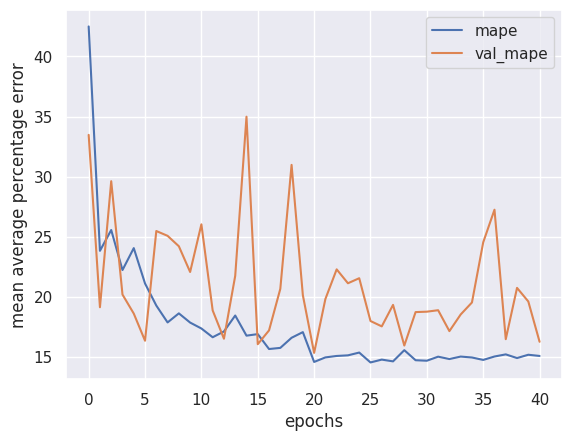

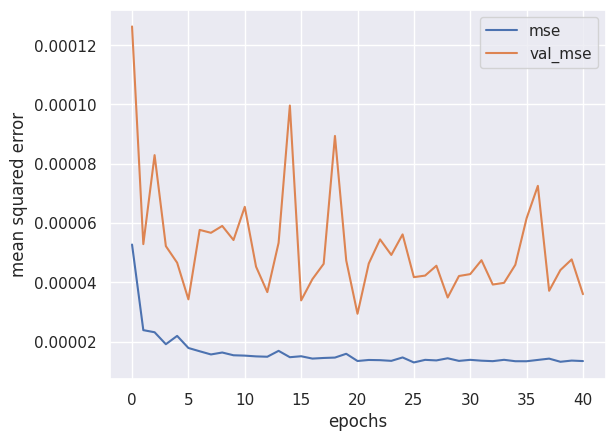

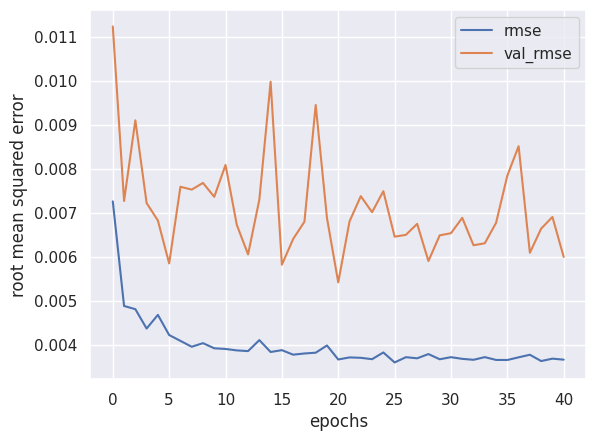

In [236]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

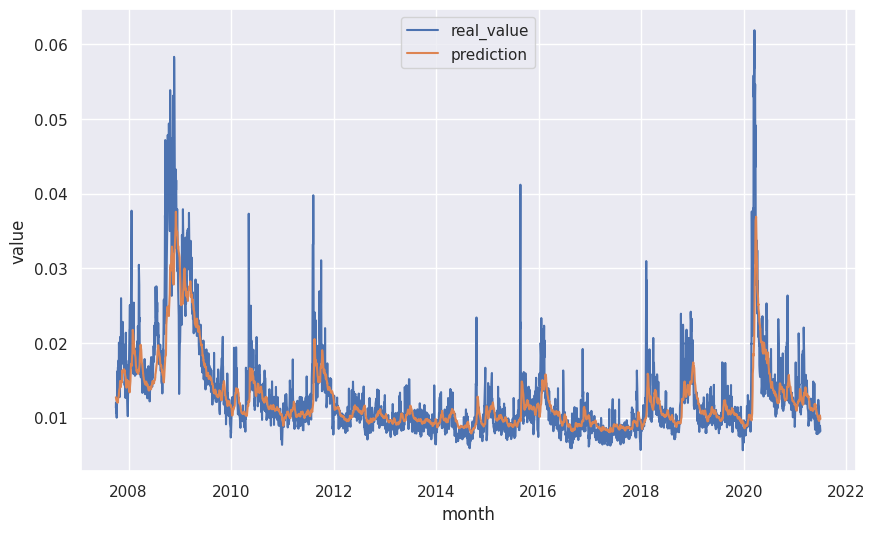

In [237]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

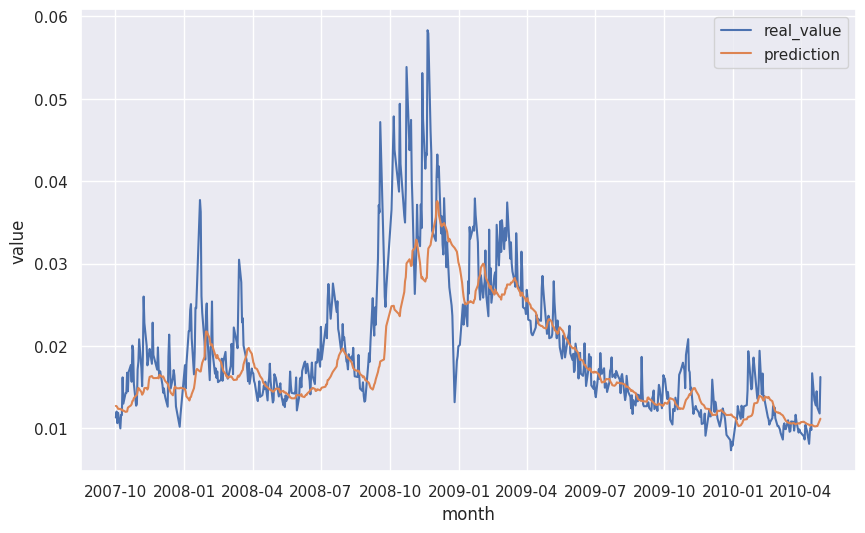

In [238]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (60:40)

In [239]:
# variables
fh = 5
fold = 0

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 32,
    'dropout_rate': 0.4,
    'learning_rate': 0.001,
}

In [240]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [241]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │        19,072 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 22,273 (87.00 KB)

 Trainable params: 22,273 (87.00 KB)

 Non-trainable params: 0 (0.00 B)

In [242]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 15:07:58.759106: I tensorflow/core/framework/local_rendezvous.cc:427] Local rendezvous send item cancelled. Key hash: 17893896090302227125
2024-12-10 15:07:58.759171: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8230607939261139607
2024-12-10 15:07:58.759178: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 853429743176954379
2024-12-10 15:07:58.759181: I tensorflow/core/framework/local_rendezvous.cc:427] Local rendezvous send item cancelled. Key hash: 11855552136780833497
2024-12-10 15:07:58.759186: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12323879435492034455
2024-12-10 15:07:58.759190: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12052962252141974112
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. 

In [243]:
# evaluate model
model.evaluate(example_test_ds)

41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - loss: 13.8686 - mean_squared_error: 1.8544e-05 - root_mean_squared_error: 0.0043


2024-12-10 15:09:59.598769: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:09:59.598819: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:09:59.598827: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[13.990082740783691, 1.8371778423897922e-05, 0.004286231007426977]

In [244]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


In [245]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


In [246]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv', index=False)

In [247]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (60:40)

In [248]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv')

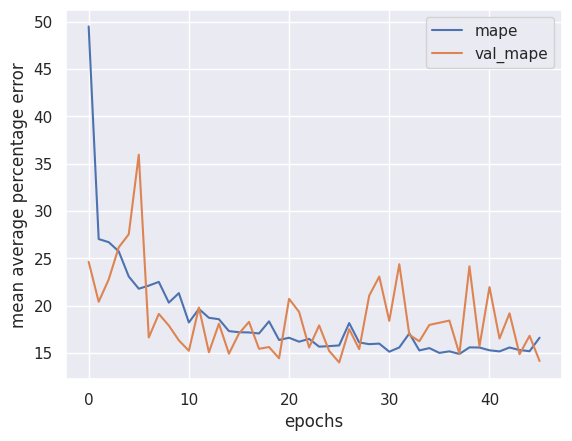

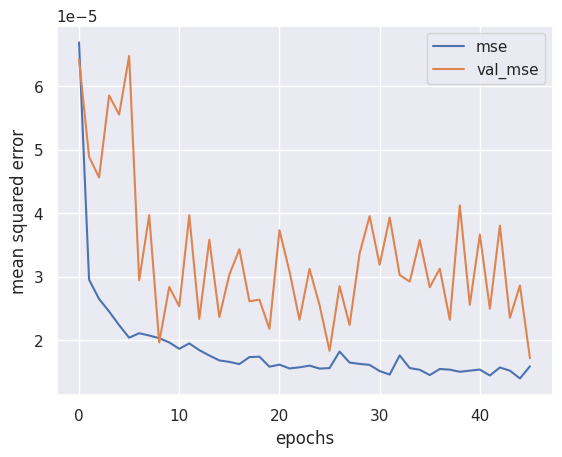

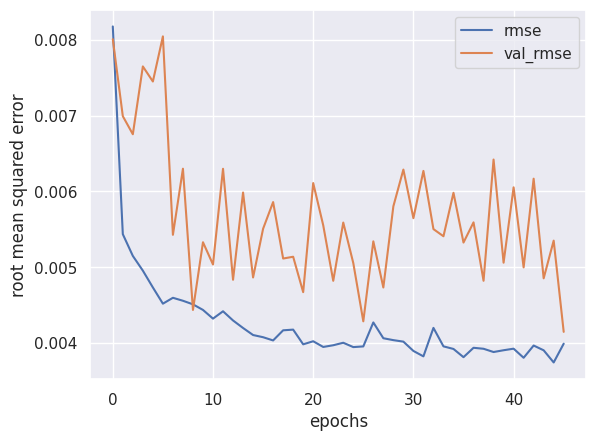

In [249]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

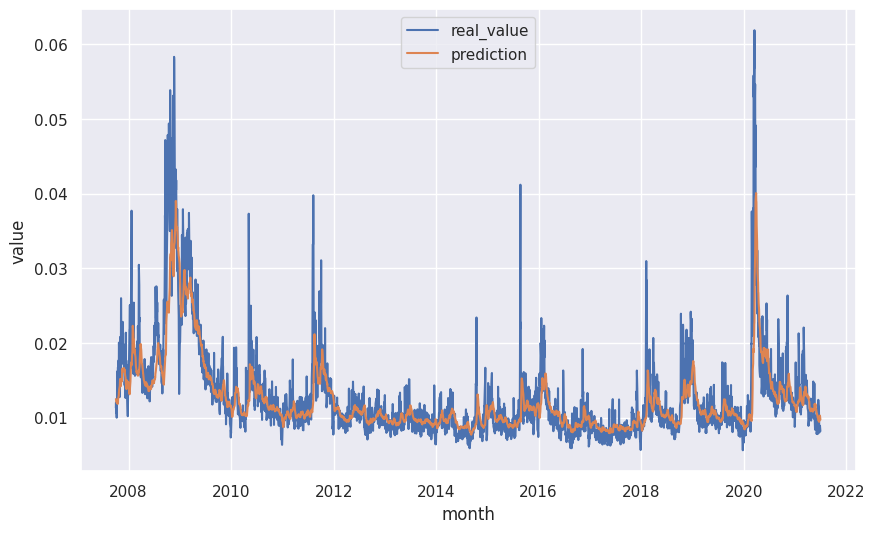

In [250]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

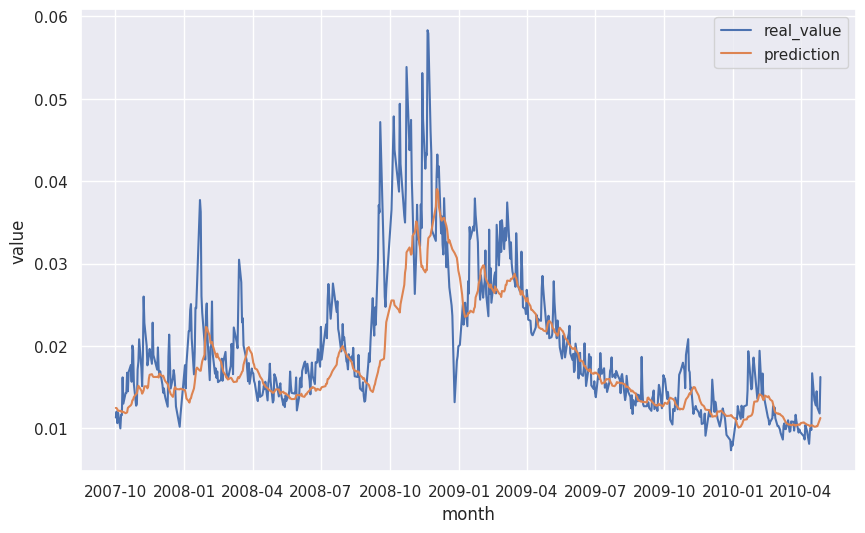

In [251]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [252]:
# variables
fh = 5
fold = 0

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 32,
    'dropout_rate': 0.4,
    'learning_rate': 0.001,
}

In [253]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [254]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │        19,072 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 22,273 (87.00 KB)

 Trainable params: 22,273 (87.00 KB)

 Non-trainable params: 0 (0.00 B)

In [255]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 15:10:06.724687: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 853429743176954379
2024-12-10 15:10:06.724751: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8230607939261139607
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:10:07.162372: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:10:07.162441: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:10:08.621839: I tensorflow/core/framework/local_rendezvous.cc:427] Local re

In [256]:
# evaluate model
model.evaluate(example_test_ds)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 14.4252 - mean_squared_error: 7.4871e-06 - root_mean_squared_error: 0.0027


2024-12-10 15:10:59.959986: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:10:59.960033: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:10:59.960042: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[15.199999809265137, 1.0983808351738844e-05, 0.003314182860776782]

In [257]:
# predict using model using all 100% data
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


In [258]:
# predict using model using test data
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


In [259]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [260]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (50% 80:20)

In [261]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

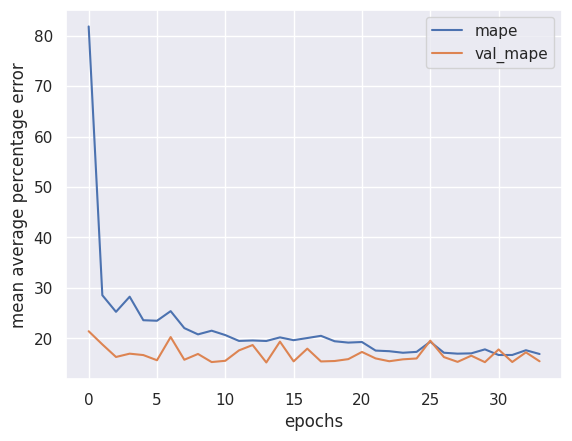

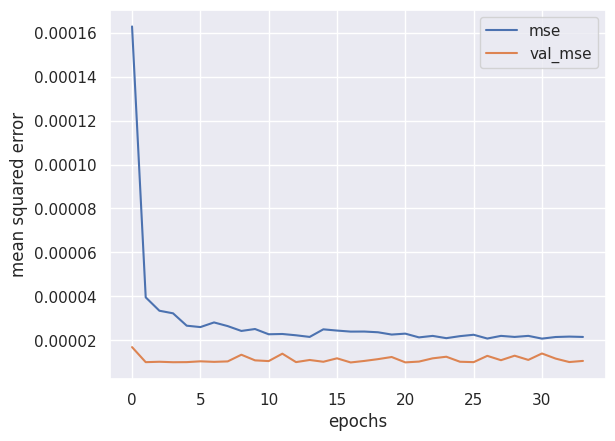

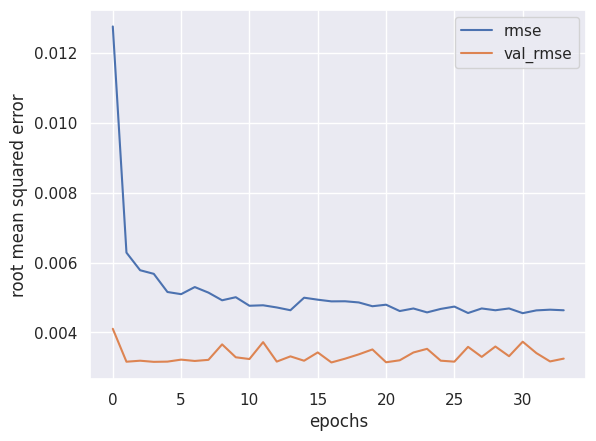

In [262]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

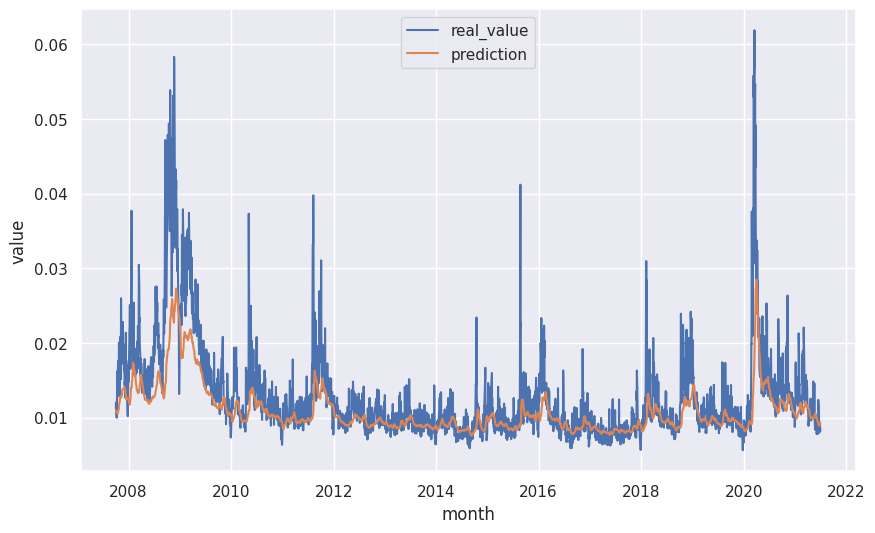

In [263]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

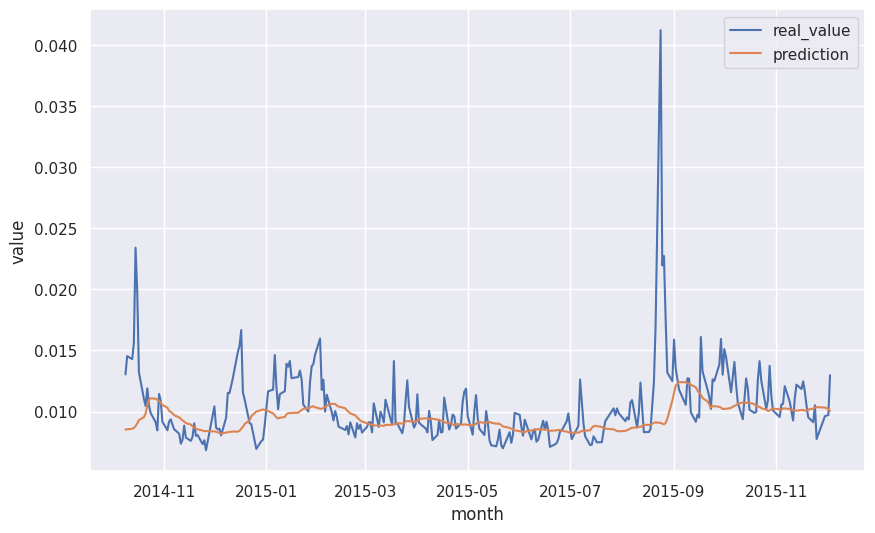

In [264]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Fold 1

##### Test Train & Predict Model (80:20)

In [265]:
# variables
fh = 5
fold = 1

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 32,
    'dropout_rate': 0.4,
    'learning_rate': 0.001,
}

In [266]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [267]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │        19,072 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 22,273 (87.00 KB)

 Trainable params: 22,273 (87.00 KB)

 Non-trainable params: 0 (0.00 B)

In [268]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 15:11:09.818943: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 853429743176954379
2024-12-10 15:11:09.819006: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8230607939261139607
2024-12-10 15:11:09.819012: I tensorflow/core/framework/local_rendezvous.cc:427] Local rendezvous send item cancelled. Key hash: 11855552136780833497
2024-12-10 15:11:09.819017: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12323879435492034455
2024-12-10 15:11:09.819022: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12052962252141974112
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when b

In [269]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 12.0303 - mean_squared_error: 9.4369e-06 - root_mean_squared_error: 0.0030


2024-12-10 15:15:22.623252: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:15:22.623299: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:15:22.623307: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[12.257279396057129, 8.660249477543402e-06, 0.00294283009134233]

In [270]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step


In [271]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


In [272]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [273]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (80:20)

In [274]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

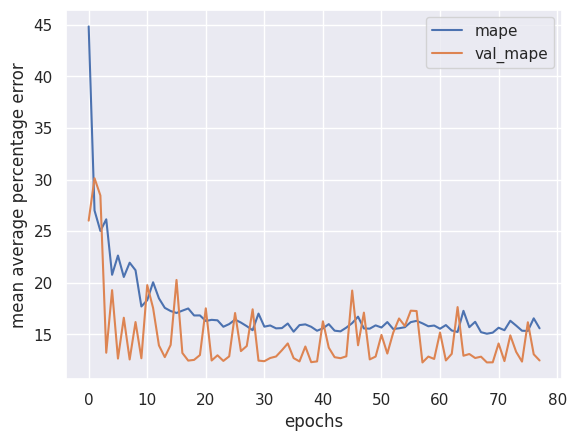

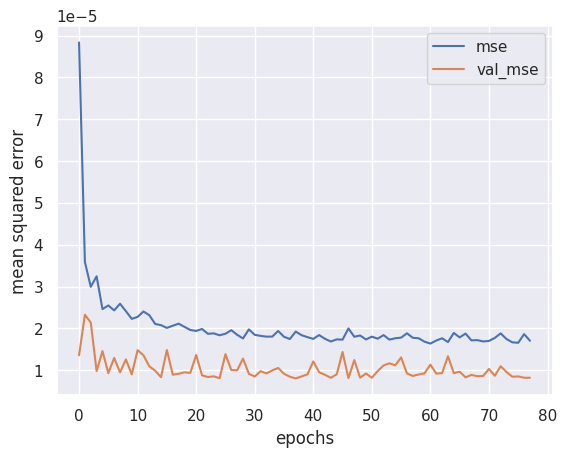

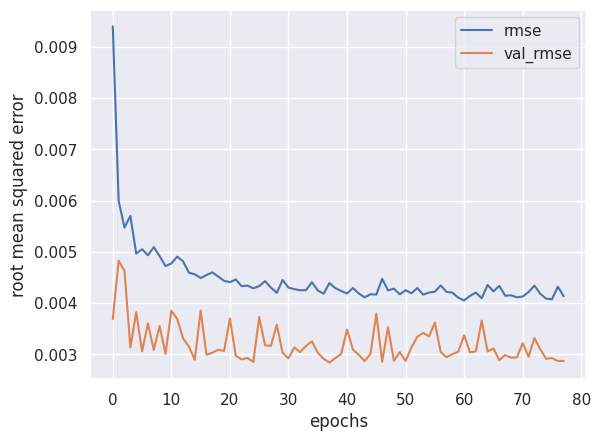

In [275]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

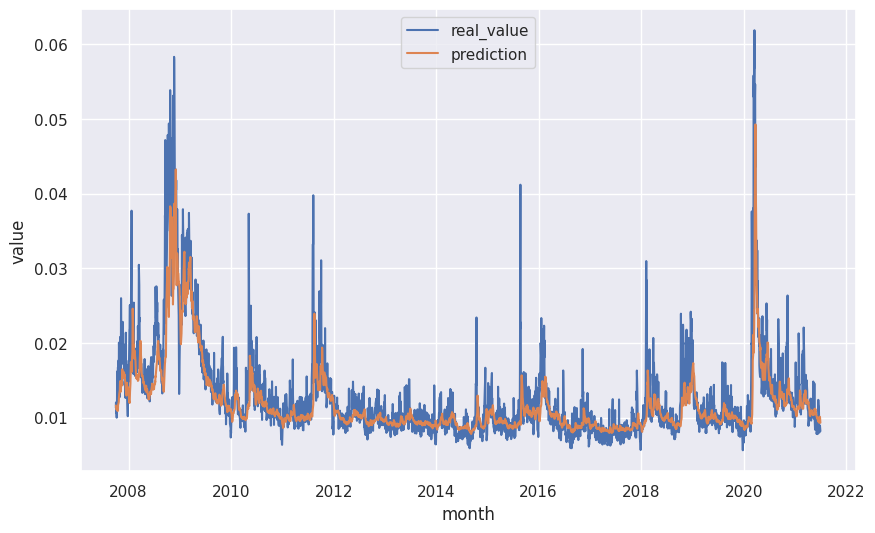

In [276]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

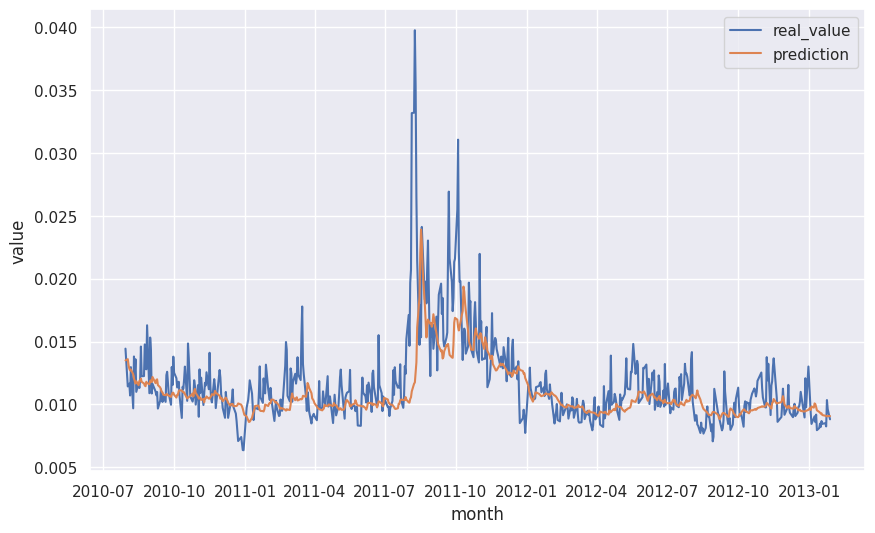

In [277]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (60:40)

In [278]:
# variables
fh = 5
fold = 1

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 32,
    'dropout_rate': 0.4,
    'learning_rate': 0.001,
}

In [279]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [280]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │        19,072 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 22,273 (87.00 KB)

 Trainable params: 22,273 (87.00 KB)

 Non-trainable params: 0 (0.00 B)

In [281]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 15:15:31.341146: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 853429743176954379
2024-12-10 15:15:31.341204: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8230607939261139607
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:15:32.249358: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:15:32.249422: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:15:32.249430: I tensorflow/core/framework/local_rendezvous.cc:423] Local re

In [282]:
# evaluate model
model.evaluate(example_test_ds)

41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 13.1934 - mean_squared_error: 7.1374e-06 - root_mean_squared_error: 0.0026


2024-12-10 15:16:45.678992: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:16:45.679041: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:16:45.679050: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[12.93264102935791, 7.413955245283432e-06, 0.002722857752814889]

In [283]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


In [284]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


In [285]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv', index=False)

In [286]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (60:40)

In [287]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv')

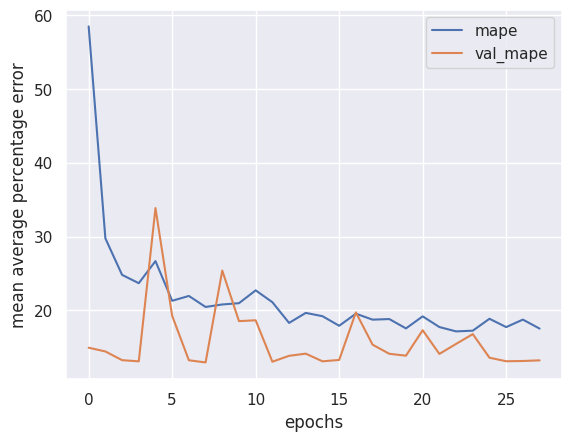

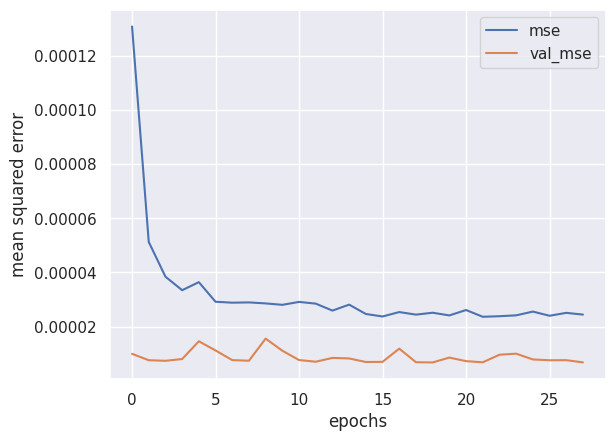

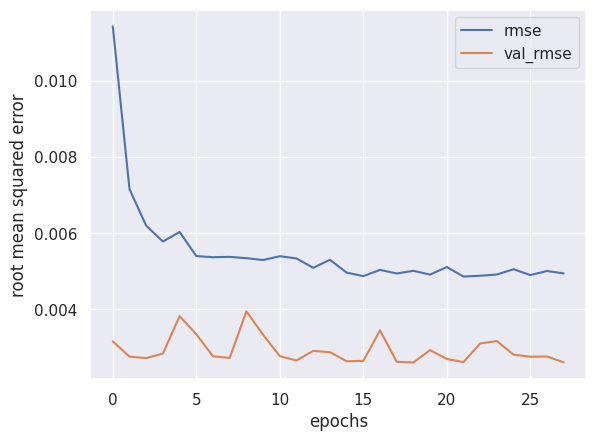

In [288]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

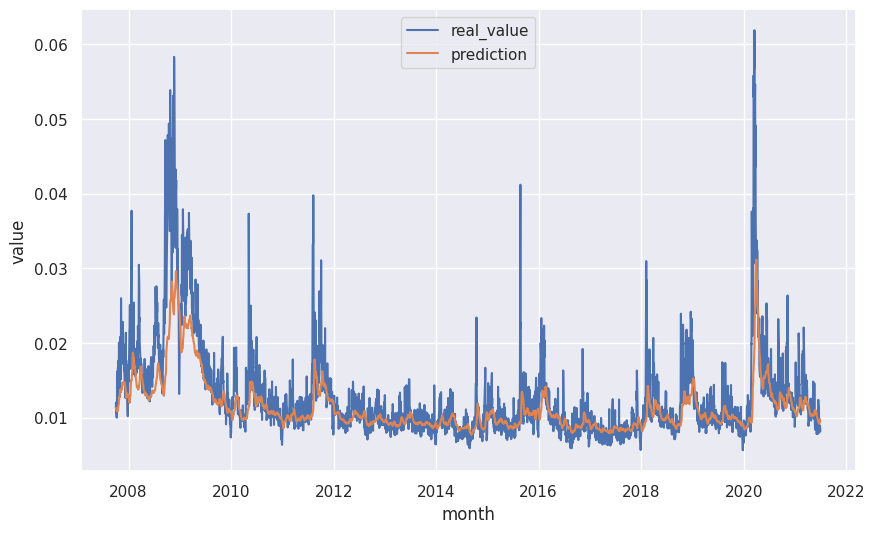

In [289]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

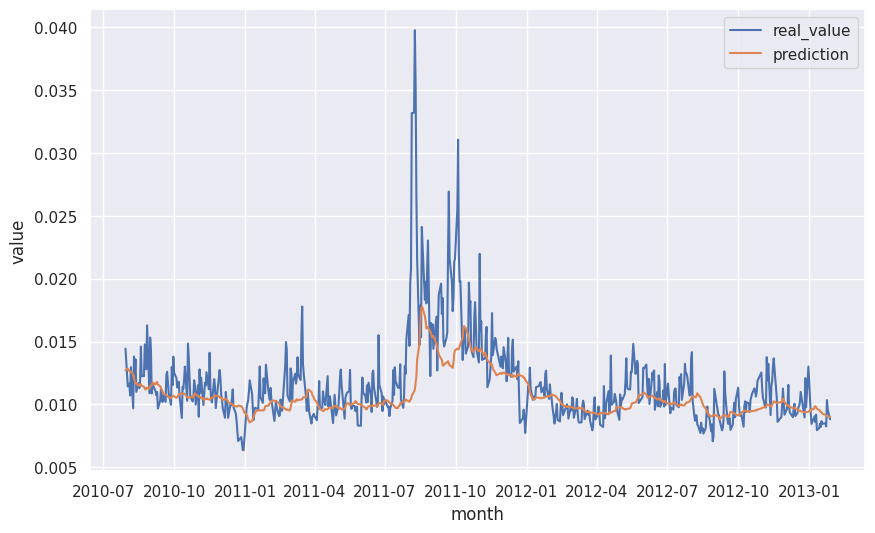

In [290]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [291]:
# variables
fh = 5
fold = 1

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 32,
    'dropout_rate': 0.4,
    'learning_rate': 0.001,
}

In [292]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [293]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │        19,072 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 22,273 (87.00 KB)

 Trainable params: 22,273 (87.00 KB)

 Non-trainable params: 0 (0.00 B)

In [294]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:16:53.806258: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:16:53.806322: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:16:53.806329: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:16:55.273195: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 853429743176954379
2024-12-10 15:16:55.273261: I tensorflow/core/framework/local_rendezvous.cc:423] Local re

In [295]:
# evaluate model
model.evaluate(example_test_ds)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 12.5001 - mean_squared_error: 3.2597e-06 - root_mean_squared_error: 0.0018


2024-12-10 15:19:20.264791: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:19:20.264842: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:19:20.264850: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[11.852971076965332, 2.952775957965059e-06, 0.0017183643067255616]

In [296]:
# predict using model using all 100% data
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


In [297]:
# predict using model using test data
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 


In [298]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [299]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (50% 80:20)

In [300]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

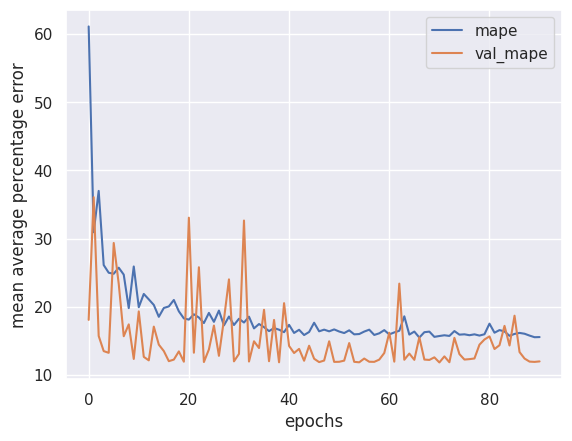

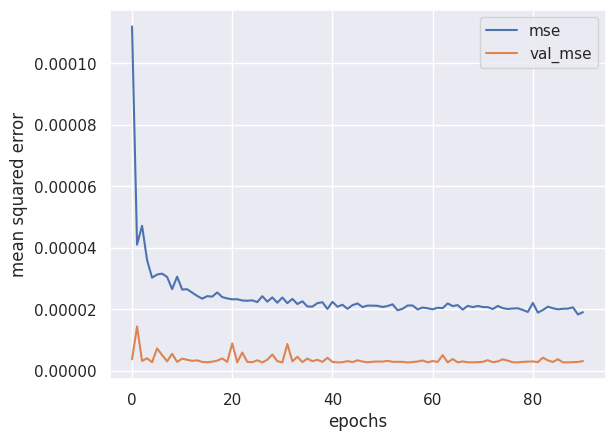

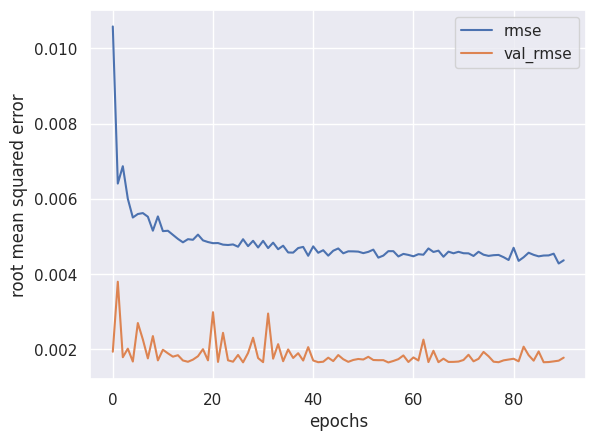

In [301]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

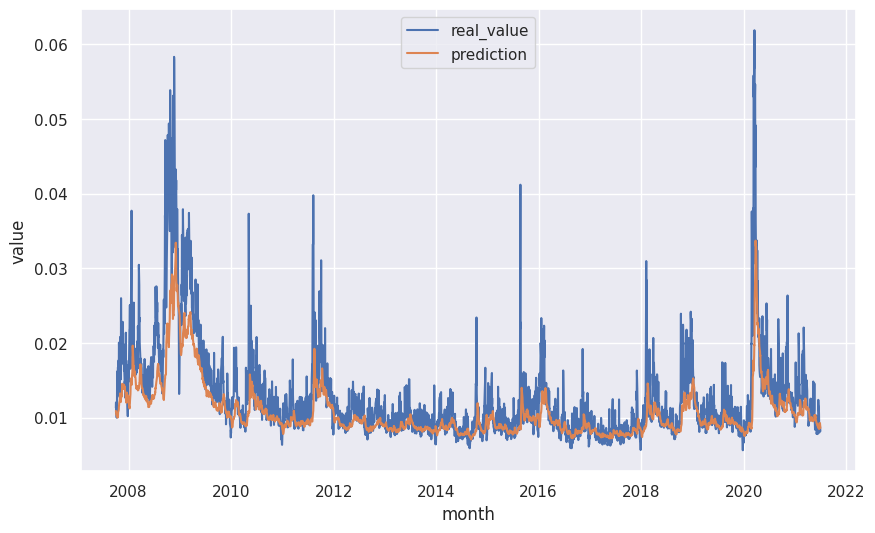

In [302]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

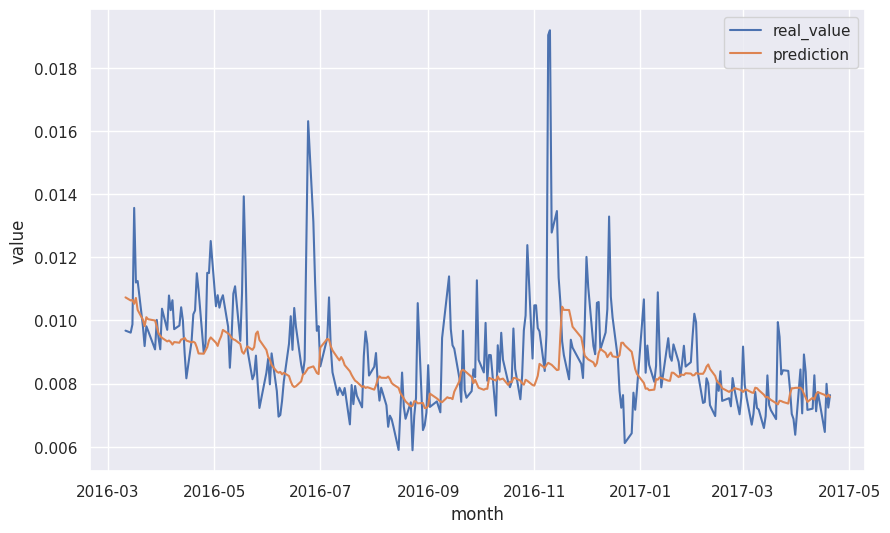

In [303]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Fold 2

##### Test Train & Predict Model (80:20)

In [304]:
# variables
fh = 5
fold = 2

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 32,
    'dropout_rate': 0.4,
    'learning_rate': 0.001,
}

In [305]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [306]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │        19,072 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 22,273 (87.00 KB)

 Trainable params: 22,273 (87.00 KB)

 Non-trainable params: 0 (0.00 B)

In [307]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:19:30.325848: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:19:30.325912: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:19:33.603876: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:19:33.603931: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:19:33.603939: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

In [308]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 13.4789 - mean_squared_error: 9.5127e-06 - root_mean_squared_error: 0.0030


2024-12-10 15:21:03.949220: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:21:03.949288: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:21:03.949299: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[13.188888549804688, 6.259087967919186e-06, 0.0025018169544637203]

In [309]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step


In [310]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


In [311]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [312]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (80:20)

In [313]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

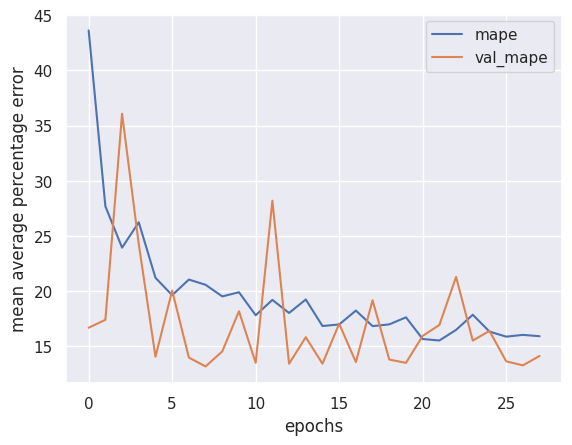

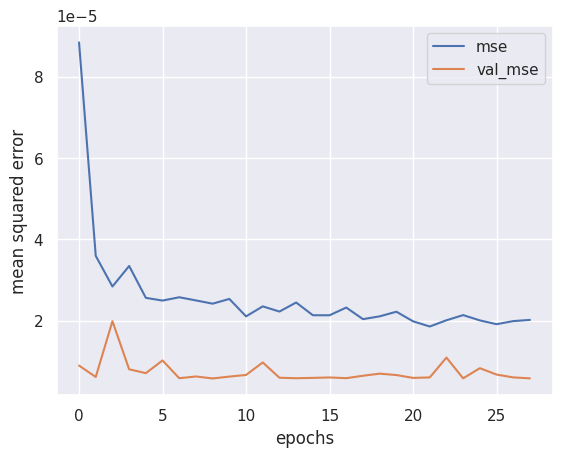

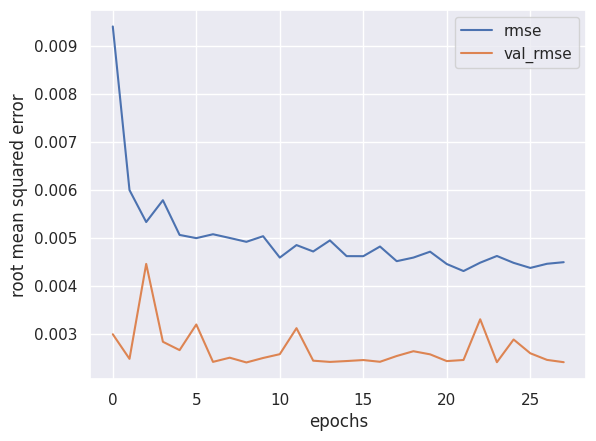

In [314]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

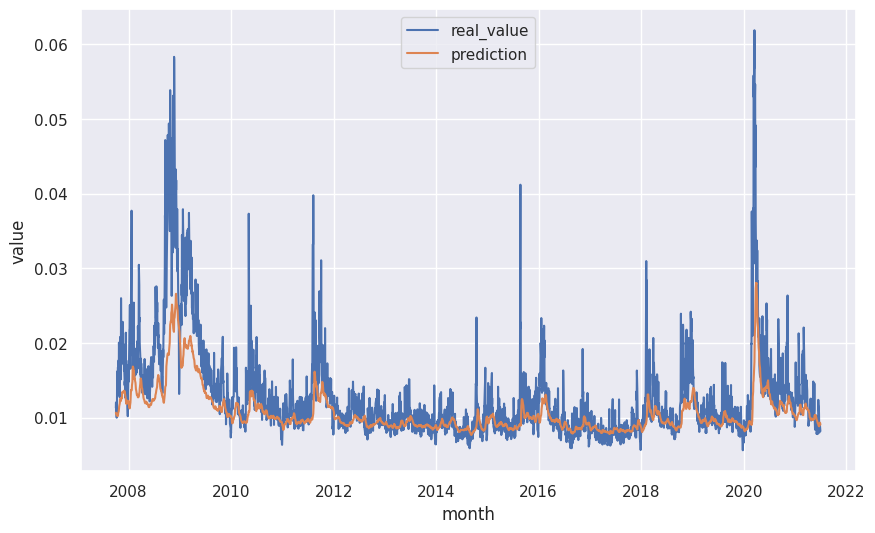

In [315]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

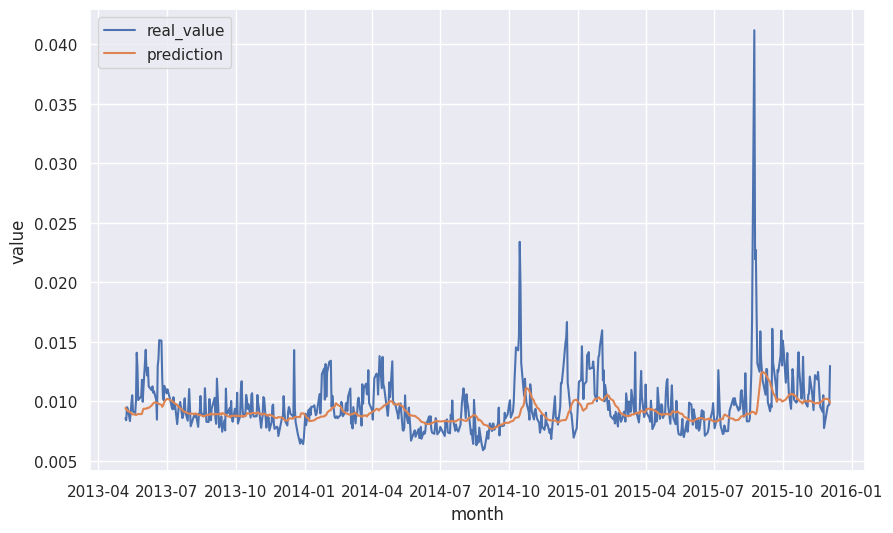

In [316]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (60:40)

In [317]:
# variables
fh = 5
fold = 2

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 32,
    'dropout_rate': 0.4,
    'learning_rate': 0.001,
}

In [318]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [319]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │        19,072 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 22,273 (87.00 KB)

 Trainable params: 22,273 (87.00 KB)

 Non-trainable params: 0 (0.00 B)

In [320]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 15:21:14.084766: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 853429743176954379
2024-12-10 15:21:14.084826: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8230607939261139607
2024-12-10 15:21:14.084835: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12323879435492034455
2024-12-10 15:21:14.084840: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12052962252141974112
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:21:15.297488: I tensorflow/core/framework/local_rendezvous.cc:423] Local r

In [321]:
# evaluate model
model.evaluate(example_test_ds)

41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 13.0377 - mean_squared_error: 5.4776e-06 - root_mean_squared_error: 0.0023


2024-12-10 15:23:45.438959: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:23:45.439014: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:23:45.439024: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[13.488380432128906, 6.4633322836016305e-06, 0.002542308298870921]

In [322]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


In [323]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


In [324]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv', index=False)

In [325]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (60:40)

In [326]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv')

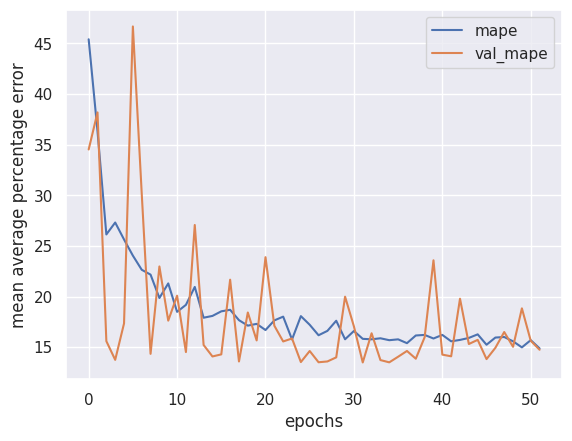

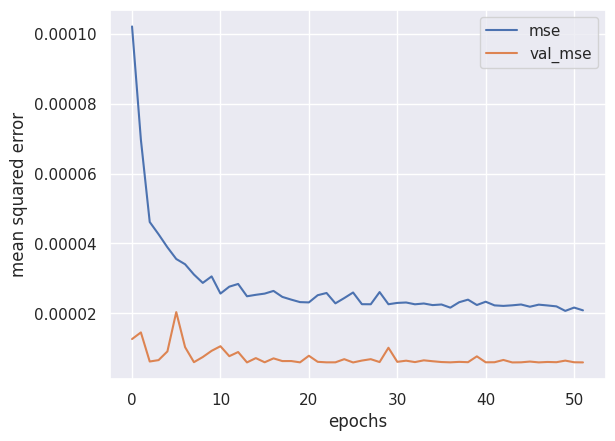

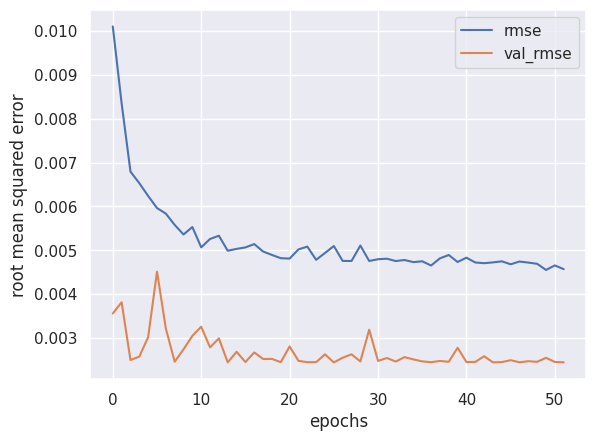

In [327]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

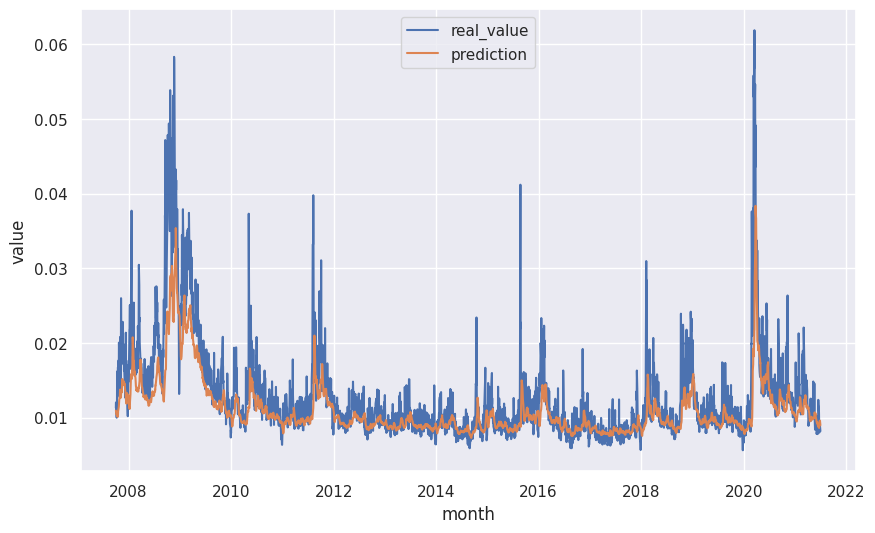

In [328]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

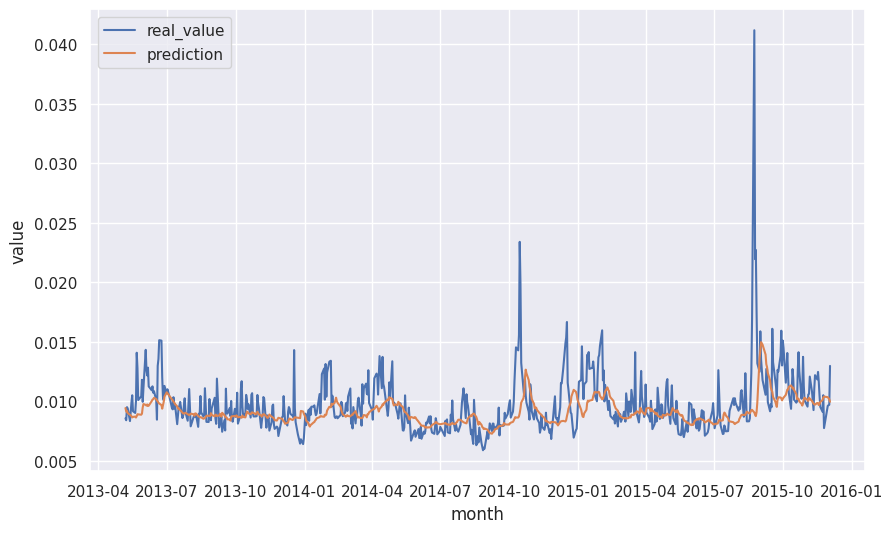

In [329]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [330]:
# variables
fh = 5
fold = 2

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 32,
    'dropout_rate': 0.4,
    'learning_rate': 0.001,
}

In [331]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [332]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │        19,072 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 22,273 (87.00 KB)

 Trainable params: 22,273 (87.00 KB)

 Non-trainable params: 0 (0.00 B)

In [333]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 15:23:52.680130: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 853429743176954379
2024-12-10 15:23:52.680190: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8230607939261139607
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:23:52.680199: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12052962252141974112
2024-12-10 15:23:53.080820: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:23:54.973685: I tensorflow/core/framework/local_rendezvous.cc:423] Local re

In [334]:
# evaluate model
model.evaluate(example_test_ds)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 13.4604 - mean_squared_error: 7.3002e-06 - root_mean_squared_error: 0.0027


2024-12-10 15:25:55.145723: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:25:55.145775: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:25:55.145783: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[13.47006893157959, 8.770794920565095e-06, 0.0029615527018904686]

In [335]:
# predict using model using all 100% data
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step


In [336]:
# predict using model using test data
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


In [337]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [338]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (50% 80:20)

In [339]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

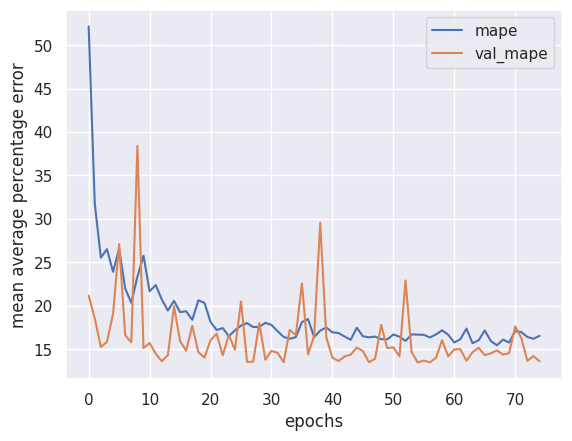

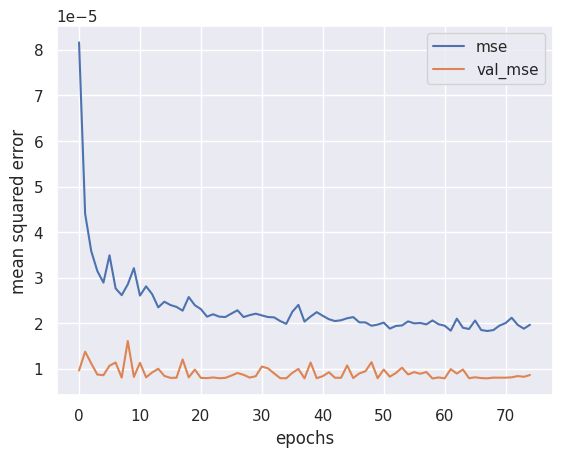

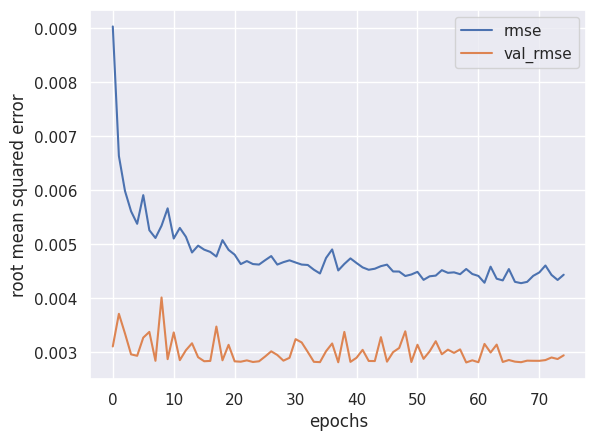

In [340]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

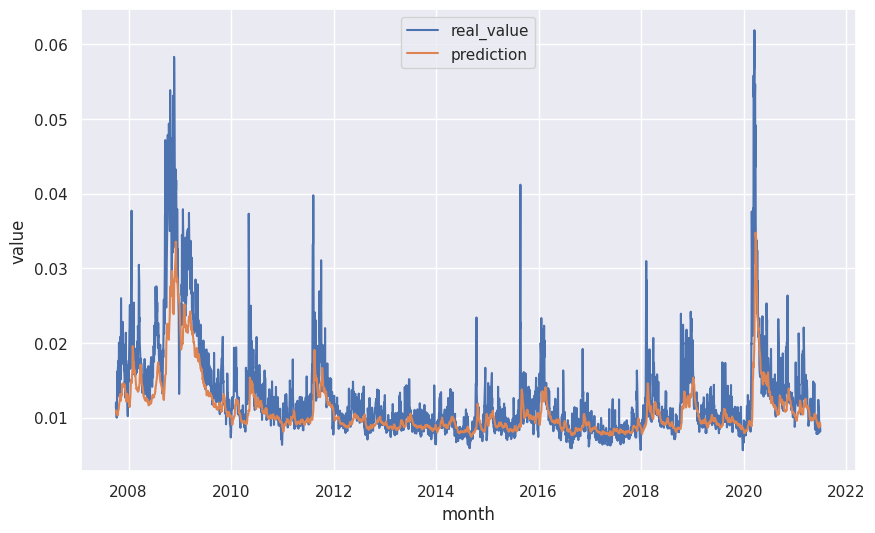

In [341]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

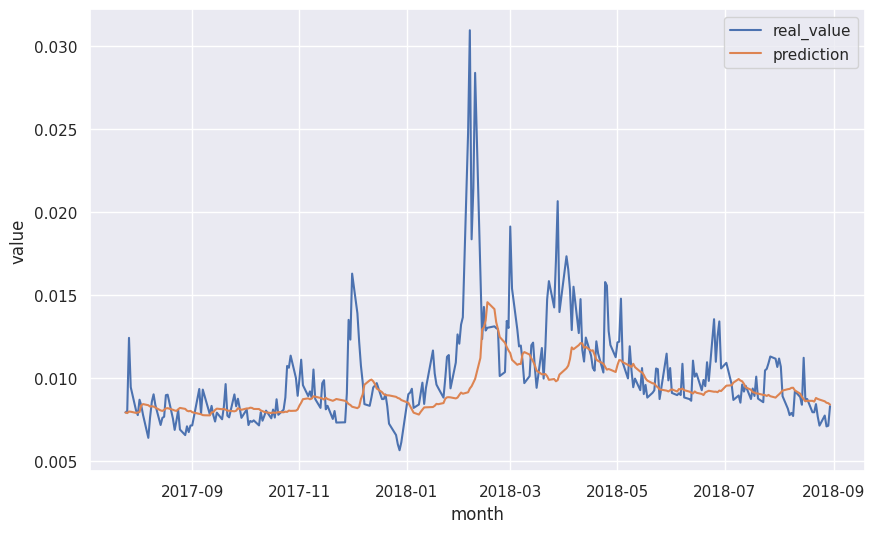

In [342]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Fold 3

##### Test Train & Predict Model (80:20)

In [343]:
# variables
fh = 5
fold = 3

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 32,
    'dropout_rate': 0.4,
    'learning_rate': 0.001,
}

In [344]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [345]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │        19,072 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 22,273 (87.00 KB)

 Trainable params: 22,273 (87.00 KB)

 Non-trainable params: 0 (0.00 B)

In [346]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 15:26:04.070846: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 853429743176954379
2024-12-10 15:26:04.070909: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8230607939261139607
2024-12-10 15:26:04.070917: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12323879435492034455
2024-12-10 15:26:04.070922: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12052962252141974112
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:26:04.694736: I tensorflow/core/framework/local_rendezvous.cc:423] Local r

2024-12-10 15:26:55.830643: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 853429743176954379
2024-12-10 15:26:56.279714: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:26:56.279773: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:26:56.279783: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:27:00.359595: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:27:03.589738: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 853429743176954379
2024-12-10 15:27:03.589789: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv ite

In [347]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 12.2866 - mean_squared_error: 4.6816e-06 - root_mean_squared_error: 0.0021


2024-12-10 15:27:30.741812: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:27:30.741859: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:27:30.741866: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[12.65313720703125, 5.91822345086257e-06, 0.0024327398277819157]

In [348]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


In [349]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


In [350]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [351]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (80:20)

In [352]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

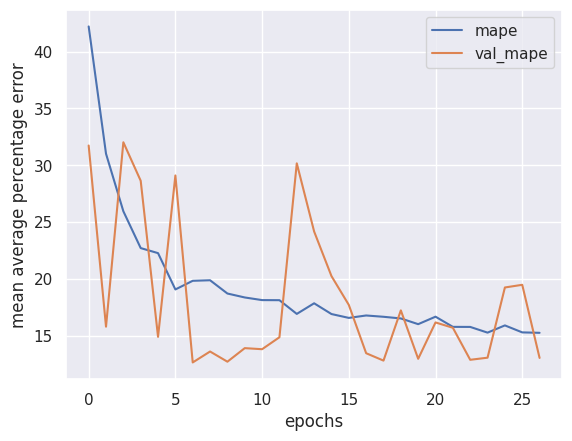

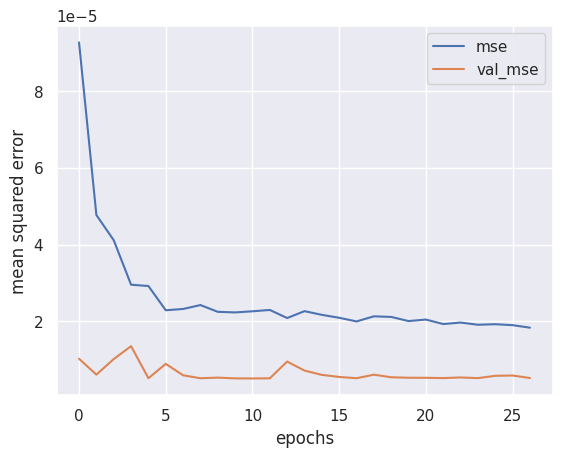

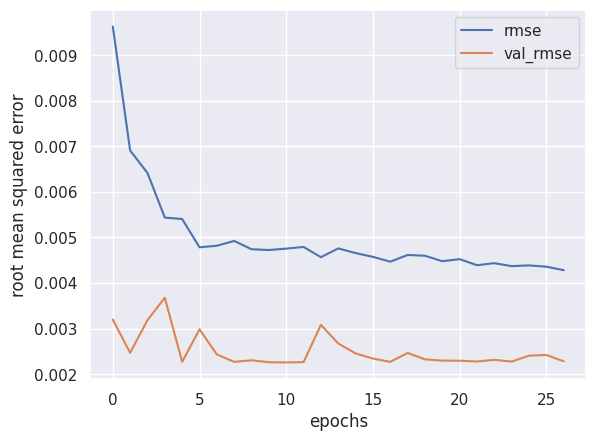

In [353]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

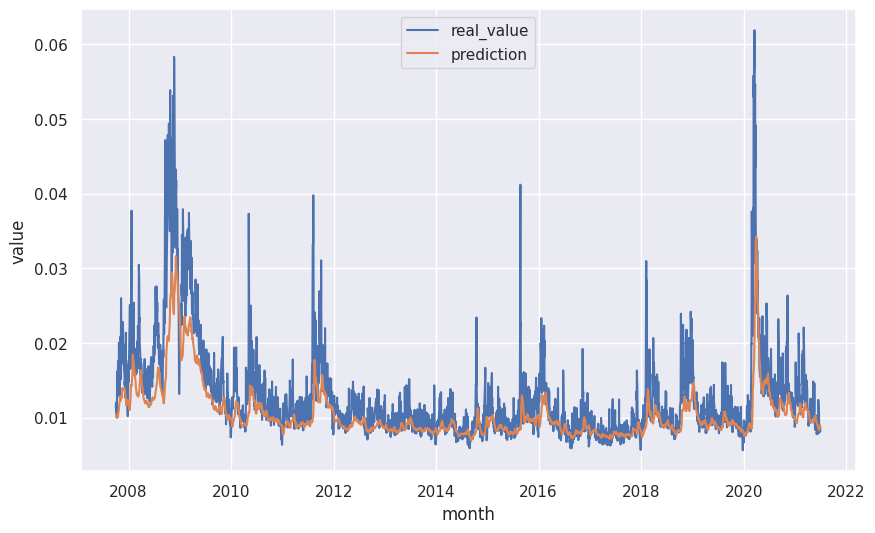

In [354]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

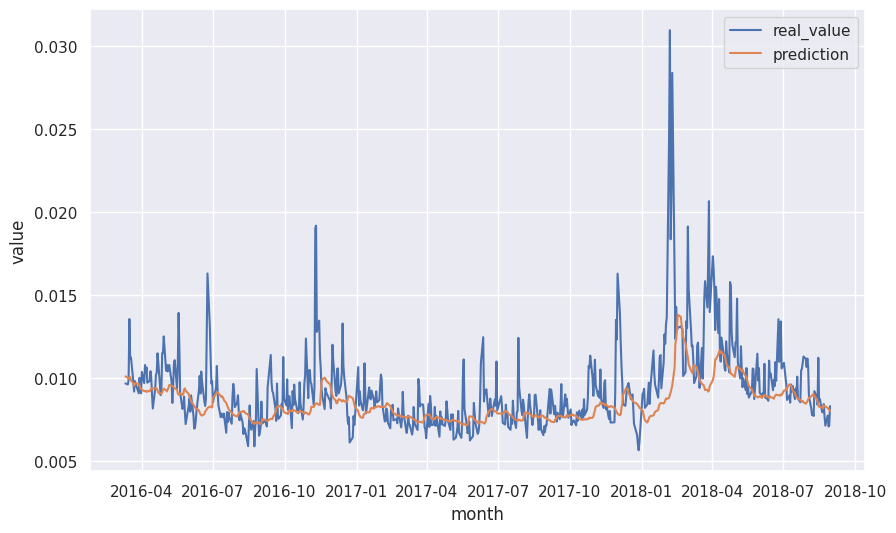

In [355]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (60:40)

In [356]:
# variables
fh = 5
fold = 3

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 32,
    'dropout_rate': 0.4,
    'learning_rate': 0.001,
}

In [357]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [358]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │        19,072 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 22,273 (87.00 KB)

 Trainable params: 22,273 (87.00 KB)

 Non-trainable params: 0 (0.00 B)

In [359]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 15:27:38.779215: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12323879435492034455
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:27:39.669657: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:27:39.669725: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:27:39.669733: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:27:41.884034: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

2024-12-10 15:27:53.458450: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12323879435492034455
2024-12-10 15:27:54.144184: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:27:54.144246: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:27:54.144256: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:27:56.962942: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12323879435492034455
2024-12-10 15:27:57.869396: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:27:57.869445: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv

In [360]:
# evaluate model
model.evaluate(example_test_ds)

41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - loss: 14.2780 - mean_squared_error: 2.1020e-05 - root_mean_squared_error: 0.0046


2024-12-10 15:29:16.331351: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:29:16.331413: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:29:16.331424: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[14.376877784729004, 1.9507628167048097e-05, 0.004416744224727154]

In [361]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 2s 20ms/step


In [362]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step


In [363]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv', index=False)

In [364]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (60:40)

In [365]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv')

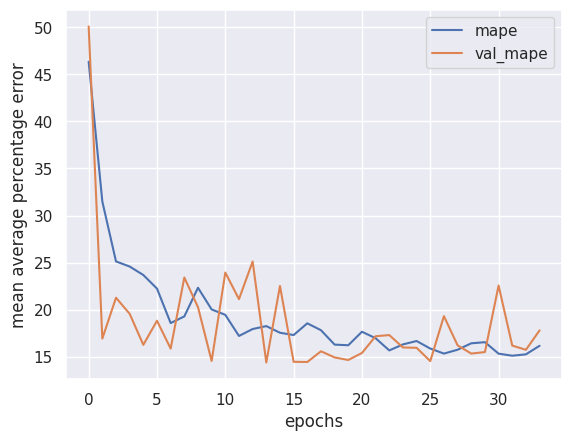

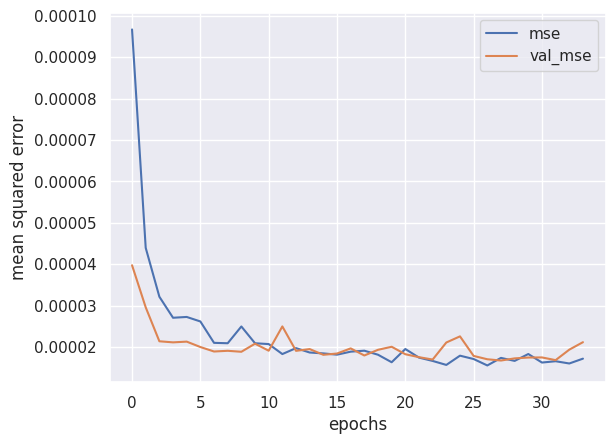

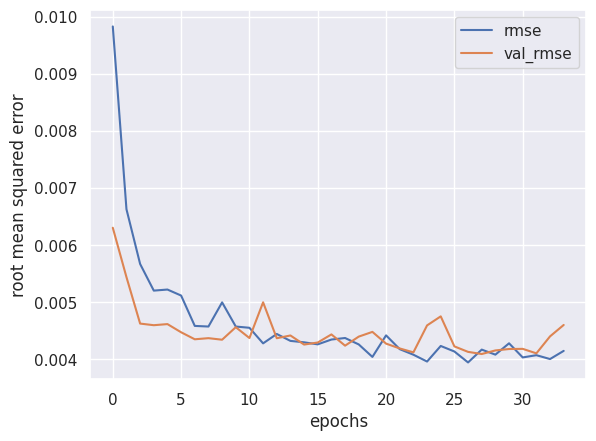

In [366]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

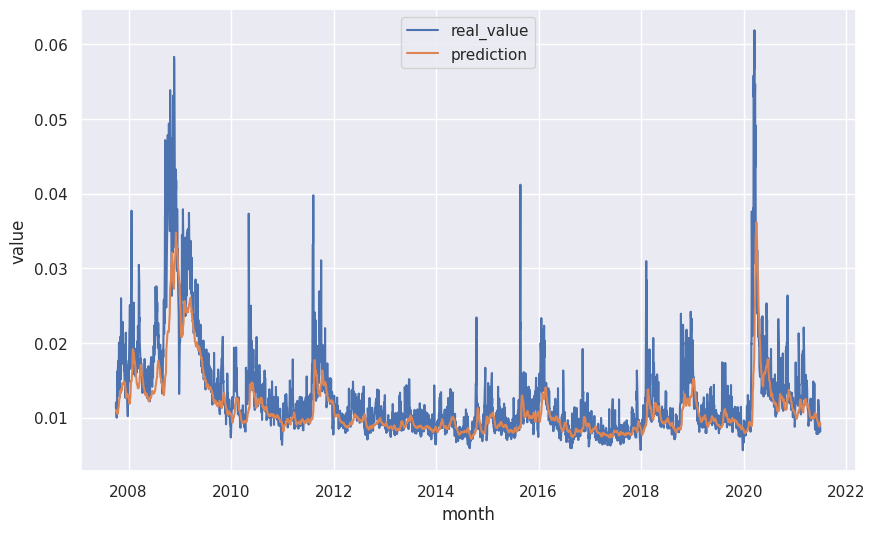

In [367]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

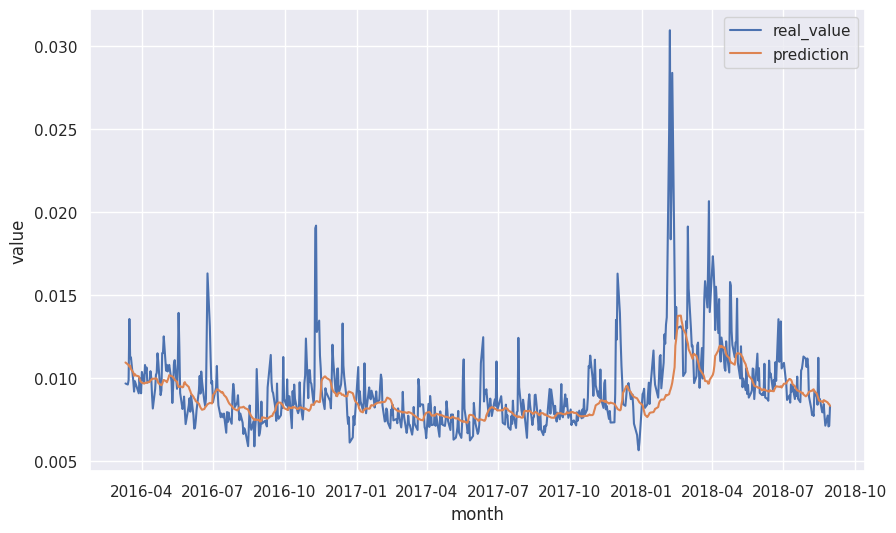

In [368]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [369]:
# variables
fh = 5
fold = 3

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 32,
    'dropout_rate': 0.4,
    'learning_rate': 0.001,
}

In [370]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [371]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │        19,072 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 22,273 (87.00 KB)

 Trainable params: 22,273 (87.00 KB)

 Non-trainable params: 0 (0.00 B)

In [372]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 15:29:27.619651: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 853429743176954379
2024-12-10 15:29:27.619752: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8230607939261139607
2024-12-10 15:29:27.619766: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12052962252141974112
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:29:28.310736: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:29:28.310837: I tensorflow/core/framework/local_rendezvous.cc:423] Local r

2024-12-10 15:29:51.827732: I tensorflow/core/framework/local_rendezvous.cc:427] Local rendezvous send item cancelled. Key hash: 17893896090302227125
2024-12-10 15:29:51.827796: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 853429743176954379
2024-12-10 15:29:51.827805: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8230607939261139607
2024-12-10 15:29:51.827808: I tensorflow/core/framework/local_rendezvous.cc:427] Local rendezvous send item cancelled. Key hash: 11855552136780833497
2024-12-10 15:29:51.827814: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12323879435492034455
2024-12-10 15:29:51.827819: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12052962252141974112
2024-12-10 15:29:52.038195: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv 

In [373]:
# evaluate model
model.evaluate(example_test_ds)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 13.1724 - mean_squared_error: 7.1525e-06 - root_mean_squared_error: 0.0027


2024-12-10 15:30:43.792755: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:30:43.792813: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:30:43.792822: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[13.111531257629395, 6.776739610359073e-06, 0.0026032172609120607]

In [374]:
# predict using model using all 100% data
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step


In [375]:
# predict using model using test data
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


In [376]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [377]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (50% 80:20)

In [378]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

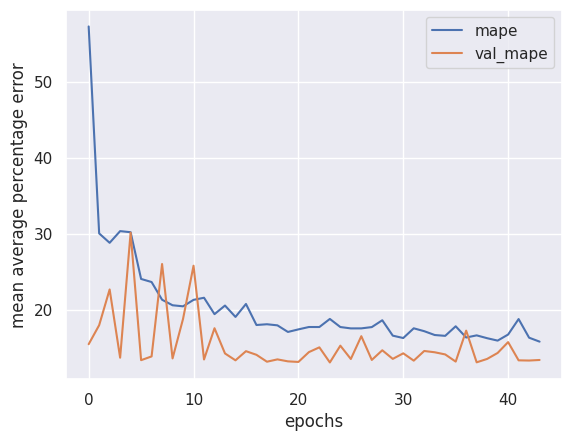

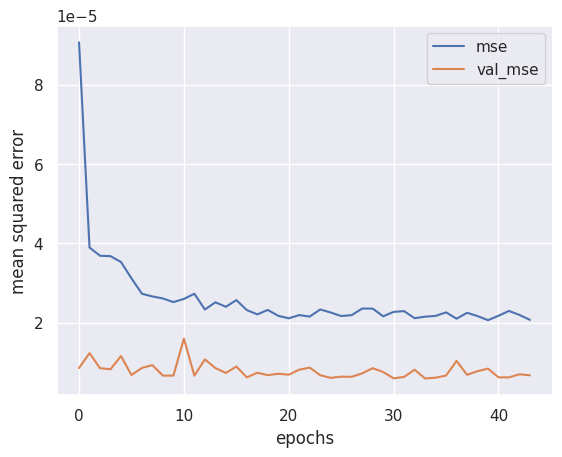

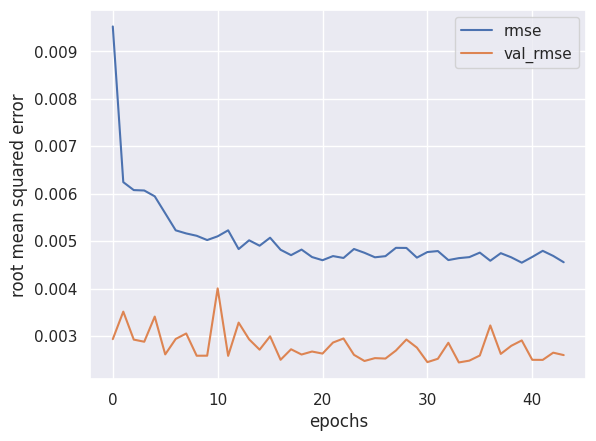

In [379]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

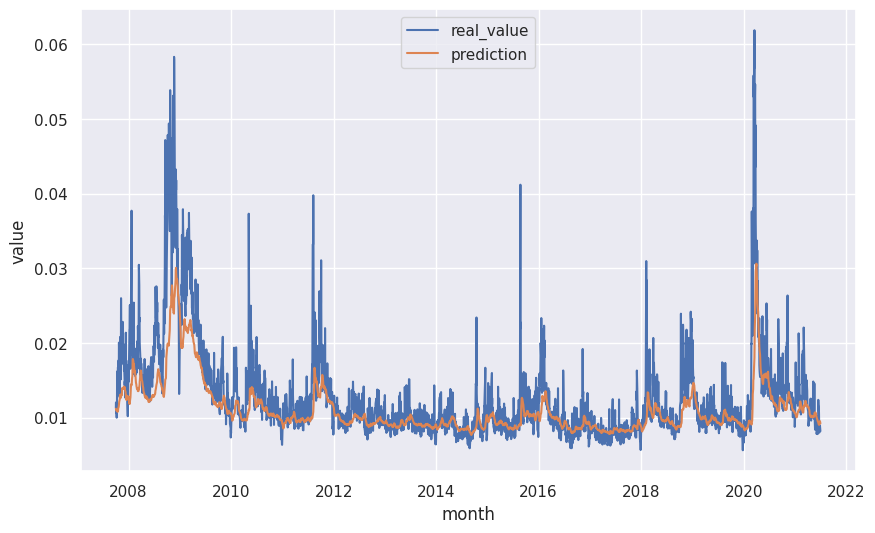

In [380]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

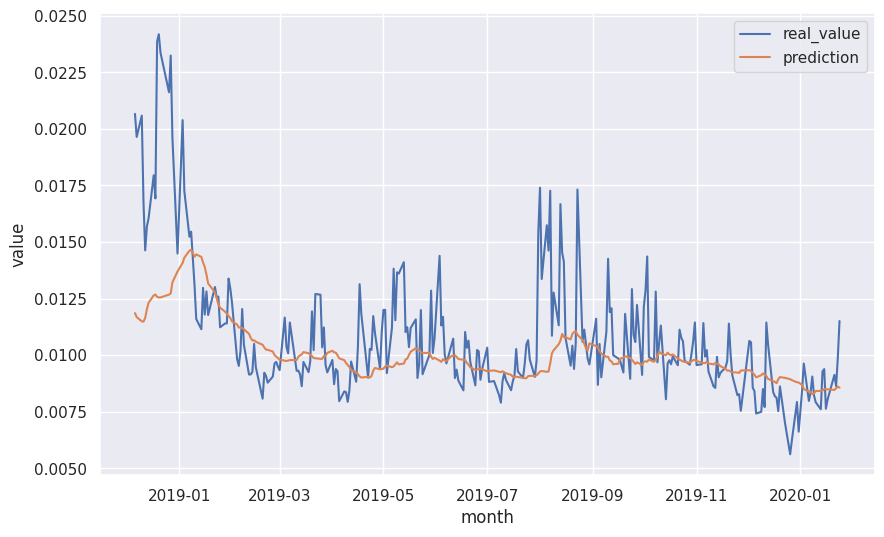

In [381]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Fold 4

##### Test Train & Predict Model (80:20)

In [382]:
# variables
fh = 5
fold = 4

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 32,
    'dropout_rate': 0.4,
    'learning_rate': 0.001,
}

In [383]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [384]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │        19,072 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 22,273 (87.00 KB)

 Trainable params: 22,273 (87.00 KB)

 Non-trainable params: 0 (0.00 B)

In [385]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:30:52.681213: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:30:52.681265: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:30:52.681273: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:30:55.830442: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:30:55.830500: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

In [386]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 15.4246 - mean_squared_error: 2.9518e-05 - root_mean_squared_error: 0.0054


2024-12-10 15:32:58.520850: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:32:58.520903: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:32:58.520910: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[15.422501564025879, 3.063108670176007e-05, 0.005534535739570856]

In [387]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


In [388]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


In [389]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [390]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (80:20)

In [391]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

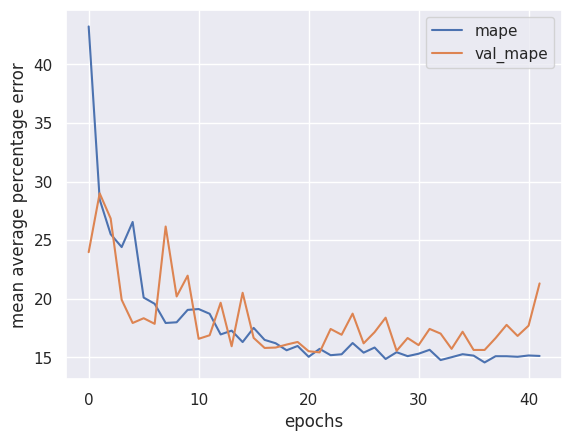

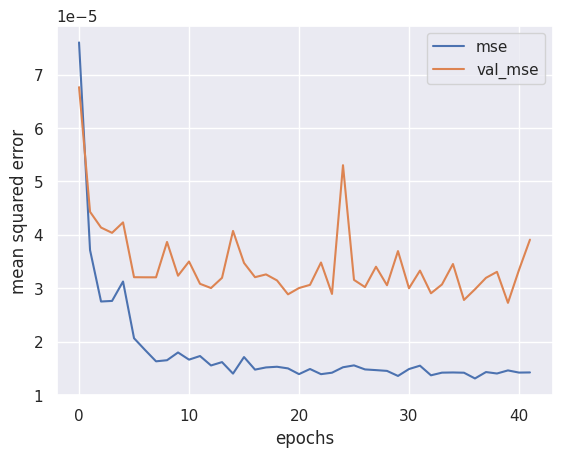

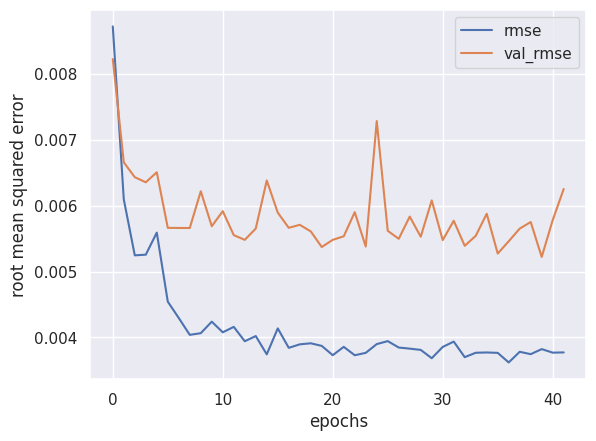

In [392]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

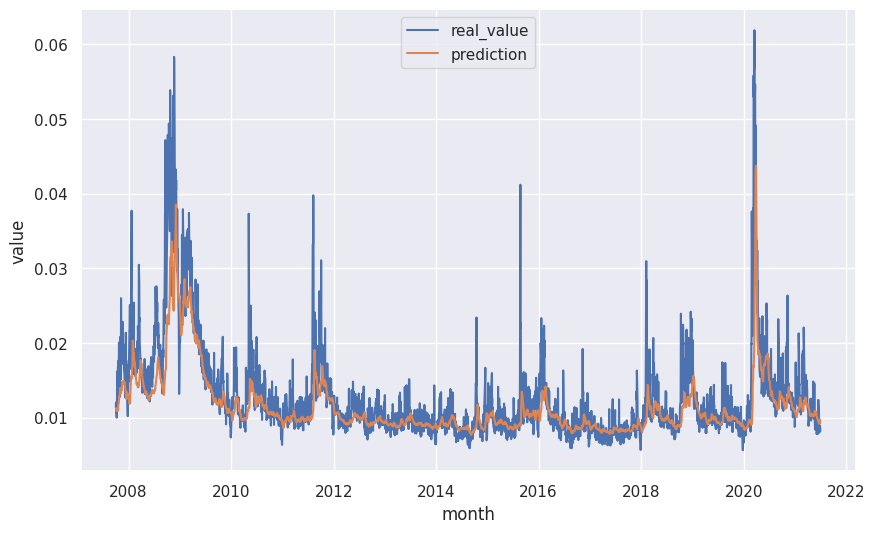

In [393]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

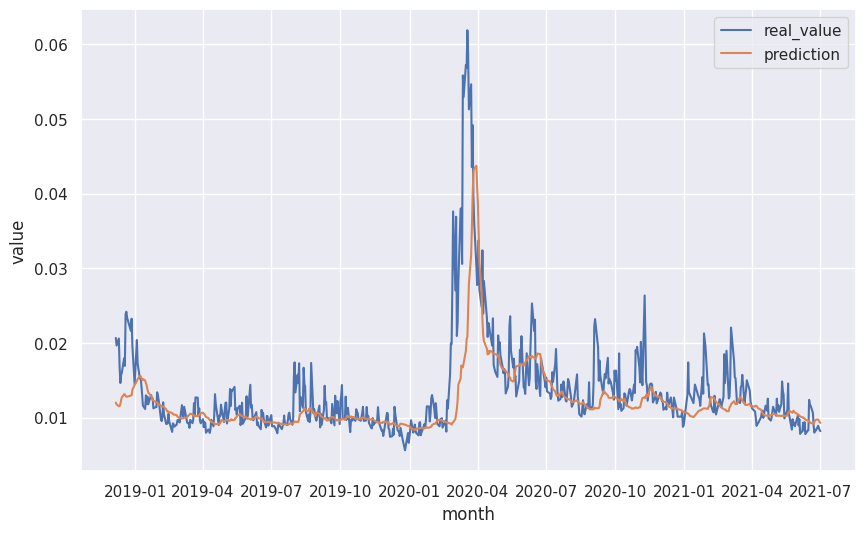

In [394]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [395]:
# variables
fh = 5
fold = 4

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 32,
    'dropout_rate': 0.4,
    'learning_rate': 0.001,
}

In [396]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [397]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 32)             │        19,072 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 32)             │         3,168 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 22,273 (87.00 KB)

 Trainable params: 22,273 (87.00 KB)

 Non-trainable params: 0 (0.00 B)

In [398]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:33:09.547375: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:33:09.547421: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:33:09.547428: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:33:11.055761: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:33:11.055812: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

2024-12-10 15:33:54.481938: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:33:54.482008: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:33:54.482034: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:33:55.911766: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:33:55.911815: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:33:55.911824: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:33:57.478924: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv i

In [399]:
# evaluate model
model.evaluate(example_test_ds)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 15.1815 - mean_squared_error: 1.1403e-05 - root_mean_squared_error: 0.0034


2024-12-10 15:34:14.380009: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:34:14.380134: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[14.253605842590332, 9.548135494696908e-06, 0.003090005600824952]

In [400]:
# predict using model using all 100% data
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


In [401]:
# predict using model using test data
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


In [402]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [403]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (50% 80:20)

In [404]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

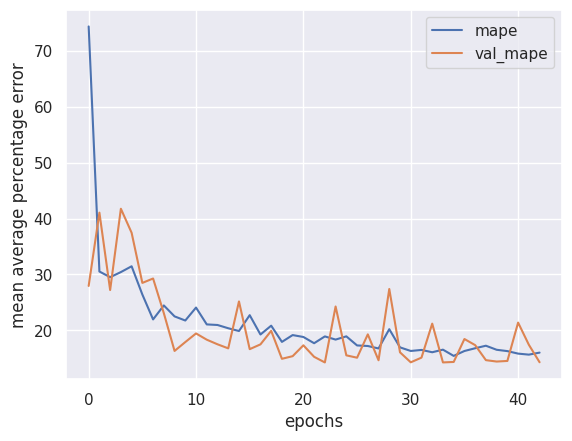

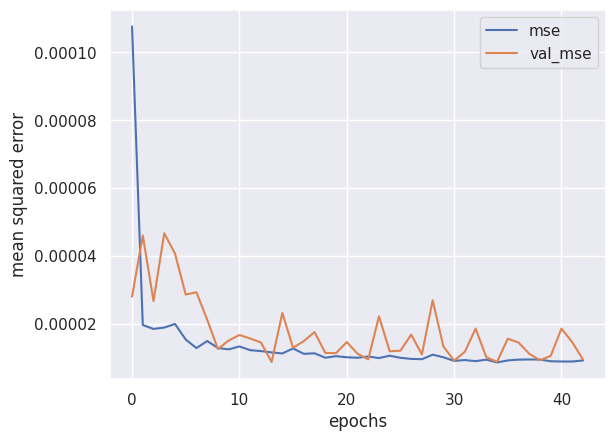

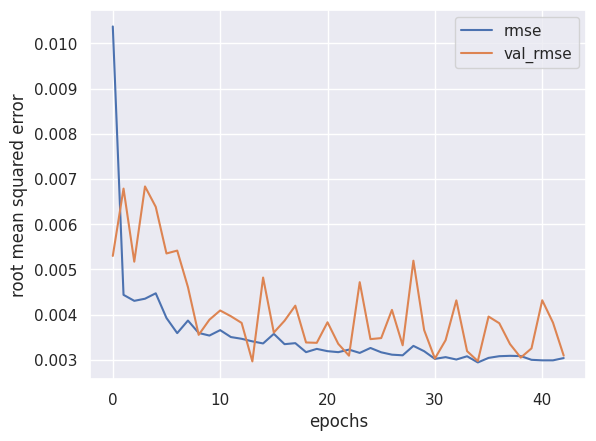

In [405]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

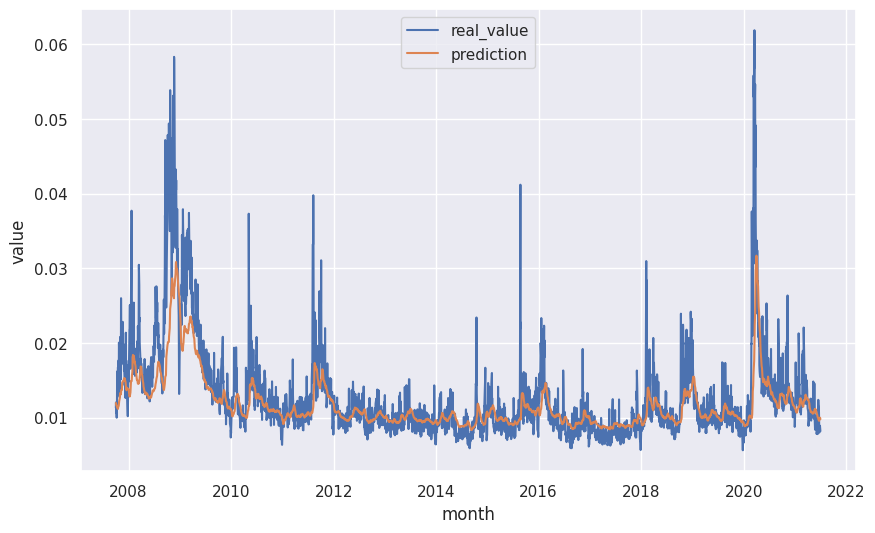

In [406]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

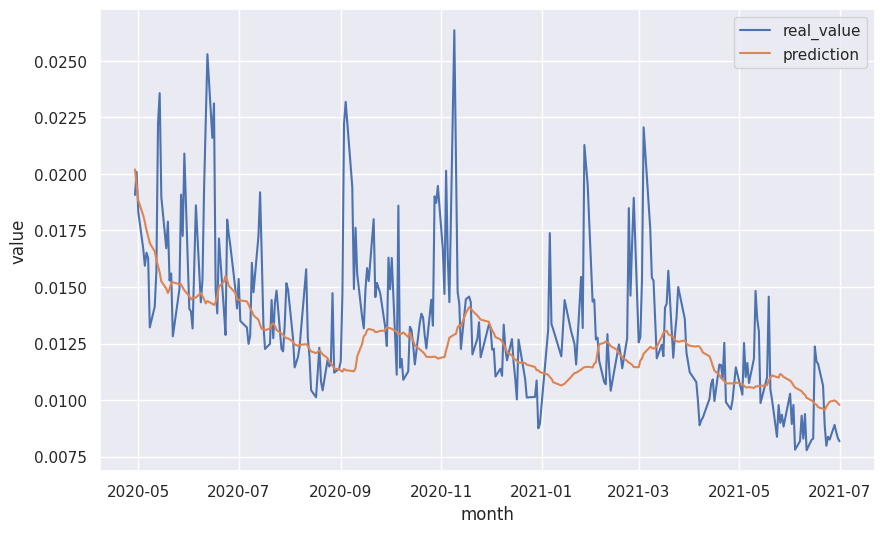

In [407]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Summary

In [408]:
# variables
fh = 5

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 32,
    'dropout_rate': 0.4,
    'learning_rate': 0.001,
}

60:40

In [409]:
# load model in keras format
bilstm_models = [tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras') for fold in range(4)]

# load test dataset
example_test_dss = []
for fold in range(4):
    example_test_dss.append(create_window_dataset(
        series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/test_{fold}.npy'), axis=-1),
        window_size=example_hps['window_size'],
        forecast_horizon=fh,
        batch_size=batch_size,
        shuffle_buffer=shuffle_buffer,
    ))

In [410]:
# evaluate model
evaluation_results = np.array([bilstm_models[fold].evaluate(example_test_dss[fold]) for fold in range(4)])

41/41 ━━━━━━━━━━━━━━━━━━━━ 2s 21ms/step - loss: 13.9220 - mean_squared_error: 1.9102e-05 - root_mean_squared_error: 0.0044


2024-12-10 15:34:20.502144: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 13.1368 - mean_squared_error: 9.6082e-06 - root_mean_squared_error: 0.0031


2024-12-10 15:34:21.635227: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:34:21.635284: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809


41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 13.1328 - mean_squared_error: 5.5058e-06 - root_mean_squared_error: 0.0023


2024-12-10 15:34:22.802506: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:34:22.802559: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 14.7896 - mean_squared_error: 2.4887e-05 - root_mean_squared_error: 0.0050


2024-12-10 15:34:23.868875: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:34:23.868918: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:34:23.868924: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


In [411]:
evaluation_results

array([[1.39900827e+01, 1.83717784e-05, 4.28623101e-03],
       [1.29326382e+01, 7.41395615e-06, 2.72285799e-03],
       [1.34883833e+01, 6.46333228e-06, 2.54230830e-03],
       [1.43768778e+01, 1.95076336e-05, 4.41674469e-03]])

In [412]:
np.mean(evaluation_results, axis=0)

array([1.36969955e+01, 1.29391751e-05, 3.49203550e-03])

50% 80:20

In [413]:
# load model in keras format
bilstm_models = [tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras') for fold in range(5)]

# load test dataset
example_test_dss = []
for fold in range(5):
    example_test_dss.append(create_window_dataset(
        series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
        window_size=example_hps['window_size'],
        forecast_horizon=fh,
        batch_size=batch_size,
        shuffle_buffer=shuffle_buffer,
    ))

In [414]:
# evaluate model
evaluation_results = np.array([bilstm_models[fold].evaluate(example_test_dss[fold]) for fold in range(5)])

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 15.3526 - mean_squared_error: 8.6082e-06 - root_mean_squared_error: 0.0029


2024-12-10 15:34:25.385276: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:34:25.385324: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:34:25.385330: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 11.2879 - mean_squared_error: 3.0130e-06 - root_mean_squared_error: 0.0017


2024-12-10 15:34:25.853114: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 13.5460 - mean_squared_error: 9.8353e-06 - root_mean_squared_error: 0.0031


2024-12-10 15:34:26.331095: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:34:26.331146: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:34:26.331153: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 12.7537 - mean_squared_error: 4.9776e-06 - root_mean_squared_error: 0.0022


2024-12-10 15:34:26.795359: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:34:26.795417: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:34:26.795435: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 14.2003 - mean_squared_error: 8.6467e-06 - root_mean_squared_error: 0.0029


2024-12-10 15:34:27.256276: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:34:27.256330: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:34:27.256336: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


In [415]:
evaluation_results

array([[1.51999998e+01, 1.09838074e-05, 3.31418263e-03],
       [1.18529720e+01, 2.95277550e-06, 1.71836419e-03],
       [1.34700670e+01, 8.77079401e-06, 2.96155270e-03],
       [1.31115322e+01, 6.77673916e-06, 2.60321703e-03],
       [1.42536049e+01, 9.54813640e-06, 3.09000583e-03]])

In [416]:
np.mean(evaluation_results, axis=0)

array([1.35776352e+01, 7.80645050e-06, 2.73746448e-03])

### FH 10

#### Fold 0

##### Test Train & Predict Model (80:20)

In [417]:
# variables
fh = 10
fold = 0

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 4,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [418]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [419]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 8)              │         3,488 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 16)             │           688 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,193 (16.38 KB)

 Trainable params: 4,193 (16.38 KB)

 Non-trainable params: 0 (0.00 B)

In [420]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 15:34:31.979367: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10194791562091923487
2024-12-10 15:34:31.979436: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7594130884354051451
2024-12-10 15:34:31.979448: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12841425709832301044
2024-12-10 15:34:31.979453: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5367462930519278244
2024-12-10 15:34:32.608448: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:34:32.609149: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:34:32.609182: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv 

2024-12-10 15:34:52.283346: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10194791562091923487
2024-12-10 15:34:52.283413: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7594130884354051451
2024-12-10 15:34:52.283426: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12841425709832301044
2024-12-10 15:34:52.283433: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5367462930519278244
2024-12-10 15:34:52.751799: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:34:55.597833: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10194791562091923487
2024-12-10 15:34:55.597881: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv 

In [421]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 18.6850 - mean_squared_error: 4.6038e-05 - root_mean_squared_error: 0.0068


2024-12-10 15:36:16.309559: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:36:16.309611: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:36:16.309618: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[18.17705535888672, 4.458388139028102e-05, 0.006677116267383099]

In [422]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


In [423]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step


In [424]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [425]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (80:20)

In [426]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

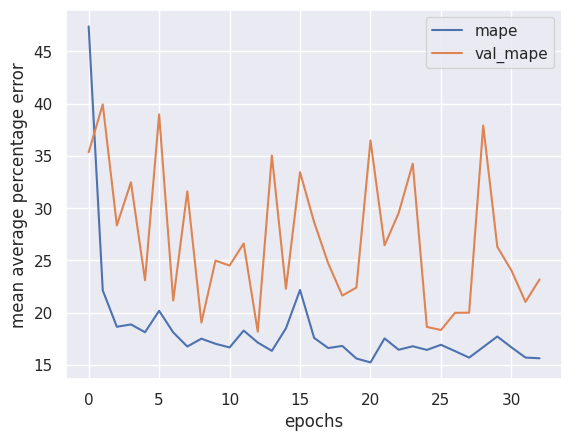

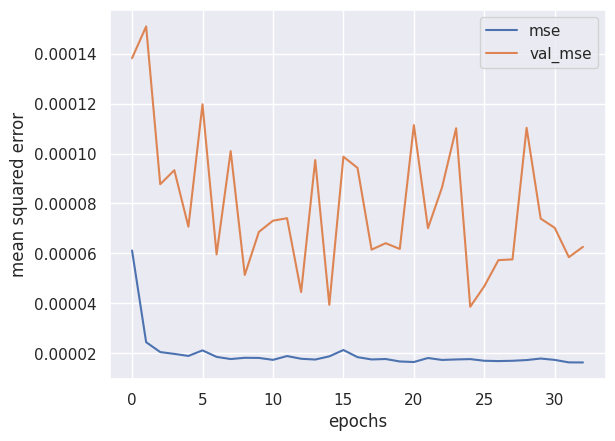

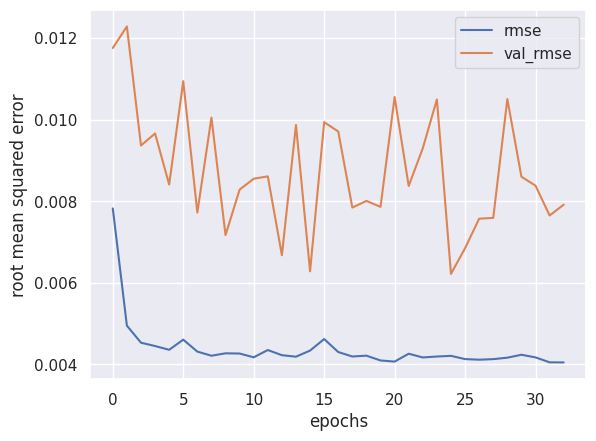

In [427]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

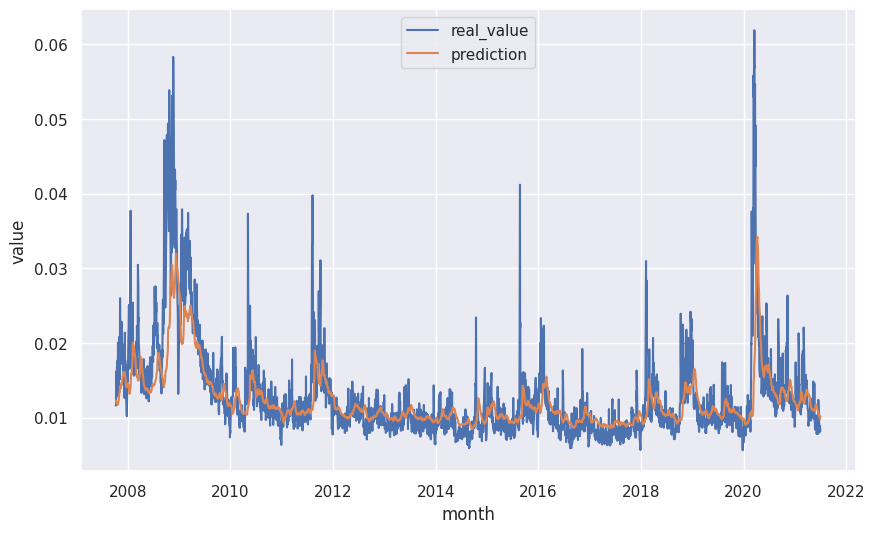

In [428]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

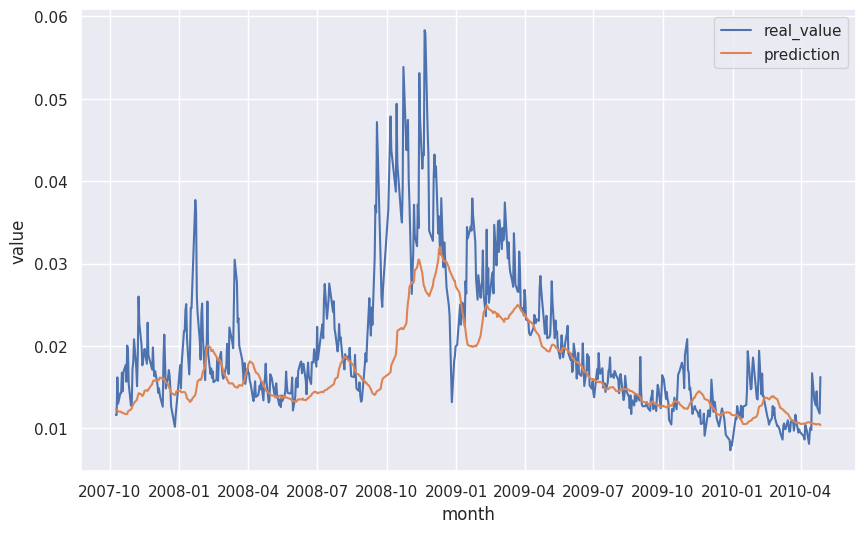

In [429]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (60:40)

In [430]:
# variables
fh = 10
fold = 0

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 4,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [431]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [432]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 8)              │         3,488 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 16)             │           688 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,193 (16.38 KB)

 Trainable params: 4,193 (16.38 KB)

 Non-trainable params: 0 (0.00 B)

In [433]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 15:36:24.229870: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10194791562091923487
2024-12-10 15:36:24.229934: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7594130884354051451
2024-12-10 15:36:24.229981: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12841425709832301044
2024-12-10 15:36:24.230021: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5367462930519278244
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:36:25.302162: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

2024-12-10 15:36:52.919889: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:36:52.919944: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:36:52.919951: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:36:55.446483: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:36:55.446528: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:36:55.446534: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:36:57.398621: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv i

In [434]:
# evaluate model
model.evaluate(example_test_ds)

41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - loss: 15.9220 - mean_squared_error: 2.7981e-05 - root_mean_squared_error: 0.0053


2024-12-10 15:39:34.639073: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:39:34.639121: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:39:34.639128: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[15.477740287780762, 2.7026950192521326e-05, 0.005198745056986809]

In [435]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step


In [436]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step


In [437]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv', index=False)

In [438]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (60:40)

In [439]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv')

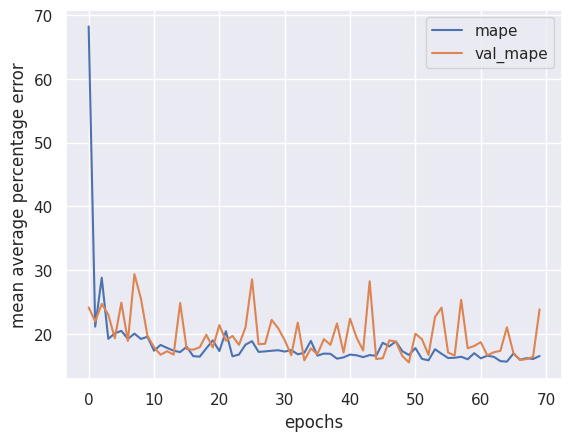

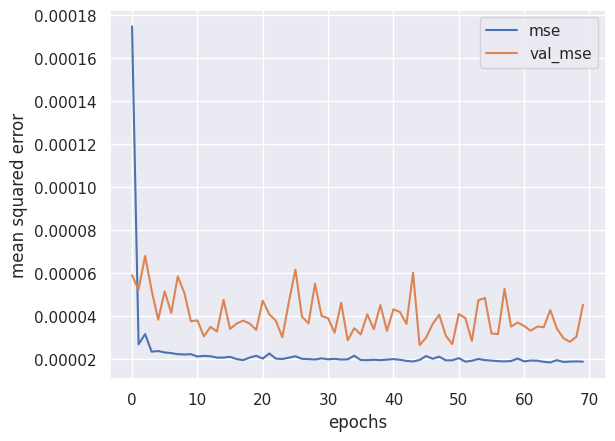

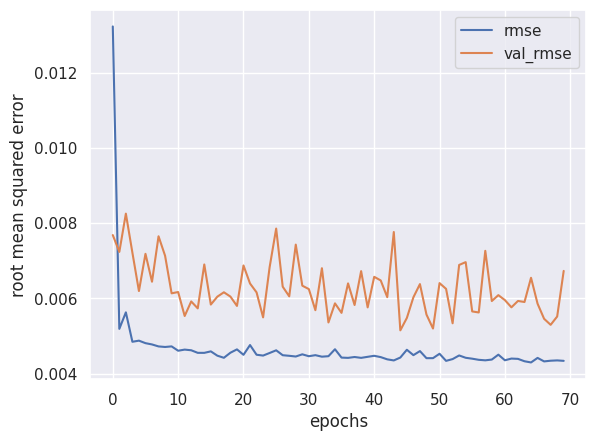

In [440]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

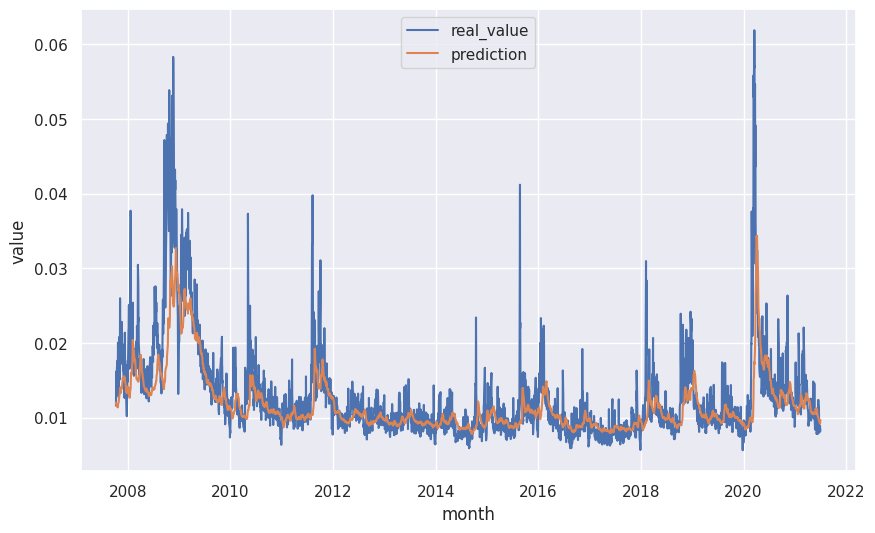

In [441]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

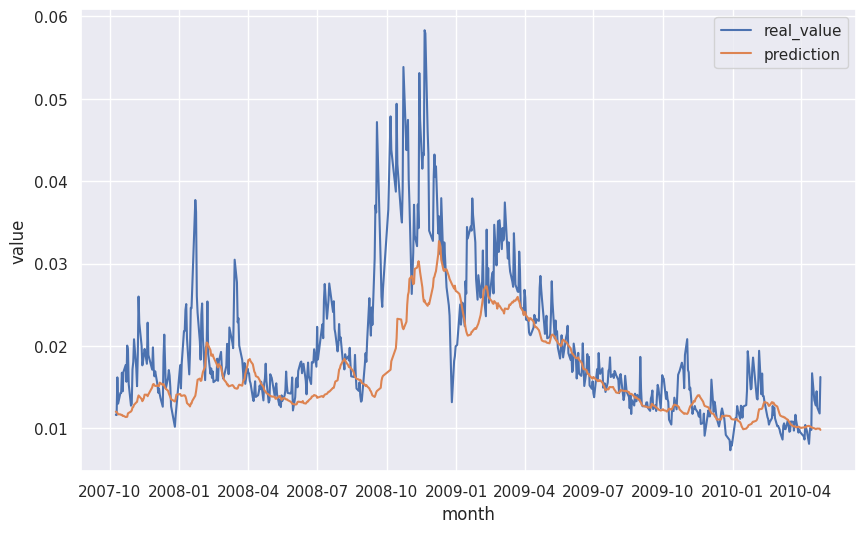

In [442]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [443]:
# variables
fh = 10
fold = 0

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 4,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [444]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [445]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 8)              │         3,488 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 16)             │           688 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,193 (16.38 KB)

 Trainable params: 4,193 (16.38 KB)

 Non-trainable params: 0 (0.00 B)

In [446]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:39:43.483521: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:39:43.483580: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:39:43.483590: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:39:45.426841: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:39:45.426925: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

2024-12-10 15:39:51.862839: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:39:51.862879: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:39:51.862887: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:39:53.722200: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:39:53.722239: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:39:53.722248: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:39:55.201803: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv i

In [447]:
# evaluate model
model.evaluate(example_test_ds)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 15.5945 - mean_squared_error: 1.0056e-05 - root_mean_squared_error: 0.0032


2024-12-10 15:40:39.275581: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437


[15.361787796020508, 1.0334236321796197e-05, 0.0032146908342838287]

In [448]:
# predict using model using all 100% data
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step


In [449]:
# predict using model using test data
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


In [450]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [451]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (50% 80:20)

In [452]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

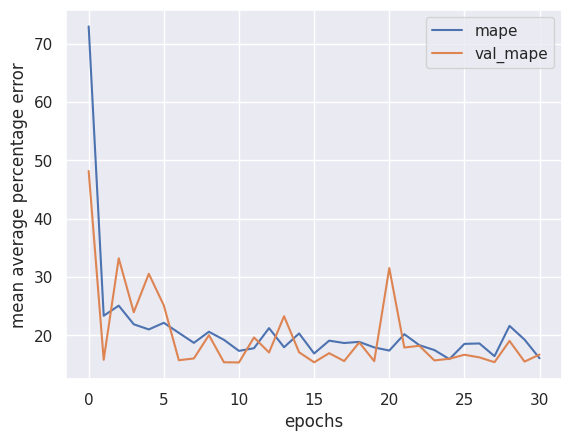

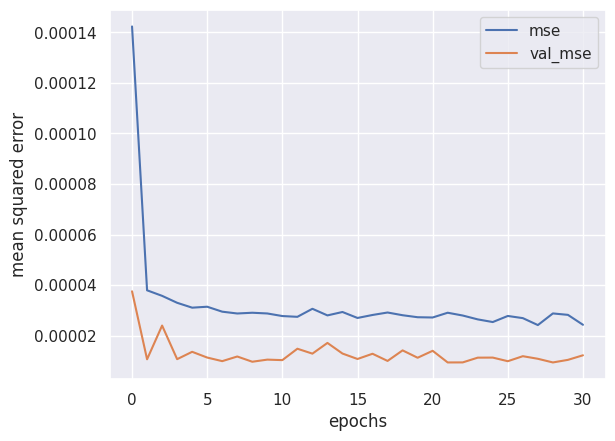

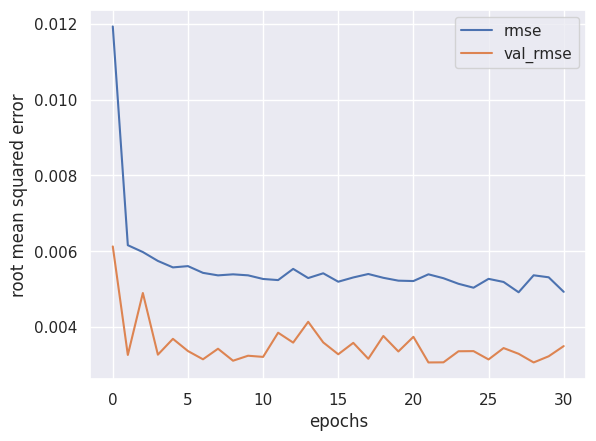

In [453]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

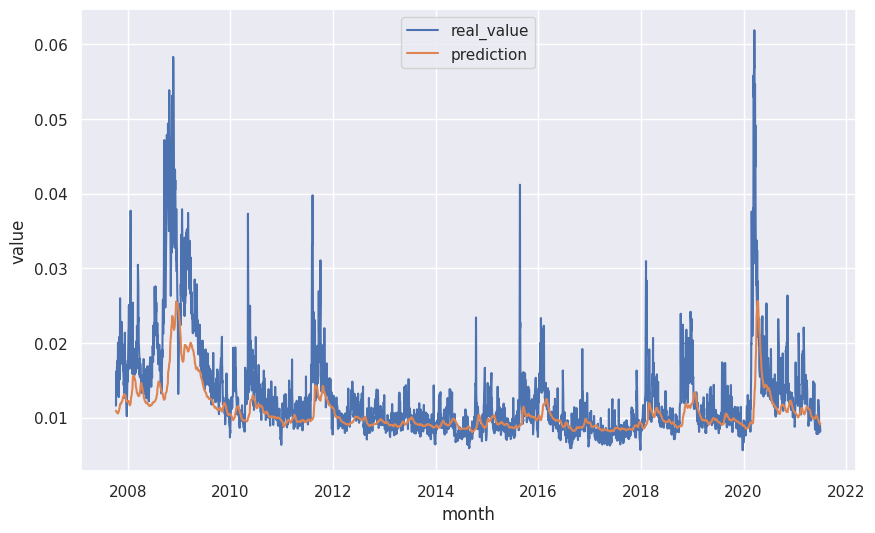

In [454]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

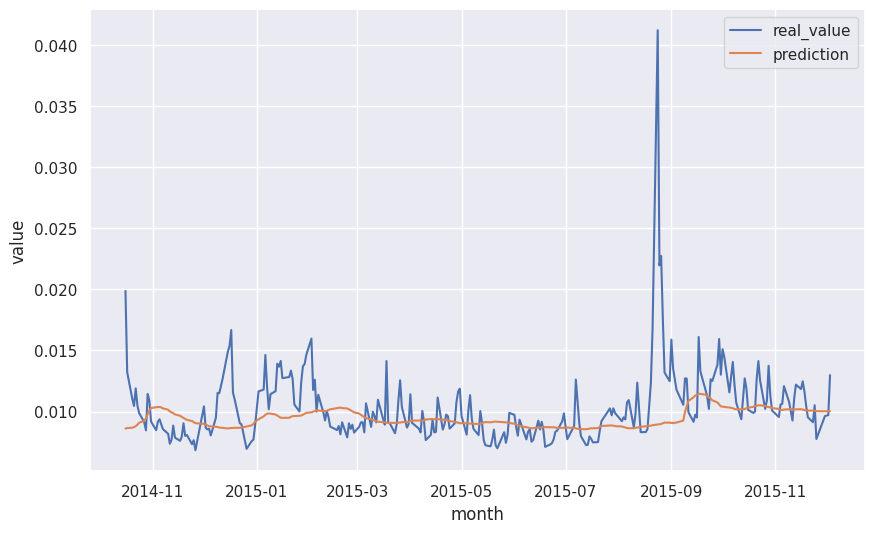

In [455]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Fold 1

##### Test Train & Predict Model (80:20)

In [456]:
# variables
fh = 10
fold = 1

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 4,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [457]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [458]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 8)              │         3,488 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 16)             │           688 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,193 (16.38 KB)

 Trainable params: 4,193 (16.38 KB)

 Non-trainable params: 0 (0.00 B)

In [459]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 15:40:48.676179: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10194791562091923487
2024-12-10 15:40:48.676246: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7594130884354051451
2024-12-10 15:40:48.676258: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12841425709832301044
2024-12-10 15:40:48.676264: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5367462930519278244
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:40:49.381178: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

2024-12-10 15:40:52.750100: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:40:52.750166: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:40:52.750175: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:40:56.118822: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:40:56.118879: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:40:56.118888: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:40:59.285014: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv i

In [460]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 13.4164 - mean_squared_error: 1.0786e-05 - root_mean_squared_error: 0.0033


2024-12-10 15:42:00.057052: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:42:00.057109: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:42:00.057120: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[13.267101287841797, 1.0943330380541738e-05, 0.0033080705907195807]

In [461]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step


In [462]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step


In [463]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [464]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (80:20)

In [465]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

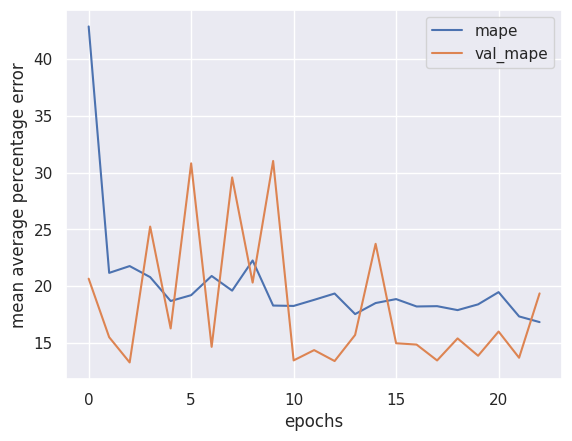

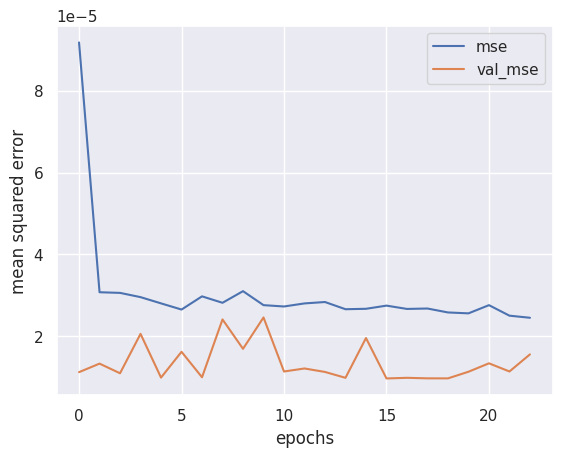

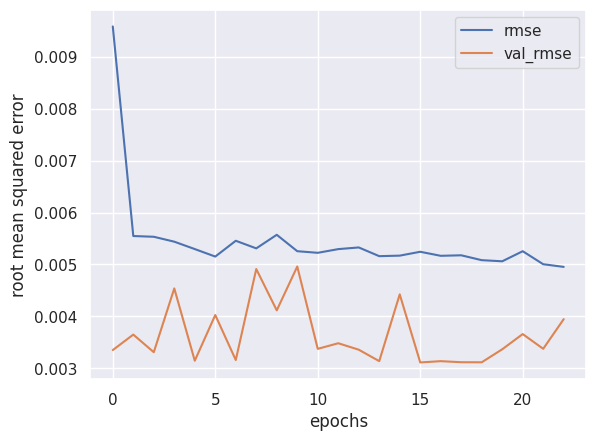

In [466]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

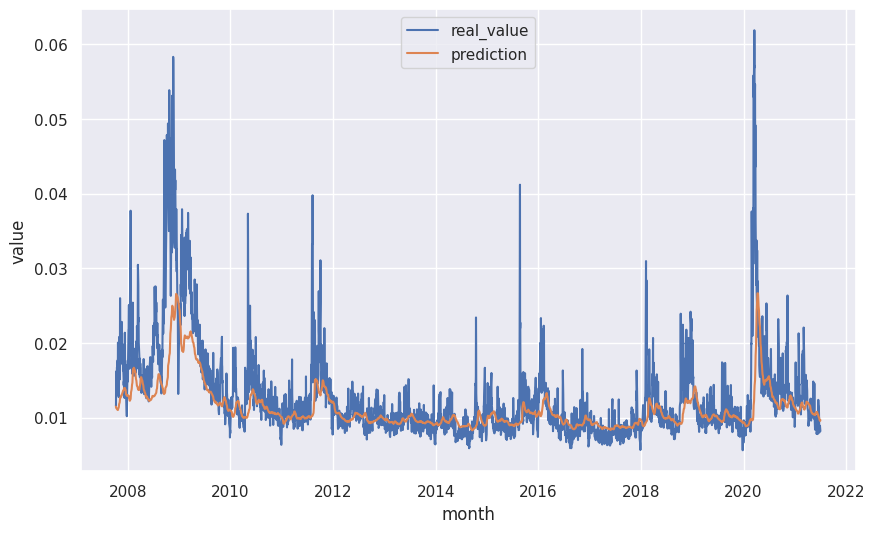

In [467]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

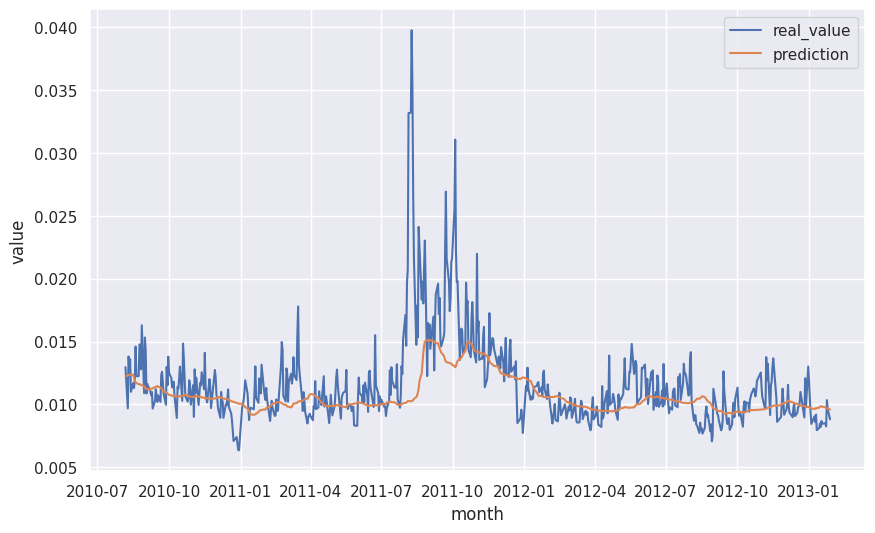

In [468]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (60:40)

In [469]:
# variables
fh = 10
fold = 1

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 4,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [470]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [471]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 8)              │         3,488 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 16)             │           688 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,193 (16.38 KB)

 Trainable params: 4,193 (16.38 KB)

 Non-trainable params: 0 (0.00 B)

In [472]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 15:42:08.237842: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10194791562091923487
2024-12-10 15:42:08.237906: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7594130884354051451
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:42:09.182529: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:42:09.182587: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:42:09.182594: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

2024-12-10 15:42:53.360829: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:42:53.360876: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:42:53.360885: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:42:56.279518: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:42:56.279572: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:42:56.279581: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:42:58.244328: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv i

In [473]:
# evaluate model
model.evaluate(example_test_ds)

41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 13.7924 - mean_squared_error: 1.0137e-05 - root_mean_squared_error: 0.0032


2024-12-10 15:44:53.220645: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:44:53.220698: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:44:53.220706: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[13.610562324523926, 8.20160948933335e-06, 0.002863845322281122]

In [474]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


In [475]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


In [476]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv', index=False)

In [477]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (60:40)

In [478]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv')

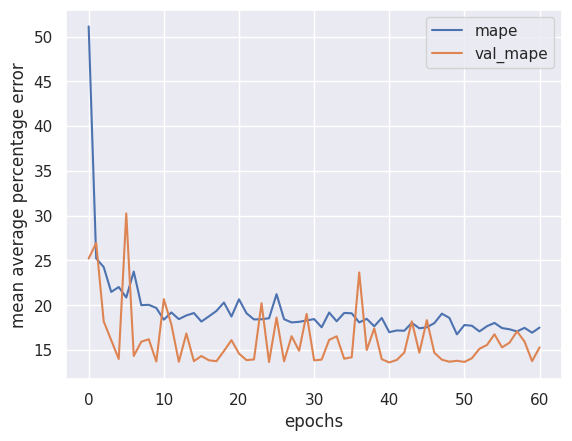

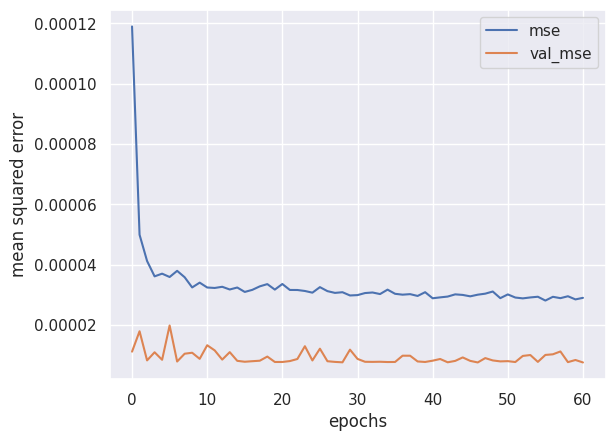

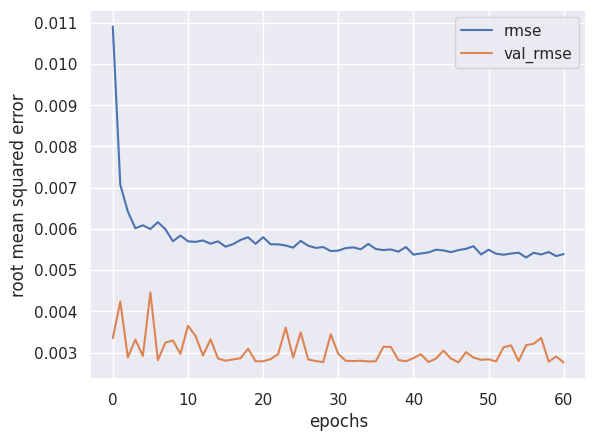

In [479]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

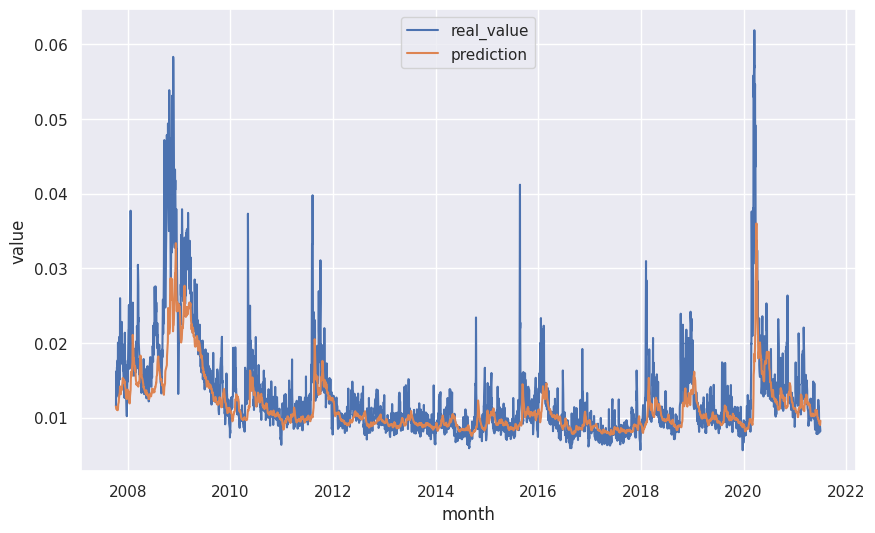

In [480]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

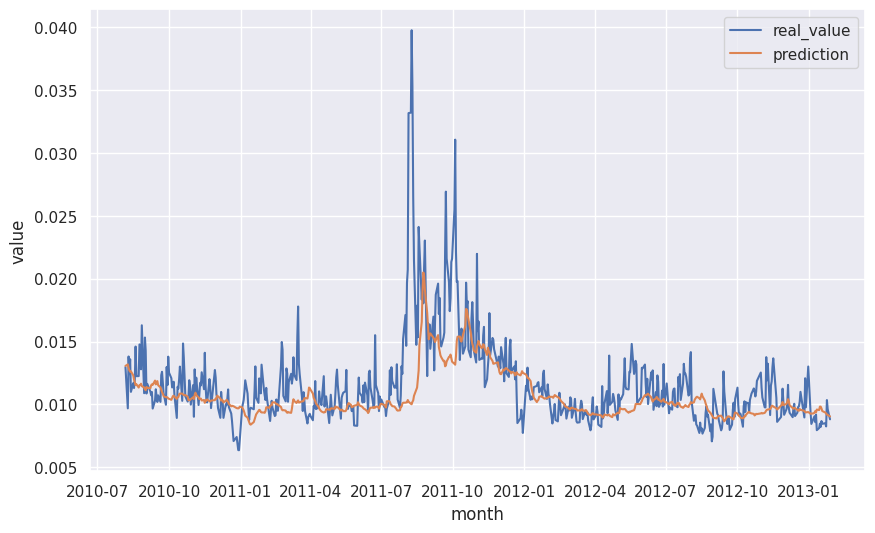

In [481]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [482]:
# variables
fh = 10
fold = 1

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 4,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [483]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [484]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 8)              │         3,488 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 16)             │           688 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,193 (16.38 KB)

 Trainable params: 4,193 (16.38 KB)

 Non-trainable params: 0 (0.00 B)

In [485]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 15:45:00.699374: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10194791562091923487
2024-12-10 15:45:00.699426: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7594130884354051451
2024-12-10 15:45:00.699435: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12841425709832301044
2024-12-10 15:45:00.699439: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5367462930519278244
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:45:01.108324: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

2024-12-10 15:45:52.866859: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10194791562091923487
2024-12-10 15:45:52.866910: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7594130884354051451
2024-12-10 15:45:52.866918: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12841425709832301044
2024-12-10 15:45:53.035435: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:45:53.035492: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:45:53.035500: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:45:54.630049: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv 

In [486]:
# evaluate model
model.evaluate(example_test_ds)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 12.8409 - mean_squared_error: 3.3582e-06 - root_mean_squared_error: 0.0018


2024-12-10 15:46:13.006393: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:46:13.006449: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:46:13.007416: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[12.04641342163086, 3.0589367270295043e-06, 0.0017489816527813673]

In [487]:
# predict using model using all 100% data
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step


In [488]:
# predict using model using test data
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


In [489]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [490]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (50% 80:20)

In [491]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

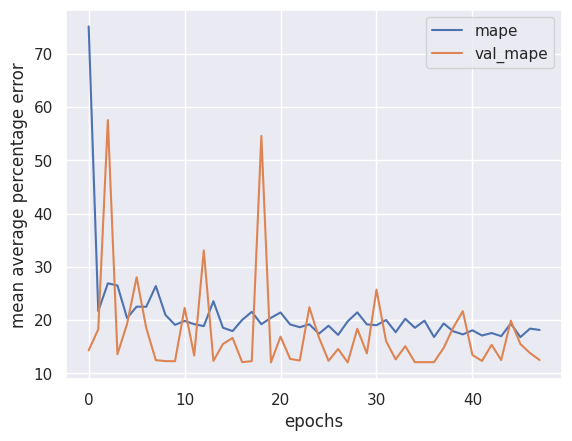

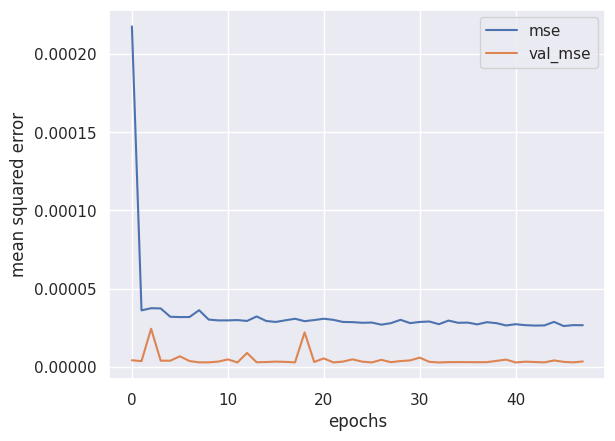

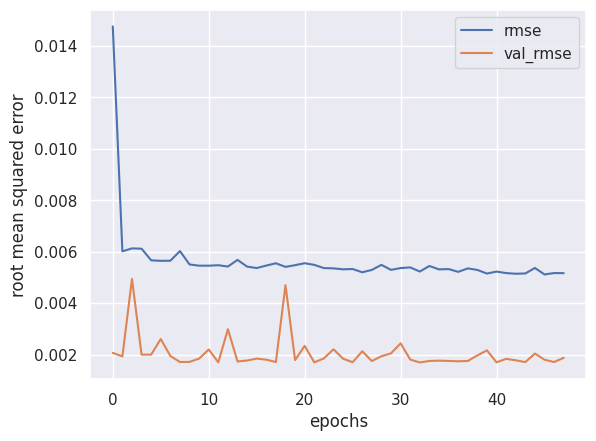

In [492]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

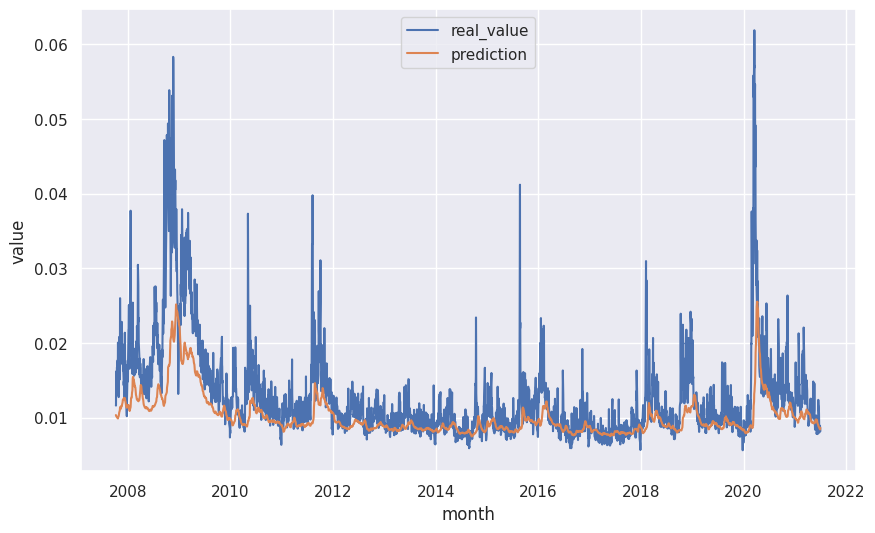

In [493]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

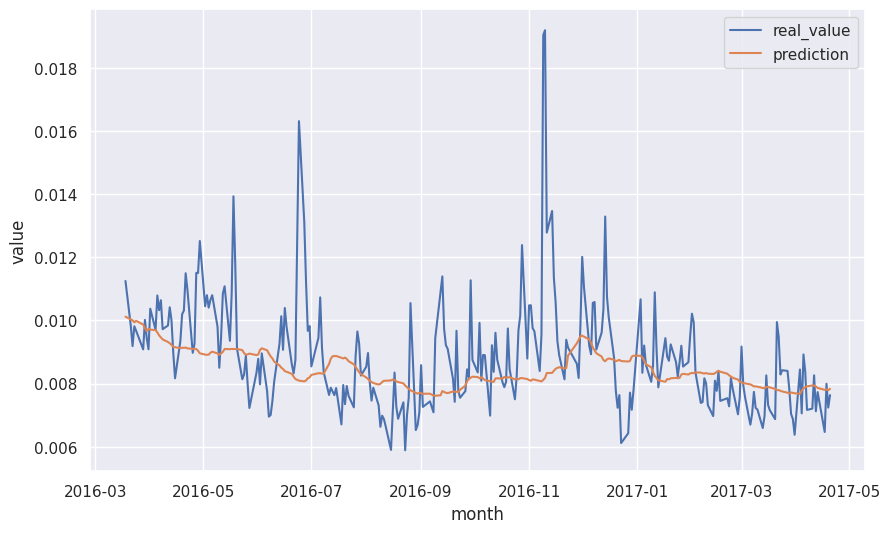

In [494]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Fold 2

##### Test Train & Predict Model (80:20)

In [495]:
# variables
fh = 10
fold = 2

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 4,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [496]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [497]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 8)              │         3,488 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 16)             │           688 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,193 (16.38 KB)

 Trainable params: 4,193 (16.38 KB)

 Non-trainable params: 0 (0.00 B)

In [498]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 15:46:22.006535: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10194791562091923487
2024-12-10 15:46:22.006610: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7594130884354051451
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:46:22.648475: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:46:22.648515: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:46:22.648521: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

2024-12-10 15:46:51.802445: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10194791562091923487
2024-12-10 15:46:52.205067: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:46:52.205133: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:46:52.205143: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:46:55.100720: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10194791562091923487
2024-12-10 15:46:55.593356: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:46:55.593441: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv

In [499]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 13.9424 - mean_squared_error: 6.8565e-06 - root_mean_squared_error: 0.0026


2024-12-10 15:47:50.879743: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:47:50.879790: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:47:50.879797: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[13.9151029586792, 6.8356944211700466e-06, 0.0026145160663872957]

In [500]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

 35/105 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


In [501]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


In [502]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [503]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (80:20)

In [504]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

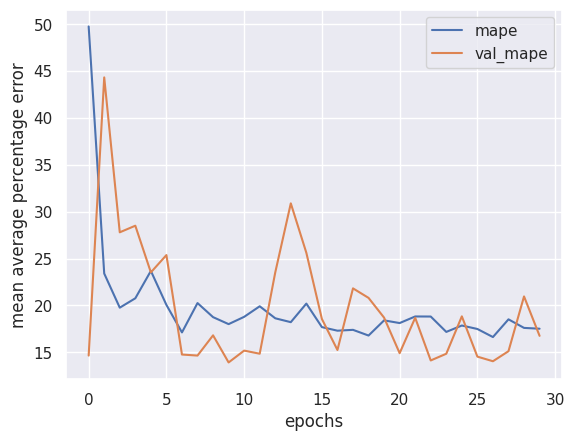

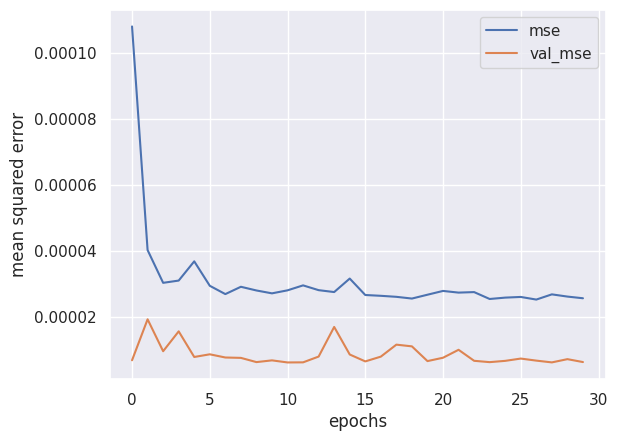

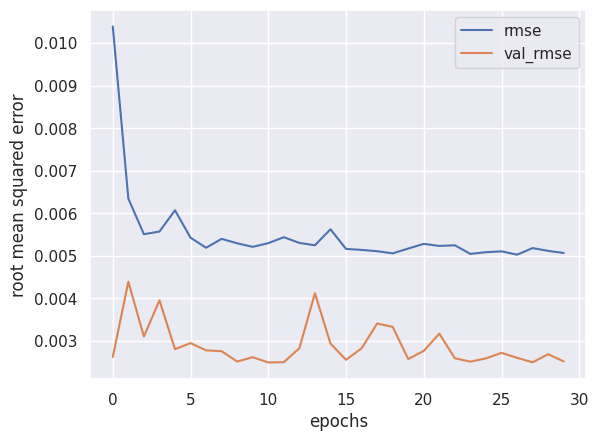

In [505]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

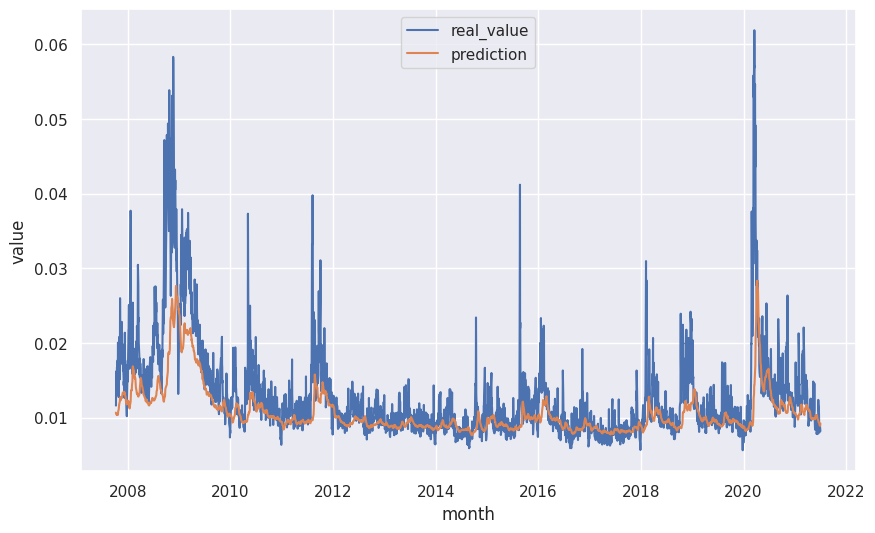

In [506]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

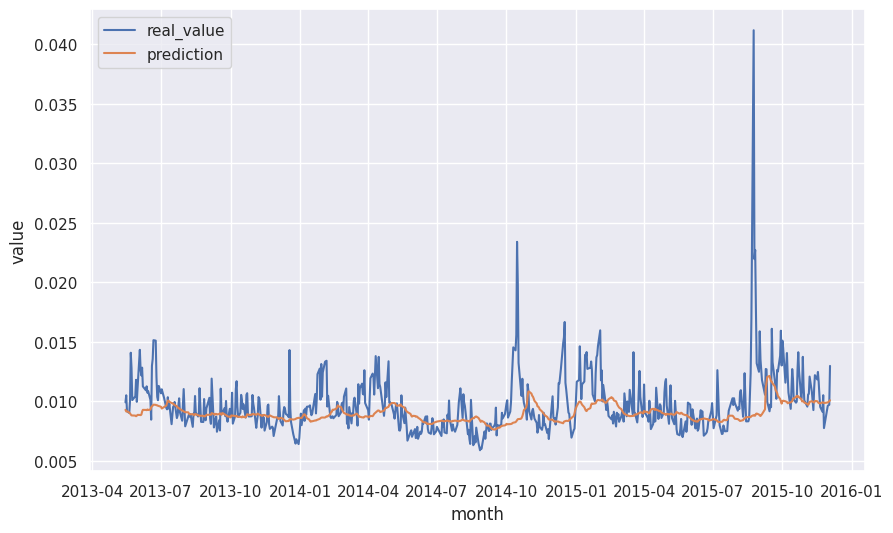

In [507]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (60:40)

In [508]:
# variables
fh = 10
fold = 2

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 4,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [509]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [510]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 8)              │         3,488 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 16)             │           688 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,193 (16.38 KB)

 Trainable params: 4,193 (16.38 KB)

 Non-trainable params: 0 (0.00 B)

In [511]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:48:00.630017: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:48:00.630067: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:48:00.630613: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:48:06.286078: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:48:06.286125: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

2024-12-10 15:48:54.215001: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:48:54.215060: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:48:54.215087: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:48:56.745423: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:48:56.745486: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:48:56.745496: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:48:59.313670: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv i

In [512]:
# evaluate model
model.evaluate(example_test_ds)

41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - loss: 14.0142 - mean_squared_error: 5.8969e-06 - root_mean_squared_error: 0.0024


[14.180296897888184, 7.058229130052496e-06, 0.0026567326858639717]

In [513]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step


In [514]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step


In [515]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv', index=False)

In [516]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (60:40)

In [517]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv')

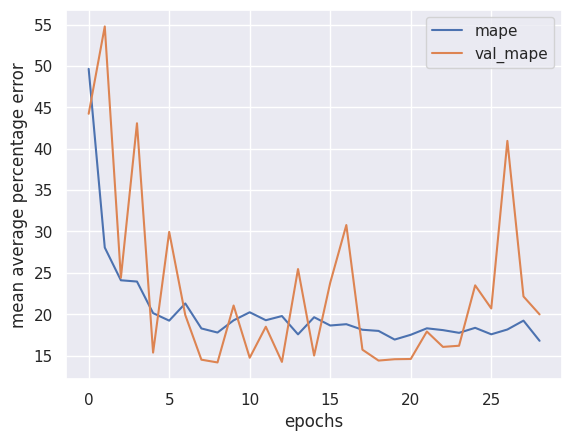

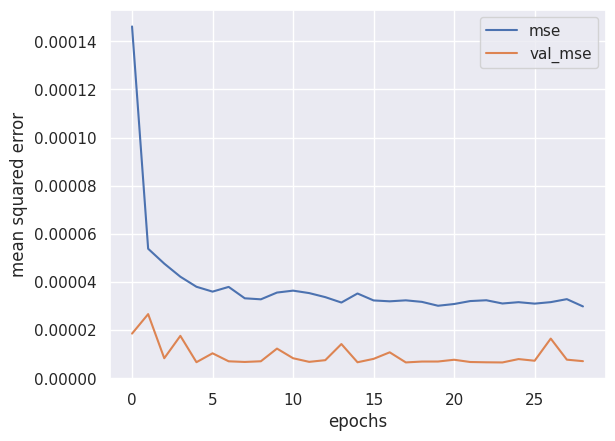

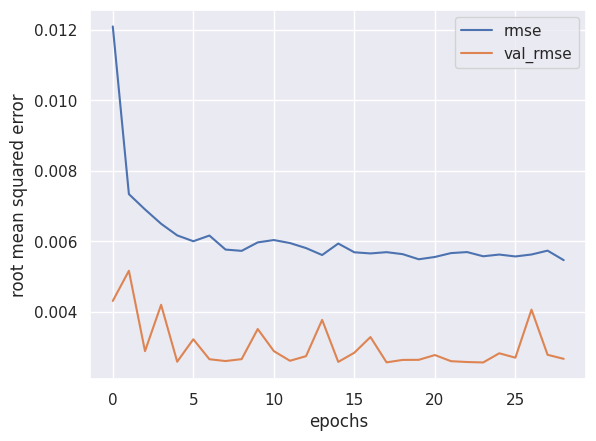

In [518]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

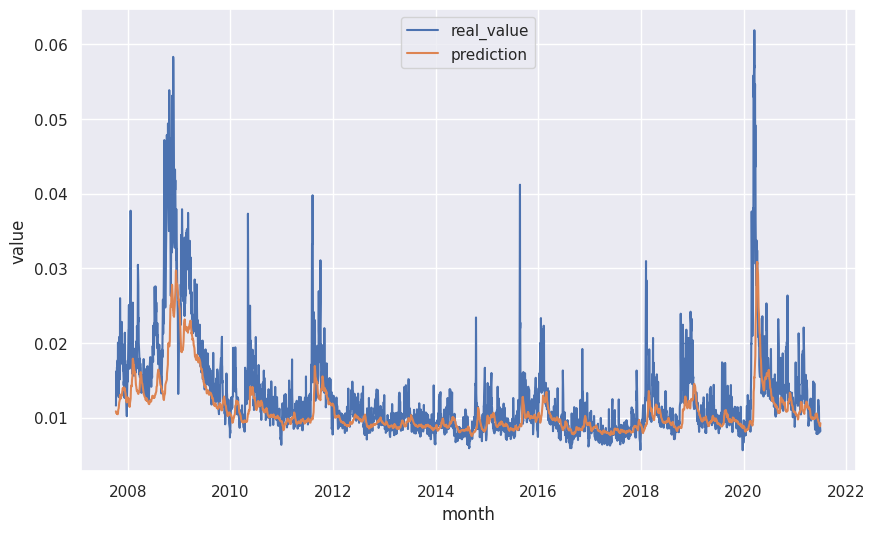

In [519]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

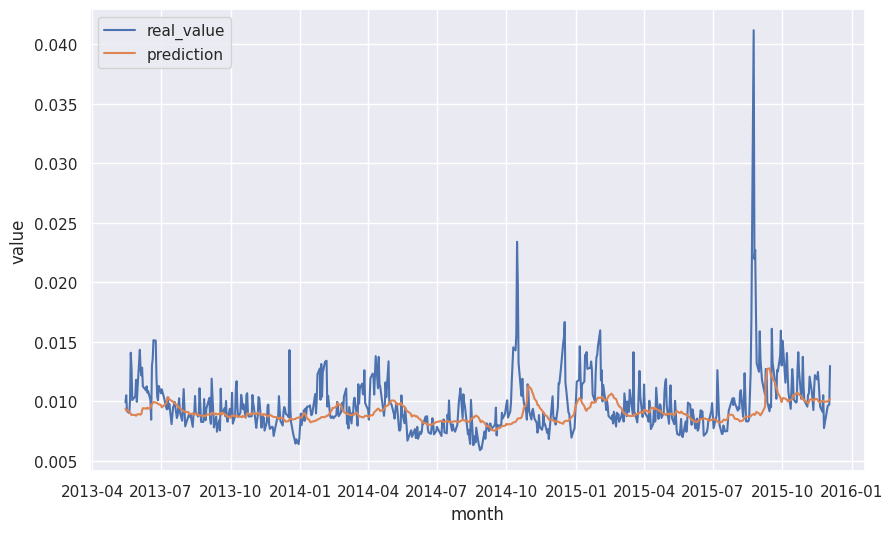

In [520]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [521]:
# variables
fh = 10
fold = 2

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 4,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [522]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [523]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 8)              │         3,488 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 16)             │           688 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,193 (16.38 KB)

 Trainable params: 4,193 (16.38 KB)

 Non-trainable params: 0 (0.00 B)

In [524]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:49:28.411652: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:49:28.411716: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:49:28.411724: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:49:30.049503: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:49:30.049609: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

2024-12-10 15:49:53.282667: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:49:53.282725: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:49:53.282737: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:49:54.685603: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:49:54.685648: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:49:54.685655: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:49:56.289271: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv i

In [525]:
# evaluate model
model.evaluate(example_test_ds)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 15.0786 - mean_squared_error: 1.1374e-05 - root_mean_squared_error: 0.0034


2024-12-10 15:50:48.851874: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:50:48.851917: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:50:48.851926: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[14.524850845336914, 9.956575922842603e-06, 0.0031554042361676693]

In [526]:
# predict using model using all 100% data
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step


In [527]:
# predict using model using test data
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


In [528]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [529]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (50% 80:20)

In [530]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

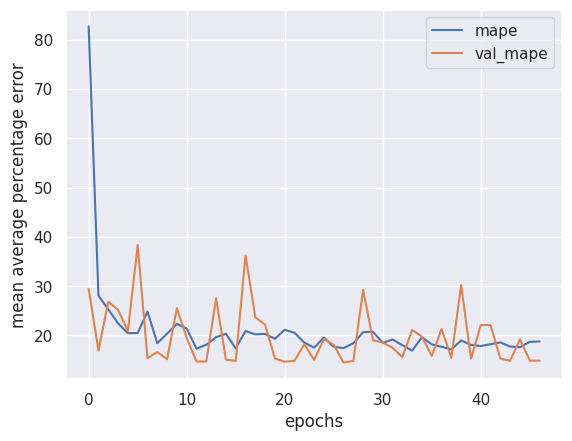

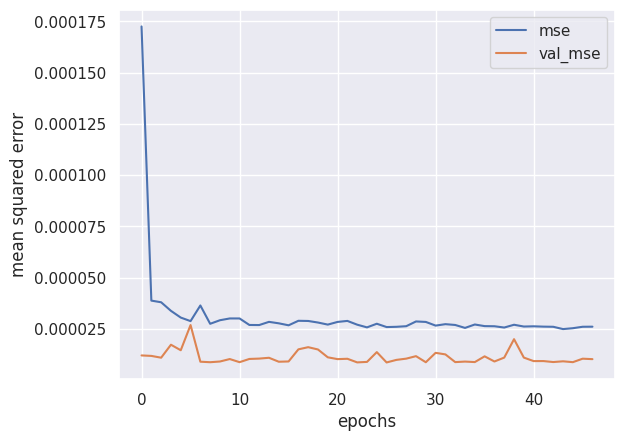

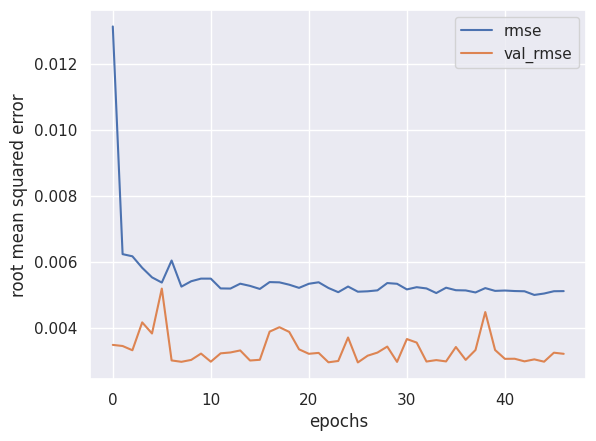

In [531]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

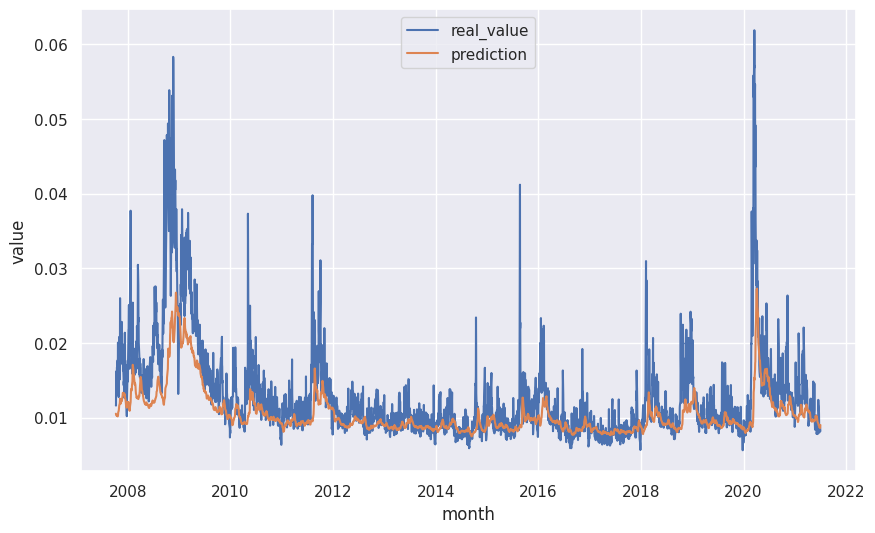

In [532]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

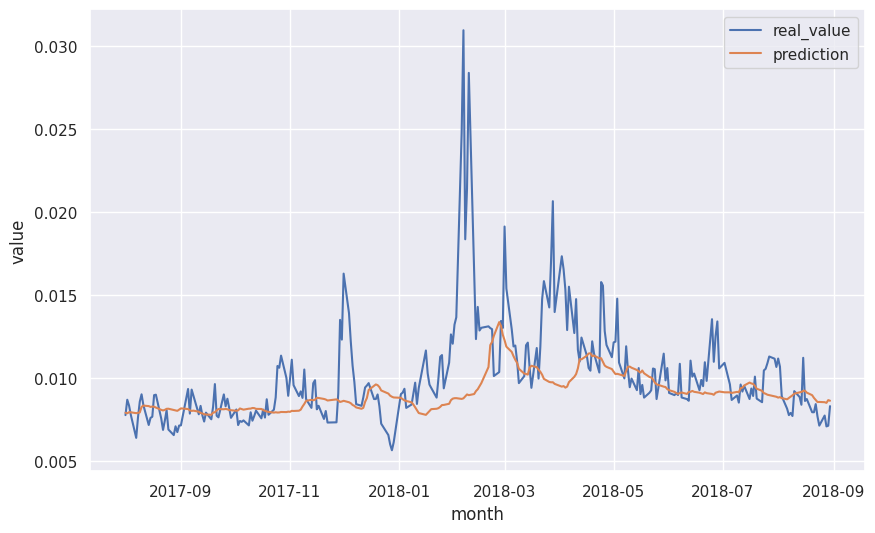

In [533]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Fold 3

##### Test Train & Predict Model (80:20)

In [534]:
# variables
fh = 10
fold = 3

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 4,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [535]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [536]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 8)              │         3,488 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 16)             │           688 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,193 (16.38 KB)

 Trainable params: 4,193 (16.38 KB)

 Non-trainable params: 0 (0.00 B)

In [537]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 15:51:00.356731: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12841425709832301044
2024-12-10 15:51:00.356805: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5367462930519278244
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:51:01.130308: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:51:01.130377: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:51:01.130385: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

2024-12-10 15:51:51.890135: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:51:51.890182: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:51:51.890191: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:51:54.559971: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10194791562091923487
2024-12-10 15:51:54.560015: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7594130884354051451
2024-12-10 15:51:54.560025: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12841425709832301044
2024-12-10 15:51:54.560030: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv 

In [538]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 13.3441 - mean_squared_error: 5.8461e-06 - root_mean_squared_error: 0.0024


2024-12-10 15:52:51.285586: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:52:51.285672: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:52:51.285685: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[13.126580238342285, 6.005846444168128e-06, 0.002450682921335101]

In [539]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step


In [540]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step


In [541]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [542]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (80:20)

In [543]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

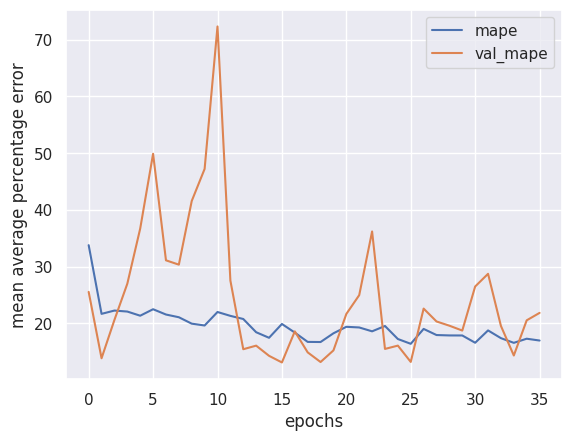

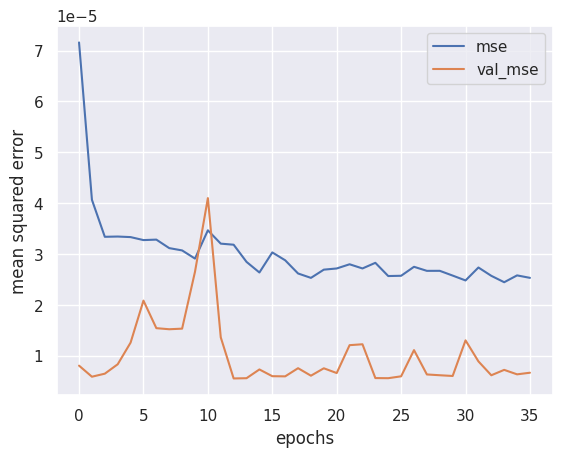

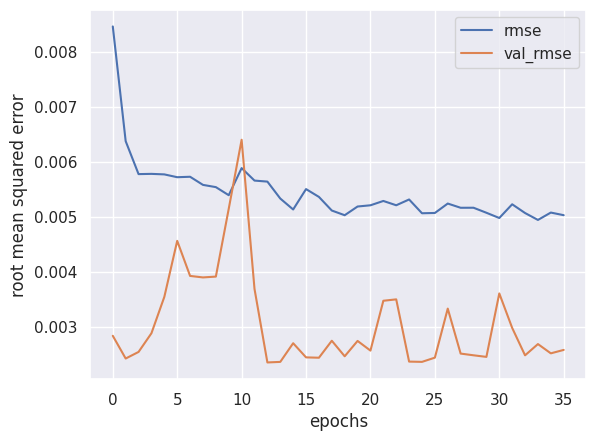

In [544]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

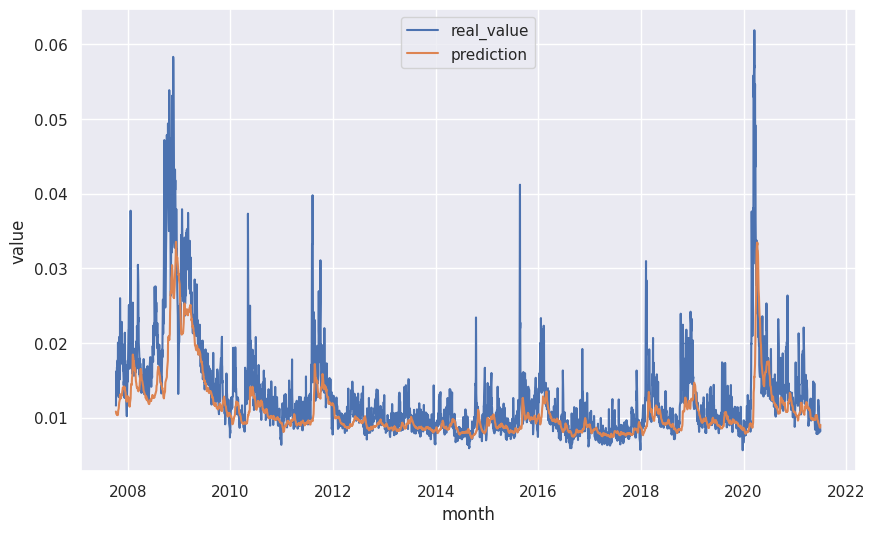

In [545]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

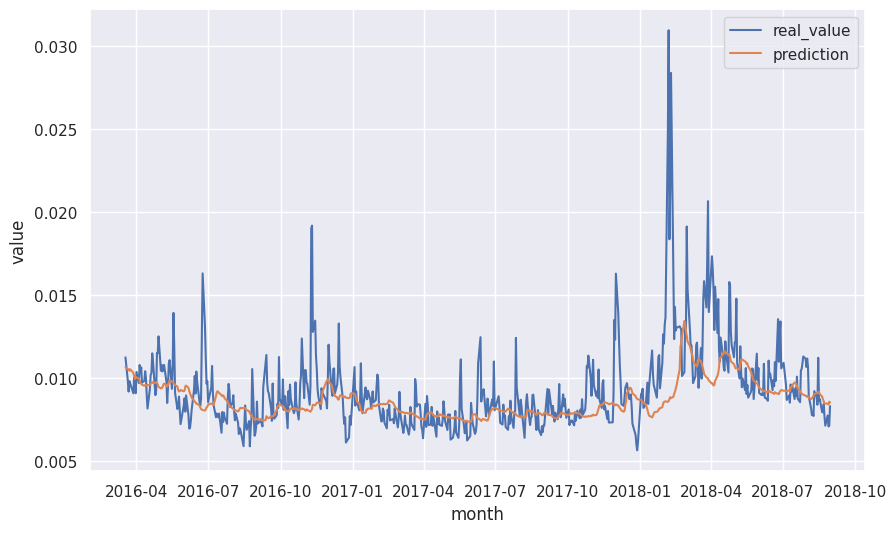

In [546]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (60:40)

In [547]:
# variables
fh = 10
fold = 3

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 4,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [548]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [549]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 8)              │         3,488 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 16)             │           688 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,193 (16.38 KB)

 Trainable params: 4,193 (16.38 KB)

 Non-trainable params: 0 (0.00 B)

In [550]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:53:00.070317: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:53:00.070388: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:53:00.070508: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:53:02.099983: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10194791562091923487
2024-12-10 15:53:02.793716: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

2024-12-10 15:53:52.015625: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:53:52.015681: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:53:52.015689: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:53:54.740676: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:53:54.740719: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:53:54.740726: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:53:57.324384: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv i

In [551]:
# evaluate model
model.evaluate(example_test_ds)

41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 16.4794 - mean_squared_error: 2.9931e-05 - root_mean_squared_error: 0.0054


2024-12-10 15:55:14.266861: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:55:14.266908: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:55:14.266916: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[16.08543586730957, 2.5609551812522113e-05, 0.005060588009655476]

In [552]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step


In [553]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


In [554]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv', index=False)

In [555]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (60:40)

In [556]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv')

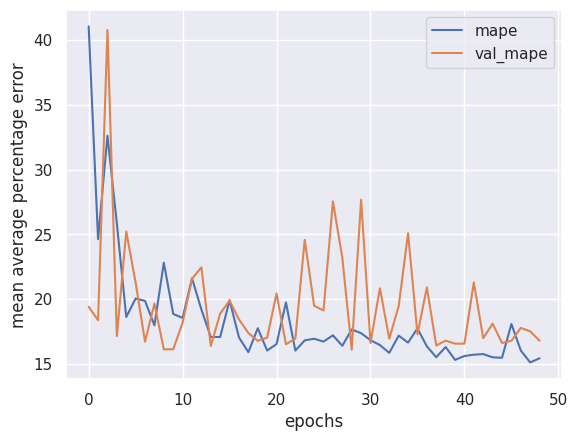

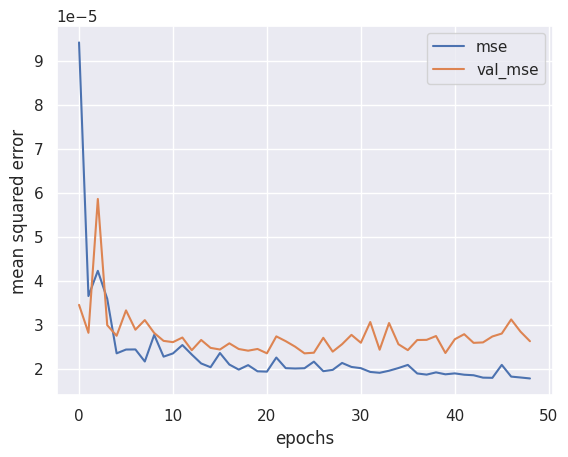

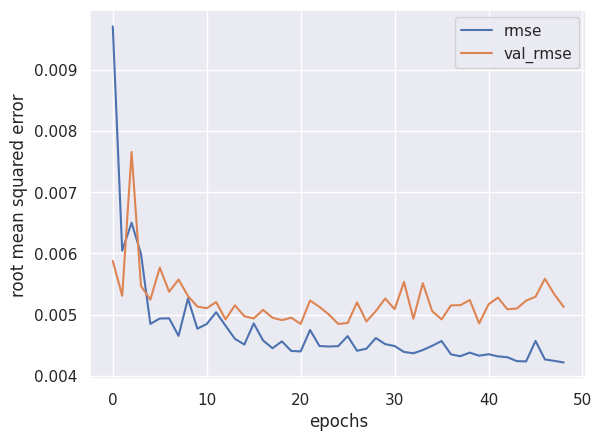

In [557]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

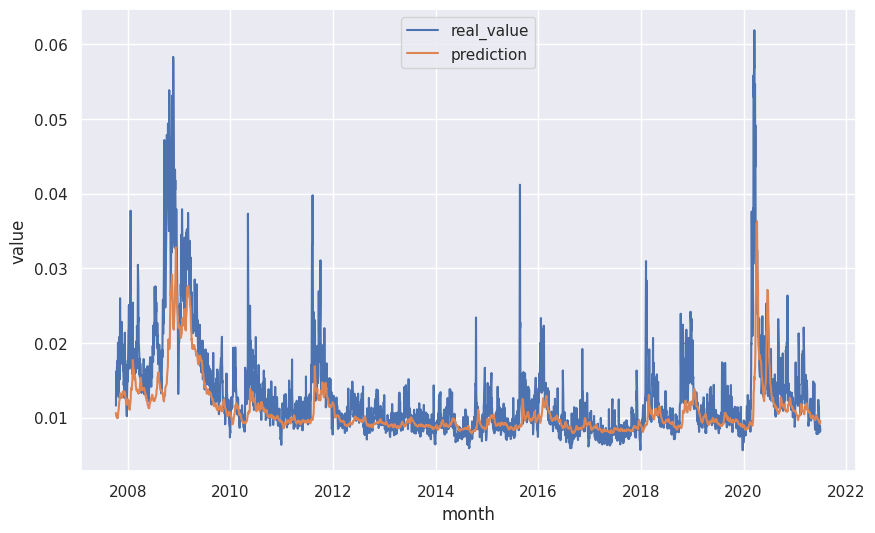

In [558]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

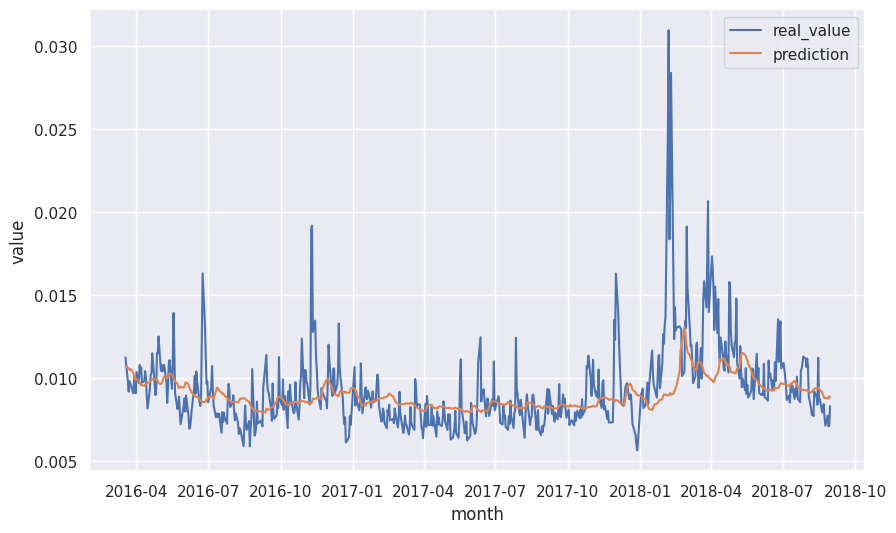

In [559]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [560]:
# variables
fh = 10
fold = 3

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 4,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [561]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [562]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 8)              │         3,488 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 16)             │           688 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,193 (16.38 KB)

 Trainable params: 4,193 (16.38 KB)

 Non-trainable params: 0 (0.00 B)

In [563]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 15:55:21.408767: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10194791562091923487
2024-12-10 15:55:21.408811: I tensorflow/core/framework/local_rendezvous.cc:427] Local rendezvous send item cancelled. Key hash: 10645912226192530315
2024-12-10 15:55:21.408815: I tensorflow/core/framework/local_rendezvous.cc:427] Local rendezvous send item cancelled. Key hash: 3957403590772507487
2024-12-10 15:55:21.408820: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7594130884354051451
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:55:21.408826: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

2024-12-10 15:55:52.936635: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10194791562091923487
2024-12-10 15:55:52.936689: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12841425709832301044
2024-12-10 15:55:52.936696: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5367462930519278244
2024-12-10 15:55:53.125063: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:55:53.125109: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:55:53.125116: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:55:54.370295: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv 

In [564]:
# evaluate model
model.evaluate(example_test_ds)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 13.4310 - mean_squared_error: 6.8640e-06 - root_mean_squared_error: 0.0026


2024-12-10 15:56:10.309322: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:56:10.309379: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:56:10.309388: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[13.638343811035156, 7.328816991503118e-06, 0.0027071787044405937]

In [565]:
# predict using model using all 100% data
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step


In [566]:
# predict using model using test data
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


In [567]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [568]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (50% 80:20)

In [569]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

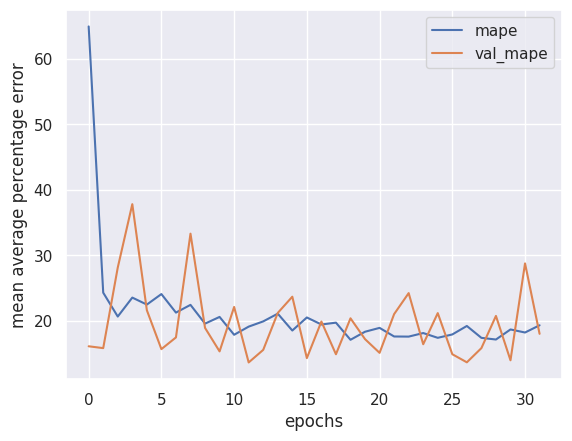

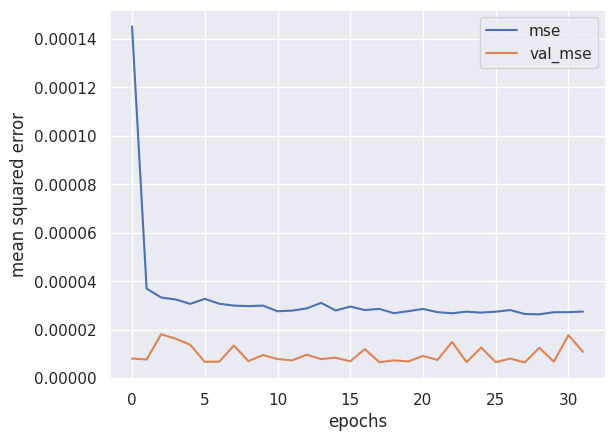

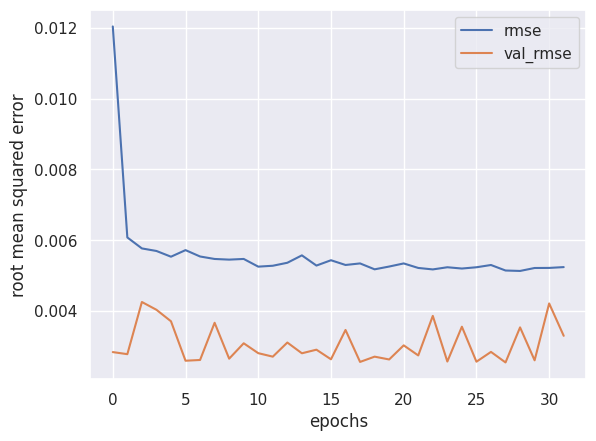

In [570]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

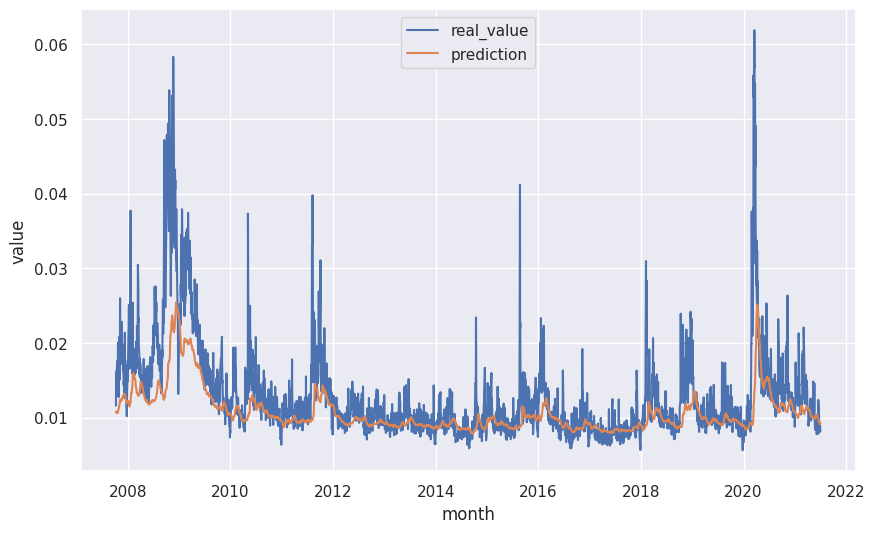

In [571]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

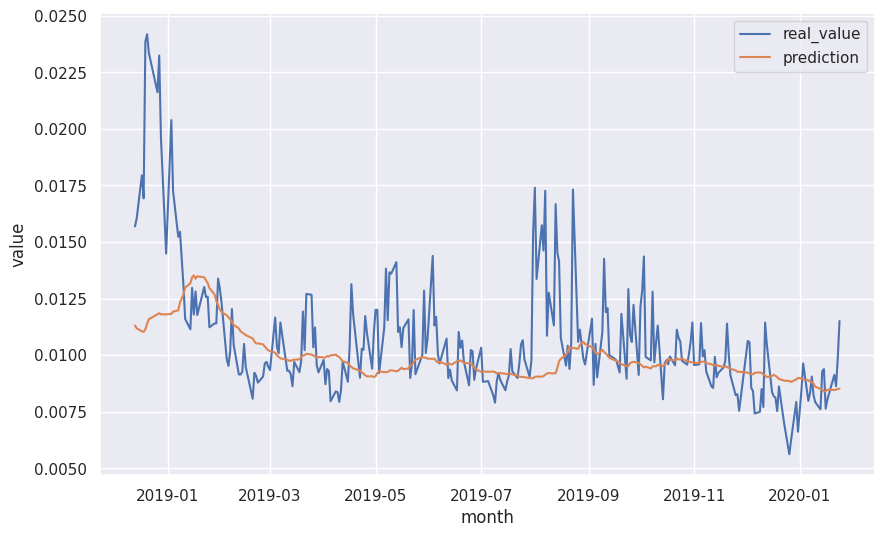

In [572]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Fold 4

##### Test Train & Predict Model (80:20)

In [573]:
# variables
fh = 10
fold = 4

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 4,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [574]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [575]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 8)              │         3,488 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 16)             │           688 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,193 (16.38 KB)

 Trainable params: 4,193 (16.38 KB)

 Non-trainable params: 0 (0.00 B)

In [576]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:56:20.258827: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:56:20.258891: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:56:20.258899: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:56:22.786869: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10194791562091923487
2024-12-10 15:56:22.786955: I tensorflow/core/framework/local_rendezvous.cc:427] Local 

2024-12-10 15:56:52.502223: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5367462930519278244
2024-12-10 15:56:52.889552: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:56:52.889600: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:56:55.484130: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10194791562091923487
2024-12-10 15:56:55.484183: I tensorflow/core/framework/local_rendezvous.cc:427] Local rendezvous send item cancelled. Key hash: 10645912226192530315
2024-12-10 15:56:55.484189: I tensorflow/core/framework/local_rendezvous.cc:427] Local rendezvous send item cancelled. Key hash: 3957403590772507487
2024-12-10 15:56:55.484195: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv 

In [577]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 17.7772 - mean_squared_error: 6.7825e-05 - root_mean_squared_error: 0.0082


2024-12-10 15:57:42.909303: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:57:42.909349: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:57:42.909356: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[16.91390037536621, 4.6480141463689506e-05, 0.006817634217441082]

In [578]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


In [579]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step


In [580]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [581]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (80:20)

In [582]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

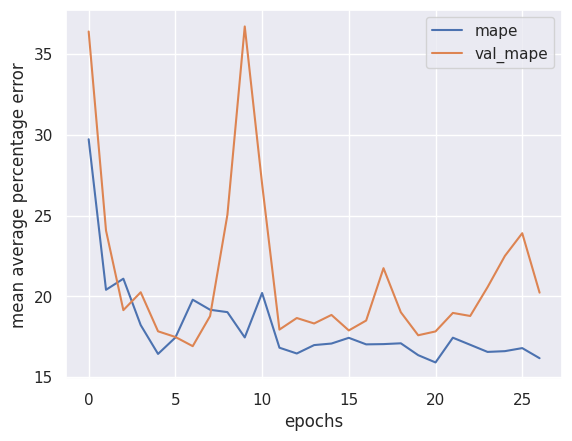

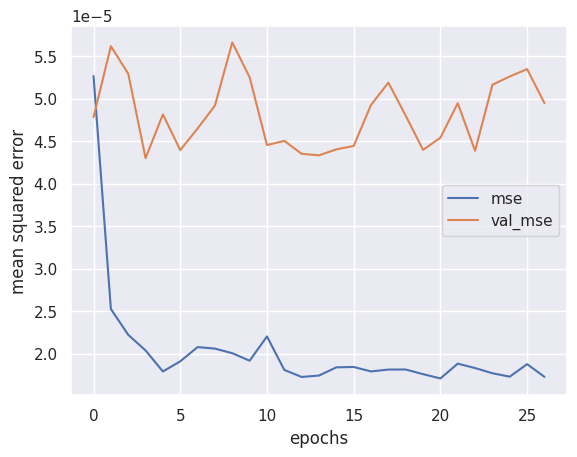

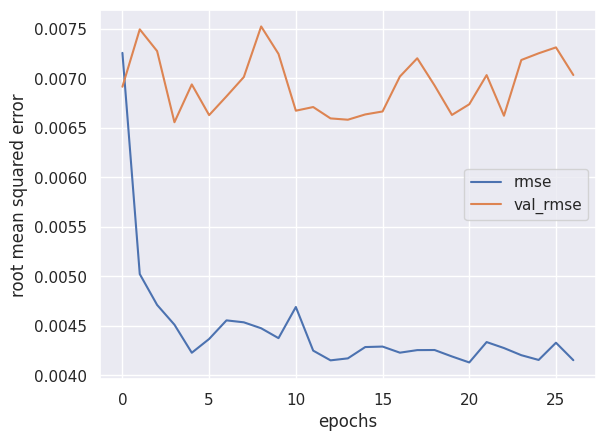

In [583]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

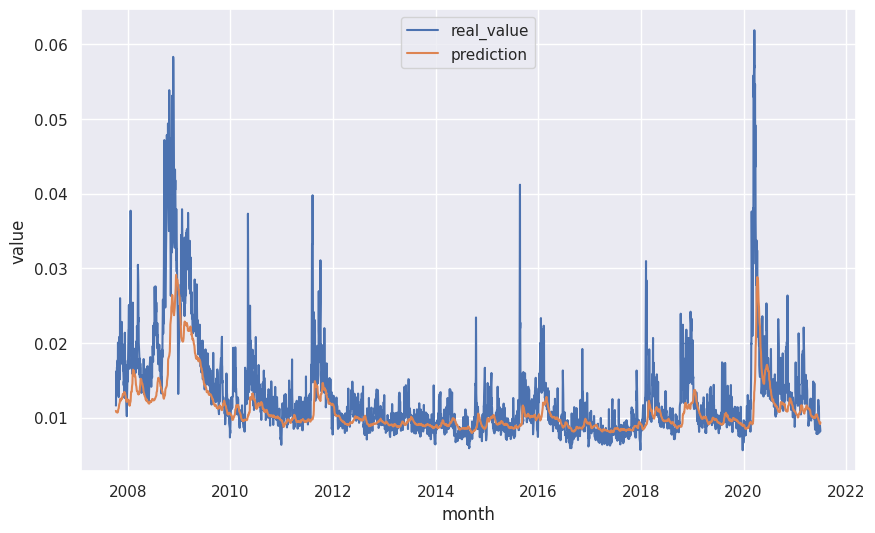

In [584]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

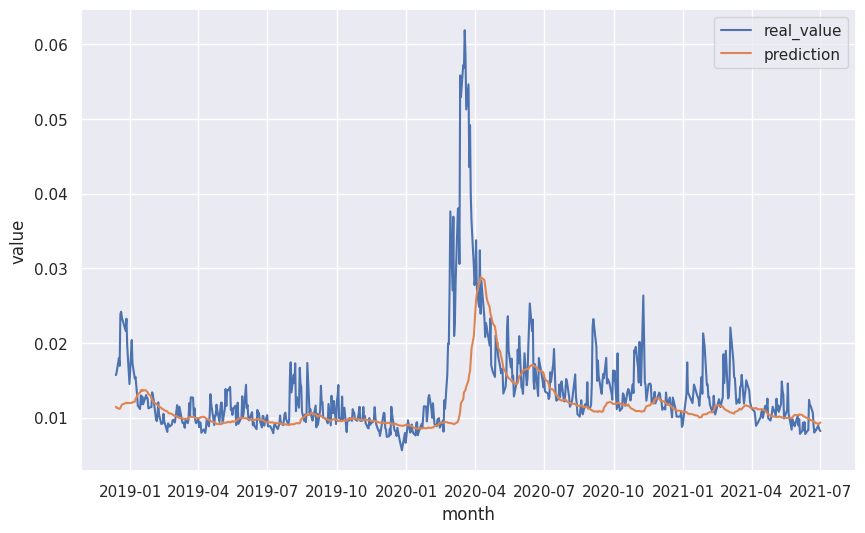

In [585]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [586]:
# variables
fh = 10
fold = 4

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 4,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

In [587]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [588]:
# create model
model = VolatilityForecast(
    input_shape=[example_hps['window_size'], 1],
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bidirectional_lstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes'], example_hps['perceptron_0_nodes']], activation=None, name='multilayer_perceptron'),
    dropout_rate=example_hps['dropout_rate'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecast"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_lstm (Sequential) │ (None, 8)              │         3,488 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ multilayer_perceptron           │ (None, 16)             │           688 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,193 (16.38 KB)

 Trainable params: 4,193 (16.38 KB)

 Non-trainable params: 0 (0.00 B)

In [589]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 15:57:50.903007: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10194791562091923487
2024-12-10 15:57:50.903066: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12841425709832301044
2024-12-10 15:57:50.903072: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5367462930519278244
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 15:57:51.325345: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:57:51.325400: I tensorflow/core/framework/local_rendezvous.cc:423] Local

2024-12-10 15:57:53.074899: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:57:53.074984: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:57:53.074993: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
2024-12-10 15:57:54.532406: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:57:56.124888: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:57:57.756773: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:57:57.756824: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv it

In [590]:
# evaluate model
model.evaluate(example_test_ds)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 14.5251 - mean_squared_error: 9.6224e-06 - root_mean_squared_error: 0.0031


2024-12-10 15:58:34.767449: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:58:34.767578: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:58:34.767752: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


[15.405619621276855, 1.0850348189705983e-05, 0.003293986665084958]

In [591]:
# predict using model using all 100% data
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


In [592]:
# predict using model using test data
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


In [593]:
# save model in keras format
model.save(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [594]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

##### Test Evaluate Model (50% 80:20)

In [595]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/bilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/bilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

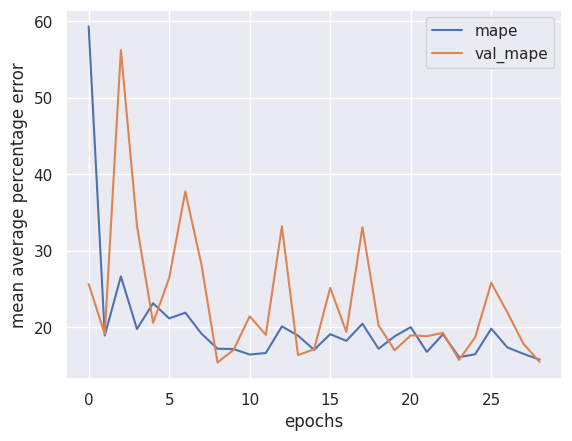

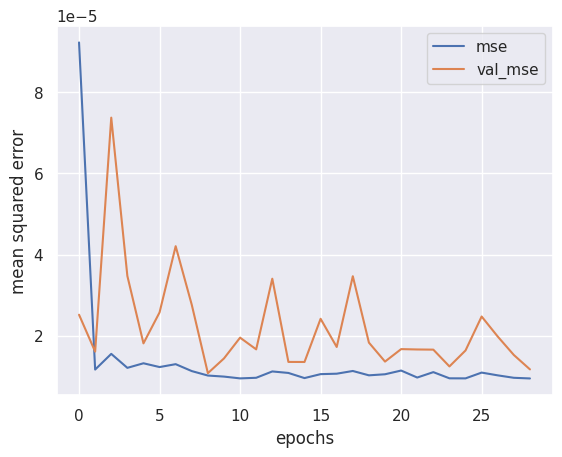

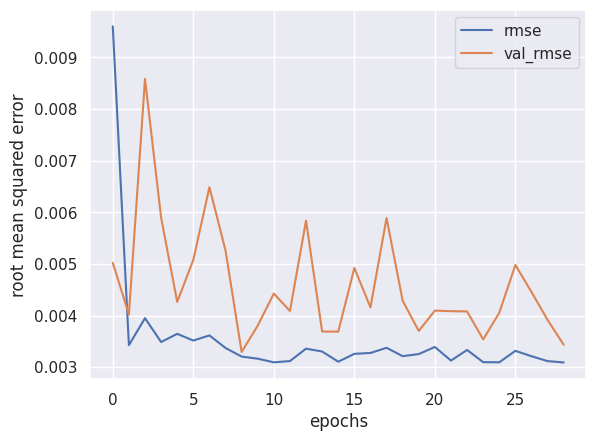

In [596]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

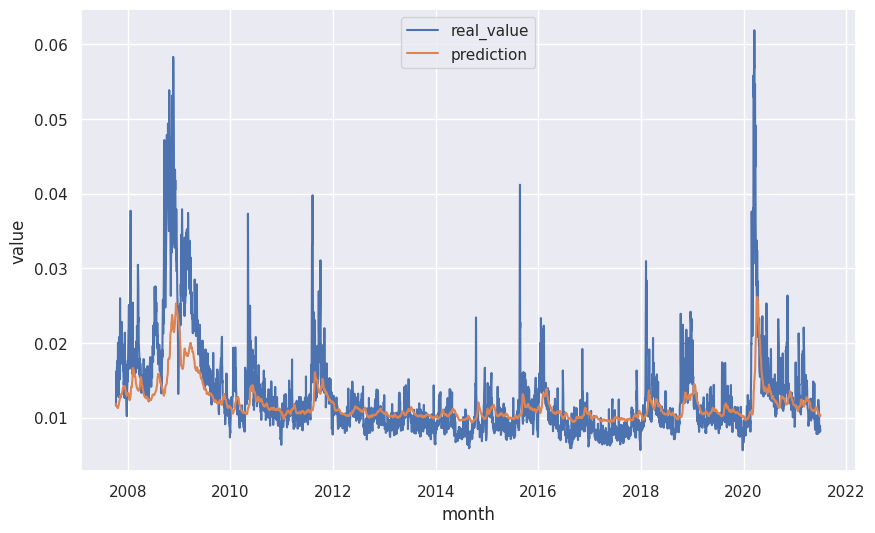

In [597]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

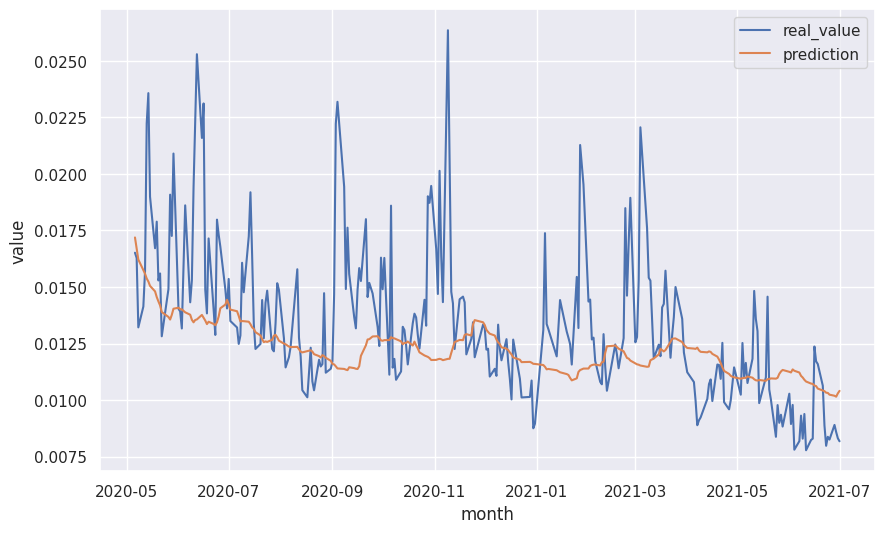

In [598]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Summary

In [599]:
# variables
fh = 10

# bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 4,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate': 0.0,
    'learning_rate': 0.002,
}

60:40

In [600]:
# load model in keras format
bilstm_models = [tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras') for fold in range(4)]

# load test dataset
example_test_dss = []
for fold in range(4):
    example_test_dss.append(create_window_dataset(
        series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/test_{fold}.npy'), axis=-1),
        window_size=example_hps['window_size'],
        forecast_horizon=fh,
        batch_size=batch_size,
        shuffle_buffer=shuffle_buffer,
    ))

In [601]:
# evaluate model 
evaluation_results = np.array([bilstm_models[fold].evaluate(example_test_dss[fold]) for fold in range(4)])

41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 15.9282 - mean_squared_error: 2.5700e-05 - root_mean_squared_error: 0.0051


2024-12-10 15:58:39.763285: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:58:39.763350: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:58:39.763360: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 13.9074 - mean_squared_error: 8.3687e-06 - root_mean_squared_error: 0.0029


2024-12-10 15:58:40.835966: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:58:40.836021: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:58:40.836028: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 13.7392 - mean_squared_error: 5.5156e-06 - root_mean_squared_error: 0.0023


2024-12-10 15:58:41.875578: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:58:41.875619: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:58:41.875626: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 16.6012 - mean_squared_error: 2.4269e-05 - root_mean_squared_error: 0.0049


2024-12-10 15:58:43.076006: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:58:43.076067: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:58:43.076075: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


In [602]:
evaluation_results

array([[1.54777460e+01, 2.70269520e-05, 5.19874506e-03],
       [1.36105633e+01, 8.20160949e-06, 2.86384532e-03],
       [1.41802950e+01, 7.05822913e-06, 2.65673269e-03],
       [1.60854359e+01, 2.56095518e-05, 5.06058801e-03]])

In [603]:
np.mean(evaluation_results, axis=0)

array([1.48385100e+01, 1.69740856e-05, 3.94497777e-03])

50% 80:20

In [604]:
# load model in keras format
bilstm_models = [tf.keras.models.load_model(f'{archive_folder}/bilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras') for fold in range(5)]

# load test dataset
example_test_dss = []
for fold in range(5):
    example_test_dss.append(create_window_dataset(
        series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
        window_size=example_hps['window_size'],
        forecast_horizon=fh,
        batch_size=batch_size,
        shuffle_buffer=shuffle_buffer,
    ))

In [605]:
# evaluate model
evaluation_results = np.array([bilstm_models[fold].evaluate(example_test_dss[fold]) for fold in range(5)])

9/9 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - loss: 14.9349 - mean_squared_error: 1.1075e-05 - root_mean_squared_error: 0.0033


2024-12-10 15:58:44.810193: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:58:44.810253: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:58:44.810260: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


9/9 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - loss: 12.0078 - mean_squared_error: 3.0856e-06 - root_mean_squared_error: 0.0018


2024-12-10 15:58:45.379420: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:58:45.379477: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:58:45.379484: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


9/9 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - loss: 14.0313 - mean_squared_error: 8.2091e-06 - root_mean_squared_error: 0.0029


2024-12-10 15:58:45.931670: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:58:45.931746: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:58:45.931754: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


9/9 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - loss: 12.8459 - mean_squared_error: 6.9116e-06 - root_mean_squared_error: 0.0026


2024-12-10 15:58:46.467411: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:58:46.467497: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:58:46.467504: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


9/9 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - loss: 15.1082 - mean_squared_error: 1.0175e-05 - root_mean_squared_error: 0.0032


2024-12-10 15:58:47.036389: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10703543692581304437
2024-12-10 15:58:47.036506: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5603838149374184809
2024-12-10 15:58:47.036530: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4914777941429362379


In [606]:
evaluation_results

array([[1.53617878e+01, 1.03342363e-05, 3.21469083e-03],
       [1.20464125e+01, 3.05893673e-06, 1.74898165e-03],
       [1.45248518e+01, 9.95657501e-06, 3.15540400e-03],
       [1.36383438e+01, 7.32881699e-06, 2.70717870e-03],
       [1.54056196e+01, 1.08503482e-05, 3.29398667e-03]])

In [607]:
np.mean(evaluation_results, axis=0)

array([1.41954031e+01, 8.30578265e-06, 2.82404837e-03])

## CNN Bidirectional LSTM

### Architecture

In [608]:
def VolatilityForecastConvBiLSTM(
    input_shape,
    cnn,
    bilstm,
    mlp,
    dropout_rate_0,
    dropout_rate_1,
):
    input = tf.keras.Input(shape=input_shape, name='input')
    x = cnn(input)
    x = tf.keras.layers.Dropout(dropout_rate_0, name='dropout_0')(x)
    x = bilstm(x)
    x = tf.keras.layers.Dropout(dropout_rate_1, name='dropout_1')(x)
    x = mlp(x)
    output = tf.keras.layers.Dense(1, name='output')(x)
    model = tf.keras.Model(input, output, name='VolatilityForecastConvBiLSTM')
    return model

### FH 1

#### Fold 0

##### Test Train & Predict Model

In [609]:
# variables
fh = 1
fold = 0

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'conv_0_filters': 32,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.002
}

In [610]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [611]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,809 (108.63 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

In [612]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

W0000 00:00:1733842729.785185    3533 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733842729.846401    3533 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733842729.860491    3533 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733842729.884384    3533 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733842729.898806    3533 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733842729.912768    3533 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733842729.926278    3533 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733842729.944544    3533 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733842729.979213    3533 gp

W0000 00:00:1733842732.932231    3534 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733842732.938459    3534 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733842732.944387    3534 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733842732.950484    3534 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733842732.956425    3534 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733842732.962383    3534 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733842732.968427    3534 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733842732.974545    3534 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733842732.980817    3534 gp

In [613]:
# evaluate model
model.evaluate(example_test_ds)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 9.7566 - mean_squared_error: 8.4476e-06 - root_mean_squared_error: 0.0029


2024-12-10 16:01:05.475788: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:01:05.475838: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:01:05.475845: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356


[9.994298934936523, 1.0490129170648288e-05, 0.0032388470135629177]

In [614]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


W0000 00:00:1733842867.214653    3539 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733842867.217843    3539 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733842867.220422    3539 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733842867.222668    3539 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733842867.224978    3539 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733842867.227194    3539 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733842867.229446    3539 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733842867.231702    3539 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733842867.233959    3539 gp

In [615]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


In [616]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [617]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 83,301 (325.40 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

 Optimizer params: 55,492 (216.77 KB)

##### Test Evaluate Model

In [618]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

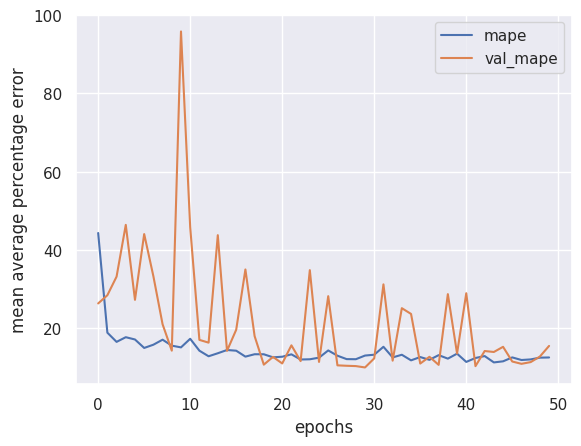

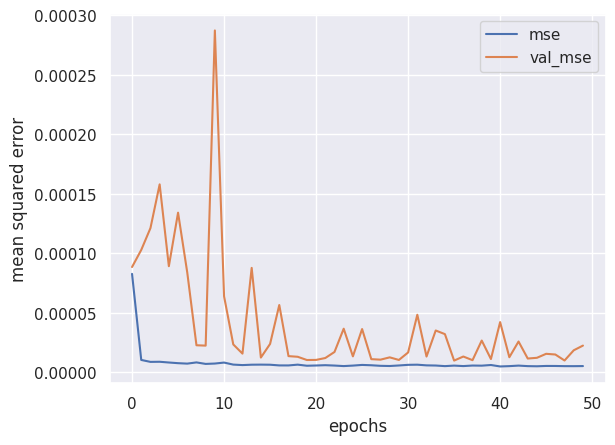

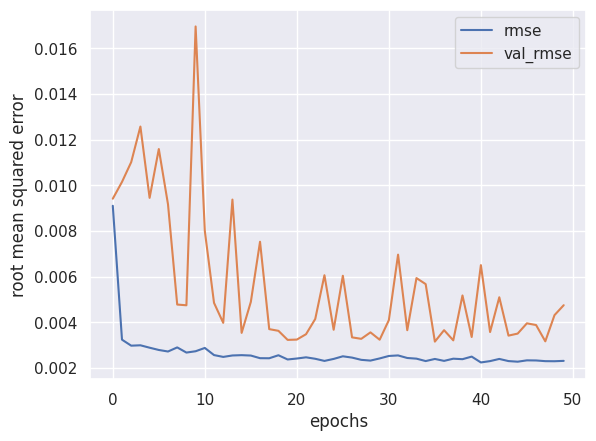

In [619]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

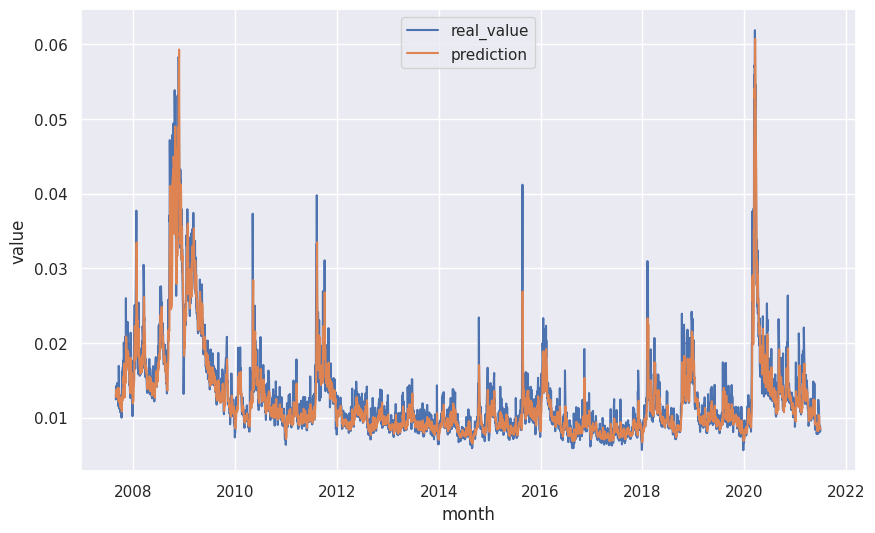

In [620]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

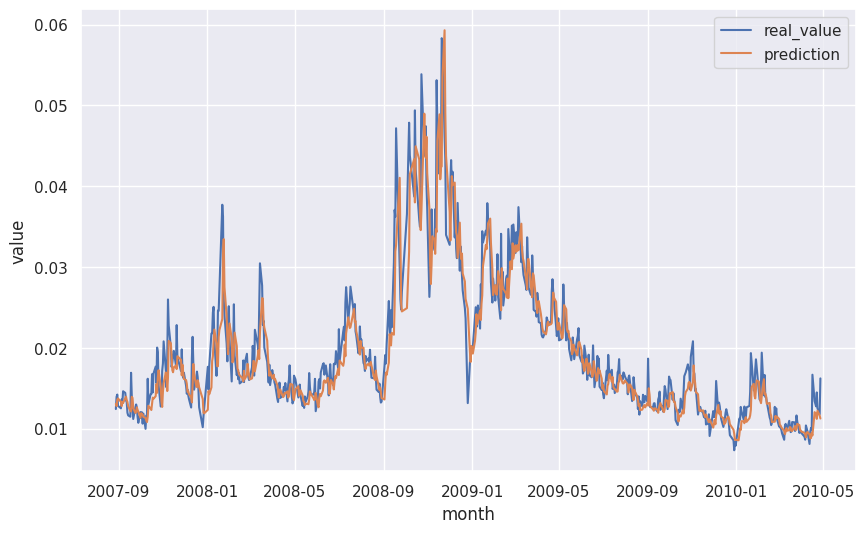

In [621]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (60:40)

In [622]:
# variables
fh = 1
fold = 0

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'conv_0_filters': 32,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.002
}

In [623]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [624]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,809 (108.63 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

In [625]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 16:01:13.870406: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12851918784981813335
2024-12-10 16:01:13.870476: I tensorflow/core/framework/local_rendezvous.cc:427] Local rendezvous send item cancelled. Key hash: 11427016775701345565
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 16:01:13.870487: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13616153248767821807
2024-12-10 16:01:13.870495: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15421948462813685152
2024-12-10 16:01:13.870501: I tensorflow/core/framework/local_rendezvous.cc:423] Loca

In [626]:
# evaluate model
model.evaluate(example_test_ds)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 10.2091 - mean_squared_error: 1.0042e-05 - root_mean_squared_error: 0.0032


2024-12-10 16:03:35.304468: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:03:35.304530: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:03:35.304538: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356


[10.044281959533691, 1.0461767487868201e-05, 0.003234465606510639]

In [627]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


In [628]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


In [629]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv', index=False)

In [630]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 83,301 (325.40 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

 Optimizer params: 55,492 (216.77 KB)

##### Test Evaluate Model (60:40)

In [631]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv')

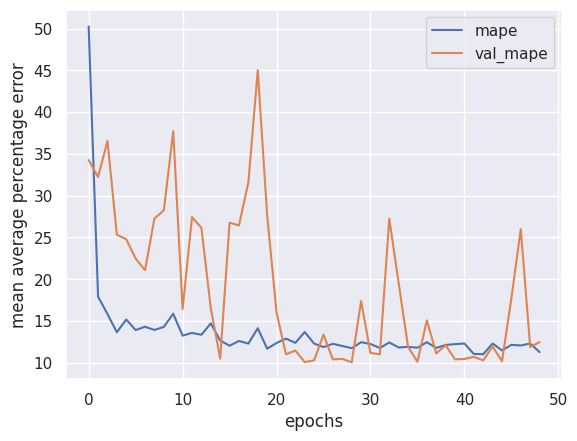

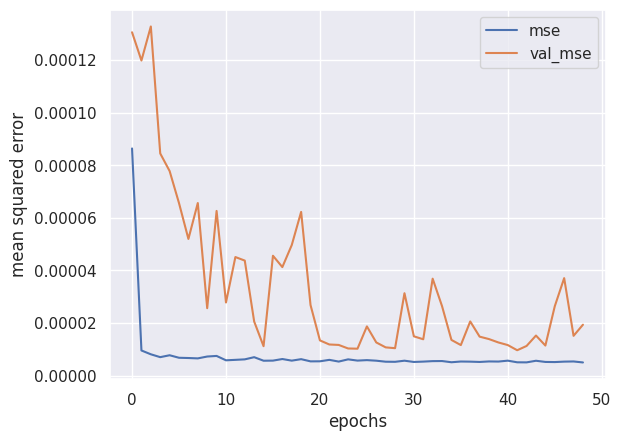

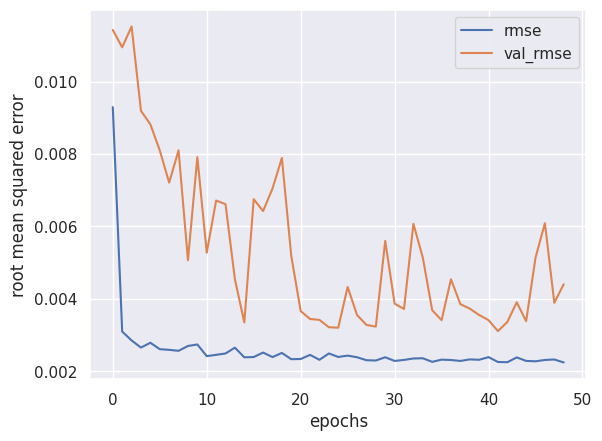

In [632]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

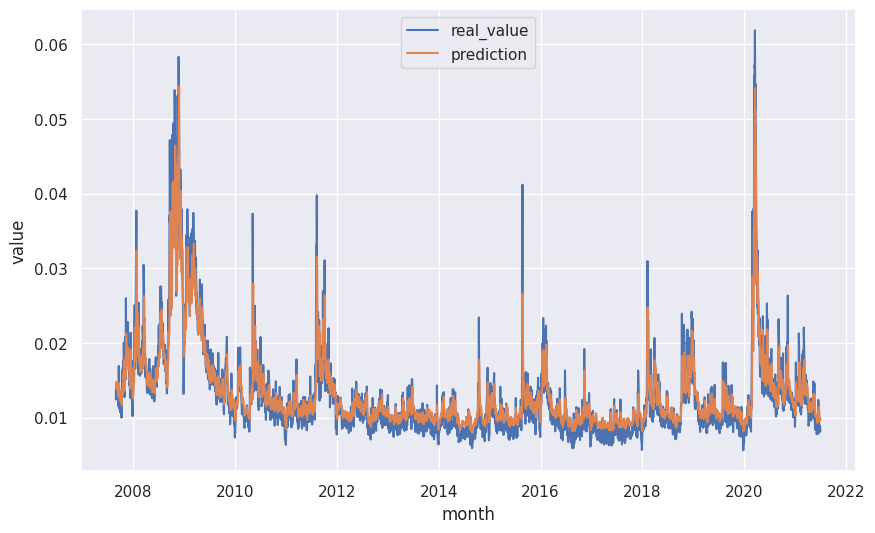

In [633]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

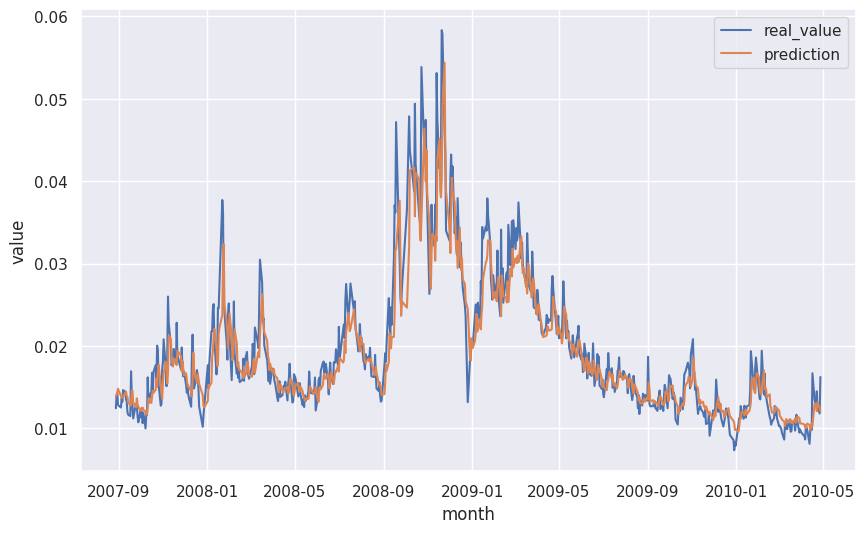

In [634]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [635]:
# variables
fh = 1
fold = 0

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'conv_0_filters': 32,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.002
}

In [636]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [637]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,809 (108.63 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

In [638]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

W0000 00:00:1733843023.561244    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733843023.568267    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733843023.574280    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733843023.580239    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733843023.586402    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733843023.592234    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733843023.598199    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733843023.604144    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733843023.610051    3538 gp

In [639]:
# evaluate model
model.evaluate(example_test_ds)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 10.6347 - mean_squared_error: 3.8420e-06 - root_mean_squared_error: 0.0019


2024-12-10 16:05:36.137196: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:05:36.137255: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356


[11.140850067138672, 5.565407263929956e-06, 0.002359111560508609]

In [640]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


In [641]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


In [642]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [643]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 83,301 (325.40 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

 Optimizer params: 55,492 (216.77 KB)

##### Test Evaluate Model (50% 80:20)

In [644]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

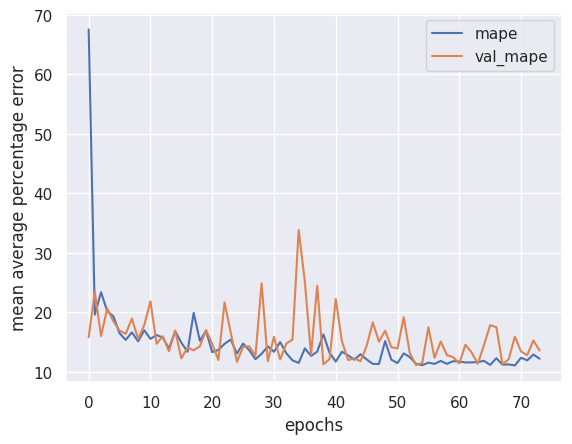

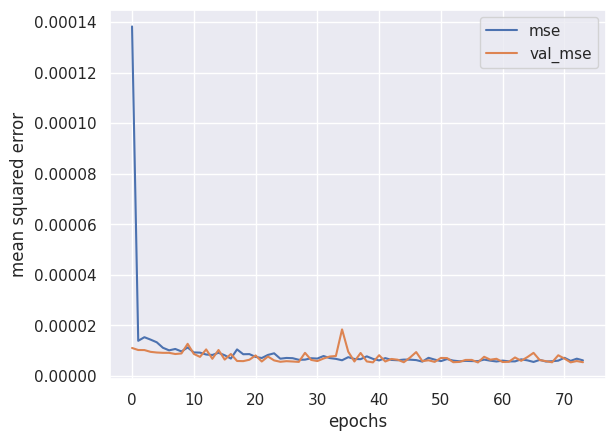

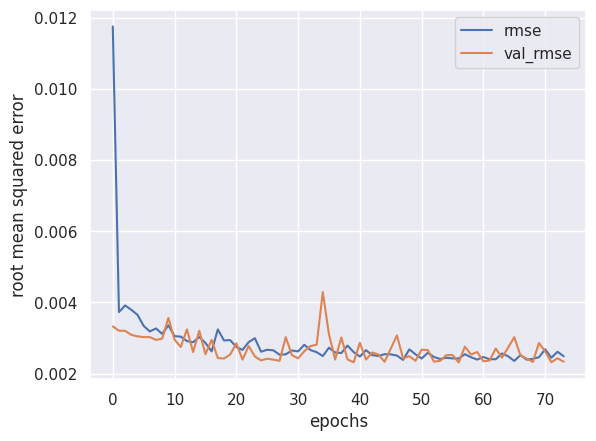

In [645]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

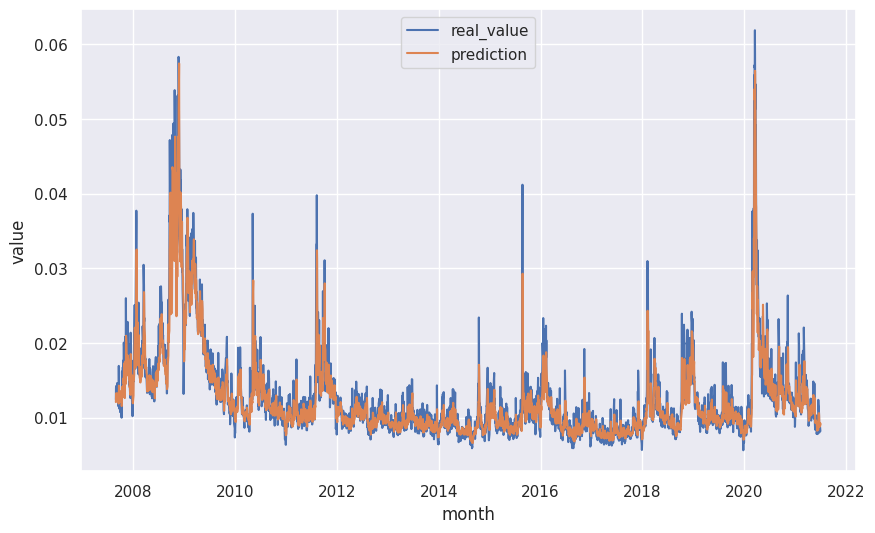

In [646]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

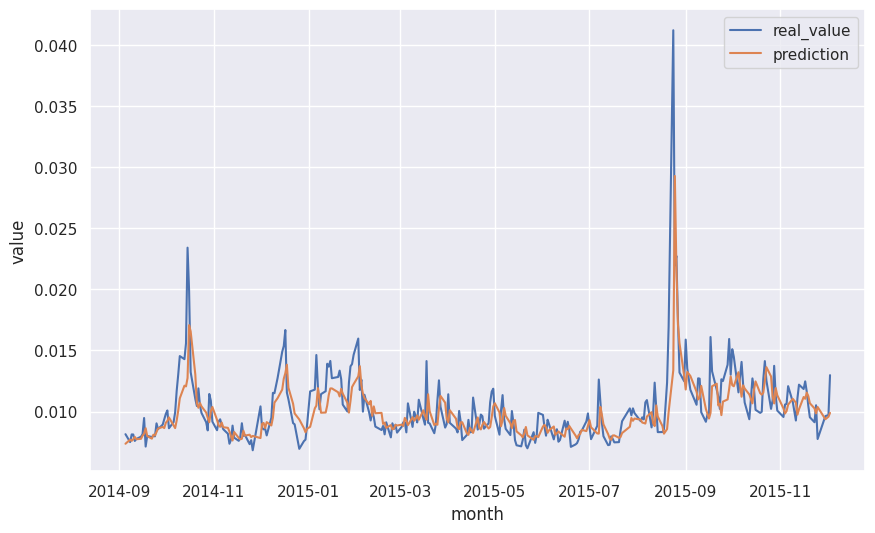

In [647]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Fold 1

##### Test Train & Predict Model

In [648]:
# variables
fh = 1
fold = 1

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'conv_0_filters': 32,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.002
}

In [649]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [650]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,809 (108.63 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

In [651]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 16:05:45.854356: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:05:45.854414: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:05:45.854422: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356
2024-12-10 16:05:48.690353: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:05:48.690403: I tensorflow/core/framework/local_rendezvous.cc:423] Local r

In [652]:
# evaluate model
model.evaluate(example_test_ds)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 10.1264 - mean_squared_error: 4.4539e-06 - root_mean_squared_error: 0.0021


2024-12-10 16:08:02.610230: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:08:02.610284: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356


[9.964380264282227, 3.8730240703444e-06, 0.0019680000841617584]

In [653]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


In [654]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step


In [655]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [656]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 83,301 (325.40 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

 Optimizer params: 55,492 (216.77 KB)

##### Test Evaluate Model

In [657]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

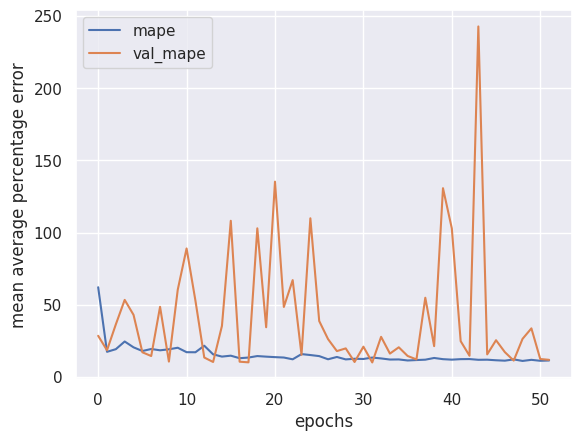

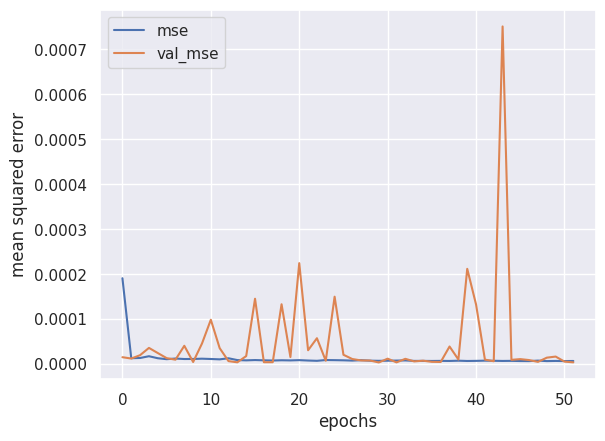

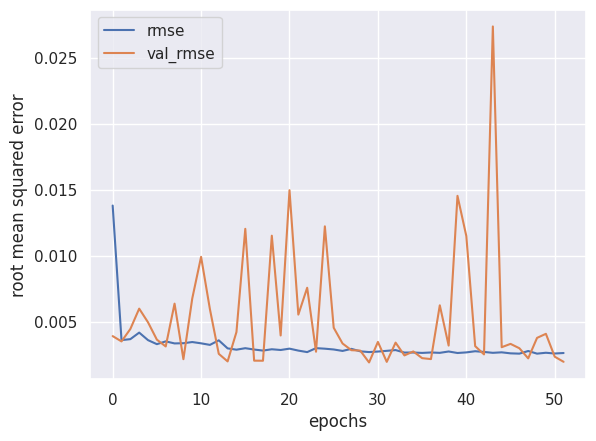

In [658]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

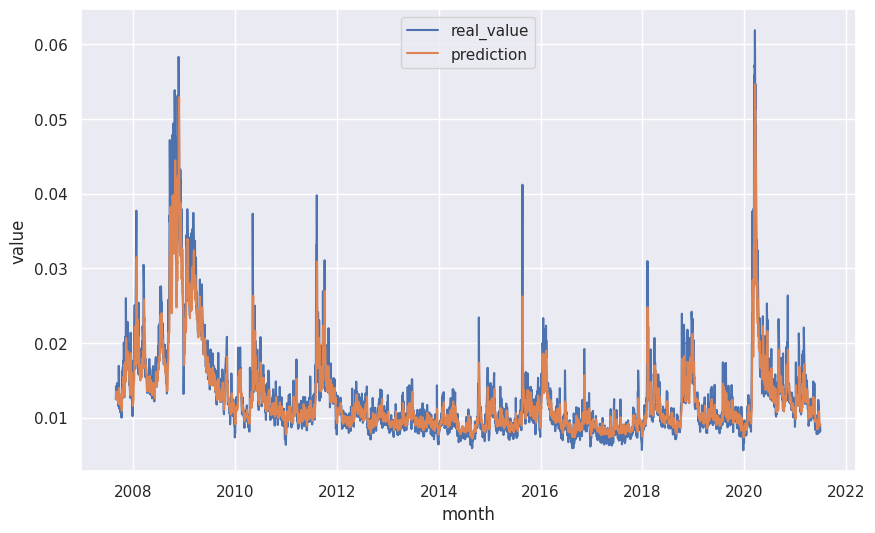

In [659]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

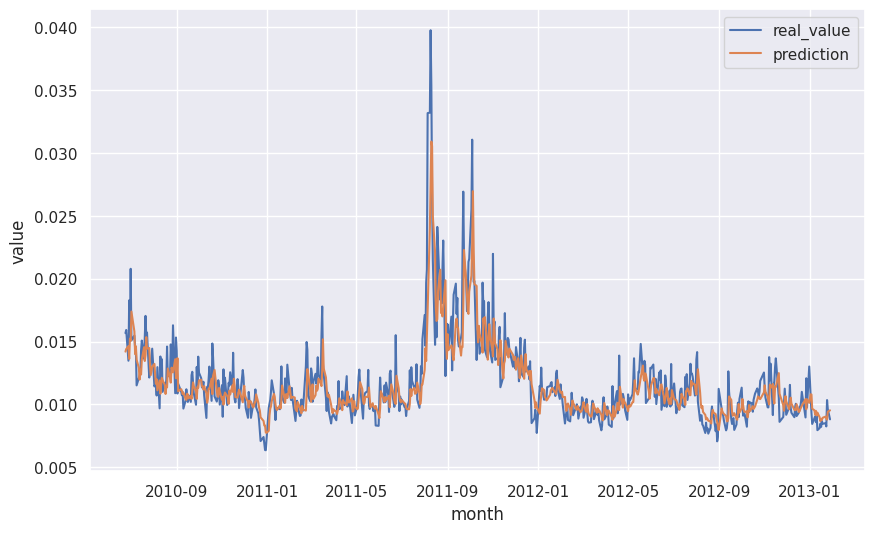

In [660]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (60:40)

In [661]:
# variables
fh = 1
fold = 1

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'conv_0_filters': 32,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.002
}

In [662]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [663]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,809 (108.63 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

In [664]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 16:08:16.762745: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:08:19.679796: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:08:19.679862: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:08:19.679871: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356
2024-12-10 16:08:27.178054: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

In [665]:
# evaluate model
model.evaluate(example_test_ds)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 9.8754 - mean_squared_error: 3.7764e-06 - root_mean_squared_error: 0.0019


2024-12-10 16:11:04.109737: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:11:04.109784: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:11:04.109791: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356


[9.776338577270508, 3.9061287679942325e-06, 0.0019763929303735495]

In [666]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


In [667]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


In [668]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv', index=False)

In [669]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 83,301 (325.40 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

 Optimizer params: 55,492 (216.77 KB)

##### Test Evaluate Model (60:40)

In [670]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv')

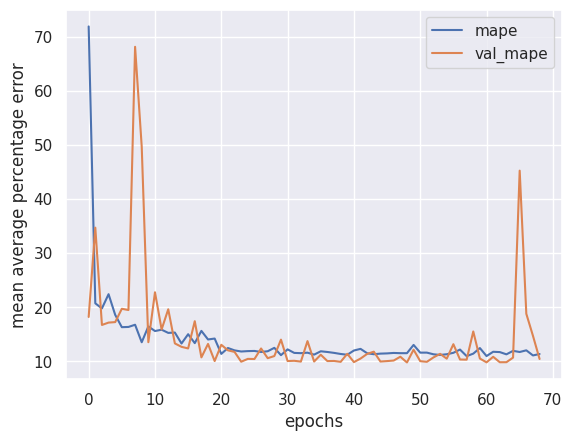

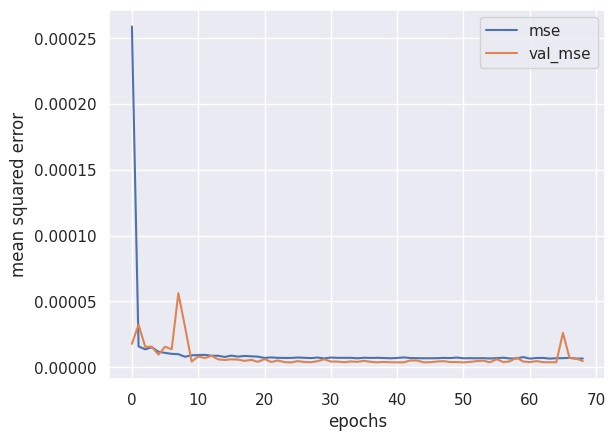

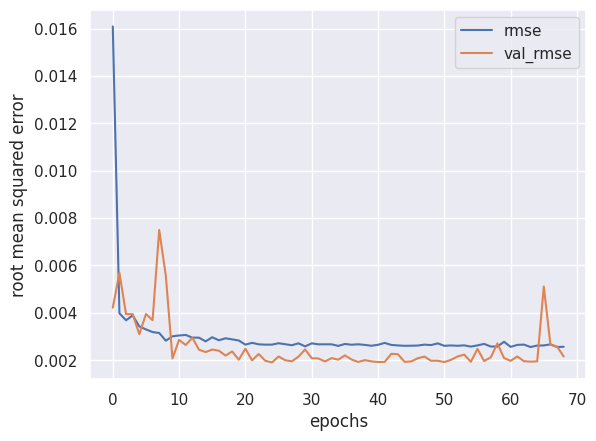

In [671]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

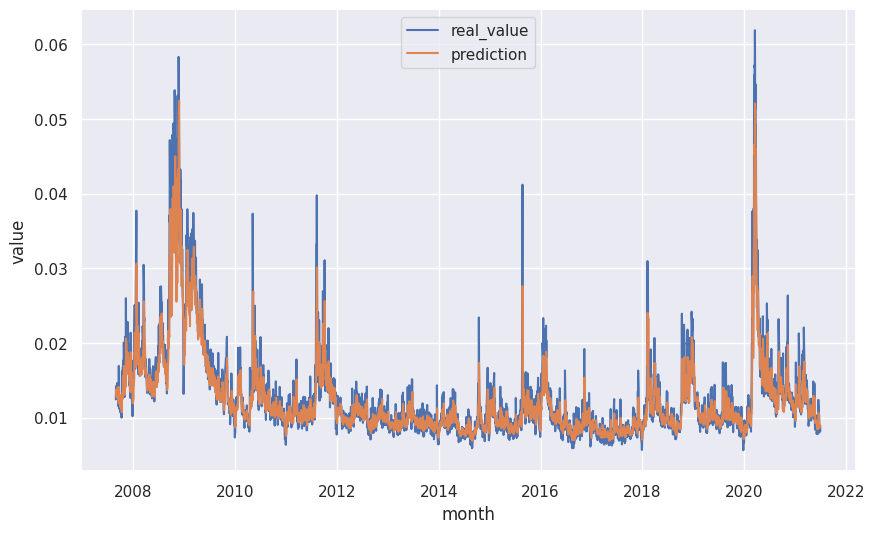

In [672]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

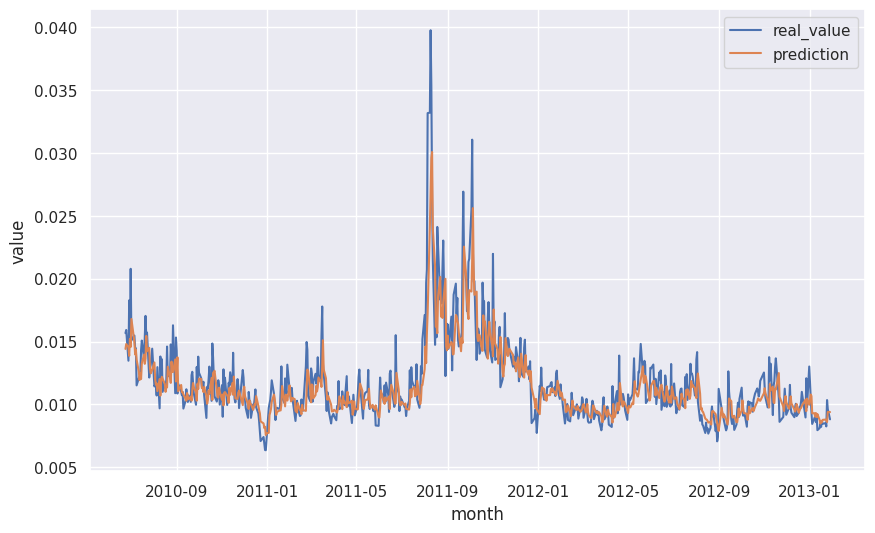

In [673]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [674]:
# variables
fh = 1
fold = 1

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'conv_0_filters': 32,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.002
}

In [675]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [676]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,809 (108.63 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

In [677]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 16:11:11.513191: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12851918784981813335
2024-12-10 16:11:11.513255: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13616153248767821807
2024-12-10 16:11:11.513265: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11723847831891133762
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 16:11:11.955528: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:11:11.955575: I tensorflow/core/framework/local_rendezvous.cc:423] Local

In [678]:
# evaluate model
model.evaluate(example_test_ds)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 9.2280 - mean_squared_error: 1.7330e-06 - root_mean_squared_error: 0.0013


[10.108773231506348, 2.093715465889545e-06, 0.001446967595256865]

In [679]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


In [680]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


In [681]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [682]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 83,301 (325.40 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

 Optimizer params: 55,492 (216.77 KB)

##### Test Evaluate Model (50% 80:20)

In [683]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

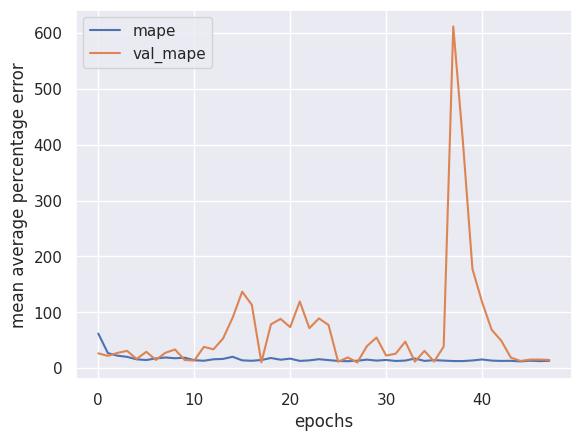

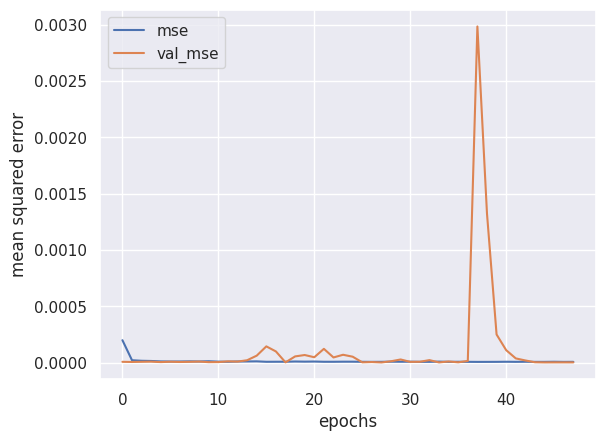

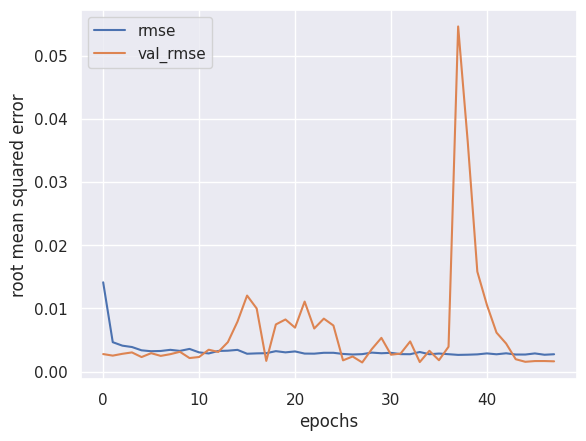

In [684]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

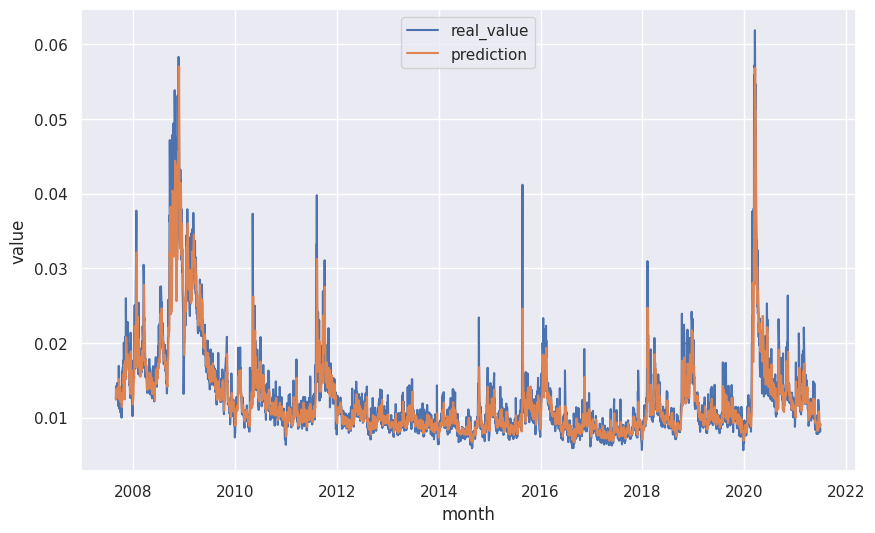

In [685]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

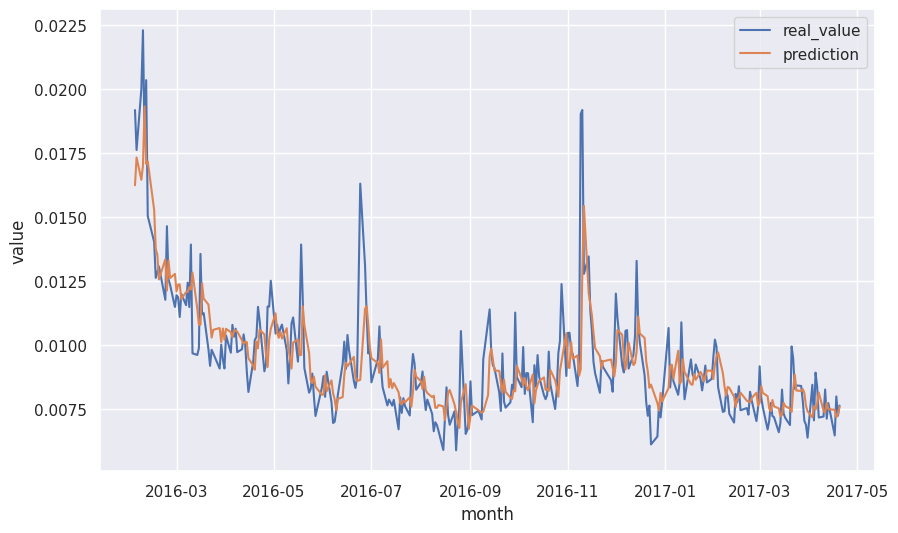

In [686]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Fold 2

##### Test Train & Predict Model

In [687]:
# variables
fh = 1
fold = 2

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'conv_0_filters': 32,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.002
}

In [688]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [689]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,809 (108.63 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

In [690]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 16:12:23.966178: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11723847831891133762
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 16:12:24.485884: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:12:24.485930: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:12:24.485936: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356
2024-12-10 16:12:26.705497: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

In [691]:
# evaluate model
model.evaluate(example_test_ds)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 10.4311 - mean_squared_error: 3.7049e-06 - root_mean_squared_error: 0.0019


2024-12-10 16:15:13.010270: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:15:13.010337: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:15:13.010345: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356


[10.309349060058594, 3.4221595797134796e-06, 0.0018499080324545503]

In [692]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


In [693]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step


In [694]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [695]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 83,301 (325.40 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

 Optimizer params: 55,492 (216.77 KB)

##### Test Evaluate Model

In [696]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

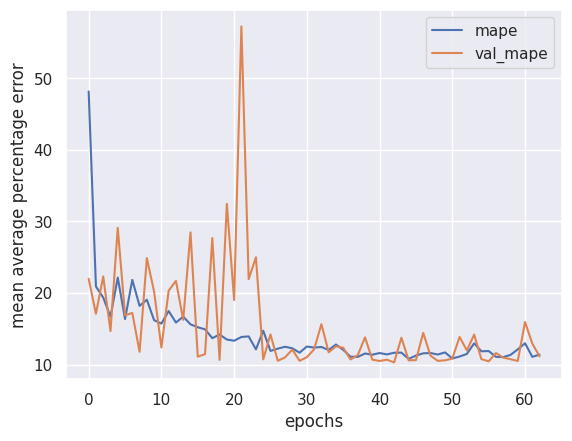

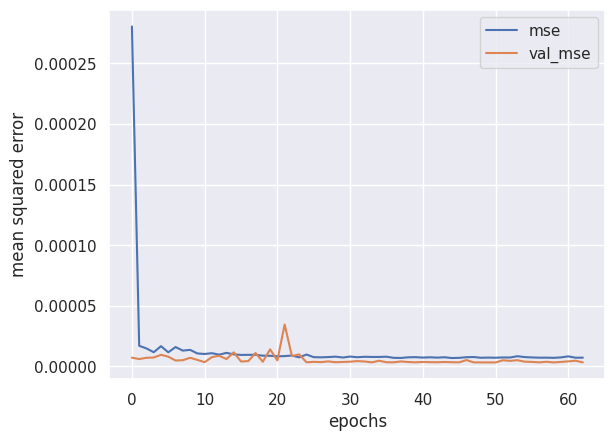

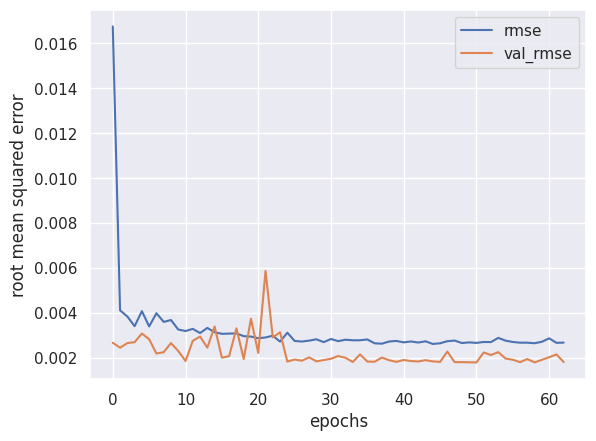

In [697]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

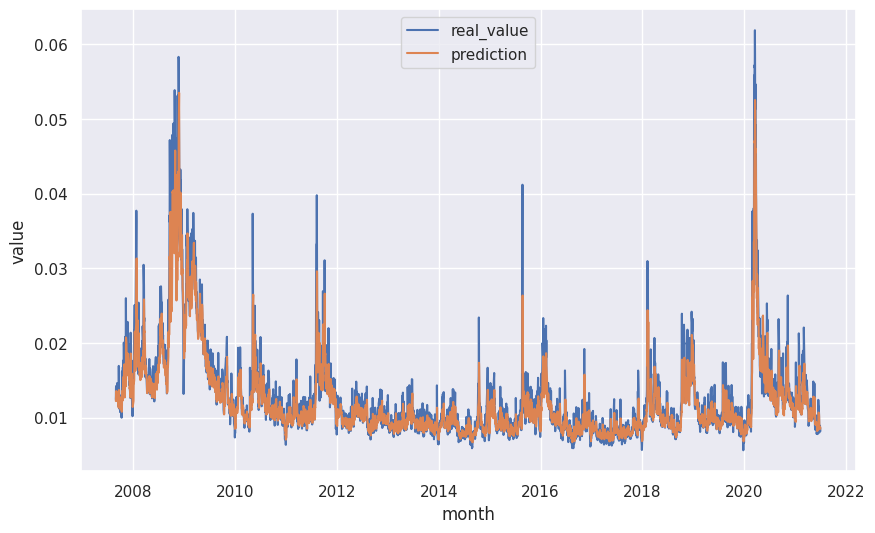

In [698]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

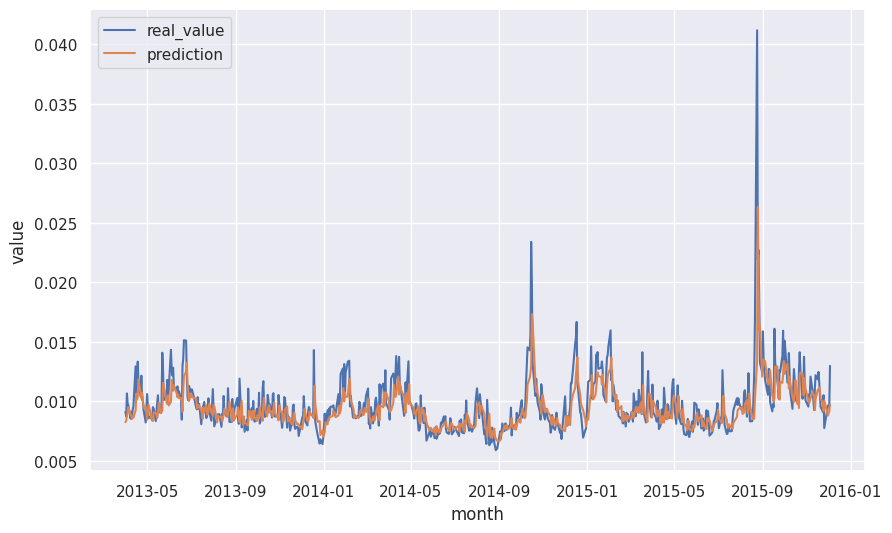

In [699]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (60:40)

In [700]:
# variables
fh = 1
fold = 2

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'conv_0_filters': 32,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.002
}

In [701]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [702]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,809 (108.63 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

In [703]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 16:15:23.338537: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:15:23.338581: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:15:23.338588: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356
2024-12-10 16:15:25.726288: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12851918784981813335
2024-12-10 16:15:25.726340: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

In [704]:
# evaluate model
model.evaluate(example_test_ds)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 10.5671 - mean_squared_error: 2.7550e-06 - root_mean_squared_error: 0.0017


2024-12-10 16:17:41.002182: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:17:41.002238: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:17:41.002245: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356


[10.240631103515625, 3.4547595078038285e-06, 0.0018586983205750585]

In [705]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


In [706]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step


In [707]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv', index=False)

In [708]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 83,301 (325.40 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

 Optimizer params: 55,492 (216.77 KB)

##### Test Evaluate Model (60:40)

In [709]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv')

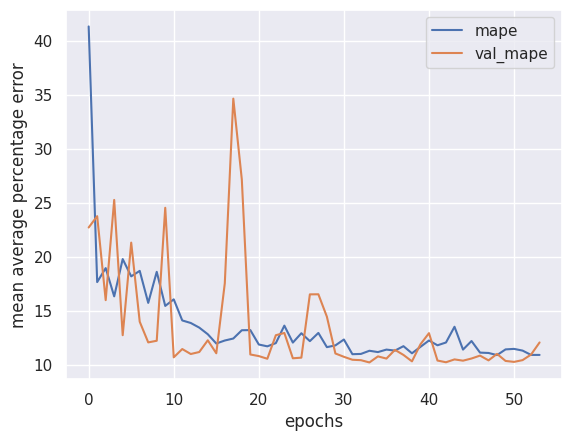

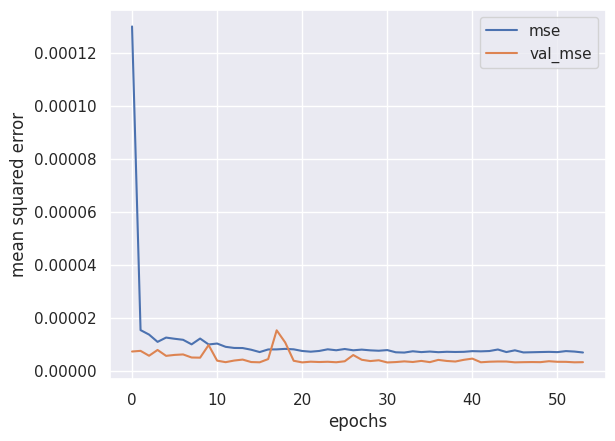

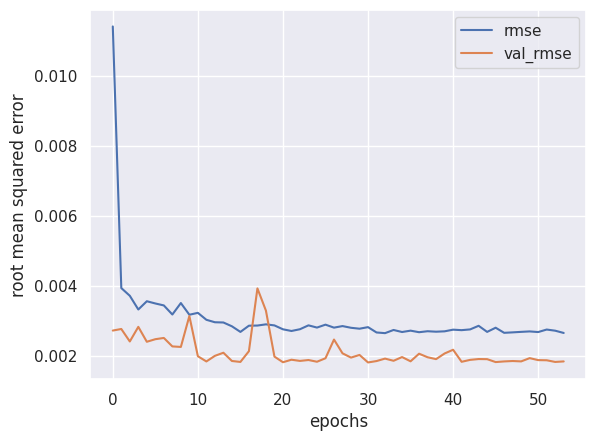

In [710]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

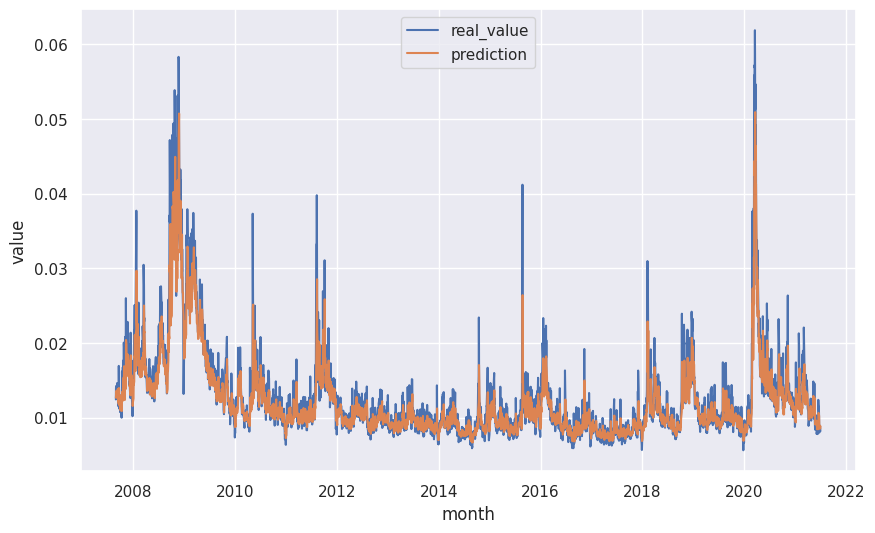

In [711]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

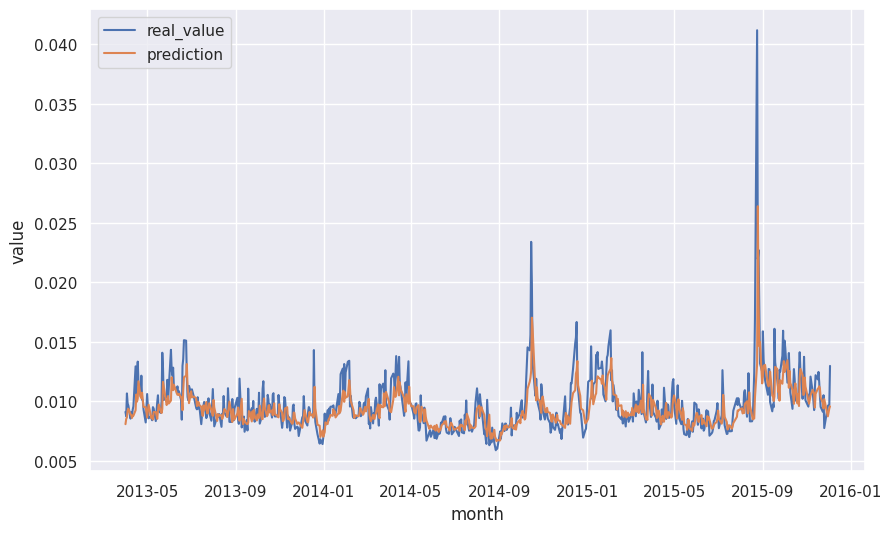

In [712]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [713]:
# variables
fh = 1
fold = 2

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'conv_0_filters': 32,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.002
}

In [714]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [715]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,809 (108.63 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

In [716]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 16:17:48.563375: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12851918784981813335
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 16:17:49.074370: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:17:49.074418: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:17:50.466854: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12851918784981813335
2024-12-10 16:17:50.640216: I tensorflow/core/framework/local_rendezvous.cc:423] Local

In [717]:
# evaluate model
model.evaluate(example_test_ds)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 10.0491 - mean_squared_error: 3.6490e-06 - root_mean_squared_error: 0.0019


2024-12-10 16:19:01.321359: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:19:01.321435: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:19:01.321443: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356


[10.037466049194336, 4.059838374814717e-06, 0.002014904050156474]

In [718]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


In [719]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


In [720]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [721]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 83,301 (325.40 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

 Optimizer params: 55,492 (216.77 KB)

##### Test Evaluate Model (50% 80:20)

In [722]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

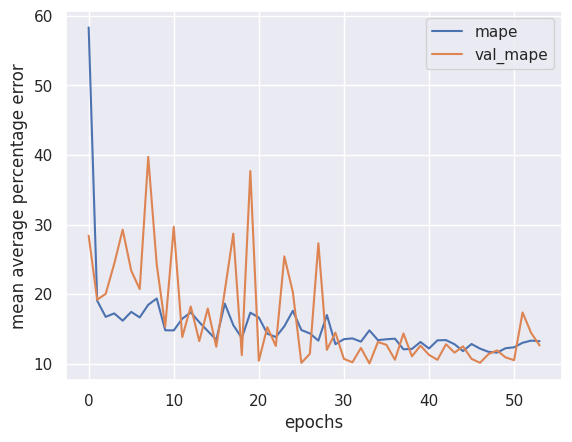

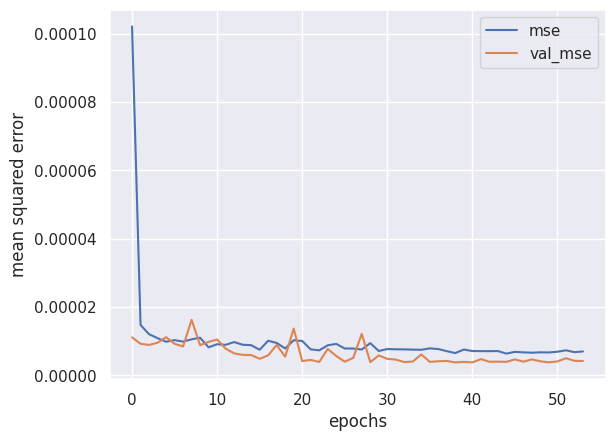

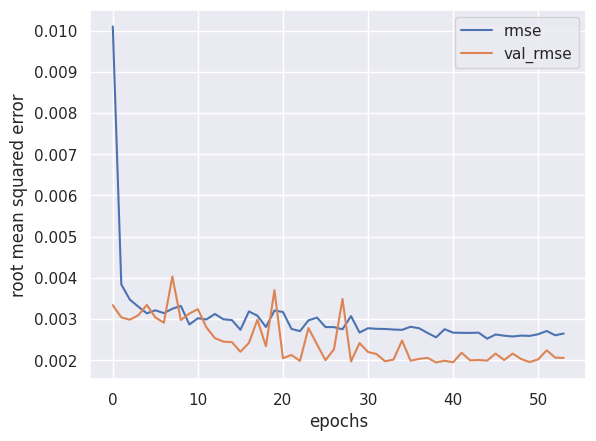

In [723]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

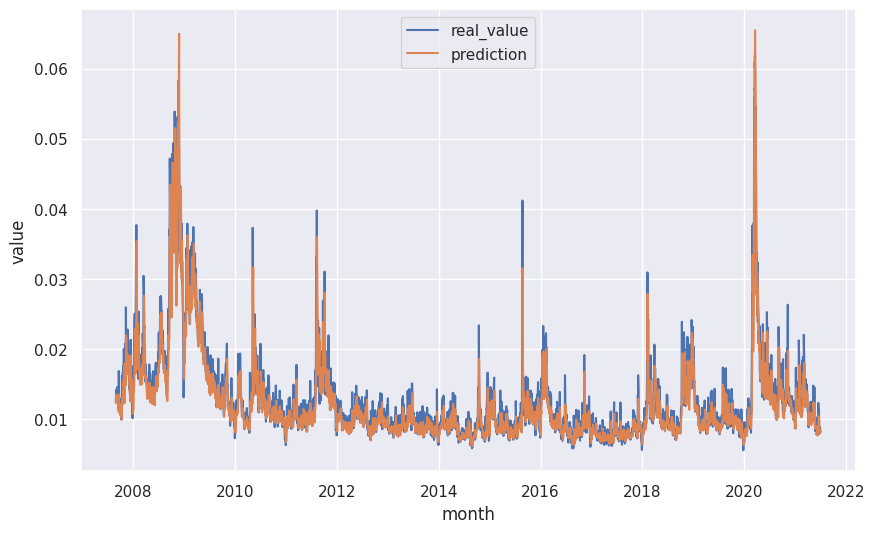

In [724]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

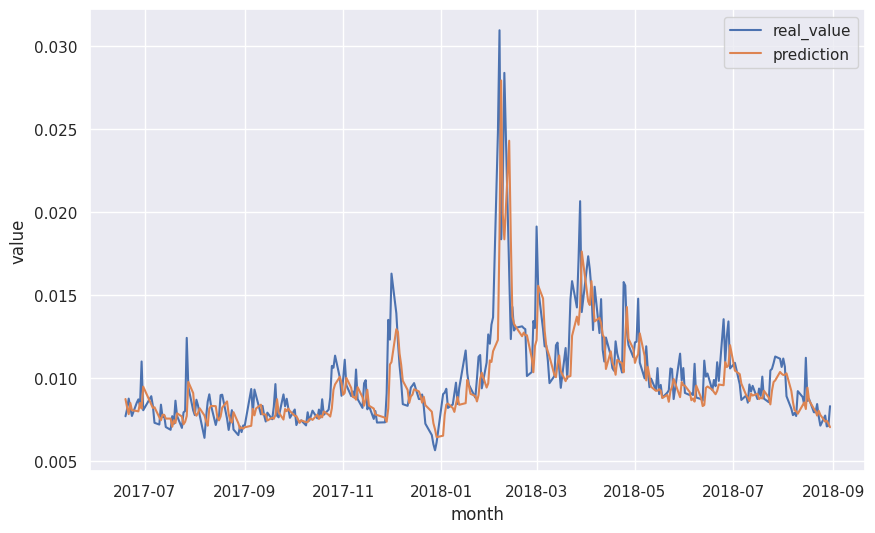

In [725]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Fold 3

##### Test Train & Predict Model

In [726]:
# variables
fh = 1
fold = 3

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'conv_0_filters': 32,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.002
}

In [727]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [728]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,809 (108.63 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

In [729]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 16:19:10.858718: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:19:10.858952: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:19:10.859017: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356
2024-12-10 16:19:13.882422: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:19:13.882476: I tensorflow/core/framework/local_rendezvous.cc:423] Local r

In [730]:
# evaluate model
model.evaluate(example_test_ds)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 9.6528 - mean_squared_error: 2.4987e-06 - root_mean_squared_error: 0.0016


2024-12-10 16:22:47.252436: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:22:47.252524: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:22:47.252543: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356


[9.609304428100586, 3.052326292163343e-06, 0.0017470907187089324]

In [731]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


In [732]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


In [733]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [734]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 83,301 (325.40 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

 Optimizer params: 55,492 (216.77 KB)

##### Test Evaluate Model

In [735]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

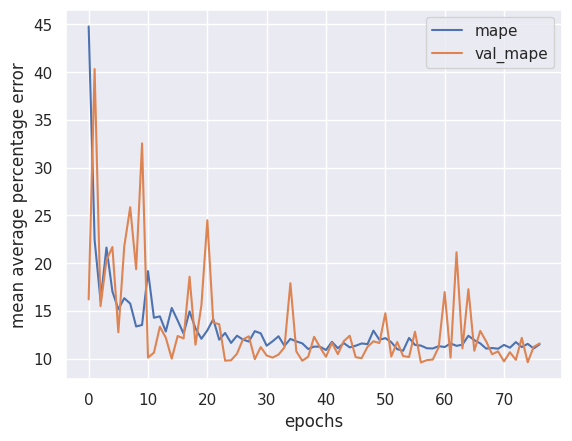

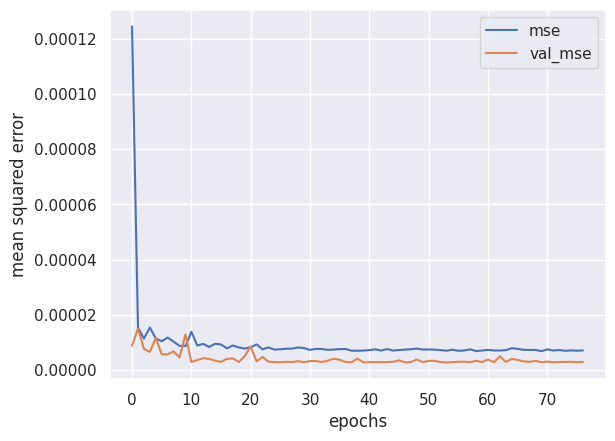

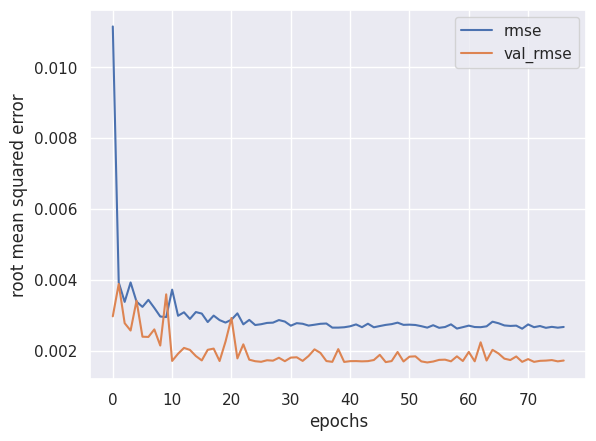

In [736]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

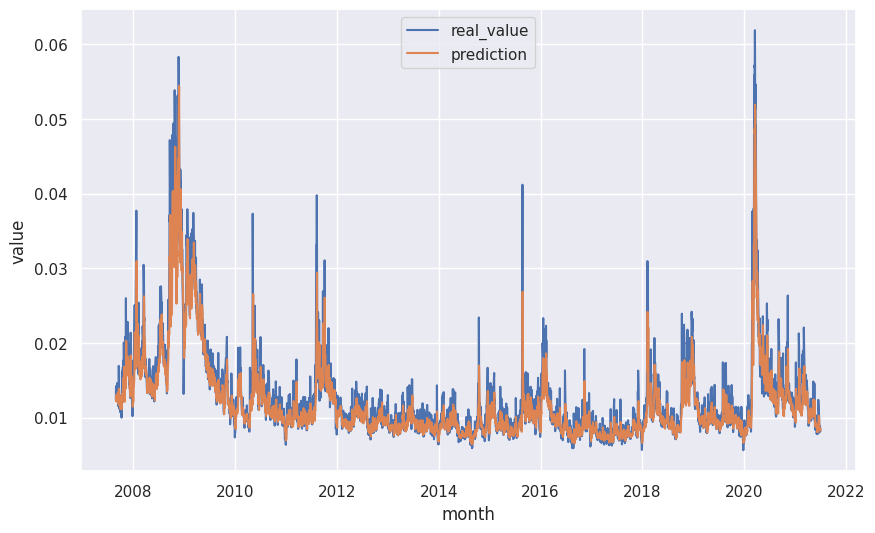

In [737]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

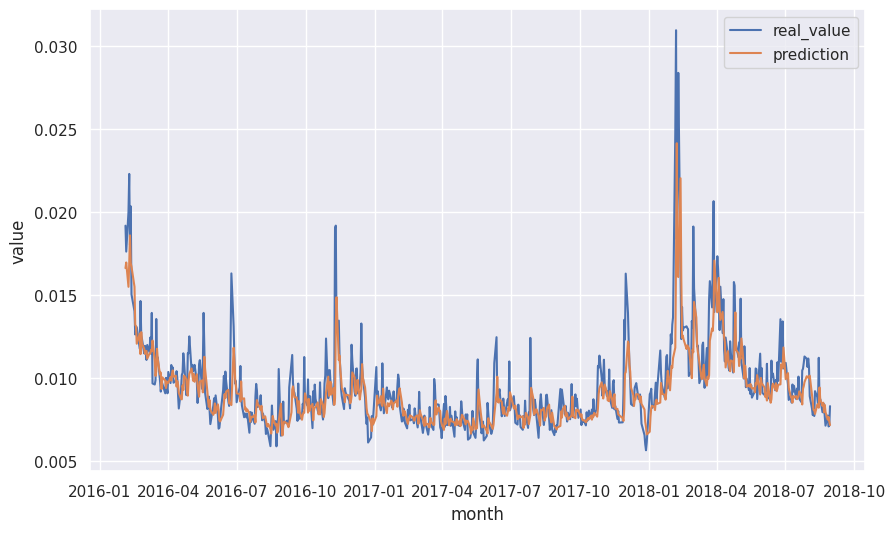

In [738]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (60:40)

In [739]:
# variables
fh = 1
fold = 3

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'conv_0_filters': 32,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.002
}

In [740]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [741]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,809 (108.63 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

In [742]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 16:23:00.356938: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:23:00.357057: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:23:00.357082: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356
2024-12-10 16:23:05.874447: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:23:11.117470: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

In [743]:
# evaluate model
model.evaluate(example_test_ds)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 9.9817 - mean_squared_error: 3.0477e-06 - root_mean_squared_error: 0.0017


2024-12-10 16:24:30.140657: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:24:30.140743: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:24:30.140754: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356


[9.850902557373047, 2.9104237455612747e-06, 0.001705996342934668]

In [744]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


In [745]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


In [746]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv', index=False)

In [747]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 83,301 (325.40 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

 Optimizer params: 55,492 (216.77 KB)

##### Test Evaluate Model (60:40)

In [748]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv')

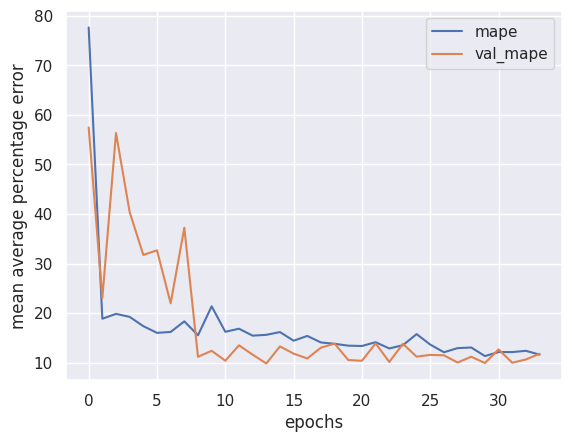

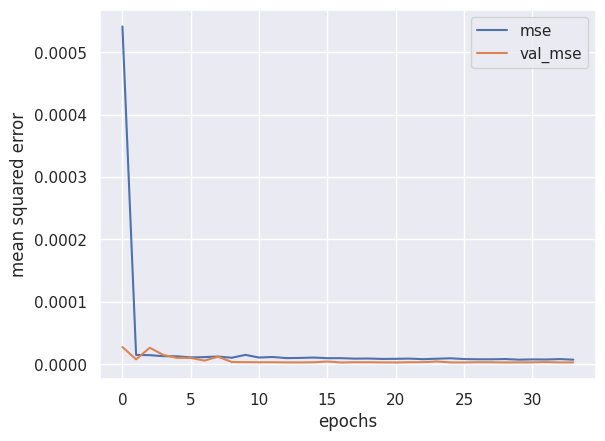

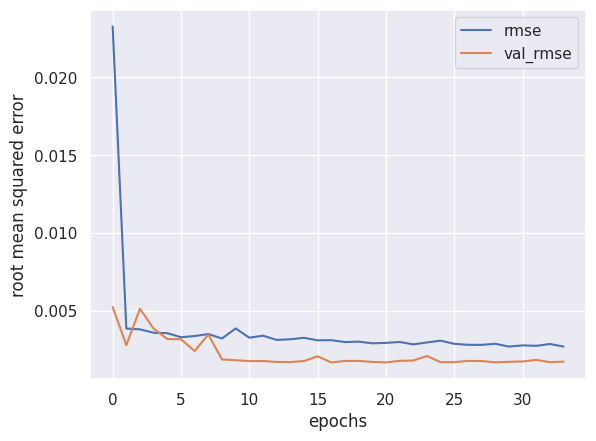

In [749]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

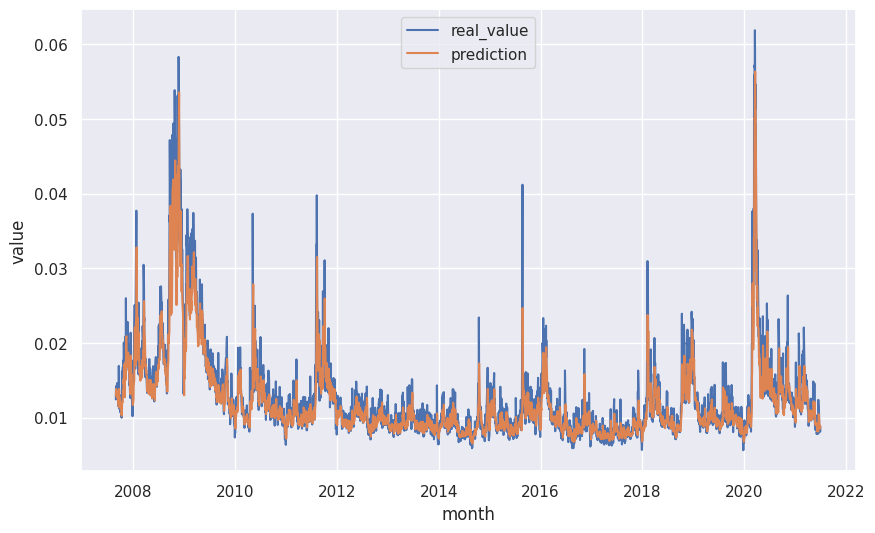

In [750]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

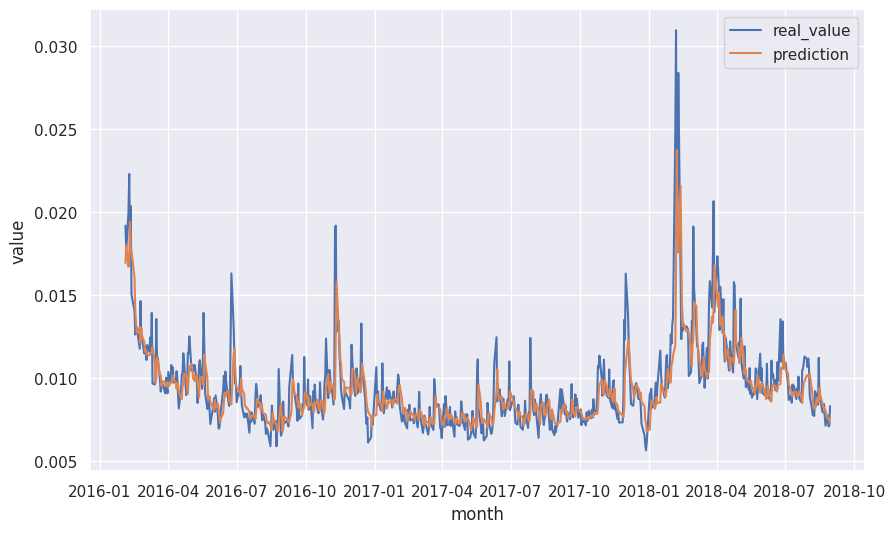

In [751]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [752]:
# variables
fh = 1
fold = 3

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'conv_0_filters': 32,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.002
}

In [753]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [754]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,809 (108.63 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

In [755]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 16:24:40.835318: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:24:40.835579: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:24:40.836188: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356
2024-12-10 16:24:42.114750: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12851918784981813335
2024-12-10 16:24:42.114830: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

In [756]:
# evaluate model
model.evaluate(example_test_ds)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 10.6983 - mean_squared_error: 3.1395e-06 - root_mean_squared_error: 0.0018


2024-12-10 16:25:42.187236: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:25:42.187291: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:25:42.187298: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356


[10.8182954788208, 3.306845201223041e-06, 0.0018184733344241977]

In [757]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


In [758]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


In [759]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [760]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 83,301 (325.40 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

 Optimizer params: 55,492 (216.77 KB)

##### Test Evaluate Model (50% 80:20)

In [761]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

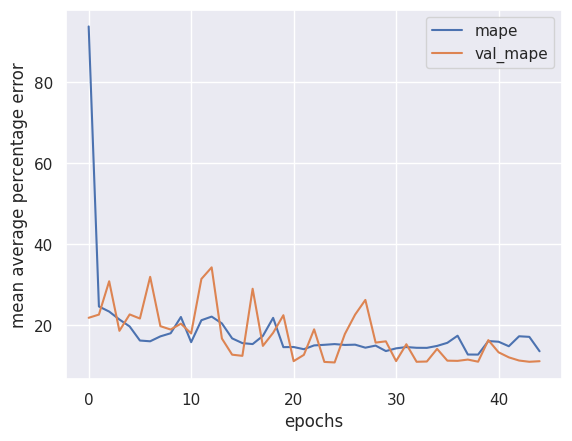

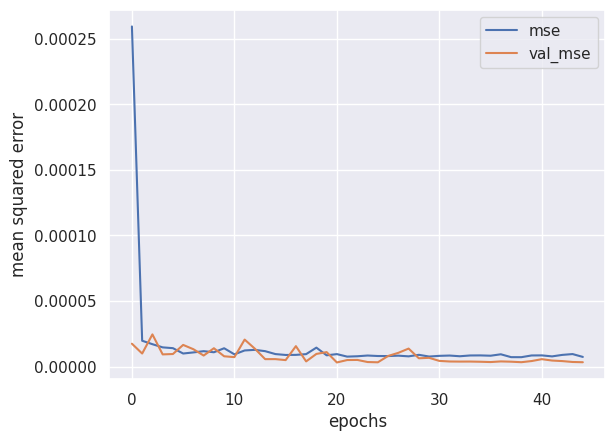

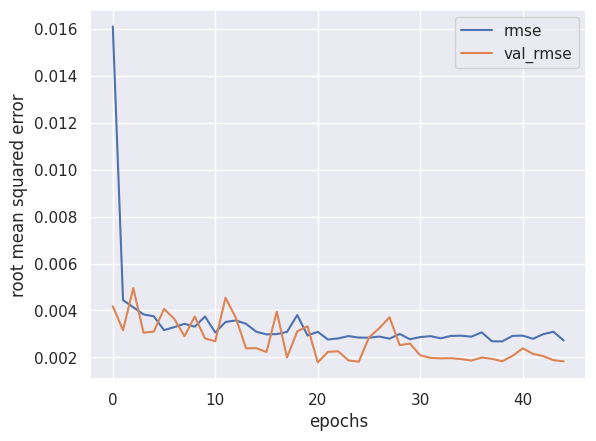

In [762]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

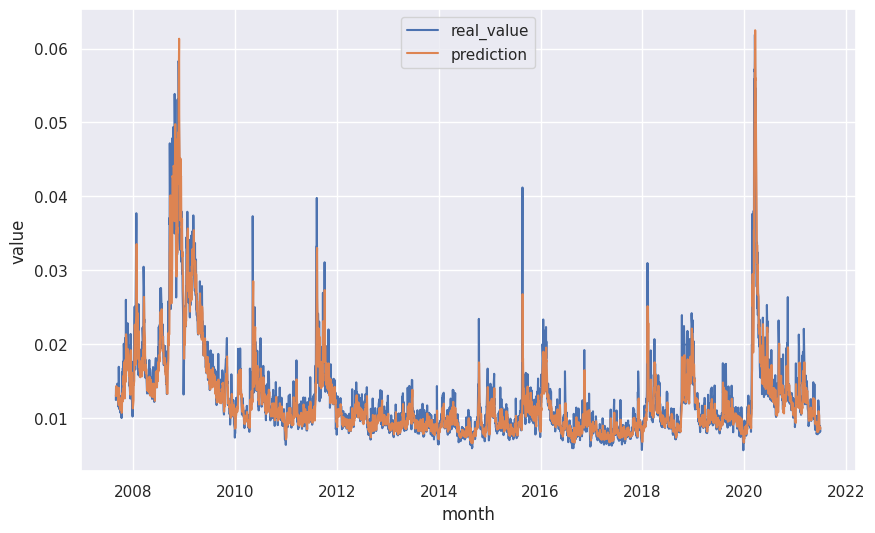

In [763]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

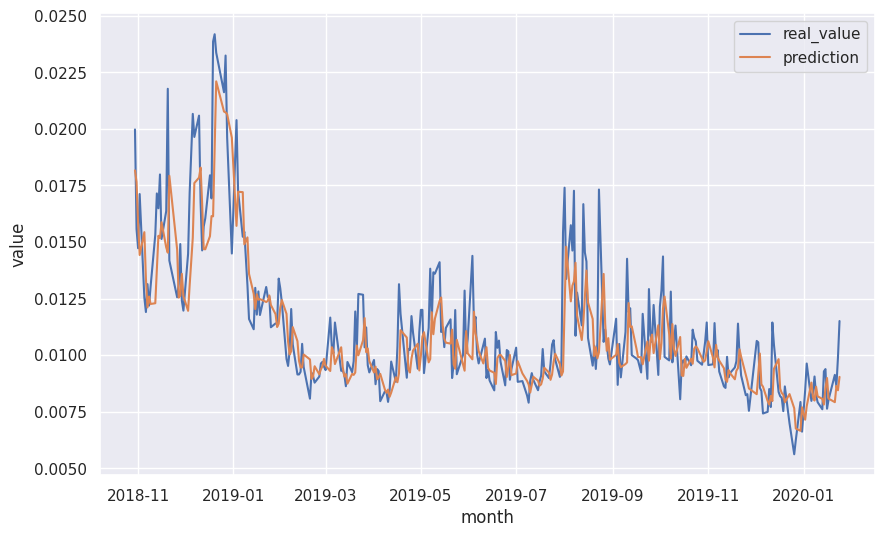

In [764]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Fold 4

##### Test Train & Predict Model

In [765]:
# variables
fh = 1
fold = 4

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'conv_0_filters': 32,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.002
}

In [766]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [767]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,809 (108.63 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

In [768]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
W0000 00:00:1733844352.510312    3534 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844352.516865    3534 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844352.522750    3534 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844352.528646    3534 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844352.534591    3534 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844352.540658    3534 gpu_timer.cc:114] Skipping the delay kernel, me

In [769]:
# evaluate model
model.evaluate(example_test_ds)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 11.1286 - mean_squared_error: 8.4563e-06 - root_mean_squared_error: 0.0029


2024-12-10 16:28:00.349799: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460


[11.29922103881836, 1.0024237781181e-05, 0.0031661076936870813]

In [770]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


In [771]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step


In [772]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [773]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 83,301 (325.40 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

 Optimizer params: 55,492 (216.77 KB)

##### Test Evaluate Model

In [774]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

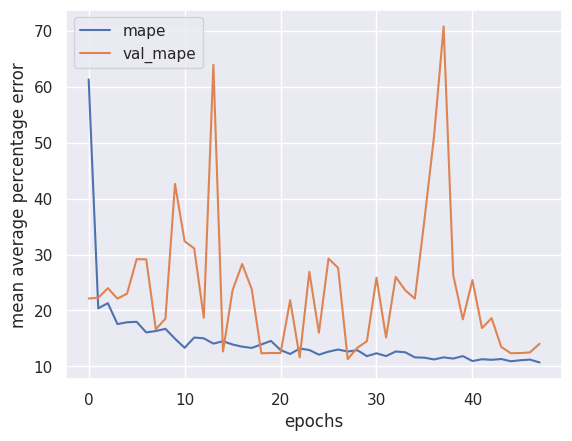

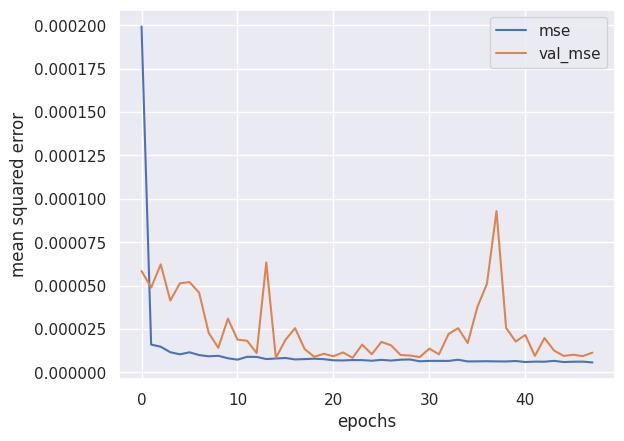

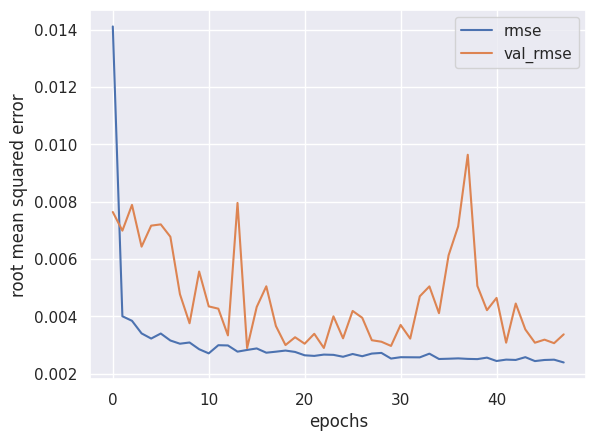

In [775]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

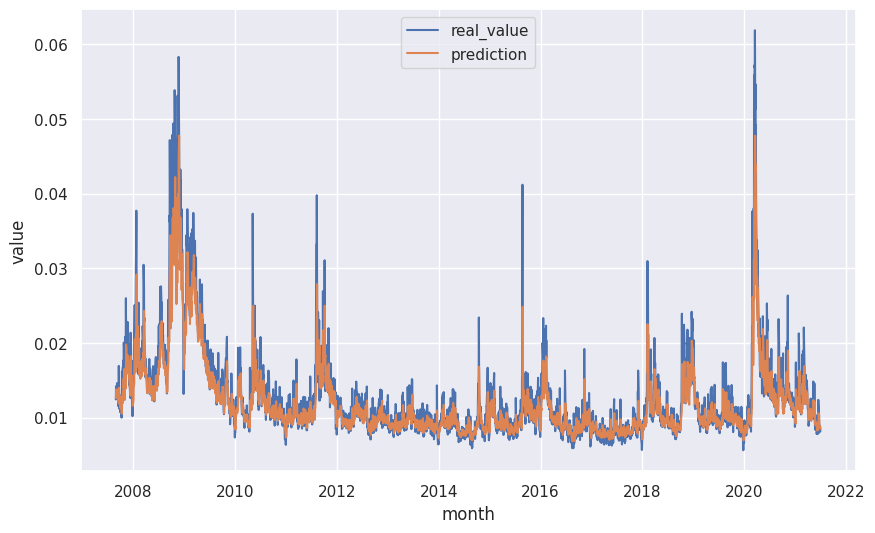

In [776]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

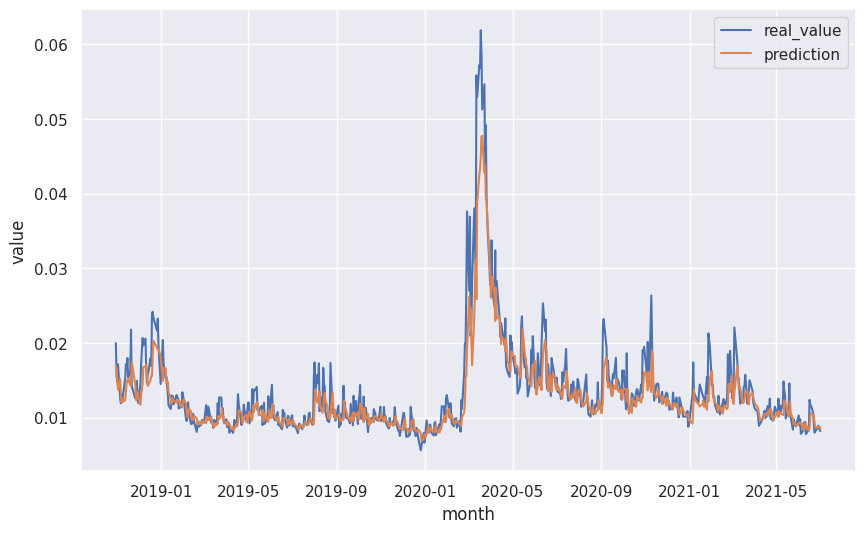

In [777]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [778]:
# variables
fh = 1
fold = 4

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'conv_0_filters': 32,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.002
}

In [779]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [780]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 27,809 (108.63 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

In [781]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

W0000 00:00:1733844488.789279    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844488.795818    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844488.801751    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844488.807676    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844488.813614    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844488.819578    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844488.825413    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844488.831328    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844488.837337    3538 gp

In [782]:
# evaluate model
model.evaluate(example_test_ds)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 11.5288 - mean_squared_error: 7.9180e-06 - root_mean_squared_error: 0.0028


2024-12-10 16:29:13.356052: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:29:13.356108: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:29:13.356117: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356


[11.716796875, 8.15598377812421e-06, 0.002855868311598897]

In [783]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

106/106 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


In [784]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step


In [785]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [786]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 40, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 20, 32)         │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 20, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        27,008 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 83,301 (325.40 KB)

 Trainable params: 27,745 (108.38 KB)

 Non-trainable params: 64 (256.00 B)

 Optimizer params: 55,492 (216.77 KB)

##### Test Evaluate Model (50% 80:20)

In [787]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

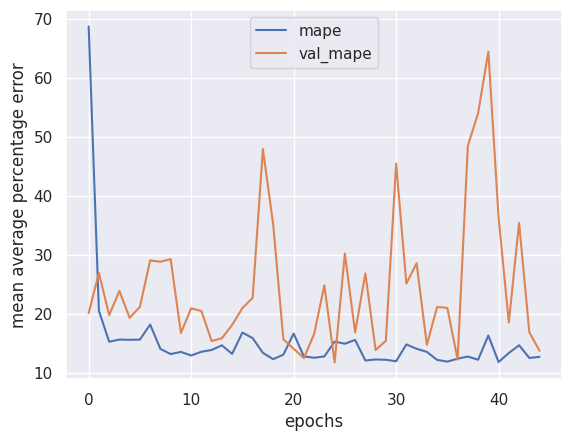

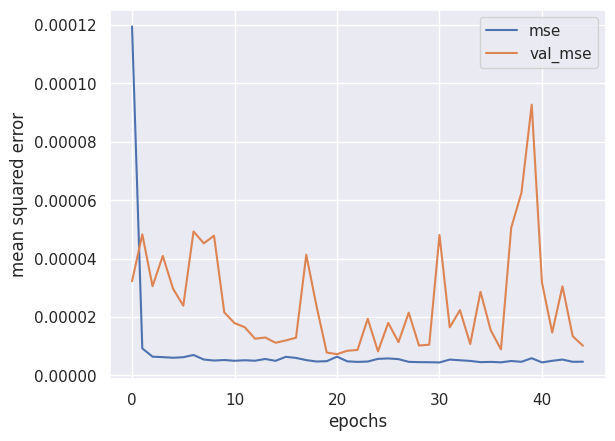

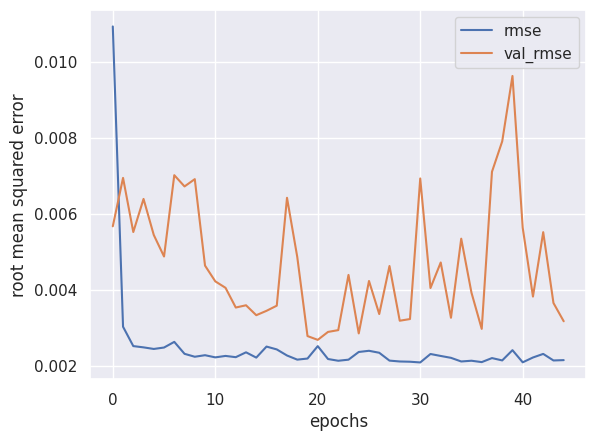

In [788]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

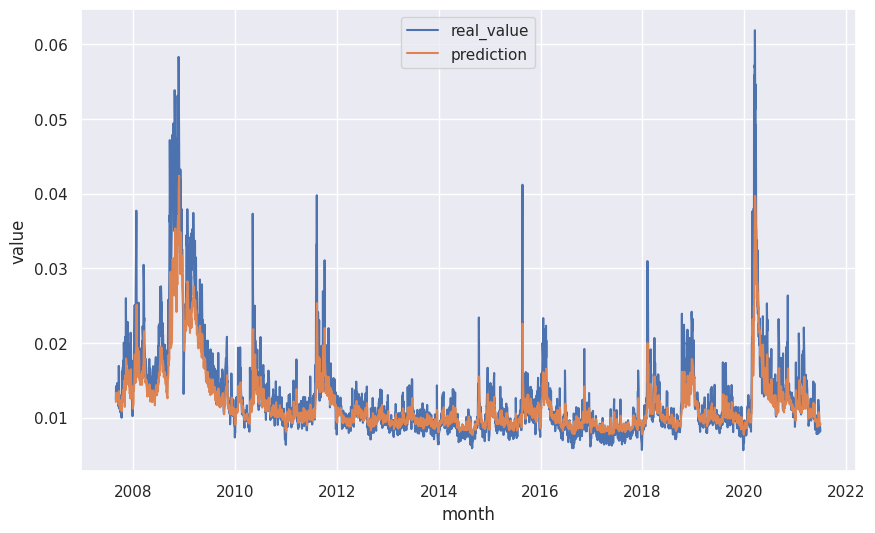

In [789]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

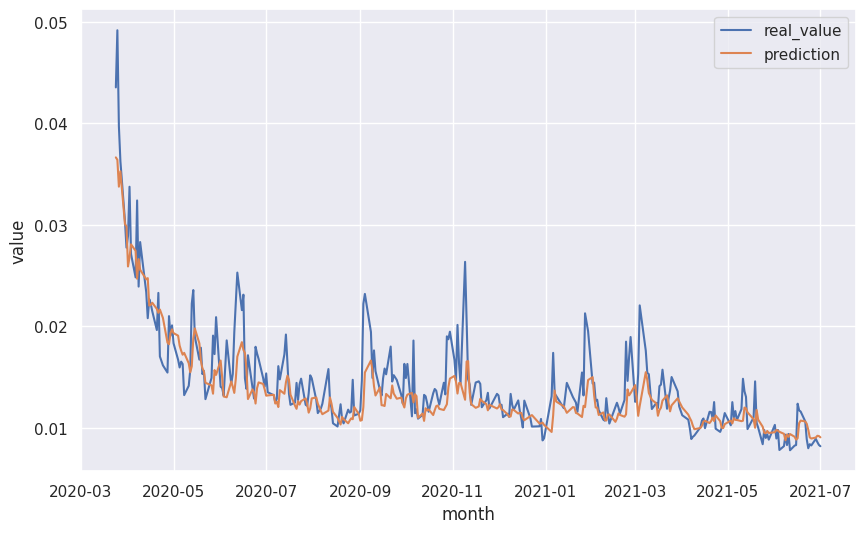

In [790]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Summary

In [791]:
# variables
fh = 1

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 40,
    'conv_0_filters': 32,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 16,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.002
}

60:40

In [792]:
# load model in keras format
cnnbilstm_models = [tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras') for fold in range(4)]

# load test dataset
example_test_dss = []
for fold in range(4):
    example_test_dss.append(create_window_dataset(
        series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/test_{fold}.npy'), axis=-1),
        window_size=example_hps['window_size'],
        forecast_horizon=fh,
        batch_size=batch_size,
        shuffle_buffer=shuffle_buffer,
    ))

In [793]:
# evaluate model
evaluation_results = np.array([cnnbilstm_models[fold].evaluate(example_test_dss[fold]) for fold in range(4)])

42/42 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 10.4300 - mean_squared_error: 8.3748e-06 - root_mean_squared_error: 0.0029


2024-12-10 16:29:19.466524: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:29:19.466579: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:29:19.466586: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


42/42 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 10.0389 - mean_squared_error: 3.5670e-06 - root_mean_squared_error: 0.0019


2024-12-10 16:29:20.756831: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:29:20.756898: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:29:20.756906: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356


42/42 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - loss: 9.9691 - mean_squared_error: 3.2872e-06 - root_mean_squared_error: 0.0018


2024-12-10 16:29:21.803604: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:29:21.803655: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:29:21.803661: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356


     41/Unknown 1s 12ms/step - loss: 11.0008 - mean_squared_error: 5.7531e-06 - root_mean_squared_error: 0.0024

W0000 00:00:1733844562.844065    3537 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844562.850932    3537 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844562.857237    3537 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844562.863511    3537 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844562.870074    3537 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844562.876392    3537 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844562.882728    3537 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844562.889283    3537 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844562.896015    3537 gp

42/42 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - loss: 10.9850 - mean_squared_error: 5.7538e-06 - root_mean_squared_error: 0.0024


2024-12-10 16:29:23.060083: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:29:23.060165: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:29:23.060181: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356


In [794]:
evaluation_results

array([[1.09716663e+01, 7.54446683e-06, 2.74671917e-03],
       [1.00499706e+01, 3.52901543e-06, 1.87856739e-03],
       [1.01275854e+01, 3.34128845e-06, 1.82791916e-03],
       [1.06606283e+01, 5.76811726e-06, 2.40169046e-03]])

In [795]:
np.mean(evaluation_results, axis=0)

array([1.04524627e+01, 5.04572199e-06, 2.21372404e-03])

50% 80:20

In [796]:
# load model in keras format
cnnbilstm_models = [tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras') for fold in range(5)]

# load test dataset
example_test_dss = []
for fold in range(5):
    example_test_dss.append(create_window_dataset(
        series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
        window_size=example_hps['window_size'],
        forecast_horizon=fh,
        batch_size=batch_size,
        shuffle_buffer=shuffle_buffer,
    ))

In [797]:
# evaluate model
evaluation_results = np.array([cnnbilstm_models[fold].evaluate(example_test_dss[fold]) for fold in range(5)])

10/10 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - loss: 11.9642 - mean_squared_error: 1.0263e-05 - root_mean_squared_error: 0.0031


2024-12-10 16:29:24.866204: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:29:24.866260: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:29:24.866266: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356


10/10 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 9.9241 - mean_squared_error: 2.0261e-06 - root_mean_squared_error: 0.0014


2024-12-10 16:29:25.434565: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:29:25.434627: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:29:25.434634: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356


10/10 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - loss: 10.0680 - mean_squared_error: 3.1912e-06 - root_mean_squared_error: 0.0018
10/10 ━━━━━━━━━━━━━━━━━━━━ 1s 39ms/step - loss: 11.0513 - mean_squared_error: 3.2098e-06 - root_mean_squared_error: 0.0018


2024-12-10 16:29:26.804481: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356


10/10 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - loss: 11.1796 - mean_squared_error: 6.8756e-06 - root_mean_squared_error: 0.0026


2024-12-10 16:29:27.701412: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7998323107521156001
2024-12-10 16:29:27.701533: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10787713525770228460
2024-12-10 16:29:27.701546: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8505568986394107356


In [798]:
evaluation_results

array([[1.11407528e+01, 5.56534178e-06, 2.35909759e-03],
       [1.01088572e+01, 2.09378049e-06, 1.44699006e-03],
       [1.00375948e+01, 4.05961555e-06, 2.01484864e-03],
       [1.08181038e+01, 3.30671423e-06, 1.81843736e-03],
       [1.17167749e+01, 8.15586191e-06, 2.85584689e-03]])

In [799]:
np.mean(evaluation_results, axis=0)

array([1.07644167e+01, 4.63626279e-06, 2.09904411e-03])

### FH 5

#### Fold 0

##### Test Train & Predict Model

In [800]:
# variables
fh = 5
fold = 0

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.2,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.0015
}

In [801]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [802]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,969 (46.75 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

In [803]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

W0000 00:00:1733844571.072845    3535 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844571.087420    3535 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844571.100848    3535 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844571.114299    3535 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844571.128095    3535 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844571.141008    3535 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844571.154581    3535 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844571.168457    3535 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844571.182280    3535 gp

In [804]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 16.0822 - mean_squared_error: 3.1676e-05 - root_mean_squared_error: 0.0056


2024-12-10 16:31:14.029364: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5247513190025600193
2024-12-10 16:31:14.029415: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1673537223875731592


[15.307215690612793, 2.9972006814205088e-05, 0.0054746693931519985]

In [805]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step


W0000 00:00:1733844675.716192    3531 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844675.718648    3531 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844675.720664    3531 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844675.722590    3531 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844675.724968    3531 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844675.727039    3531 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844675.729131    3531 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844675.731191    3531 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844675.733243    3531 gp

In [806]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


In [807]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [808]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,653 (139.27 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 23,684 (92.52 KB)

##### Test Evaluate Model

In [809]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

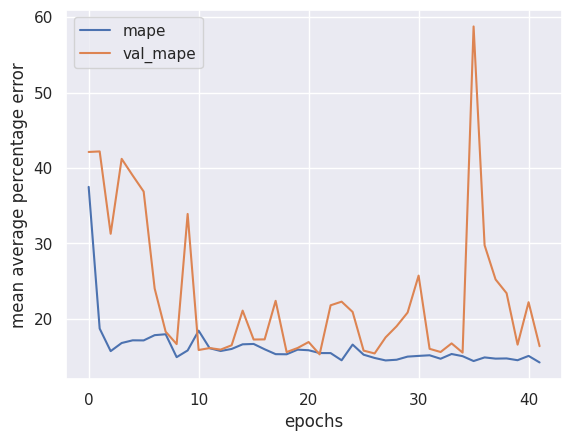

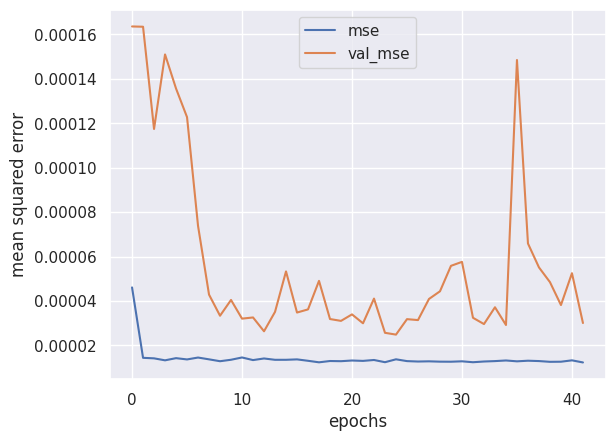

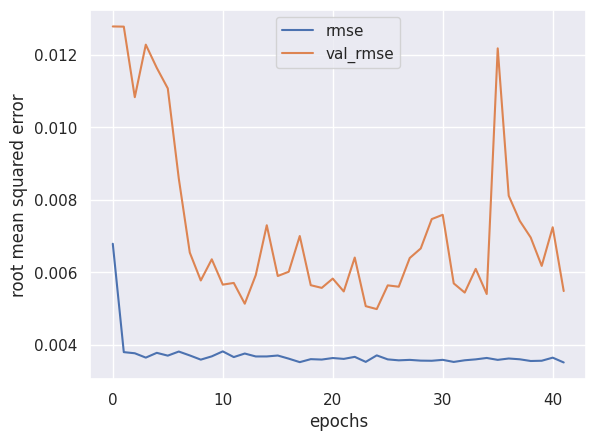

In [810]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

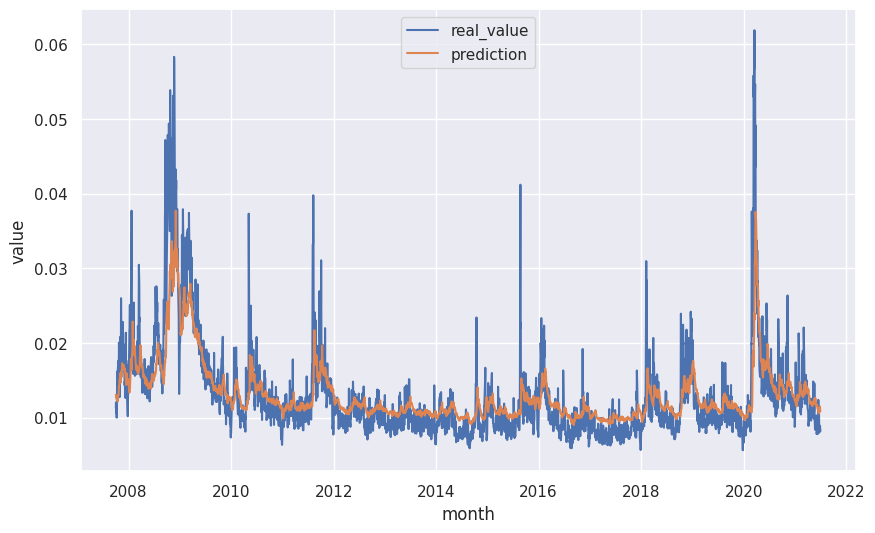

In [811]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

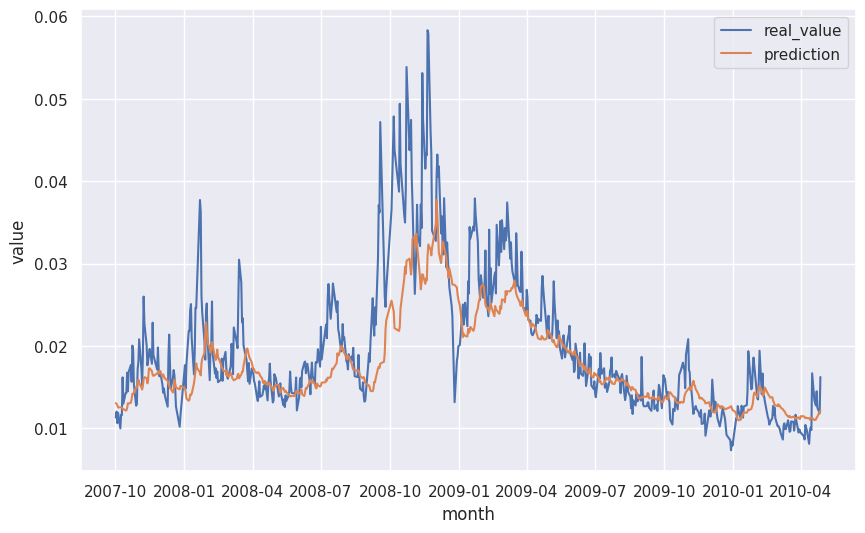

In [812]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (60:40)

In [813]:
# variables
fh = 5
fold = 0

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.2,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.0015
}

In [814]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [815]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,969 (46.75 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

In [816]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 16:31:22.211231: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5247513190025600193
2024-12-10 16:31:22.211798: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1673537223875731592
2024-12-10 16:31:22.211878: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7427147343526948060
2024-12-10 16:31:24.616785: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5247513190025600193
2024-12-10 16:31:24.616850: I tensorflow/core/framework/local_rendezvous.cc:423] Local re

In [817]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 16.0295 - mean_squared_error: 3.3423e-05 - root_mean_squared_error: 0.0058


2024-12-10 16:32:48.150743: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5247513190025600193
2024-12-10 16:32:48.150803: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1673537223875731592
2024-12-10 16:32:48.150811: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7427147343526948060


[15.42671012878418, 3.126991578028537e-05, 0.005591950844973326]

In [818]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


In [819]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


In [820]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv', index=False)

In [821]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,653 (139.27 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 23,684 (92.52 KB)

##### Test Evaluate Model (60:40)

In [822]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv')

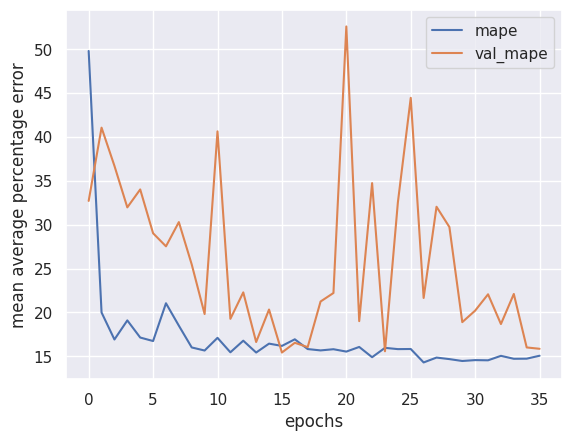

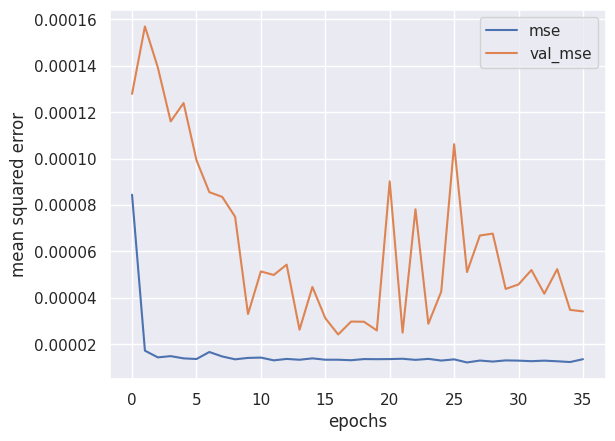

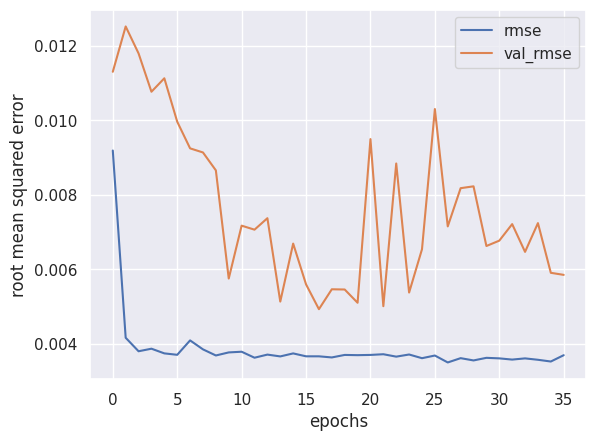

In [823]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

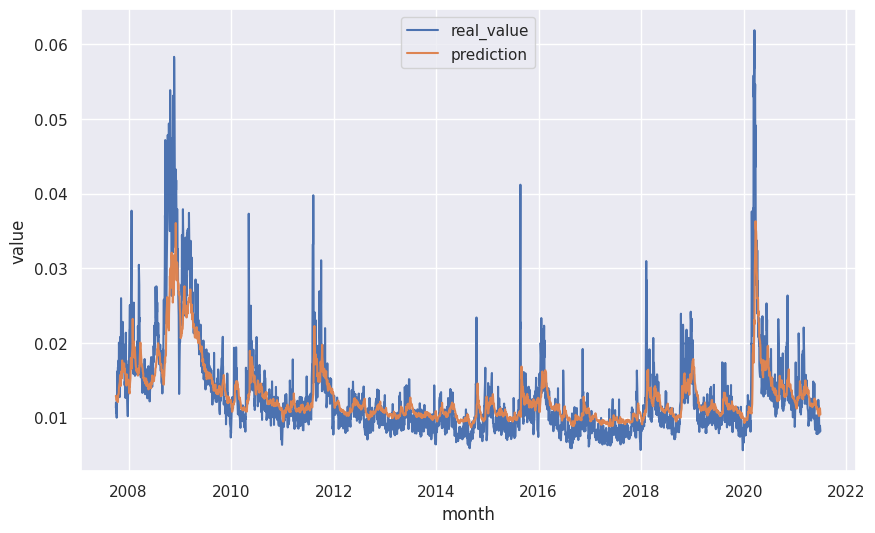

In [824]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

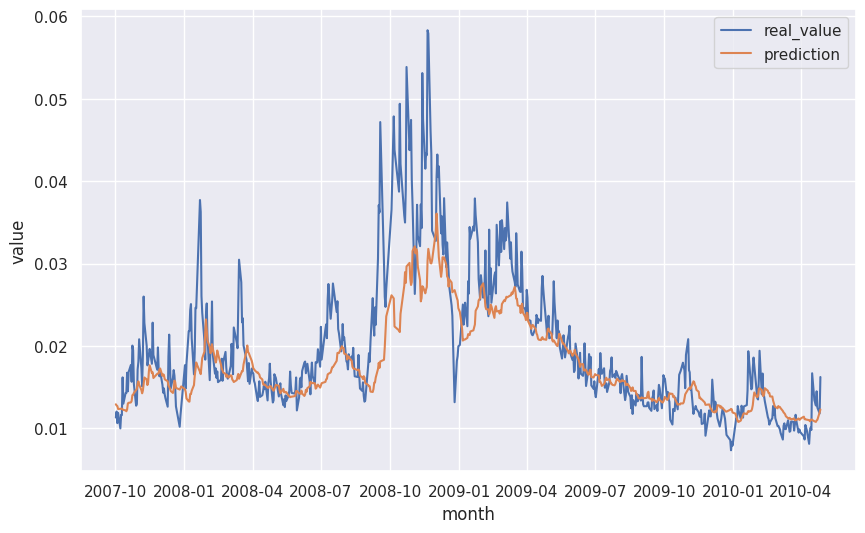

In [825]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [826]:
# variables
fh = 5
fold = 0

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.2,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.0015
}

In [827]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [828]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,969 (46.75 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

In [829]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

W0000 00:00:1733844774.940146    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844774.947066    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844774.953403    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844774.959559    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844774.965707    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844774.972122    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844774.978557    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844774.984882    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733844774.991102    3538 gp

In [830]:
# evaluate model
model.evaluate(example_test_ds)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 16.1440 - mean_squared_error: 1.3744e-05 - root_mean_squared_error: 0.0037


2024-12-10 16:33:32.828066: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5247513190025600193
2024-12-10 16:33:32.828125: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1673537223875731592
2024-12-10 16:33:32.828133: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7427147343526948060


[15.638908386230469, 1.2179961231595371e-05, 0.0034899800084531307]

In [831]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


In [832]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


In [833]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [834]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,653 (139.27 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 23,684 (92.52 KB)

##### Test Evaluate Model (50% 80:20)

In [835]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

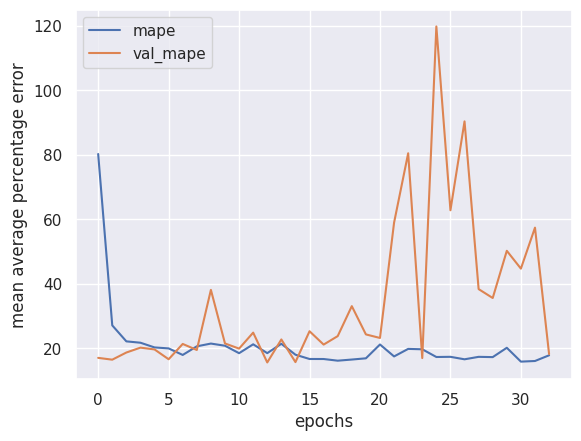

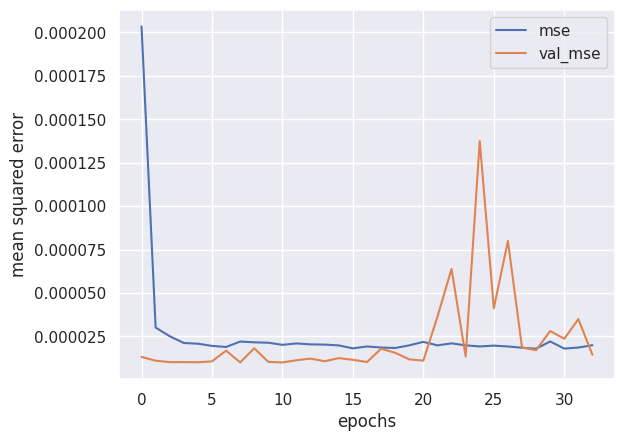

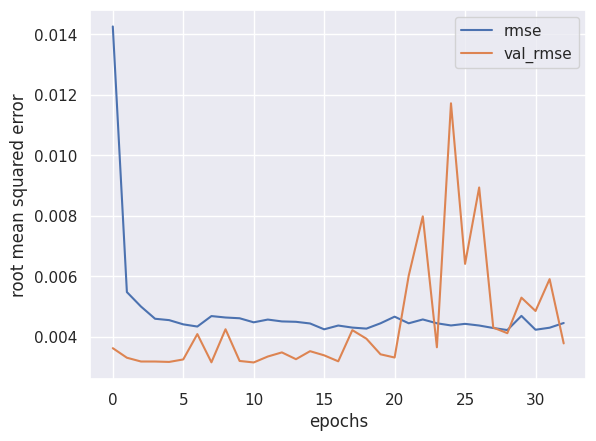

In [836]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

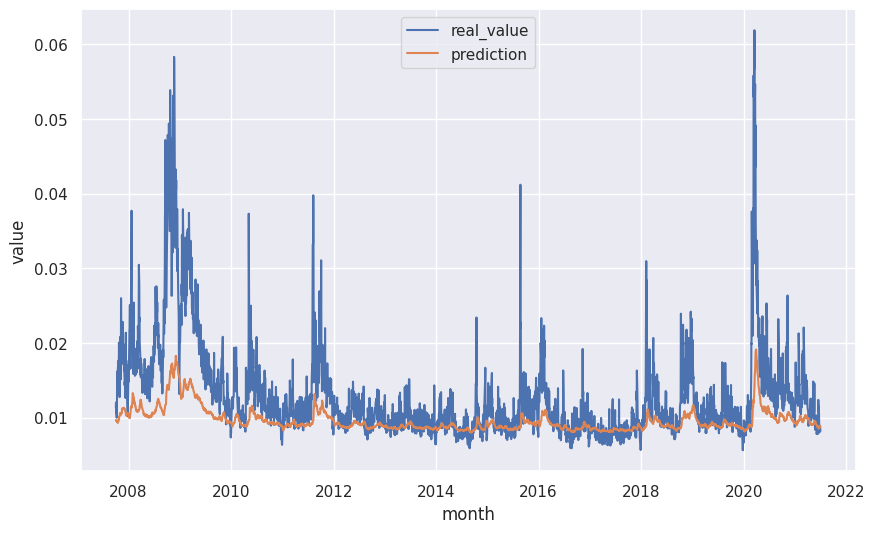

In [837]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

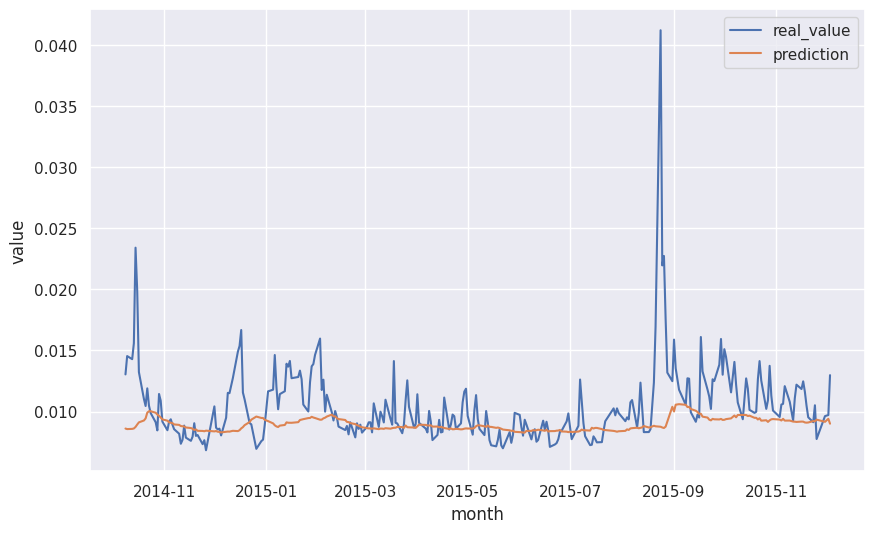

In [838]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Fold 1

##### Test Train & Predict Model

In [839]:
# variables
fh = 5
fold = 1

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.2,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.0015
}

In [840]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [841]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,969 (46.75 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

In [842]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 16:33:44.460679: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1214740784490658851
2024-12-10 16:33:44.460823: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5382299082465053781
2024-12-10 16:33:44.460838: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10527289713454608084
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 16:33:45.313767: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5247513190025600193
2024-12-10 16:33:45.313853: I tensorflow/core/framework/local_rendezvous.cc:423] Local r

In [843]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 11.9035 - mean_squared_error: 6.7301e-06 - root_mean_squared_error: 0.0026


[12.157769203186035, 8.337784493051004e-06, 0.002887522103264928]

In [844]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


In [845]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


In [846]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [847]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,653 (139.27 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 23,684 (92.52 KB)

##### Test Evaluate Model

In [848]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

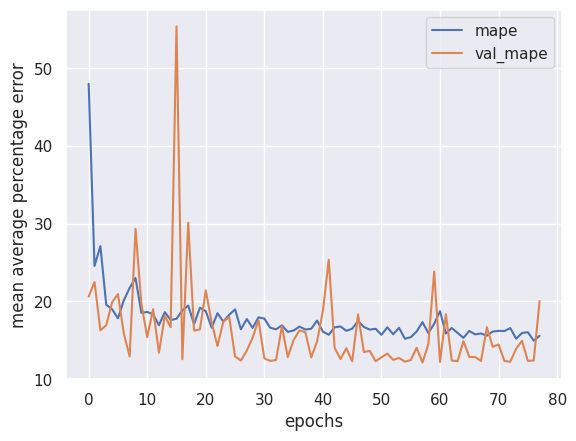

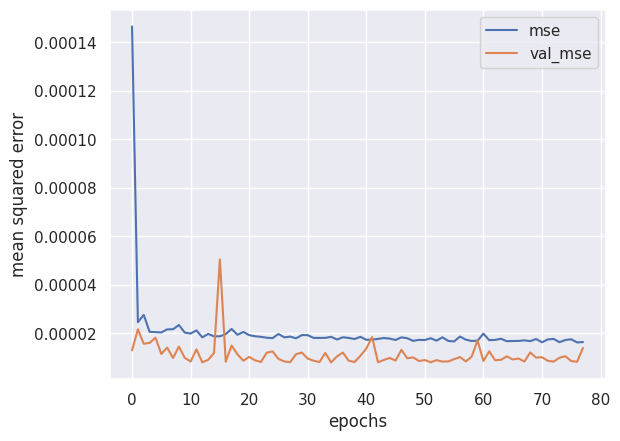

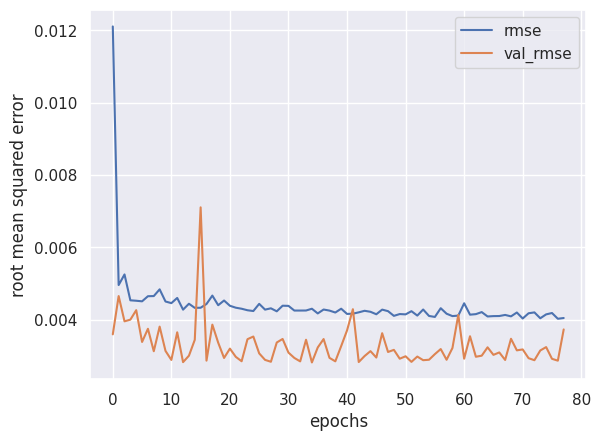

In [849]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

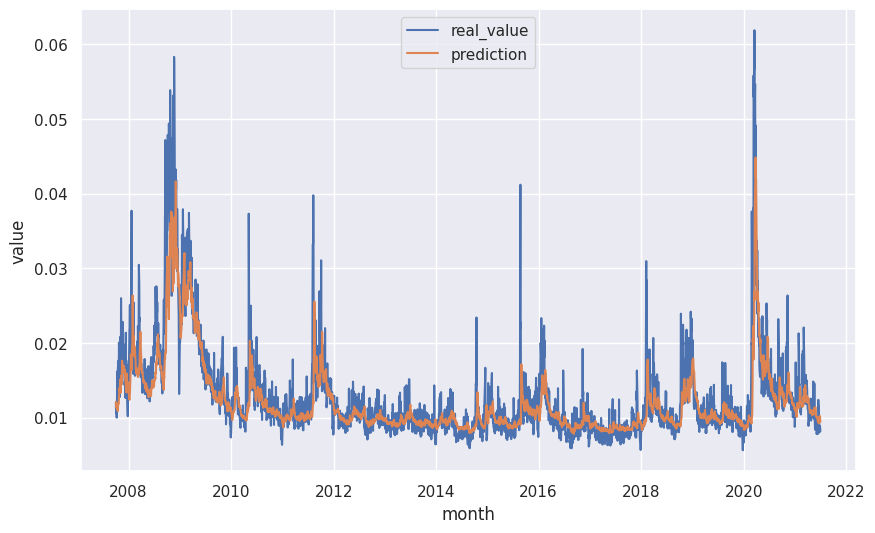

In [850]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

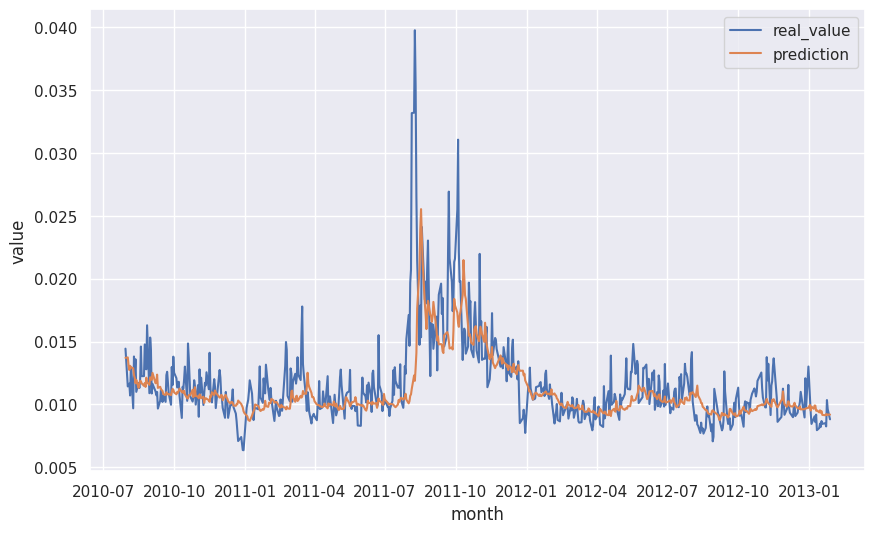

In [851]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (60:40)

In [852]:
# variables
fh = 5
fold = 1

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.2,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.0015
}

In [853]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [854]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,969 (46.75 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

In [855]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 16:37:18.498574: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1673537223875731592
2024-12-10 16:37:20.571032: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1214740784490658851
2024-12-10 16:37:20.571091: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5382299082465053781
2024-12-10 16:37:20.571100: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 9372518003920509882
2024-12-10 16:37:20.571105: I tensorflow/core/framework/local_rendezvous.cc:423] Local re

In [856]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 12.3953 - mean_squared_error: 8.8333e-06 - root_mean_squared_error: 0.0030


[12.22905445098877, 8.387637535633985e-06, 0.0028961417265236378]

In [857]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


In [858]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


In [859]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv', index=False)

In [860]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,653 (139.27 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 23,684 (92.52 KB)

##### Test Evaluate Model (60:40)

In [861]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv')

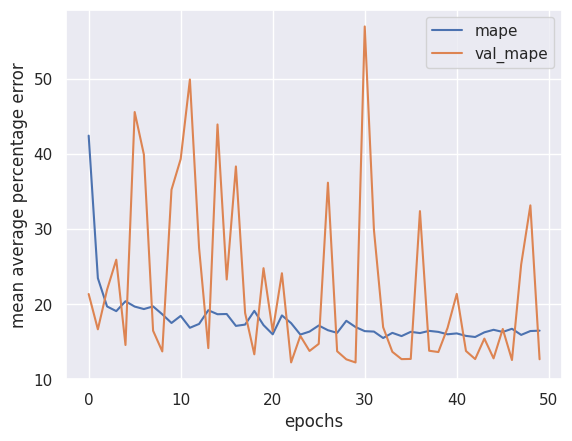

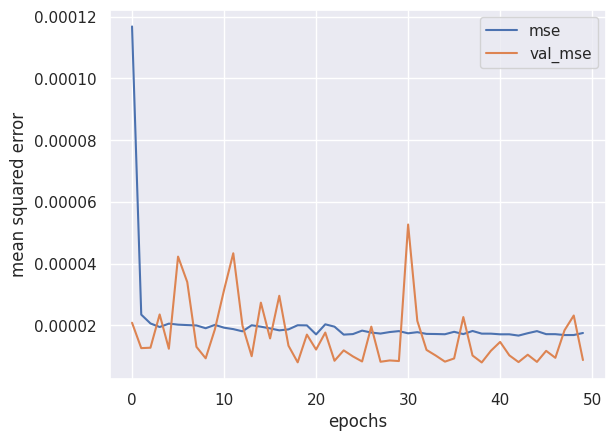

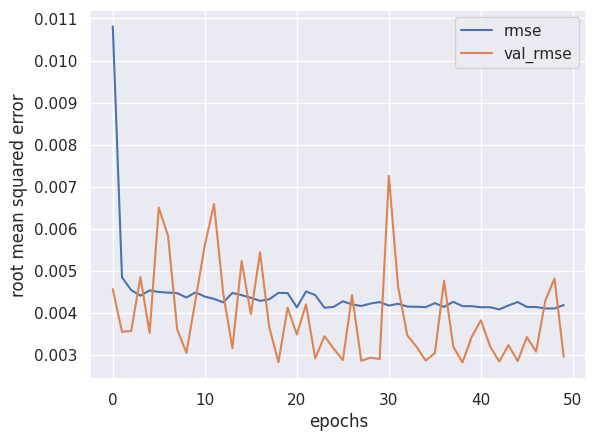

In [862]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

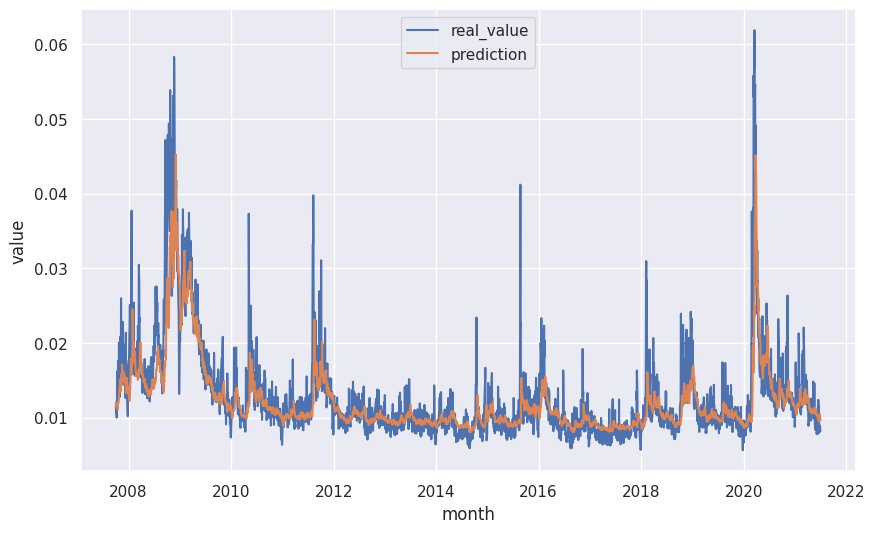

In [863]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

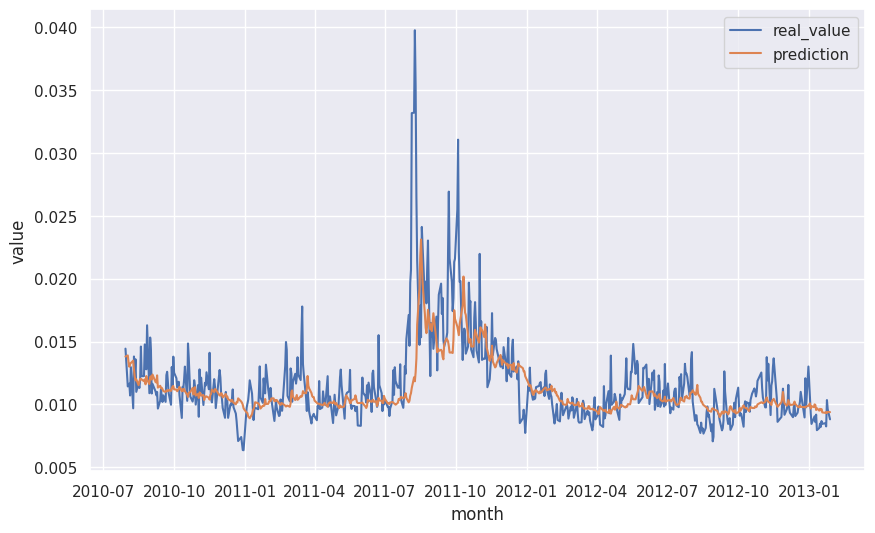

In [864]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [865]:
# variables
fh = 5
fold = 1

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.2,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.0015
}

In [866]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [867]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,969 (46.75 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

In [868]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 16:39:29.720237: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1673537223875731592
2024-12-10 16:39:29.720307: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7427147343526948060
2024-12-10 16:39:33.500019: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1214740784490658851
2024-12-10 16:39:33.500078: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5382299082465053781
2024-12-10 16:39:33.500087: I tensorflow/core/framework/local_rendezvous.cc:423] Local re

In [869]:
# evaluate model
model.evaluate(example_test_ds)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 12.1207 - mean_squared_error: 3.0085e-06 - root_mean_squared_error: 0.0017


[12.369623184204102, 3.0583203169953777e-06, 0.0017488053999841213]

In [870]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step


In [871]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step


In [872]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [873]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,653 (139.27 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 23,684 (92.52 KB)

##### Test Evaluate Model (50% 80:20)

In [874]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

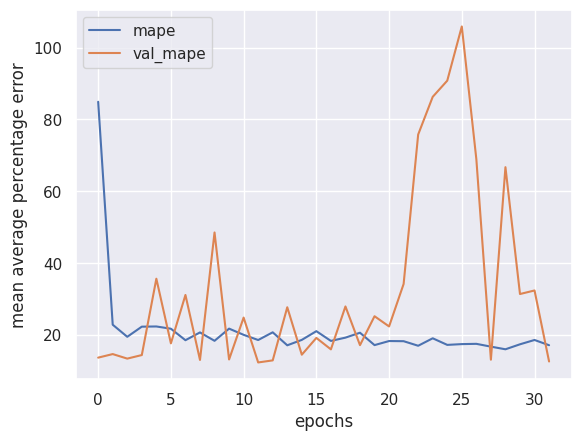

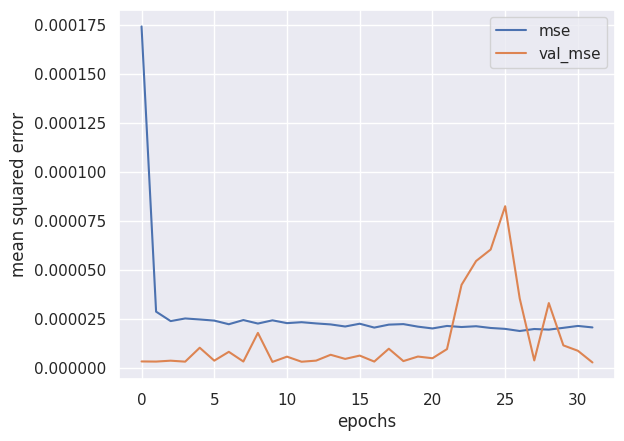

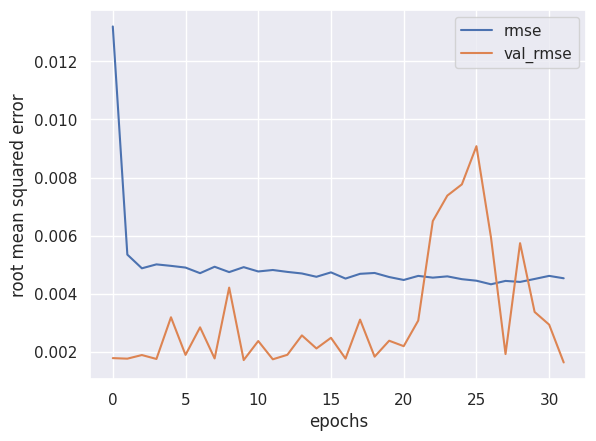

In [875]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

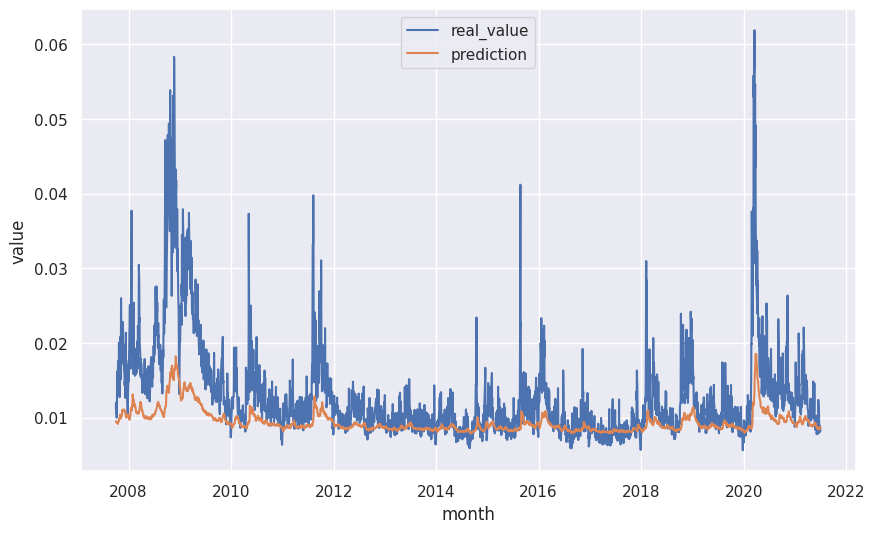

In [876]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

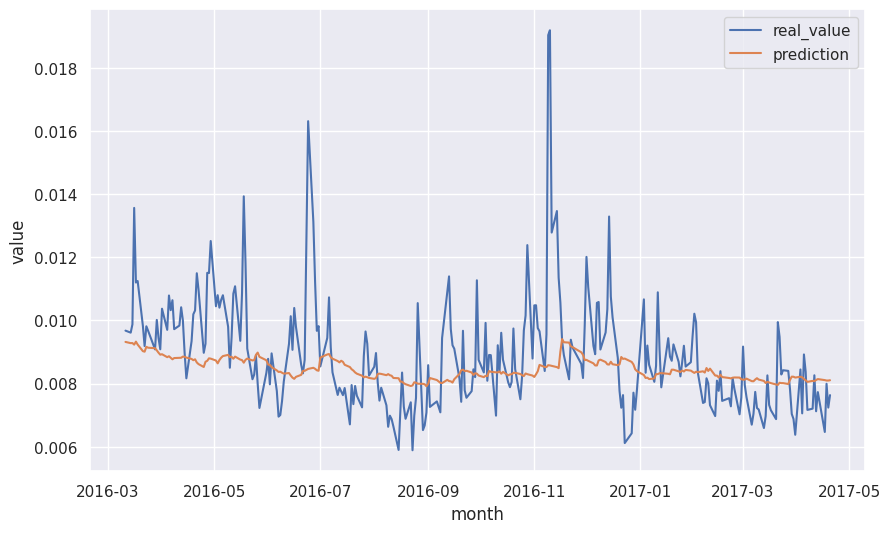

In [877]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Fold 2

##### Test Train & Predict Model

In [878]:
# variables
fh = 5
fold = 2

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.2,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.0015
}

In [879]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [880]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,969 (46.75 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

In [881]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 16:40:16.619727: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5247513190025600193
2024-12-10 16:40:16.619792: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1673537223875731592
2024-12-10 16:40:16.619800: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7427147343526948060
2024-12-10 16:40:20.013385: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1673537223875731592
2024-12-10 16:40:24.480873: I tensorflow/core/framework/local_rendezvous.cc:423] Local re

In [882]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 12.6732 - mean_squared_error: 5.4678e-06 - root_mean_squared_error: 0.0023


2024-12-10 16:42:24.763995: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5247513190025600193
2024-12-10 16:42:24.764062: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1673537223875731592
2024-12-10 16:42:24.764074: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7427147343526948060


[12.988640785217285, 5.943686574028106e-06, 0.002437967574223876]

In [883]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


In [884]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step


In [885]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [886]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,653 (139.27 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 23,684 (92.52 KB)

##### Test Evaluate Model

In [887]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

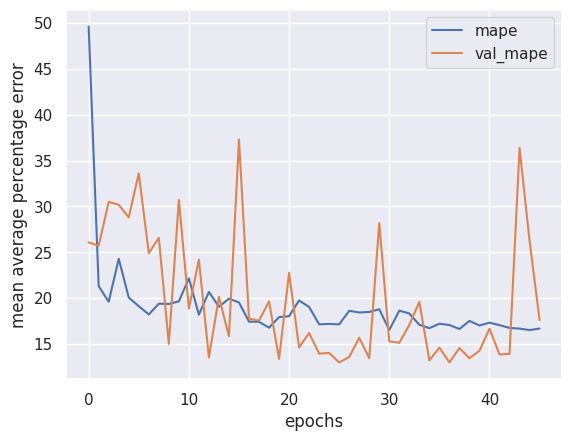

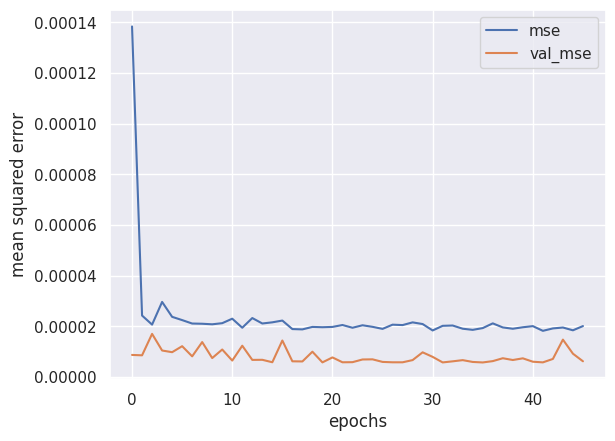

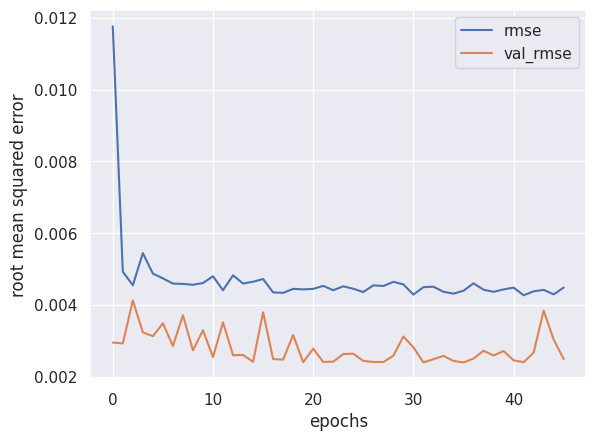

In [888]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

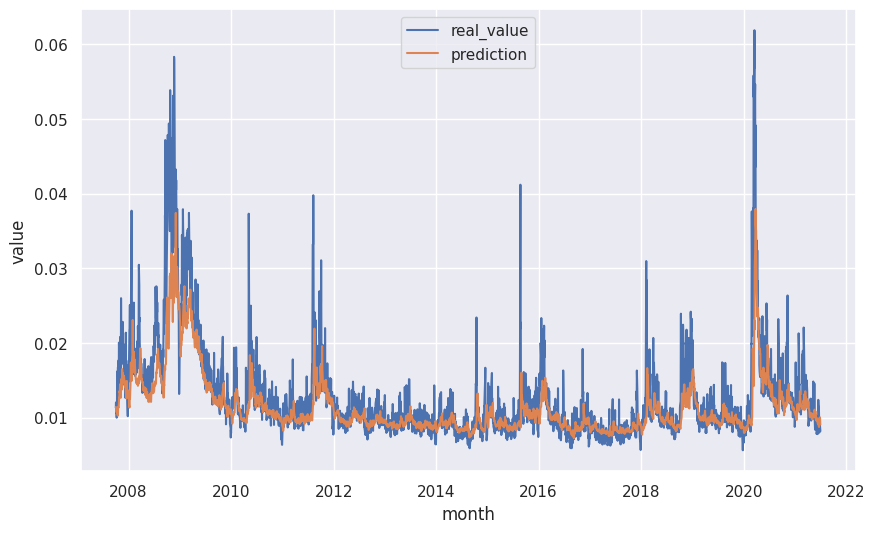

In [889]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

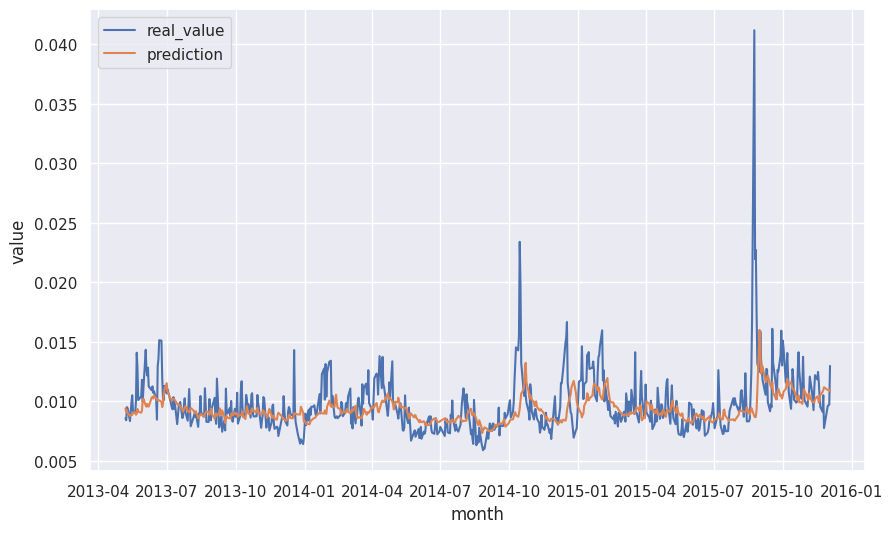

In [890]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (60:40)

In [891]:
# variables
fh = 5
fold = 2

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.2,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.0015
}

In [892]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [893]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,969 (46.75 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

In [894]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 16:42:33.354851: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5247513190025600193
2024-12-10 16:42:33.354940: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1673537223875731592
2024-12-10 16:42:33.354961: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7427147343526948060
2024-12-10 16:42:35.407731: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1214740784490658851
2024-12-10 16:42:35.407811: I tensorflow/core/framework/local_rendezvous.cc:423] Local re

In [895]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 13.2484 - mean_squared_error: 5.0986e-06 - root_mean_squared_error: 0.0022


2024-12-10 16:44:26.869950: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5247513190025600193
2024-12-10 16:44:26.870025: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1673537223875731592
2024-12-10 16:44:26.870034: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7427147343526948060


[12.974831581115723, 6.0717520682374015e-06, 0.002464092569425702]

In [896]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


In [897]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


In [898]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv', index=False)

In [899]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,653 (139.27 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 23,684 (92.52 KB)

##### Test Evaluate Model (60:40)

In [900]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv')

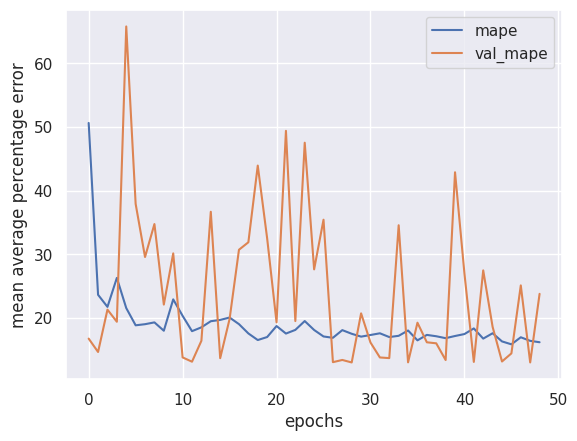

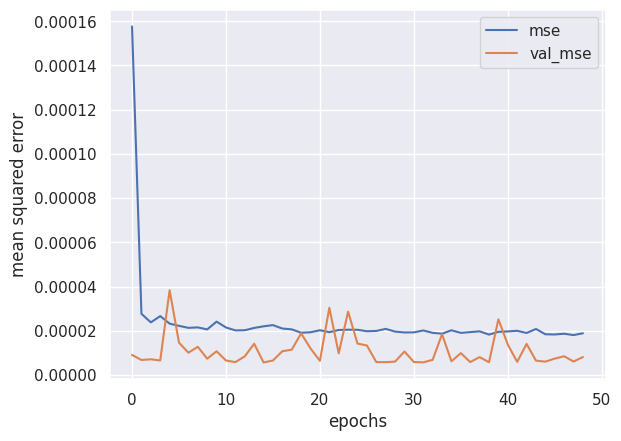

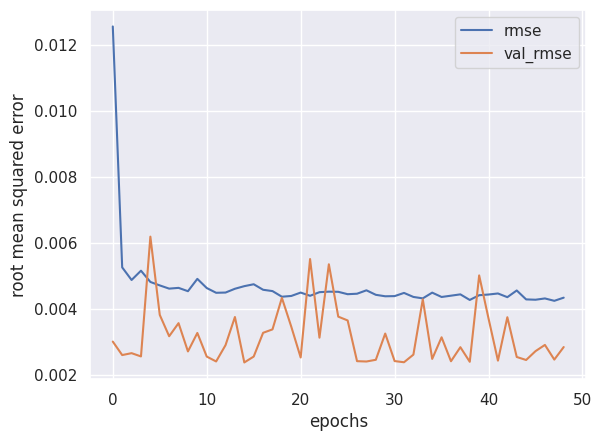

In [901]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

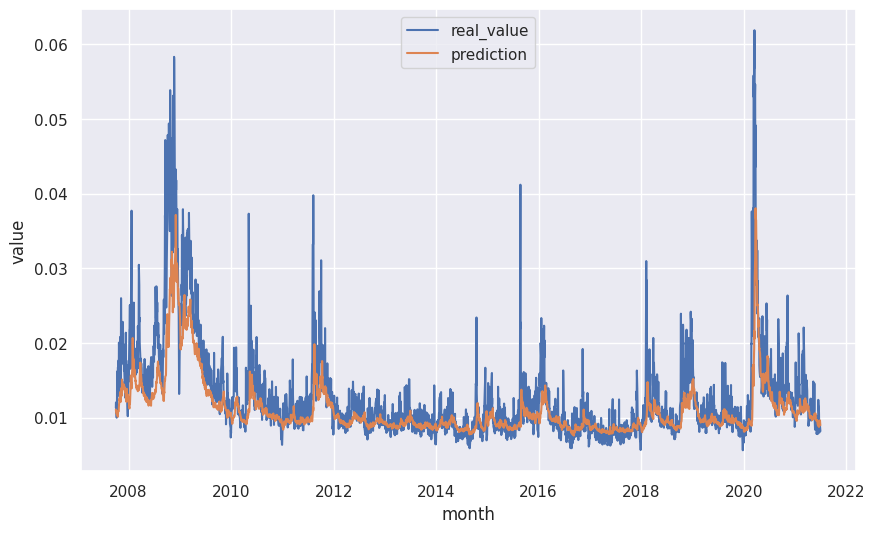

In [902]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

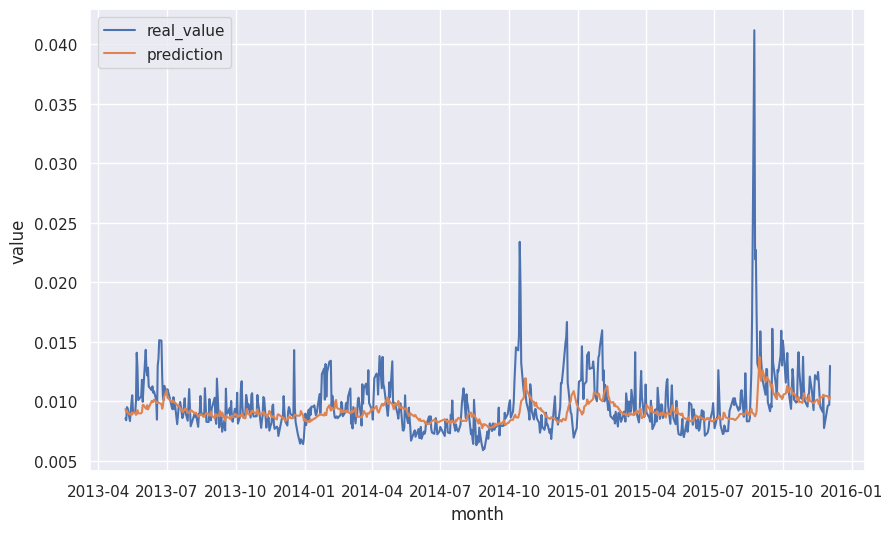

In [903]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [904]:
# variables
fh = 5
fold = 2

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.2,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.0015
}

In [905]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [906]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,969 (46.75 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

In [907]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 16:44:36.051781: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5247513190025600193
2024-12-10 16:44:36.051838: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1673537223875731592
2024-12-10 16:44:36.051846: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7427147343526948060
2024-12-10 16:44:37.434004: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5247513190025600193
2024-12-10 16:44:37.434065: I tensorflow/core/framework/local_rendezvous.cc:423] Local re

In [908]:
# evaluate model
model.evaluate(example_test_ds)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 13.7123 - mean_squared_error: 8.8134e-06 - root_mean_squared_error: 0.0030


2024-12-10 16:46:44.506202: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5247513190025600193
2024-12-10 16:46:44.506257: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1673537223875731592
2024-12-10 16:46:44.506264: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7427147343526948060


[13.324149131774902, 8.482226803607773e-06, 0.002912426134571433]

In [909]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


In [910]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


In [911]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [912]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,653 (139.27 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 23,684 (92.52 KB)

##### Test Evaluate Model (50% 80:20)

In [913]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

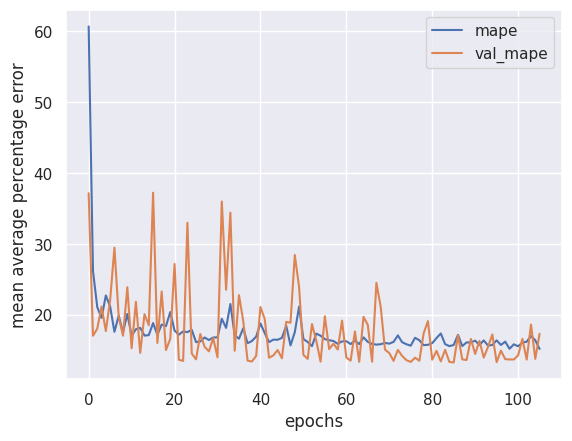

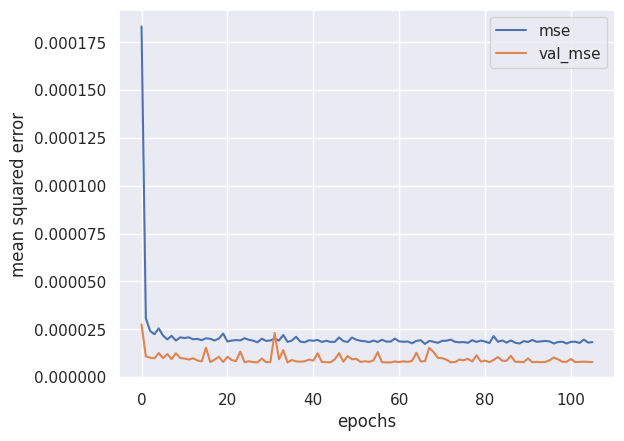

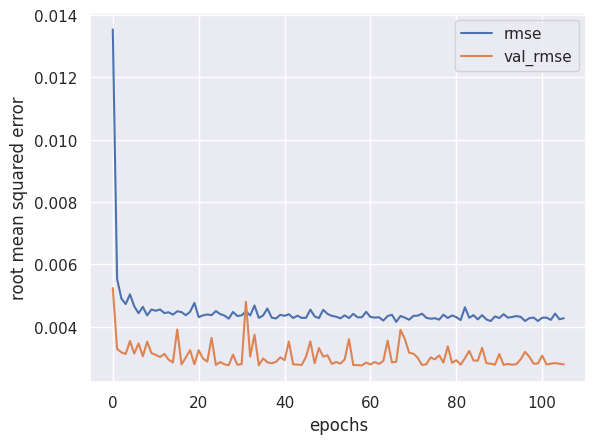

In [914]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

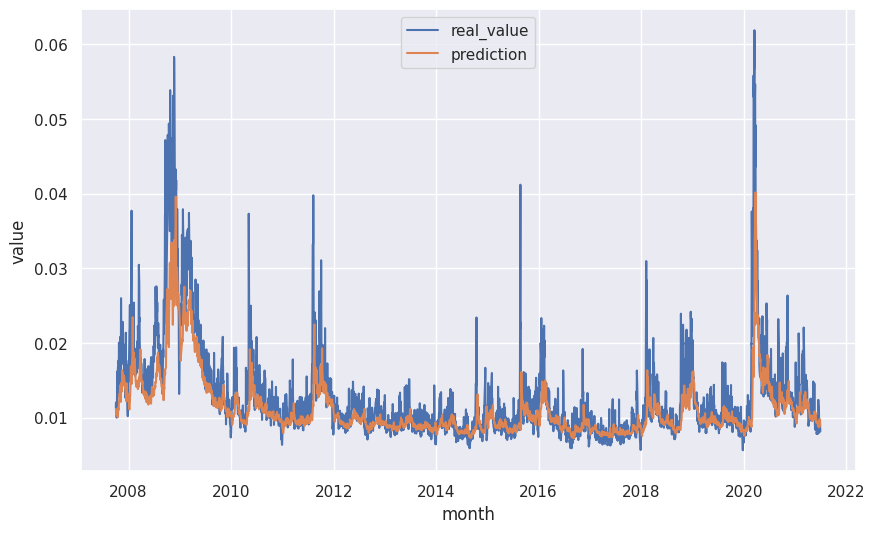

In [915]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

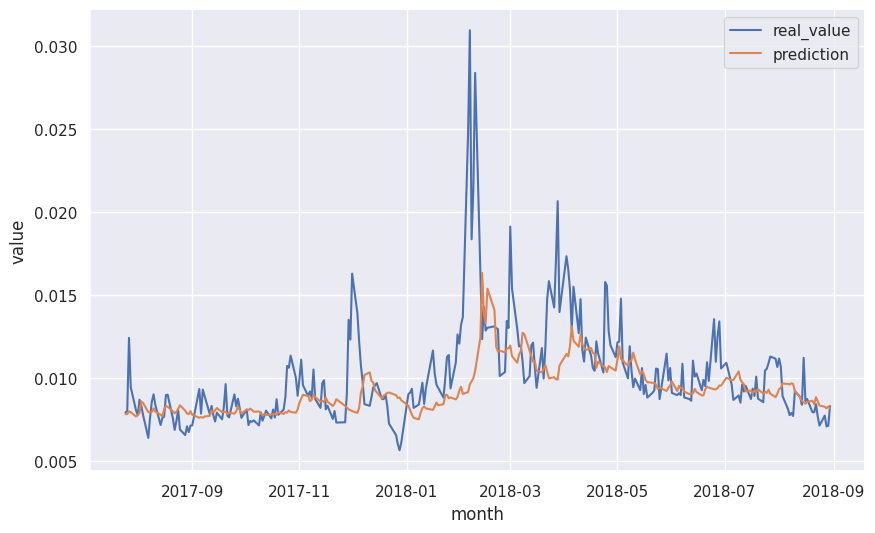

In [916]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Fold 3

##### Test Train & Predict Model

In [917]:
# variables
fh = 5
fold = 3

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.2,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.0015
}

In [918]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [919]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,969 (46.75 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

In [920]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 16:46:51.852471: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1214740784490658851
2024-12-10 16:46:51.852536: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5382299082465053781
2024-12-10 16:46:51.852546: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 9372518003920509882
2024-12-10 16:46:51.852550: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10527289713454608084
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 16:46:52.454391: I tensorflow/core/framework/local_rendezvous.cc:423] Local r

In [921]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 11.8519 - mean_squared_error: 5.1953e-06 - root_mean_squared_error: 0.0023


2024-12-10 16:49:11.478540: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5247513190025600193
2024-12-10 16:49:11.478592: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1673537223875731592
2024-12-10 16:49:11.478599: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7427147343526948060


[12.402405738830566, 5.469255029311171e-06, 0.0023386438842862844]

In [922]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step


In [923]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


In [924]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [925]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,653 (139.27 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 23,684 (92.52 KB)

##### Test Evaluate Model

In [926]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

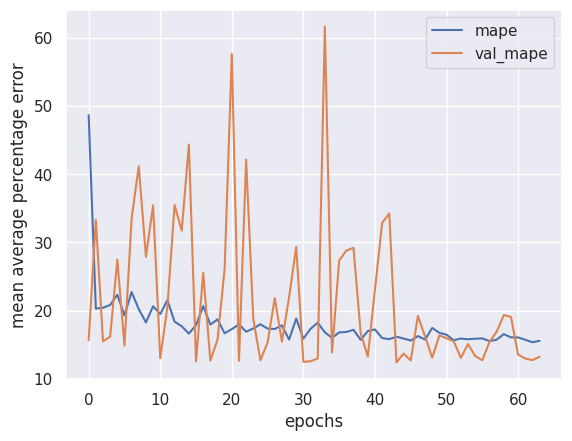

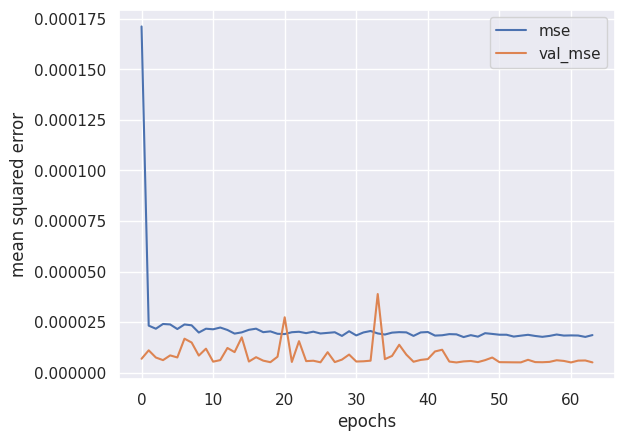

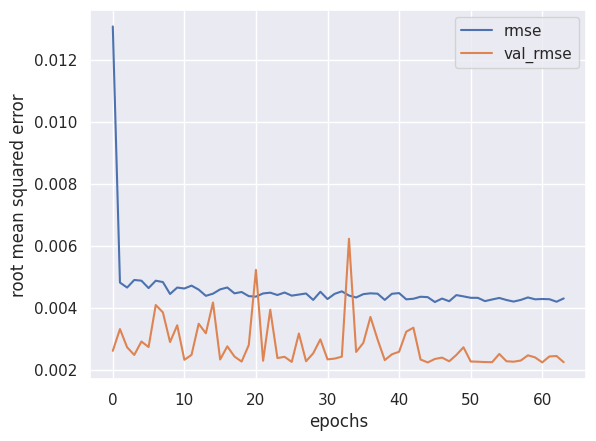

In [927]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

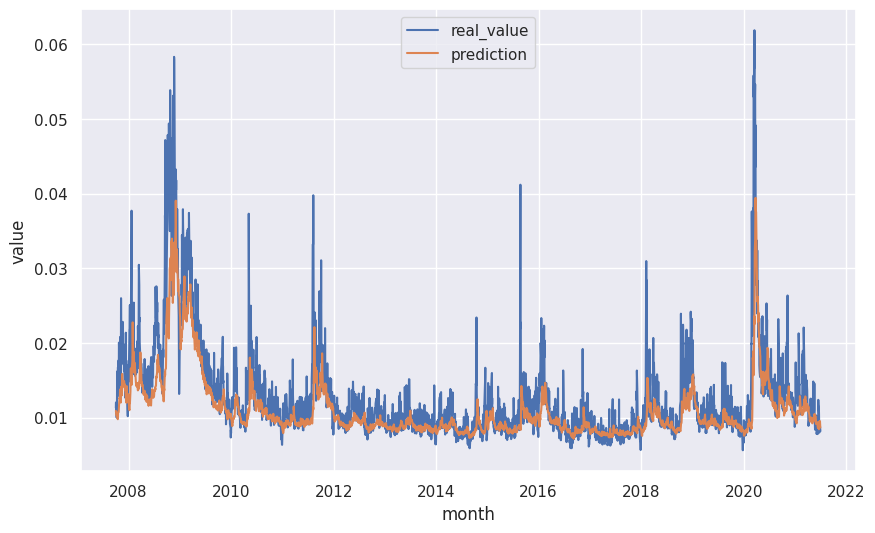

In [928]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

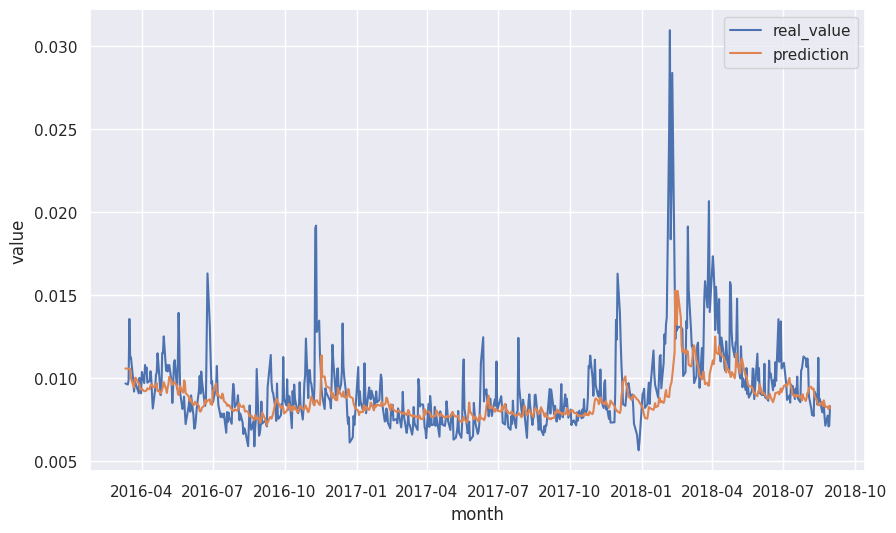

In [929]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (60:40)

In [930]:
# variables
fh = 5
fold = 3

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.2,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.0015
}

In [931]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [932]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,969 (46.75 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

In [933]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 16:49:19.588045: I tensorflow/core/framework/local_rendezvous.cc:427] Local rendezvous send item cancelled. Key hash: 8849585274765046043
2024-12-10 16:49:19.588108: I tensorflow/core/framework/local_rendezvous.cc:427] Local rendezvous send item cancelled. Key hash: 5459258795185654111
2024-12-10 16:49:19.588117: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1214740784490658851
2024-12-10 16:49:19.588121: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5382299082465053781
2024-12-10 16:49:19.588128: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 9372518003920509882
2024-12-10 16:49:19.588130: I tensorflow/core/framework/local_rendezvous.cc:427] Local rendezvous send item cancelled. Key hash: 18359005480107654430
2024-12-10 16:49:19.588134: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv it

In [934]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 12.9333 - mean_squared_error: 5.2603e-06 - root_mean_squared_error: 0.0023


2024-12-10 16:52:19.382862: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7427147343526948060


[12.438608169555664, 5.5282948778767604e-06, 0.002351232571527362]

In [935]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


In [936]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


In [937]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv', index=False)

In [938]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,653 (139.27 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 23,684 (92.52 KB)

##### Test Evaluate Model (60:40)

In [939]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv')

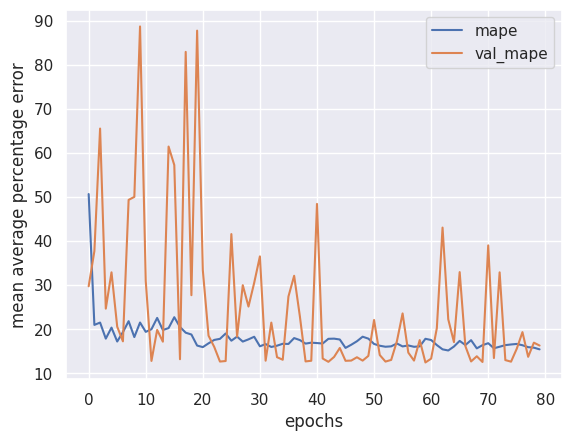

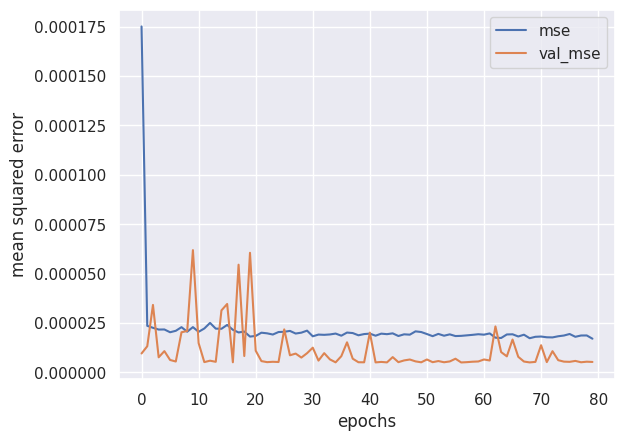

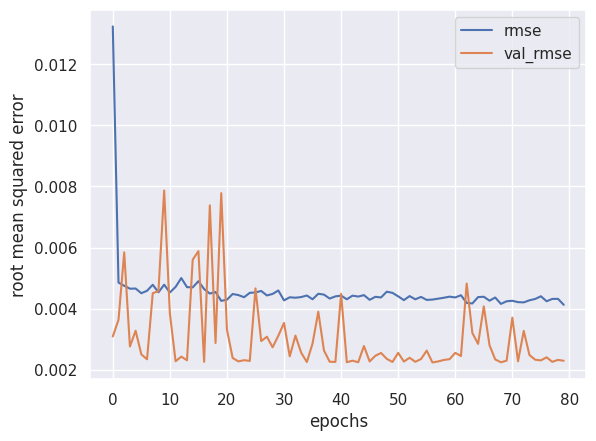

In [940]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

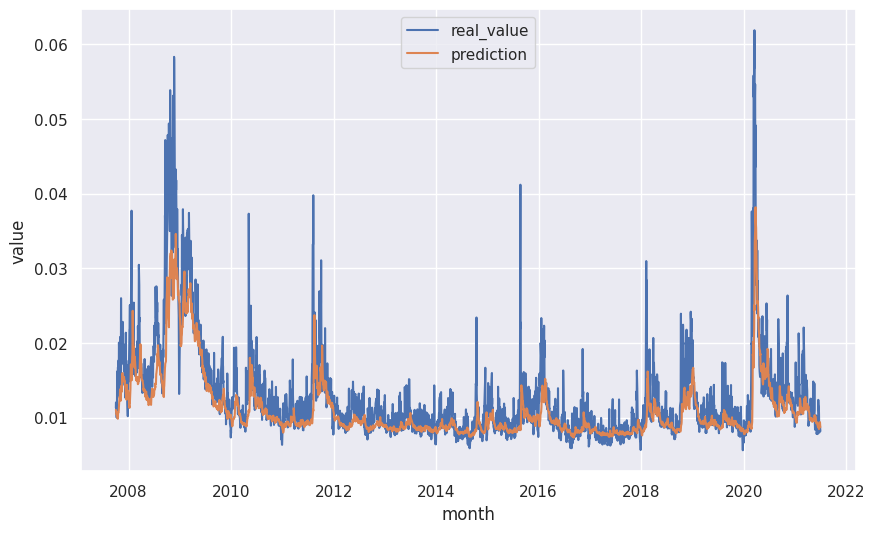

In [941]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

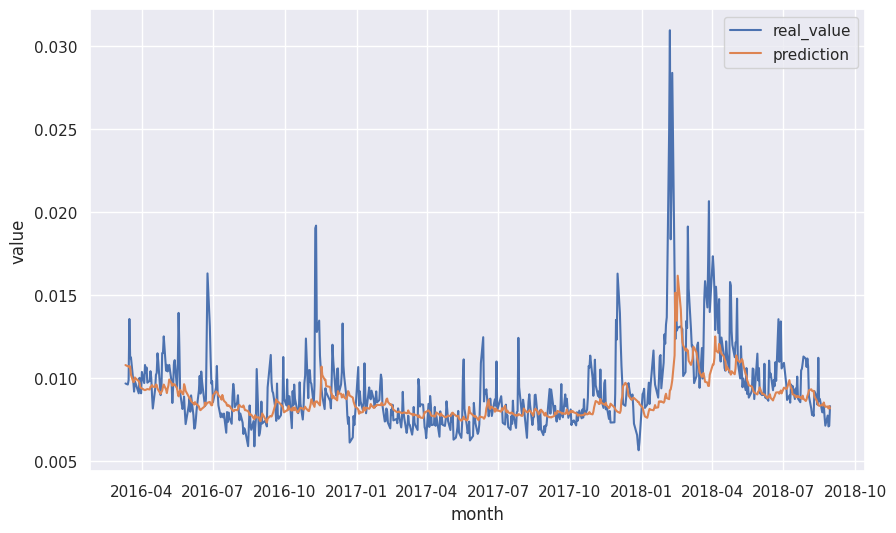

In [942]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [943]:
# variables
fh = 5
fold = 3

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.2,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.0015
}

In [944]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [945]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,969 (46.75 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

In [946]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 16:52:26.180892: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5247513190025600193
2024-12-10 16:52:26.180944: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1673537223875731592
2024-12-10 16:52:26.180951: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7427147343526948060
2024-12-10 16:52:27.378832: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5247513190025600193
2024-12-10 16:52:27.378884: I tensorflow/core/framework/local_rendezvous.cc:423] Local re

In [947]:
# evaluate model
model.evaluate(example_test_ds)

      8/Unknown 0s 8ms/step - loss: 12.7070 - mean_squared_error: 6.3464e-06 - root_mean_squared_error: 0.0025 

2024-12-10 16:53:41.892094: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5247513190025600193
2024-12-10 16:53:41.892143: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1673537223875731592
2024-12-10 16:53:41.892150: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7427147343526948060


9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 12.7258 - mean_squared_error: 6.3874e-06 - root_mean_squared_error: 0.0025


[12.800965309143066, 6.551521892106393e-06, 0.0025595941115170717]

In [948]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


In [949]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


In [950]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [951]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,653 (139.27 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 23,684 (92.52 KB)

##### Test Evaluate Model (50% 80:20)

In [952]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

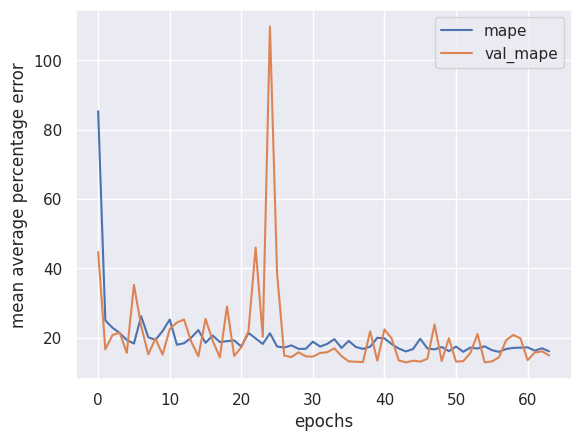

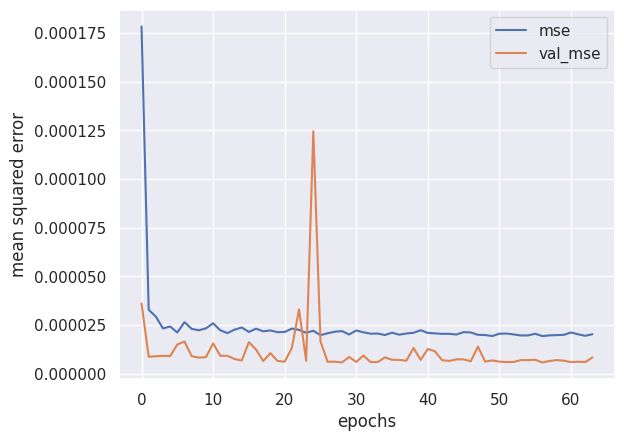

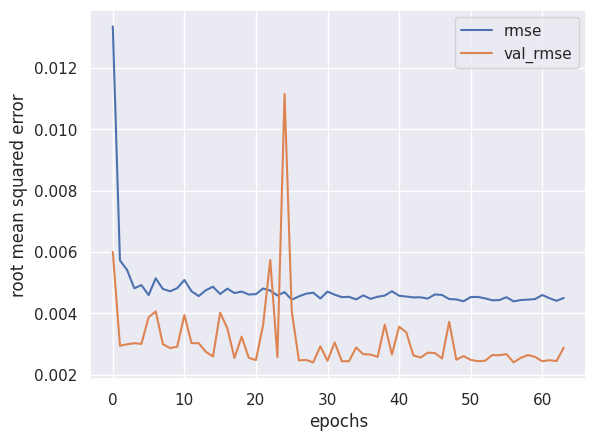

In [953]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

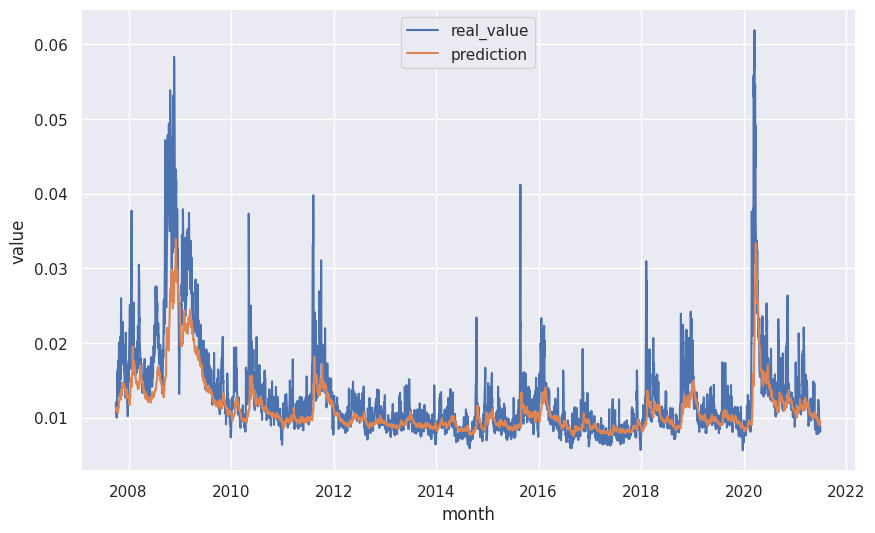

In [954]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

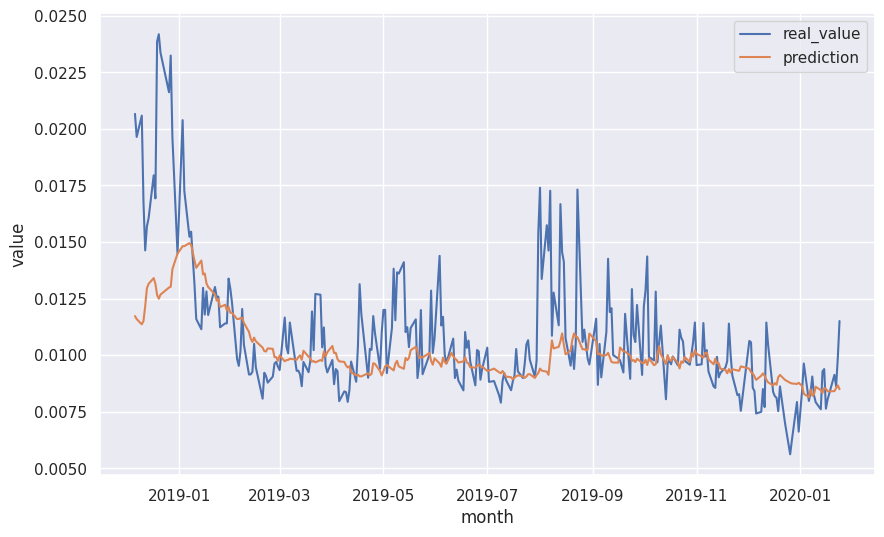

In [955]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Fold 4

##### Test Train & Predict Model

In [956]:
# variables
fh = 5
fold = 4

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.2,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.0015
}

In [957]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [958]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,969 (46.75 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

In [959]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

W0000 00:00:1733846029.169627    3531 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846029.176300    3531 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846029.182393    3531 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846029.188490    3531 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846029.194472    3531 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846029.200498    3531 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846029.206496    3531 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846029.212446    3531 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846029.218293    3531 gp

In [960]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 15.4402 - mean_squared_error: 3.7811e-05 - root_mean_squared_error: 0.0060


2024-12-10 16:54:58.706595: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5247513190025600193
2024-12-10 16:54:58.706647: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1673537223875731592
2024-12-10 16:54:58.706655: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7427147343526948060


[15.878397941589355, 3.290459426352754e-05, 0.005736252758651972]

In [961]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


In [962]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


In [963]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [964]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,653 (139.27 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 23,684 (92.52 KB)

##### Test Evaluate Model

In [965]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

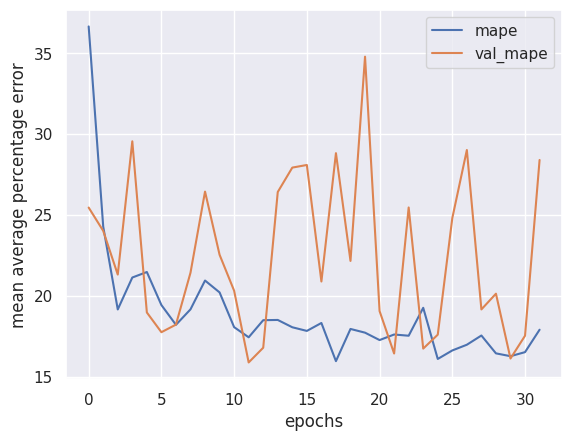

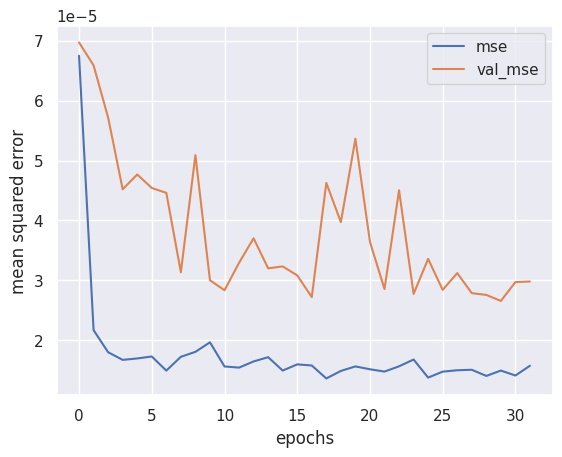

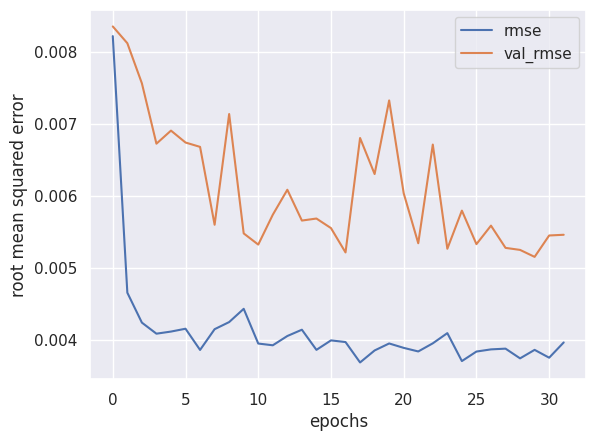

In [966]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

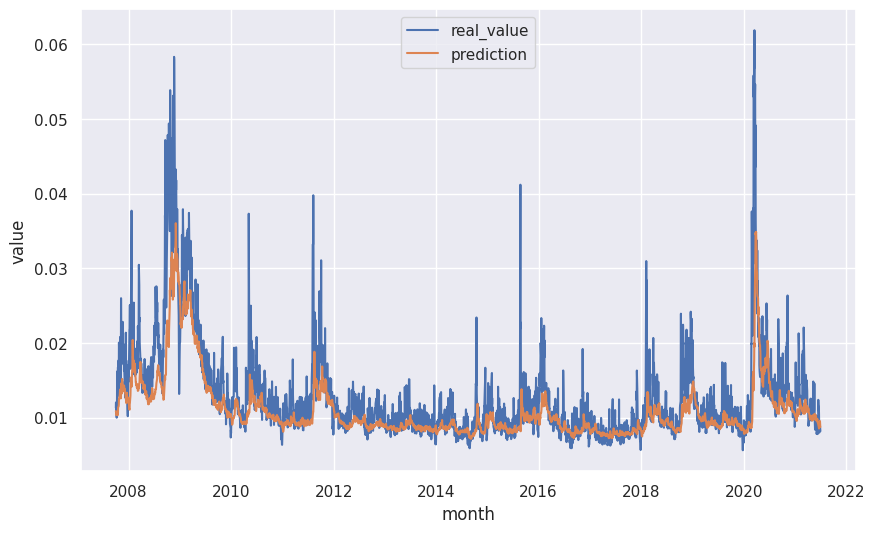

In [967]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

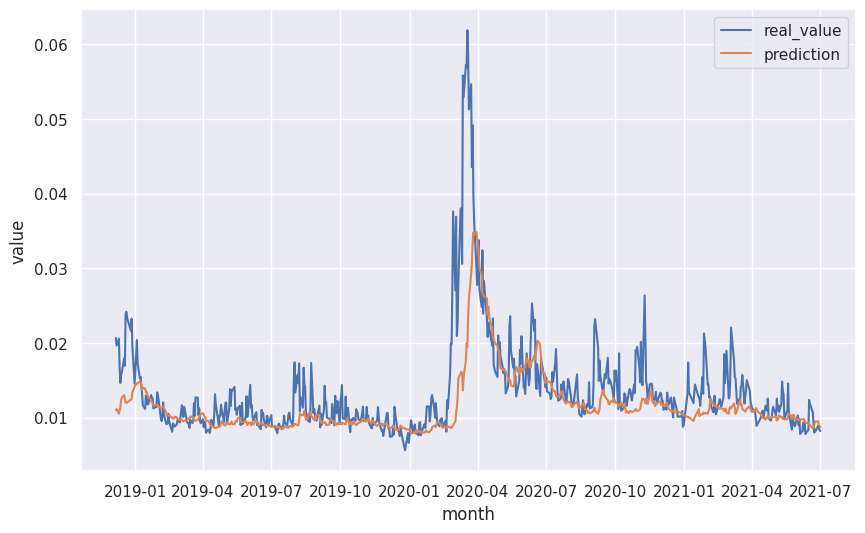

In [968]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [969]:
# variables
fh = 5
fold = 4

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.2,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.0015
}

In [970]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [971]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,969 (46.75 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

In [972]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

W0000 00:00:1733846105.570883    3537 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846105.577907    3537 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846105.584217    3537 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846105.590660    3537 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846105.597051    3537 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846105.603333    3537 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846105.609678    3537 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846105.615938    3537 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846105.622345    3537 gp

In [973]:
# evaluate model
model.evaluate(example_test_ds)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 15.4326 - mean_squared_error: 1.1102e-05 - root_mean_squared_error: 0.0033


2024-12-10 16:55:56.843637: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5247513190025600193
2024-12-10 16:55:56.843717: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1673537223875731592
2024-12-10 16:55:56.843730: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7427147343526948060


[14.058675765991211, 9.351368134957738e-06, 0.003058000700548291]

In [974]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


In [975]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


In [976]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [977]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        10,368 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 32)             │         1,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 35,653 (139.27 KB)

 Trainable params: 11,841 (46.25 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 23,684 (92.52 KB)

##### Test Evaluate Model (50% 80:20)

In [978]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

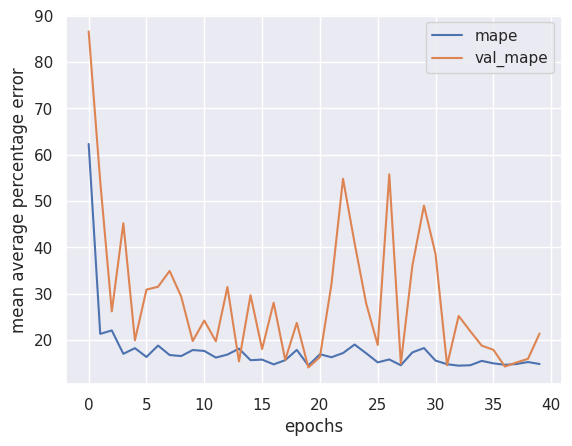

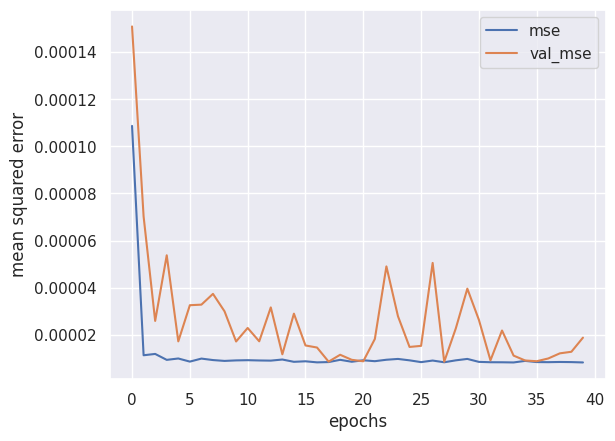

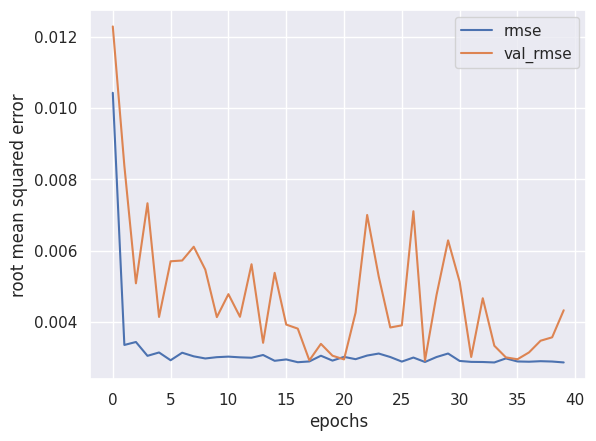

In [979]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

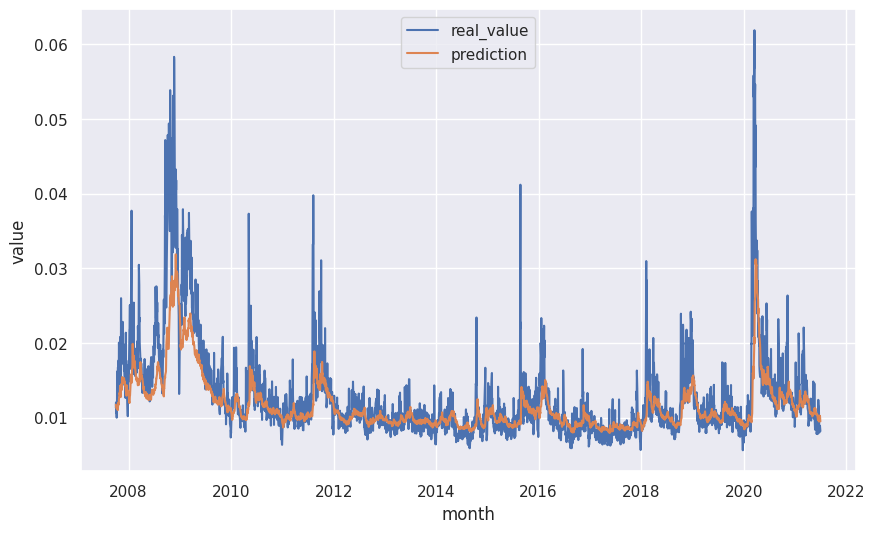

In [980]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

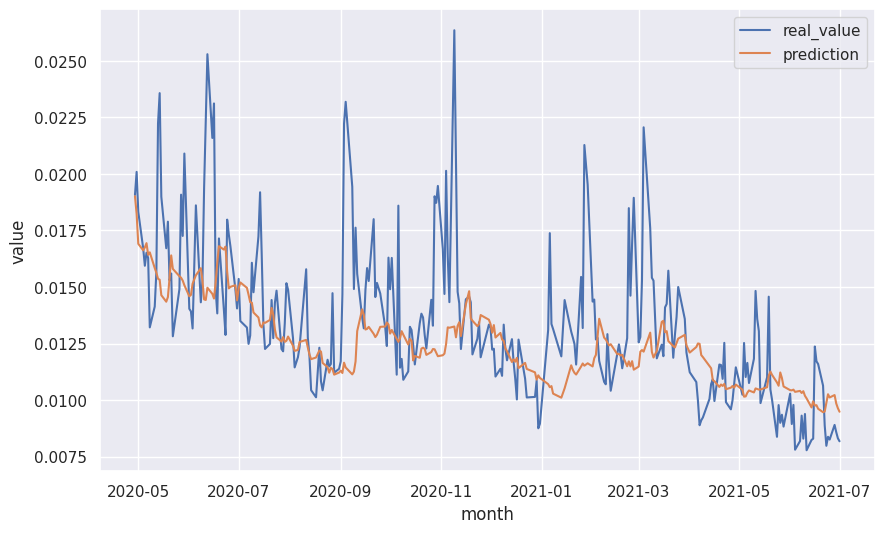

In [981]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Summary

In [982]:
# variables
fh = 5

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 16,
    'lstm_1_nodes': 0,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 0,
    'perceptron_2_nodes': 0,
    'dropout_rate_0': 0.2,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.0015
}

60:40

In [983]:
# load model in keras format
cnnbilstm_models = [tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras') for fold in range(4)]

# load test dataset
example_test_dss = []
for fold in range(4):
    example_test_dss.append(create_window_dataset(
        series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/test_{fold}.npy'), axis=-1),
        window_size=example_hps['window_size'],
        forecast_horizon=fh,
        batch_size=batch_size,
        shuffle_buffer=shuffle_buffer,
    ))

In [984]:
# evaluate model
evaluation_results = np.array([cnnbilstm_models[fold].evaluate(example_test_dss[fold]) for fold in range(4)])

41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - loss: 15.2131 - mean_squared_error: 2.0345e-05 - root_mean_squared_error: 0.0045


/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - loss: 12.5990 - mean_squared_error: 6.3789e-06 - root_mean_squared_error: 0.0025
41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - loss: 13.1813 - mean_squared_error: 5.7137e-06 - root_mean_squared_error: 0.0024
     37/Unknown 1s 12ms/step - loss: 14.5304 - mean_squared_error: 2.4886e-05 - root_mean_squared_error: 0.0049

W0000 00:00:1733846168.139570    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846168.152738    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846168.165738    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846168.178073    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846168.190144    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846168.202378    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846168.214312    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846168.226347    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846168.237638    3538 gp

41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 14.5014 - mean_squared_error: 2.3926e-05 - root_mean_squared_error: 0.0048


W0000 00:00:1733846168.347722    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846168.354707    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846168.361699    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846168.368741    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846168.375618    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846168.382663    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846168.389435    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846168.396613    3538 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced


In [985]:
evaluation_results

array([[1.51813269e+01, 1.99170754e-05, 4.46285494e-03],
       [1.30587015e+01, 6.79501818e-06, 2.60672555e-03],
       [1.33828106e+01, 6.34546950e-06, 2.51902151e-03],
       [1.42545395e+01, 1.66807022e-05, 4.08420153e-03]])

In [986]:
np.mean(evaluation_results, axis=0)

array([1.39693446e+01, 1.24345663e-05, 3.41820088e-03])

50% 80:20

In [987]:
# load model in keras format
cnnbilstm_models = [tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras') for fold in range(5)]

# load test dataset
example_test_dss = []
for fold in range(5):
    example_test_dss.append(create_window_dataset(
        series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
        window_size=example_hps['window_size'],
        forecast_horizon=fh,
        batch_size=batch_size,
        shuffle_buffer=shuffle_buffer,
    ))

In [988]:
# evaluate model
evaluation_results = np.array([cnnbilstm_models[fold].evaluate(example_test_dss[fold]) for fold in range(5)])

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 16.1943 - mean_squared_error: 1.4875e-05 - root_mean_squared_error: 0.0038
9/9 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - loss: 13.1798 - mean_squared_error: 3.8559e-06 - root_mean_squared_error: 0.0019


2024-12-10 16:56:10.615090: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5247513190025600193
2024-12-10 16:56:10.615156: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1673537223875731592
2024-12-10 16:56:10.615164: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7427147343526948060


9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 13.9737 - mean_squared_error: 8.6817e-06 - root_mean_squared_error: 0.0029


2024-12-10 16:56:11.085244: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5247513190025600193
2024-12-10 16:56:11.085307: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 1673537223875731592
2024-12-10 16:56:11.085315: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 7427147343526948060


9/9 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 12.1349 - mean_squared_error: 4.6423e-06 - root_mean_squared_error: 0.0021
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 14.1456 - mean_squared_error: 9.6910e-06 - root_mean_squared_error: 0.0031


In [989]:
evaluation_results

array([[1.56389103e+01, 1.21799612e-05, 3.48998001e-03],
       [1.23696232e+01, 3.05832054e-06, 1.74880540e-03],
       [1.33241501e+01, 8.48222680e-06, 2.91242613e-03],
       [1.28009663e+01, 6.55152144e-06, 2.55959411e-03],
       [1.40586767e+01, 9.35136723e-06, 3.05800047e-03]])

In [990]:
np.mean(evaluation_results, axis=0)

array([1.36384653e+01, 7.92467945e-06, 2.75376122e-03])

### FH 10

#### Fold 0

##### Test Train & Predict Model

In [991]:
# variables
fh = 10
fold = 0

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 16,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.001
}

In [992]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [993]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 38,369 (149.88 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

In [994]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

W0000 00:00:1733846179.307996    3533 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846179.310653    3533 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846179.313060    3533 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846179.315457    3533 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846179.318052    3533 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846179.320508    3533 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846179.323011    3533 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846179.325442    3533 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846179.328074    3533 gp

In [995]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 16.4531 - mean_squared_error: 3.8808e-05 - root_mean_squared_error: 0.0062


2024-12-10 16:59:38.757717: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 16:59:38.757783: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 16:59:38.757797: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272


[16.945632934570312, 3.9912236388772726e-05, 0.006317613180726767]

In [996]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step


W0000 00:00:1733846381.338670    3532 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846381.341487    3532 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846381.343891    3532 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846381.346091    3532 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846381.348381    3532 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846381.350590    3532 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846381.352786    3532 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846381.355082    3532 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846381.357172    3532 gp

In [997]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


In [998]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [999]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 114,853 (448.65 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 76,484 (298.77 KB)

##### Test Evaluate Model

In [1000]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

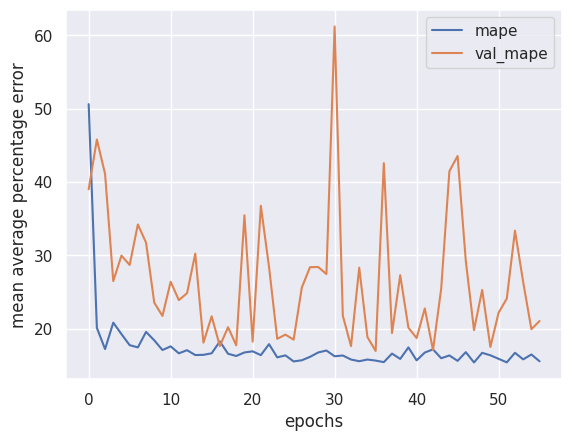

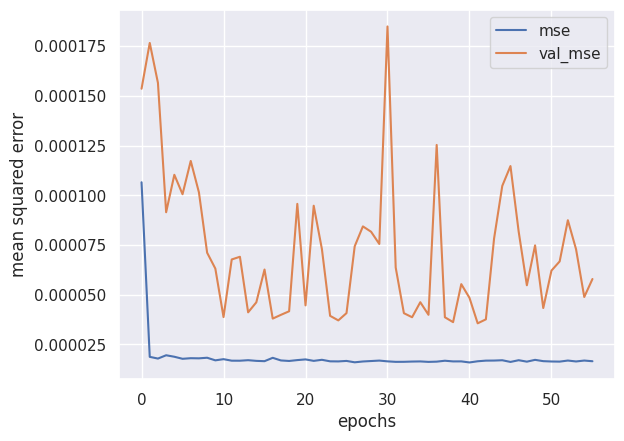

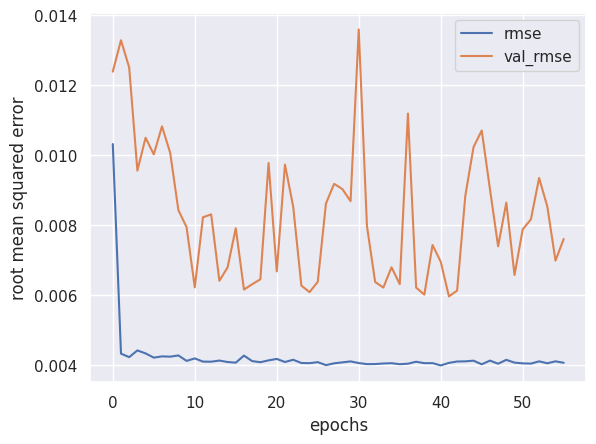

In [1001]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

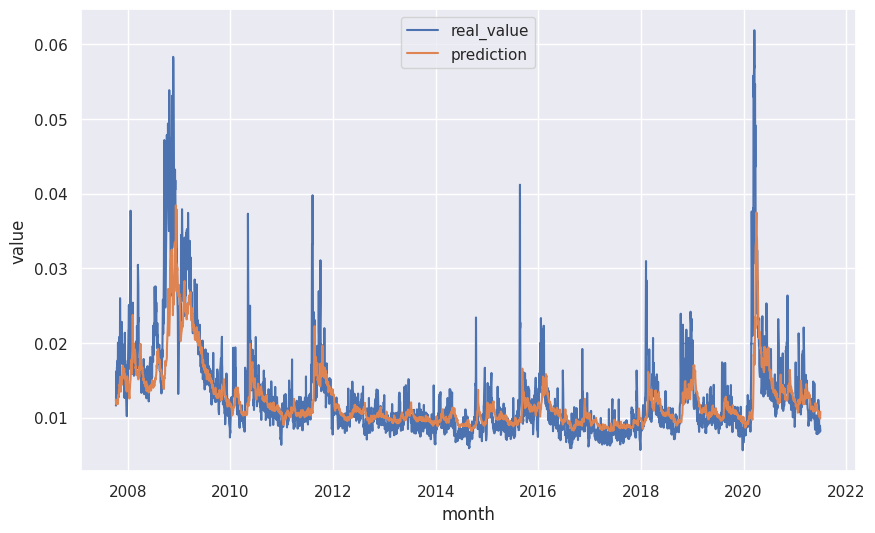

In [1002]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

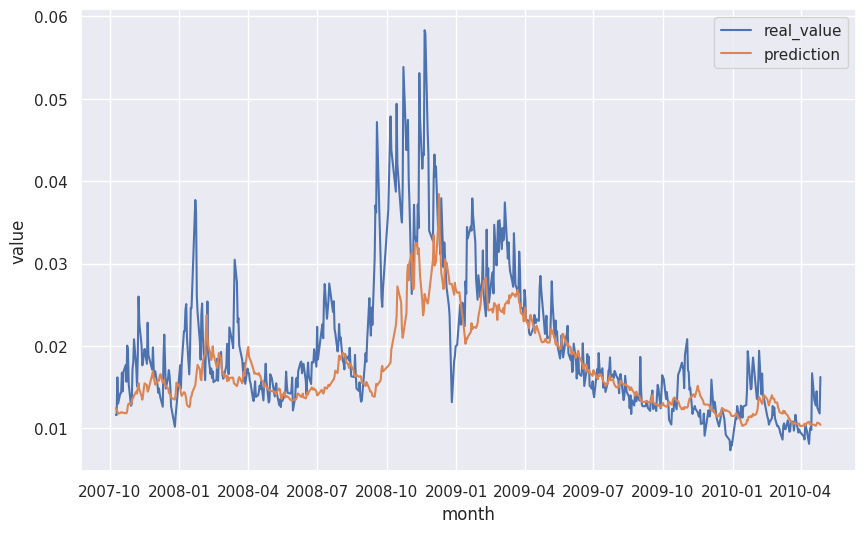

In [1003]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (60:40)

In [1004]:
# variables
fh = 10
fold = 0

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 16,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.001
}

In [1005]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [1006]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 38,369 (149.88 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

In [1007]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 16:59:51.682514: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 16:59:51.682597: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 16:59:55.244040: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 16:59:55.244116: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 16:59:55.244126: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

In [1008]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 17.7048 - mean_squared_error: 4.4540e-05 - root_mean_squared_error: 0.0067


[17.329925537109375, 4.1835348383756354e-05, 0.0064680250361561775]

In [1009]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step


In [1010]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


In [1011]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv', index=False)

In [1012]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 114,853 (448.65 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 76,484 (298.77 KB)

##### Test Evaluate Model (60:40)

In [1013]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv')

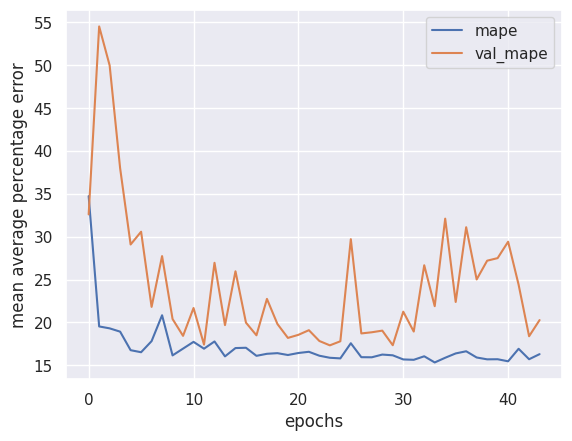

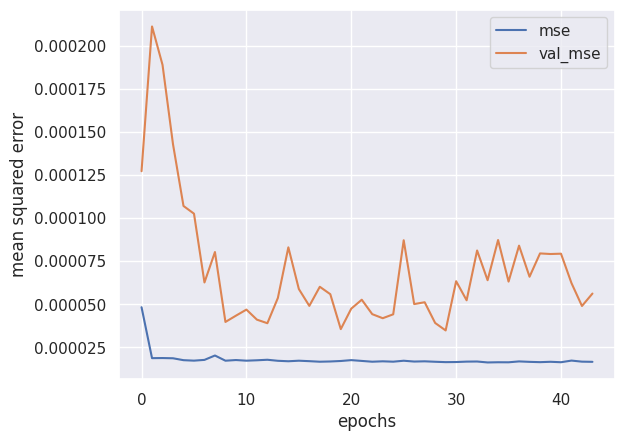

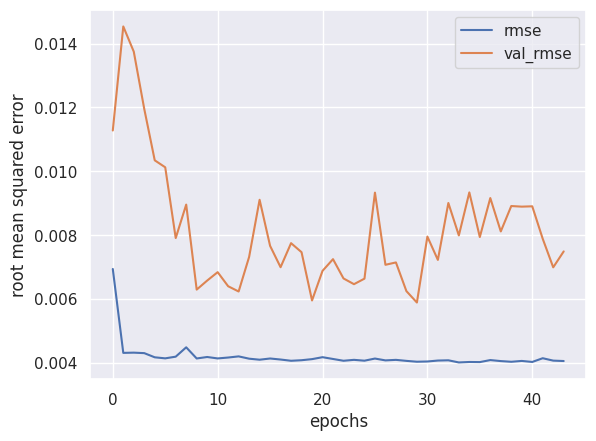

In [1014]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

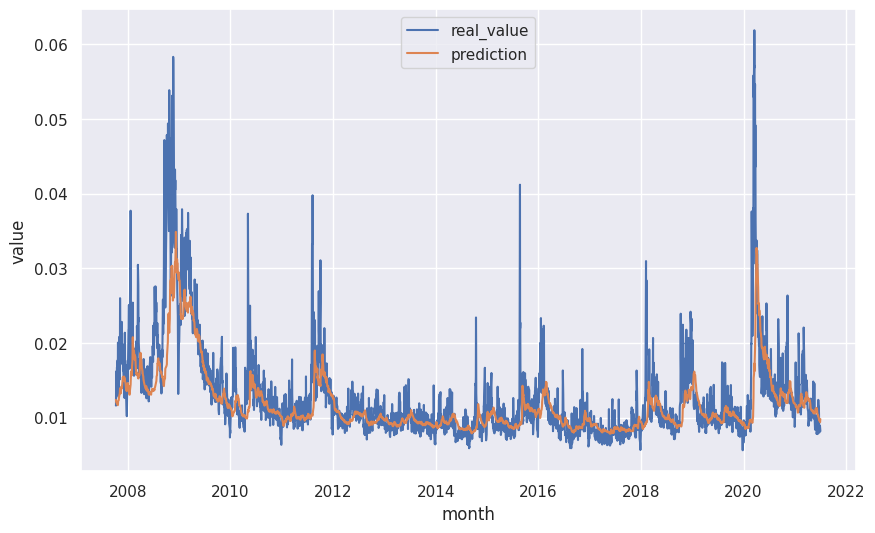

In [1015]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

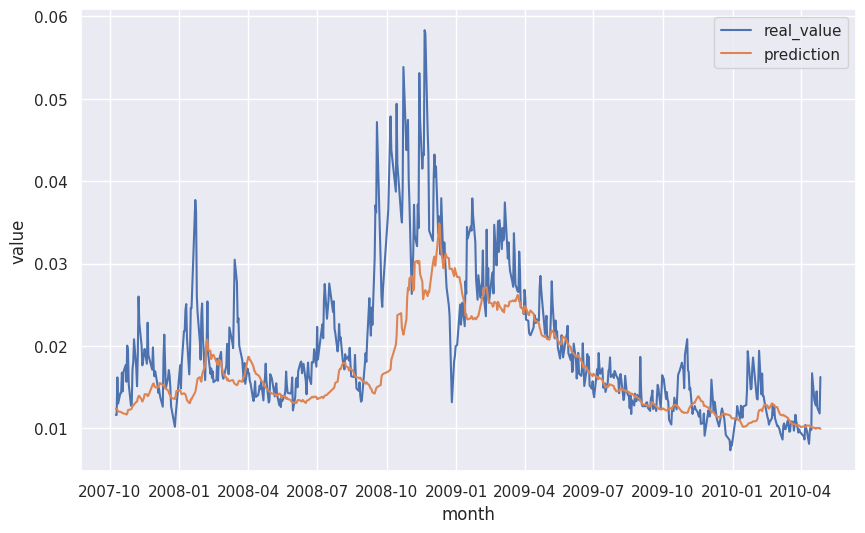

In [1016]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [1017]:
# variables
fh = 10
fold = 0

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 16,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.001
}

In [1018]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [1019]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 38,369 (149.88 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

In [1020]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

W0000 00:00:1733846554.480443    3539 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846554.483019    3539 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846554.485652    3539 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846554.488362    3539 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846554.490685    3539 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846554.493168    3539 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846554.495571    3539 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846554.497882    3539 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733846554.500255    3539 gp

In [1021]:
# evaluate model
model.evaluate(example_test_ds)

      1/Unknown 0s 85ms/step - loss: 13.8372 - mean_squared_error: 2.5732e-06 - root_mean_squared_error: 0.0016

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 14.5817 - mean_squared_error: 7.1127e-06 - root_mean_squared_error: 0.0026


2024-12-10 17:04:06.860350: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:04:06.860415: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:04:06.860427: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272


[15.184615135192871, 1.0443071005283855e-05, 0.003231574082747102]

In [1022]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


In [1023]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step


In [1024]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [1025]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 114,853 (448.65 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 76,484 (298.77 KB)

##### Test Evaluate Model (50% 80:20)

In [1026]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

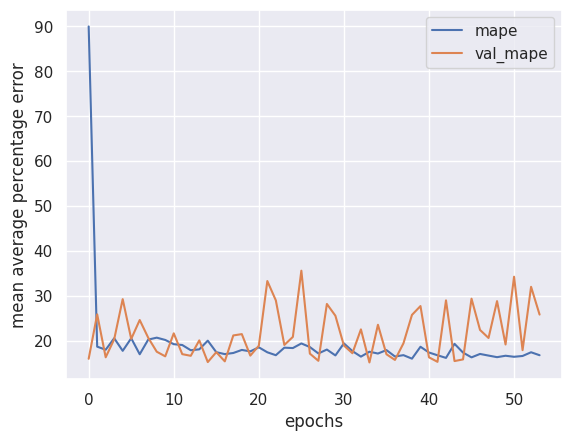

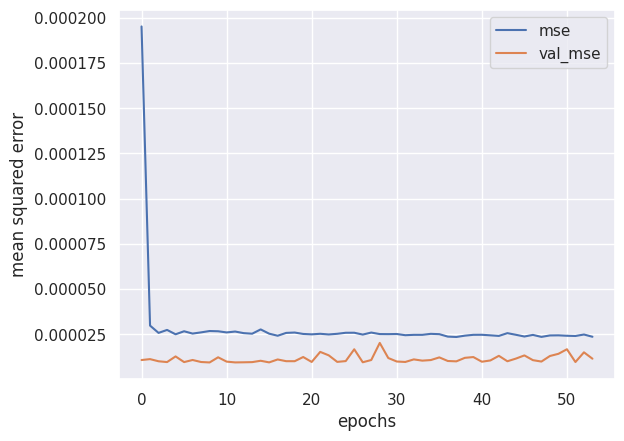

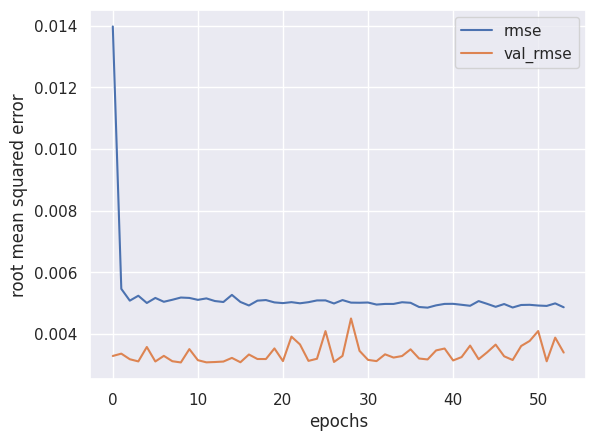

In [1027]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

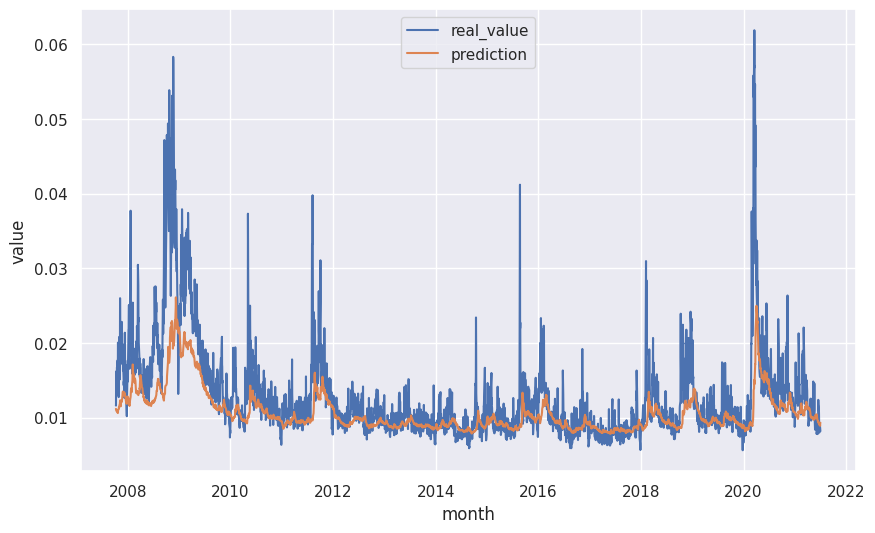

In [1028]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

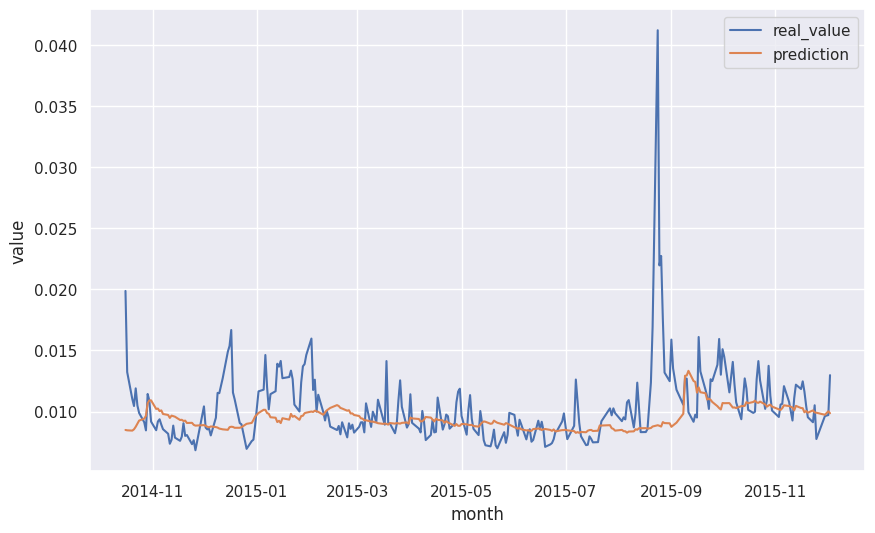

In [1029]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Fold 1

##### Test Train & Predict Model

In [1030]:
# variables
fh = 10
fold = 1

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 16,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.001
}

In [1031]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [1032]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 38,369 (149.88 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

In [1033]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 17:04:16.463798: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12792663592633999557
2024-12-10 17:04:16.463856: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6556615866311137287
2024-12-10 17:04:16.463865: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 16930505664870644233
2024-12-10 17:04:16.463872: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5940596807159114618
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 17:04:17.158273: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

In [1034]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 12.2584 - mean_squared_error: 8.9938e-06 - root_mean_squared_error: 0.0030


2024-12-10 17:07:23.095005: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:07:23.095957: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:07:23.095997: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272


[12.867552757263184, 9.872063856164459e-06, 0.003141984110698104]

In [1035]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


In [1036]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step


In [1037]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [1038]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 114,853 (448.65 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 76,484 (298.77 KB)

##### Test Evaluate Model

In [1039]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

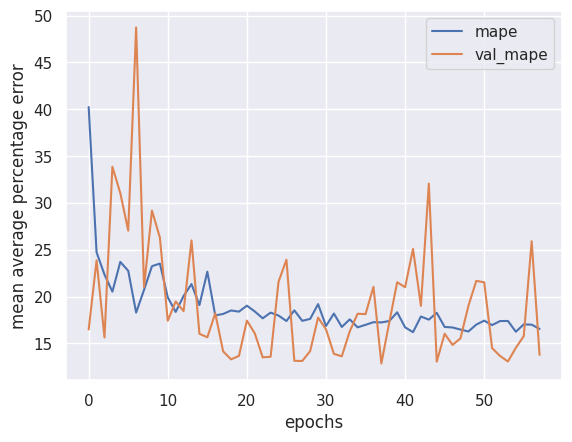

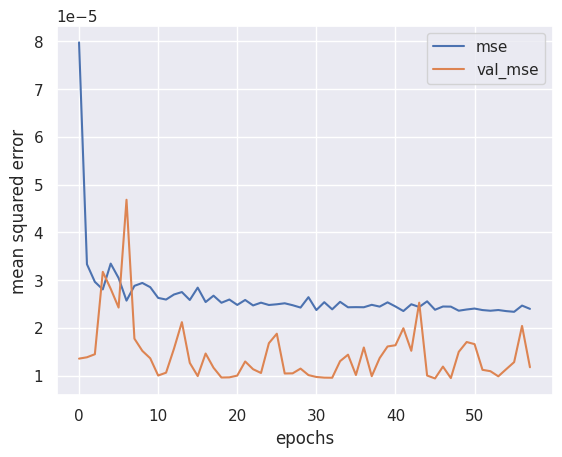

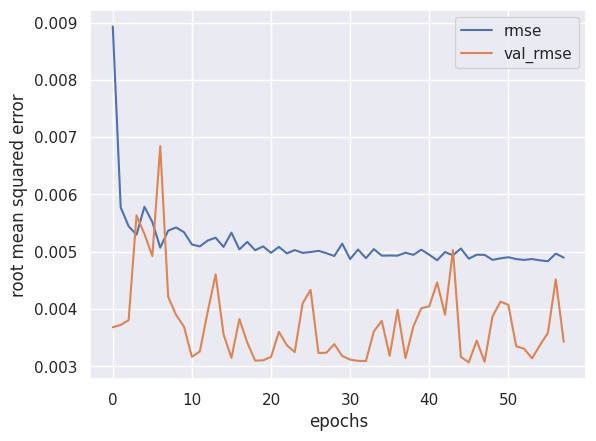

In [1040]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

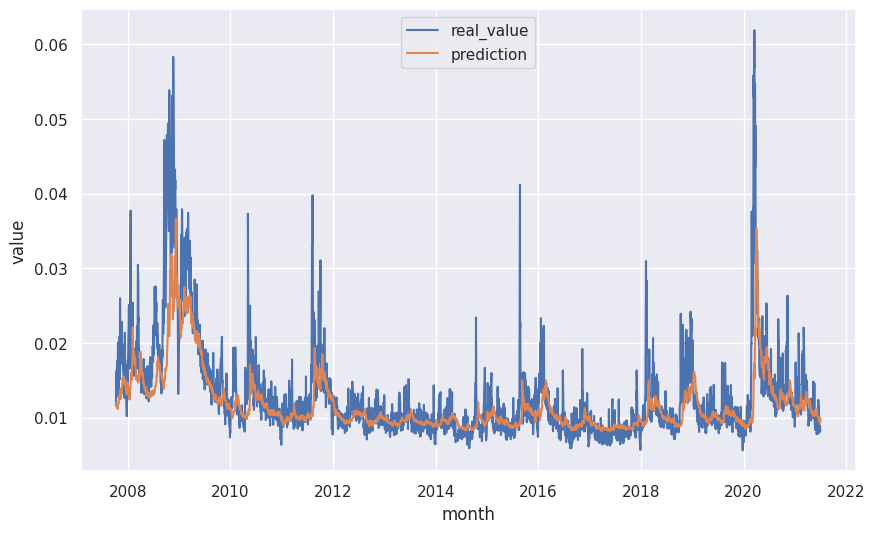

In [1041]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

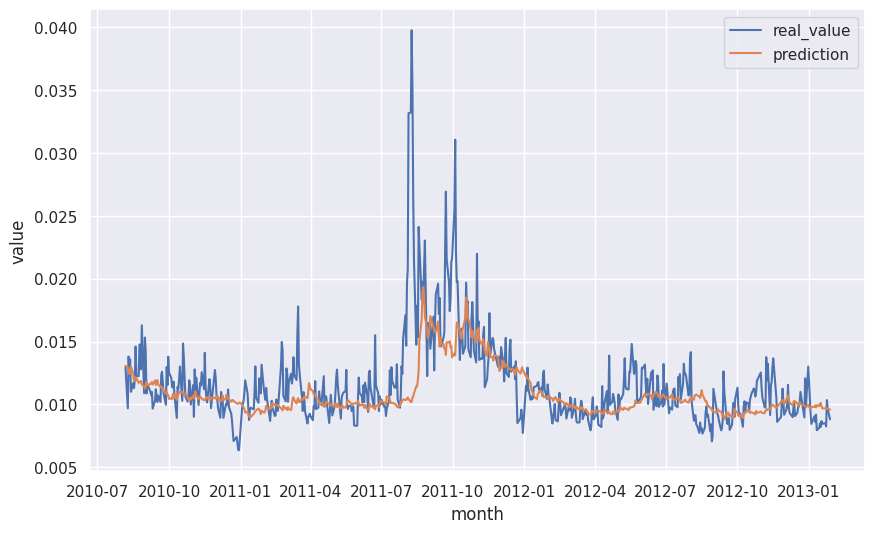

In [1042]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (60:40)

In [1043]:
# variables
fh = 10
fold = 1

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 16,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.001
}

In [1044]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [1045]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 38,369 (149.88 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

In [1046]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 17:07:33.318537: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:07:33.318647: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:07:33.318658: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272
2024-12-10 17:07:36.319465: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:07:39.179400: I tensorflow/core/framework/local_rendezvous.cc:423] Local

2024-12-10 17:07:54.726739: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:07:58.126718: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:07:58.126767: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:07:58.126778: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272
2024-12-10 17:08:01.316022: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:08:04.641214: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:08:04.641272: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous rec

In [1047]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 12.4252 - mean_squared_error: 1.1278e-05 - root_mean_squared_error: 0.0033


2024-12-10 17:10:16.551051: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237


[12.715786933898926, 9.745351235324051e-06, 0.0031217546202242374]

In [1048]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


In [1049]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step


In [1050]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv', index=False)

In [1051]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 114,853 (448.65 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 76,484 (298.77 KB)

##### Test Evaluate Model (60:40)

In [1052]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv')

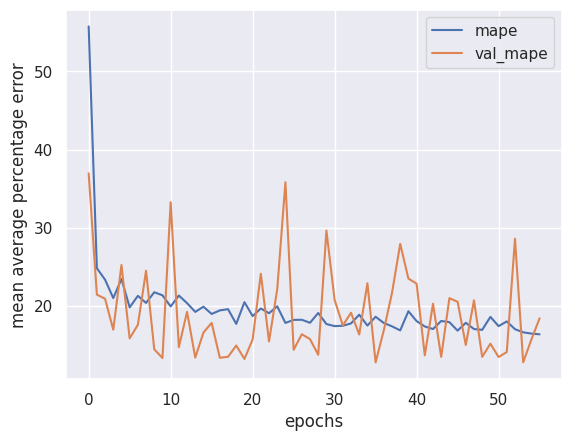

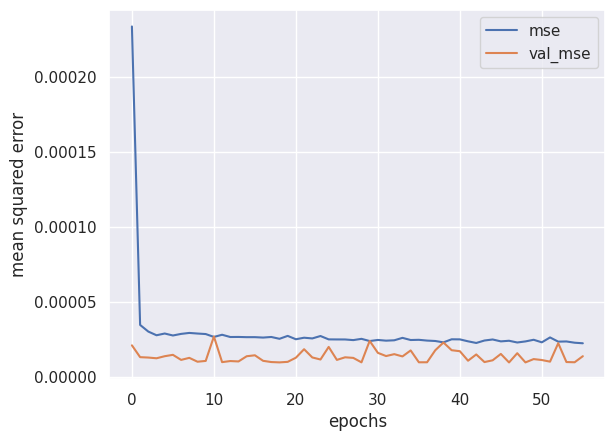

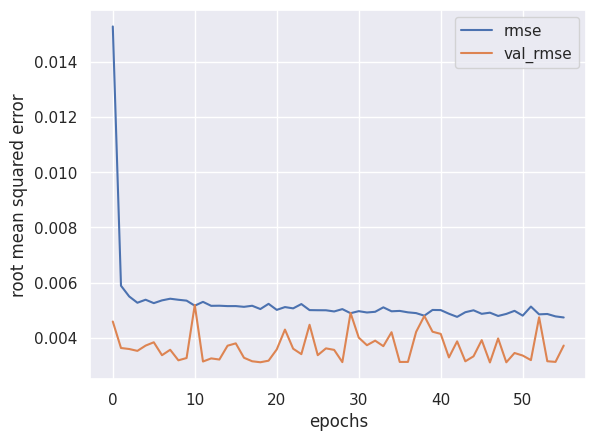

In [1053]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

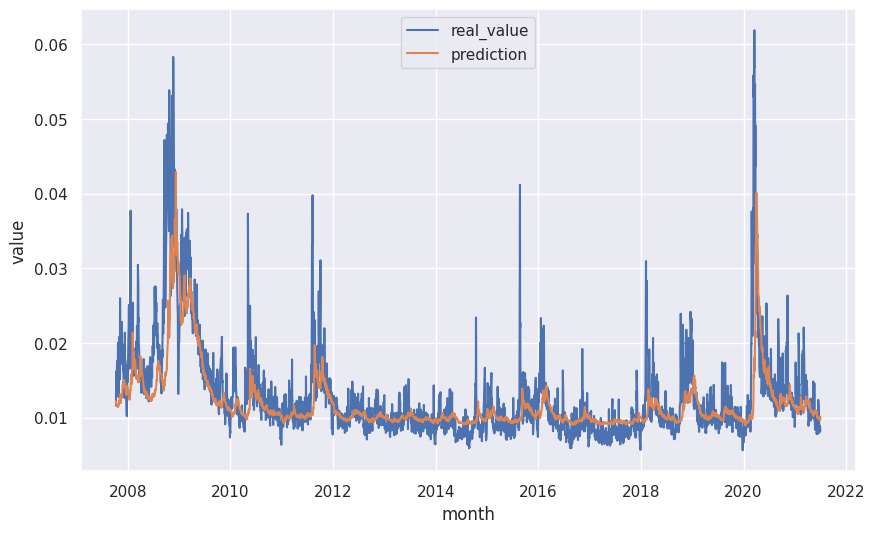

In [1054]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

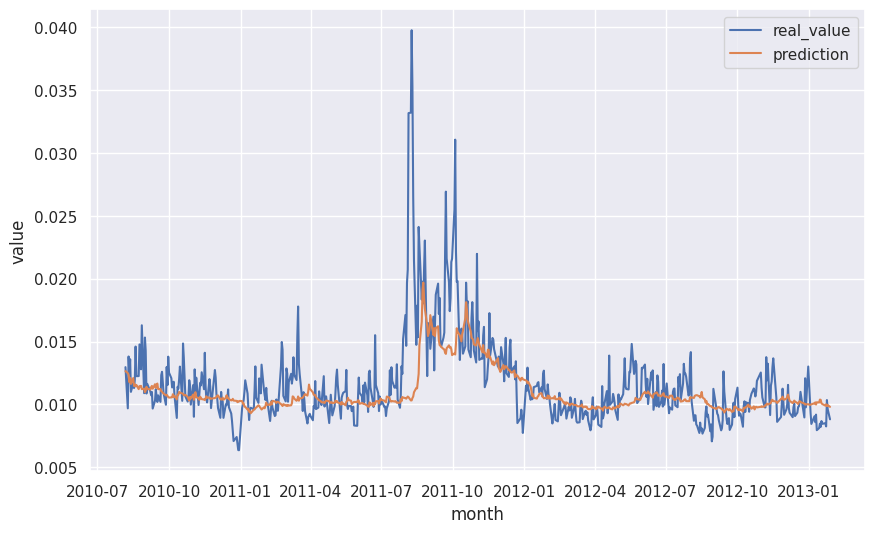

In [1055]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [1056]:
# variables
fh = 10
fold = 1

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 16,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.001
}

In [1057]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [1058]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 38,369 (149.88 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

In [1059]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 17:10:25.330404: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:10:25.330459: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:10:25.330467: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272
2024-12-10 17:10:26.578254: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6556615866311137287
2024-12-10 17:10:26.733189: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

2024-12-10 17:10:52.003436: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:10:52.003496: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:10:52.003506: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272
2024-12-10 17:10:53.503499: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6556615866311137287
2024-12-10 17:10:53.503555: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12792663592633999557
2024-12-10 17:10:53.503563: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 16930505664870644233
2024-12-10 17:10:53.503570: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv

In [1060]:
# evaluate model
model.evaluate(example_test_ds)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 11.8944 - mean_squared_error: 2.7055e-06 - root_mean_squared_error: 0.0016


2024-12-10 17:11:25.562569: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:11:25.562621: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:11:25.562631: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272


[12.118727684020996, 2.980251110784593e-06, 0.0017263403860852122]

In [1061]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


In [1062]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step


In [1063]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [1064]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 114,853 (448.65 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 76,484 (298.77 KB)

##### Test Evaluate Model (50% 80:20)

In [1065]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

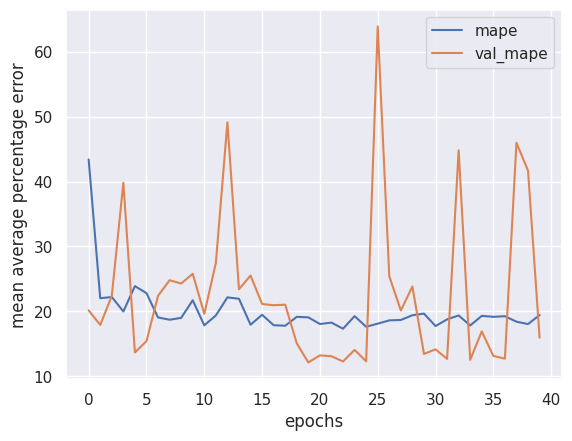

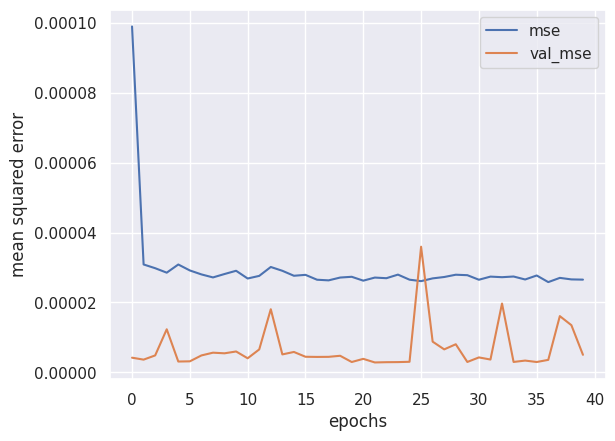

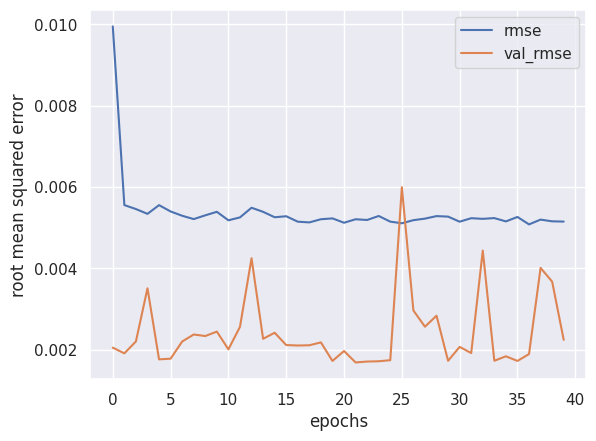

In [1066]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

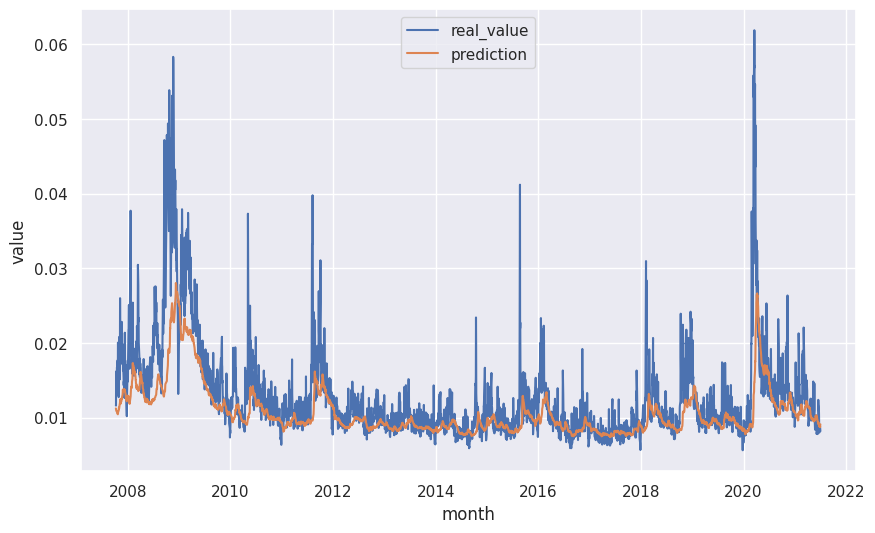

In [1067]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

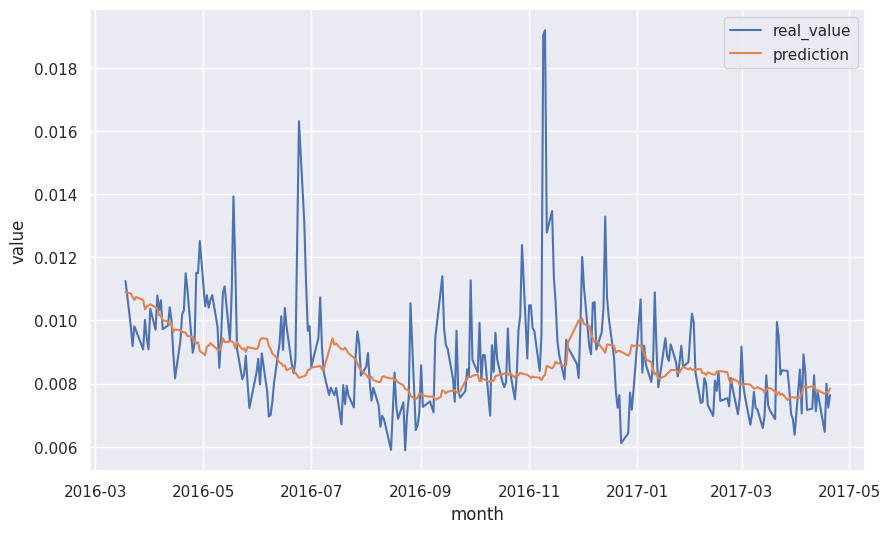

In [1068]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Fold 2

##### Test Train & Predict Model

In [1069]:
# variables
fh = 10
fold = 2

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 16,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.001
}

In [1070]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [1071]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 38,369 (149.88 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

In [1072]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 17:11:39.860924: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12792663592633999557
2024-12-10 17:11:39.860980: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6556615866311137287
2024-12-10 17:11:39.860988: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 16930505664870644233
2024-12-10 17:11:39.860994: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5940596807159114618
2024-12-10 17:11:40.216778: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

2024-12-10 17:11:54.357627: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12792663592633999557
2024-12-10 17:11:54.357694: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5940596807159114618
2024-12-10 17:11:54.722639: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:11:54.722708: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:11:54.722721: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272
2024-12-10 17:11:57.374433: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12792663592633999557
2024-12-10 17:11:57.374486: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv

In [1073]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 14.3457 - mean_squared_error: 8.8907e-06 - root_mean_squared_error: 0.0029


2024-12-10 17:12:48.182998: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:12:48.183114: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272


[14.391739845275879, 6.891429165989393e-06, 0.0026251531671732664]

In [1074]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


In [1075]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


In [1076]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [1077]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 114,853 (448.65 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 76,484 (298.77 KB)

##### Test Evaluate Model

In [1078]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

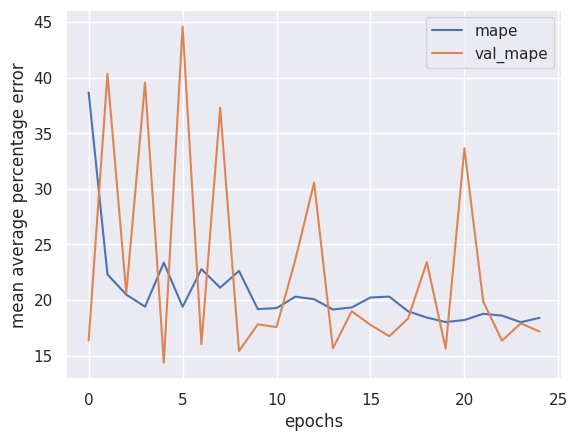

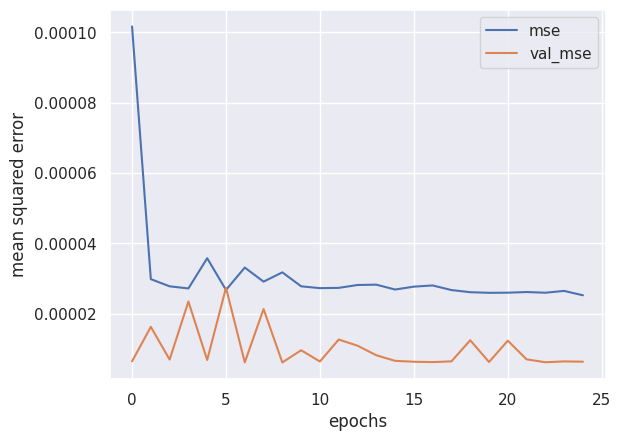

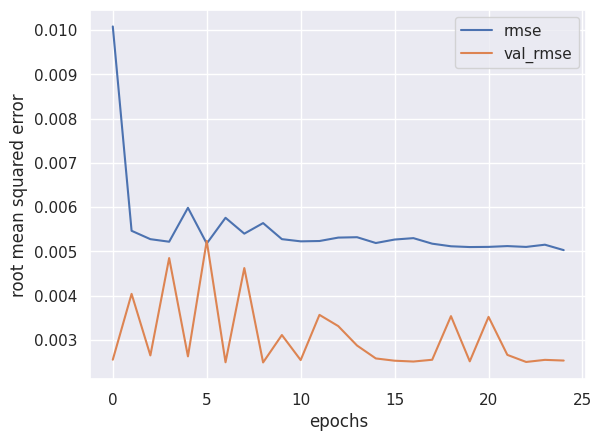

In [1079]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

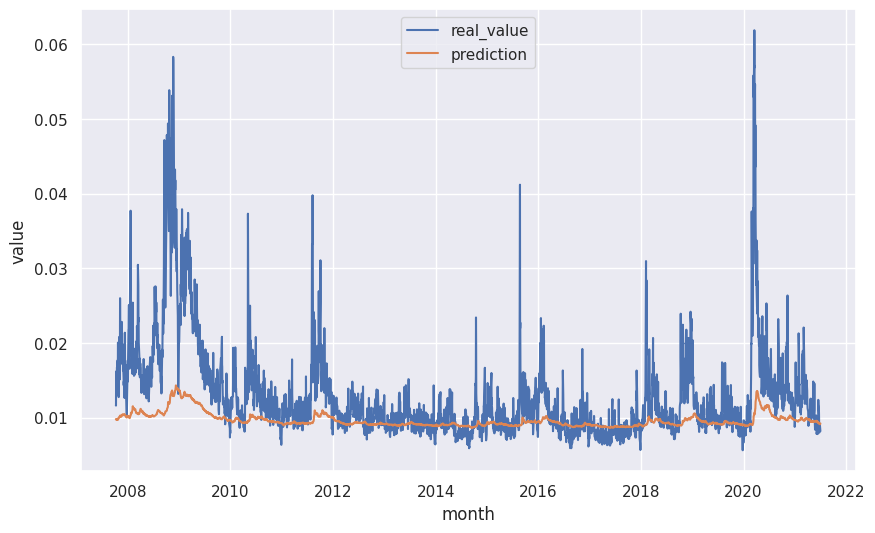

In [1080]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

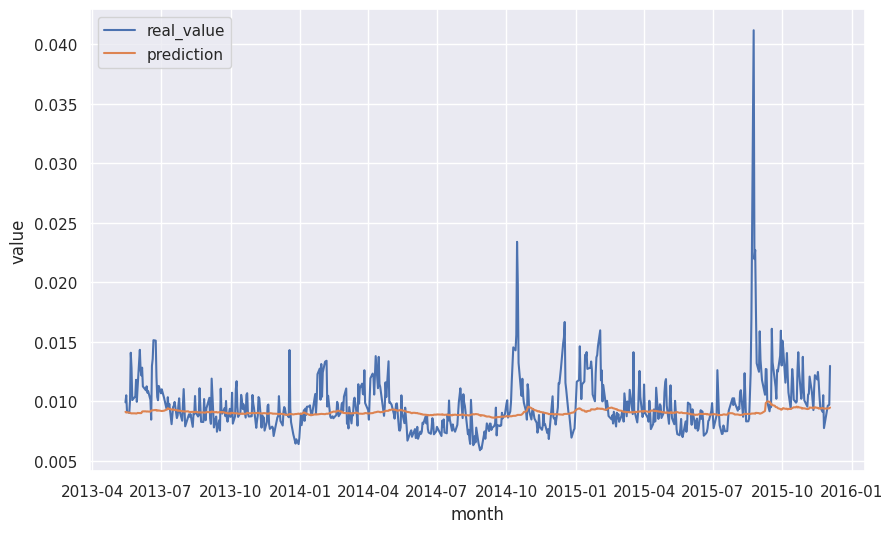

In [1081]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (60:40)

In [1082]:
# variables
fh = 10
fold = 2

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 16,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.001
}

In [1083]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [1084]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 38,369 (149.88 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

In [1085]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 17:12:58.801521: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6556615866311137287
2024-12-10 17:12:58.801627: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 16930505664870644233
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 17:13:05.769077: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6556615866311137287
2024-12-10 17:13:05.769152: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12792663592633999557
2024-12-10 17:13:05.769167: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

In [1086]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 13.9955 - mean_squared_error: 8.6293e-06 - root_mean_squared_error: 0.0029


[14.201640129089355, 7.185357844718965e-06, 0.00268055172637105]

In [1087]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step


In [1088]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


In [1089]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv', index=False)

In [1090]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 114,853 (448.65 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 76,484 (298.77 KB)

##### Test Evaluate Model (60:40)

In [1091]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv')

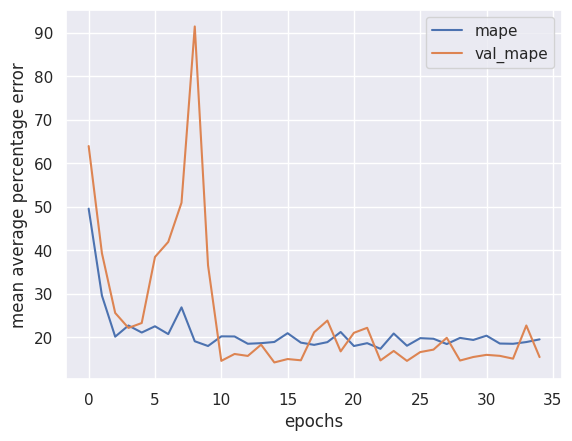

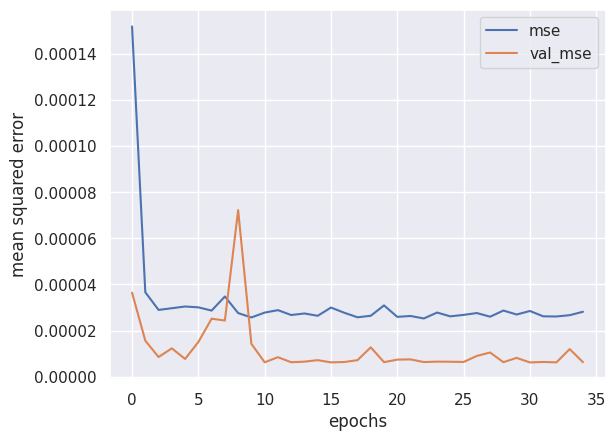

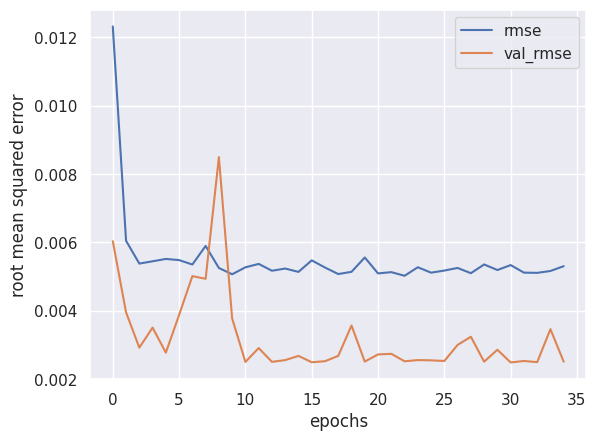

In [1092]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

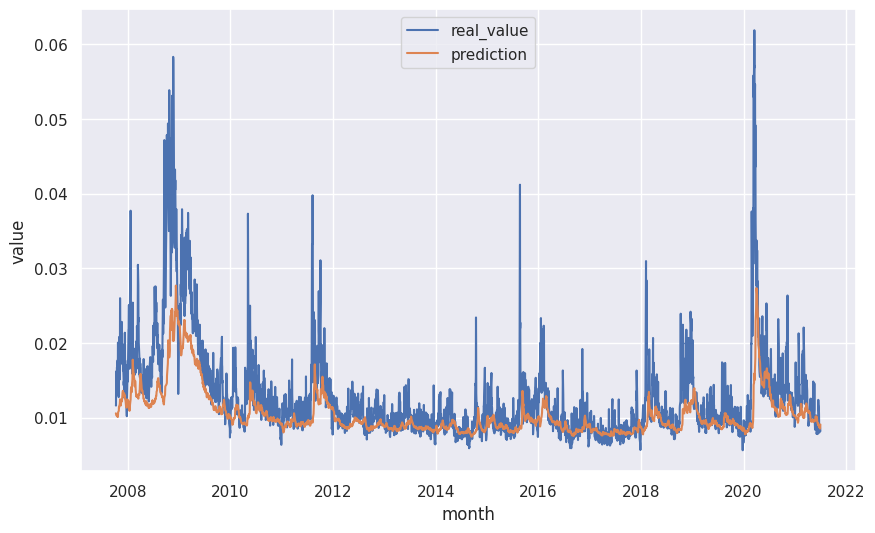

In [1093]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

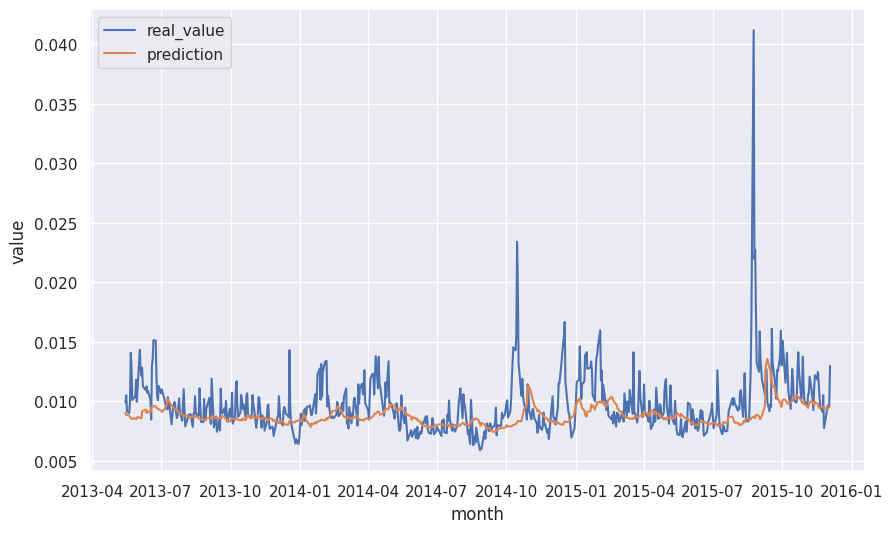

In [1094]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [1095]:
# variables
fh = 10
fold = 2

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 16,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.001
}

In [1096]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [1097]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 38,369 (149.88 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

In [1098]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 17:15:32.774092: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 16930505664870644233
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 17:15:33.313115: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:15:33.313165: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272
2024-12-10 17:15:34.820417: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 16930505664870644233
2024-12-10 17:15:34.992858: I tensorflow/core/framework/local_rendezvous.cc:423] Loca

2024-12-10 17:15:53.533844: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 16930505664870644233
2024-12-10 17:15:55.131353: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 16930505664870644233
2024-12-10 17:15:56.654893: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 16930505664870644233
2024-12-10 17:15:58.475233: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 16930505664870644233
2024-12-10 17:16:00.555753: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 16930505664870644233
2024-12-10 17:16:05.285601: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 16930505664870644233
2024-12-10 17:16:07.599482: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous re

In [1099]:
# evaluate model
model.evaluate(example_test_ds)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 13.9766 - mean_squared_error: 8.6215e-06 - root_mean_squared_error: 0.0029


[14.556856155395508, 1.008302115224069e-05, 0.003175377380102873]

In [1100]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


In [1101]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step


In [1102]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [1103]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 114,853 (448.65 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 76,484 (298.77 KB)

##### Test Evaluate Model (50% 80:20)

In [1104]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

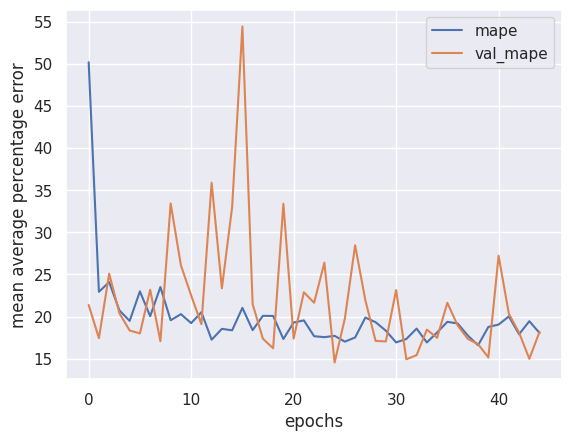

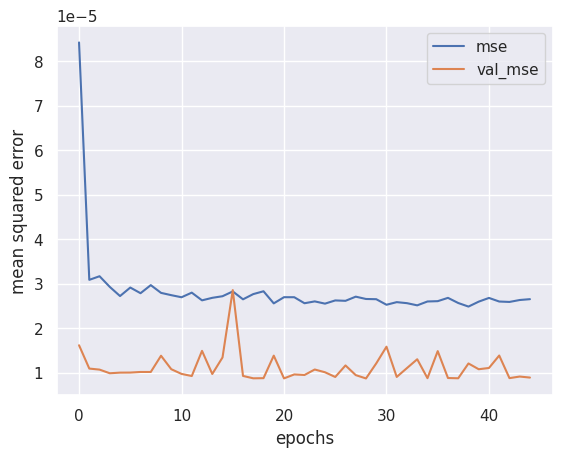

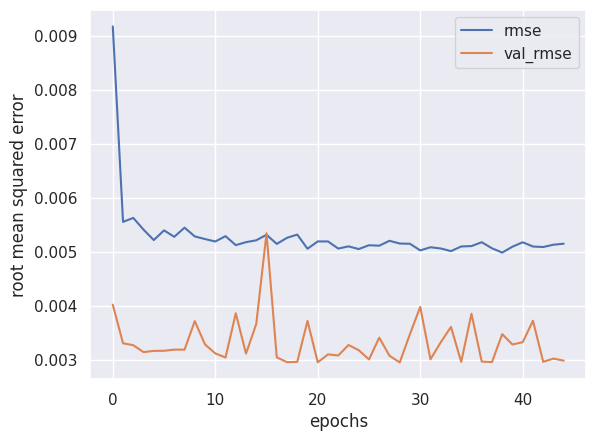

In [1105]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

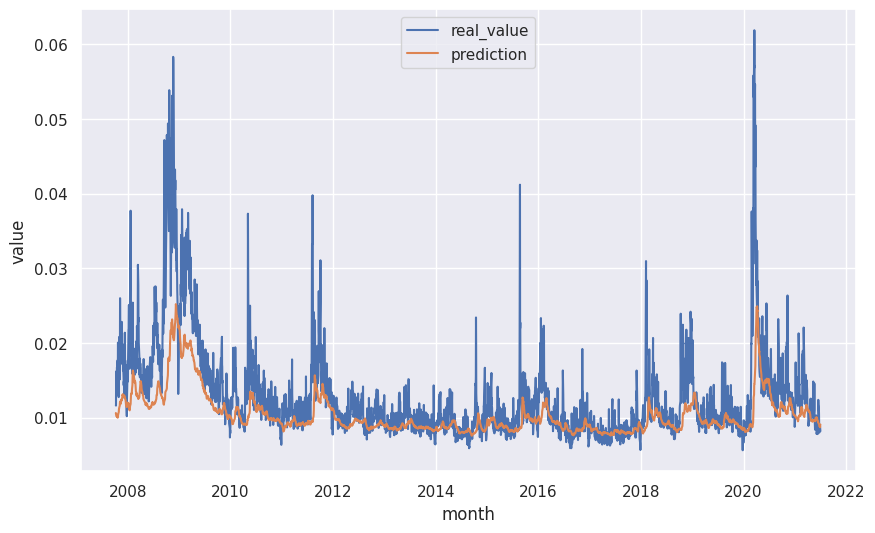

In [1106]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

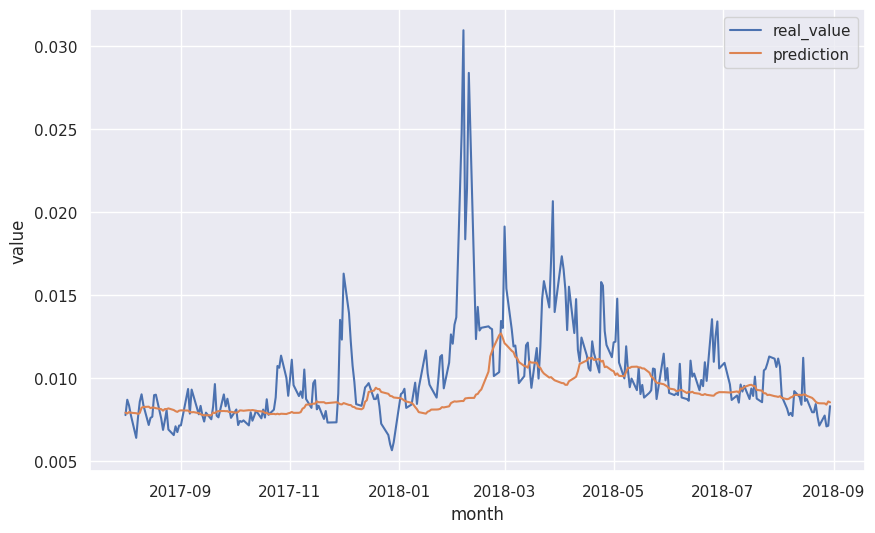

In [1107]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Fold 3

##### Test Train & Predict Model

In [1108]:
# variables
fh = 10
fold = 3

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 16,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.001
}

In [1109]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [1110]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 38,369 (149.88 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

In [1111]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 17:17:05.035932: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12792663592633999557
2024-12-10 17:17:05.035996: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6556615866311137287
2024-12-10 17:17:05.036006: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5940596807159114618
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 17:17:13.123856: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12792663592633999557
2024-12-10 17:17:13.123917: I tensorflow/core/framework/local_rendezvous.cc:423] Local 

2024-12-10 17:17:54.494412: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5940596807159114618
2024-12-10 17:17:54.494505: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12792663592633999557
2024-12-10 17:17:54.894728: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272
2024-12-10 17:18:02.239129: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12792663592633999557
2024-12-10 17:18:02.239182: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6556615866311137287
2024-12-10 17:18:02.239192: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5940596807159114618
2024-12-10 17:18:02.679429: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv 

In [1112]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 13.6635 - mean_squared_error: 6.6956e-06 - root_mean_squared_error: 0.0026


2024-12-10 17:18:45.781766: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:18:45.781825: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:18:45.781836: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272


[13.238661766052246, 6.010052402416477e-06, 0.0024515409022569656]

In [1113]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


In [1114]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


In [1115]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [1116]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 114,853 (448.65 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 76,484 (298.77 KB)

##### Test Evaluate Model

In [1117]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

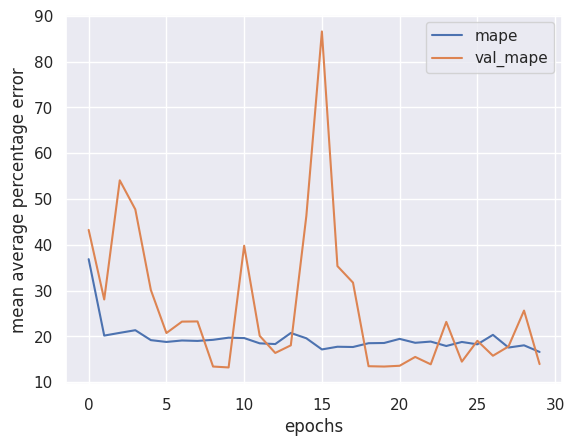

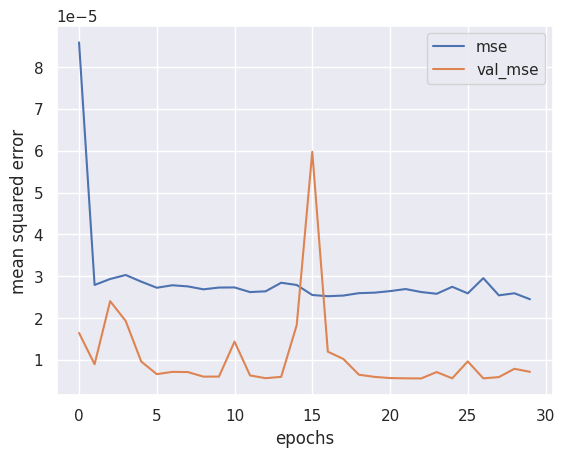

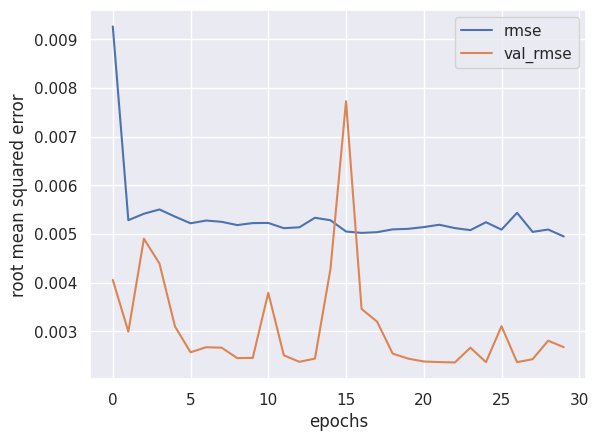

In [1118]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

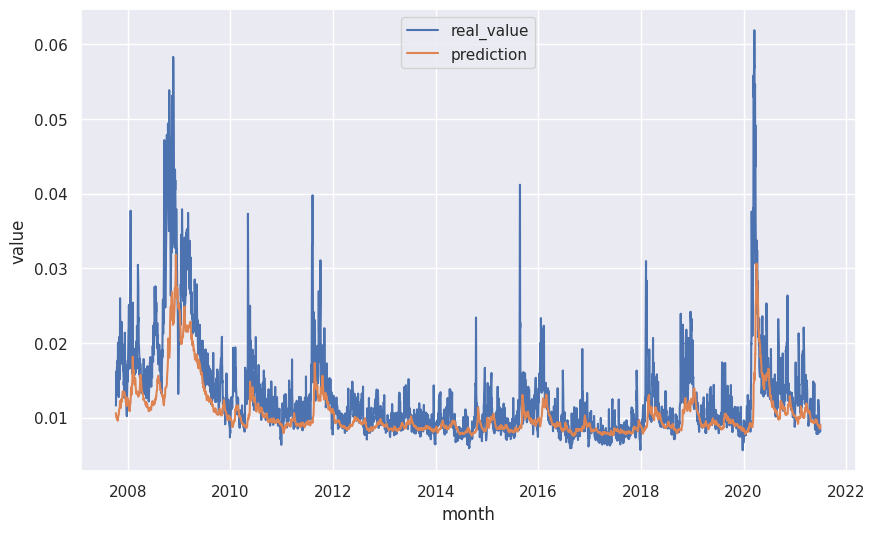

In [1119]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

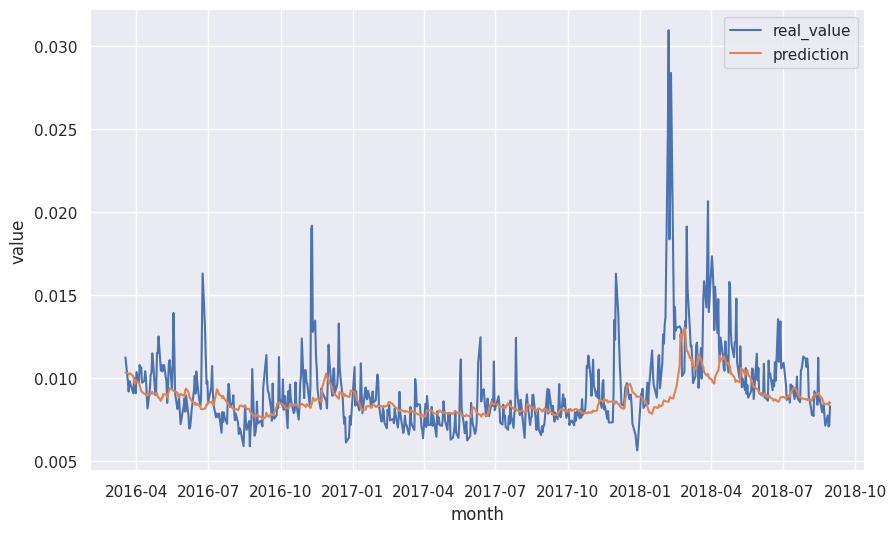

In [1120]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (60:40)

In [1121]:
# variables
fh = 10
fold = 3

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 16,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.001
}

In [1122]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [1123]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 38,369 (149.88 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

In [1124]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 17:18:56.830283: I tensorflow/core/framework/local_rendezvous.cc:427] Local rendezvous send item cancelled. Key hash: 1589820051876883128
2024-12-10 17:18:56.830870: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 5940596807159114618
2024-12-10 17:18:56.830902: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12792663592633999557
2024-12-10 17:18:56.830929: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6556615866311137287
2024-12-10 17:18:56.830936: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 16930505664870644233
2024-12-10 17:18:56.830939: I tensorflow/core/framework/local_rendezvous.cc:427] Local rendezvous send item cancelled. Key hash: 6865300069597741683
2024-12-10 17:18:56.830942: I tensorflow/core/framework/local_rendezvous.cc:427] Local rendezvous send i

In [1125]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 13.1325 - mean_squared_error: 4.1068e-06 - root_mean_squared_error: 0.0020


2024-12-10 17:20:42.352405: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:20:42.352463: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575


[13.368931770324707, 5.7390461734030396e-06, 0.002395630581304431]

In [1126]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step


In [1127]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step


In [1128]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv', index=False)

In [1129]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 114,853 (448.65 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 76,484 (298.77 KB)

##### Test Evaluate Model (60:40)

In [1130]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_60:40_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_60:40_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_60:40_fh_{fh}_fold_{fold}.csv')

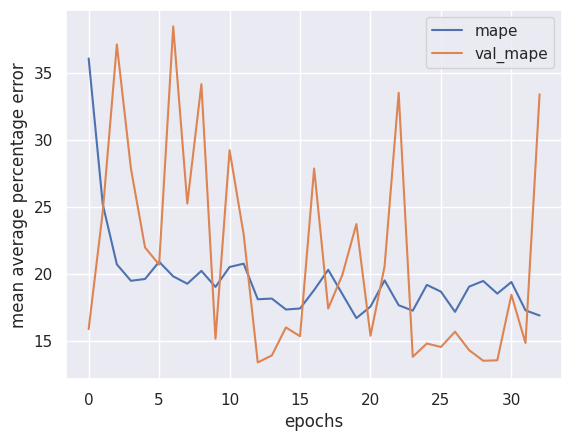

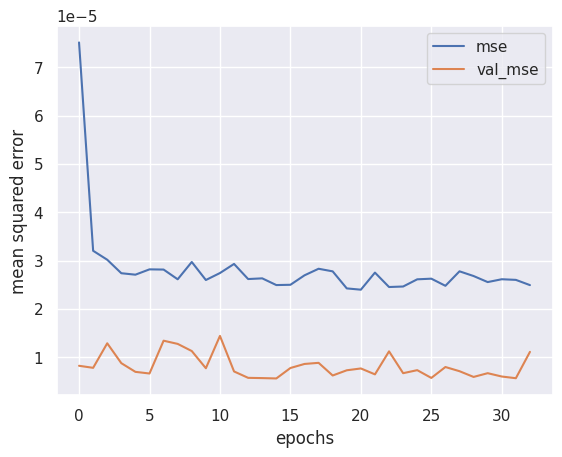

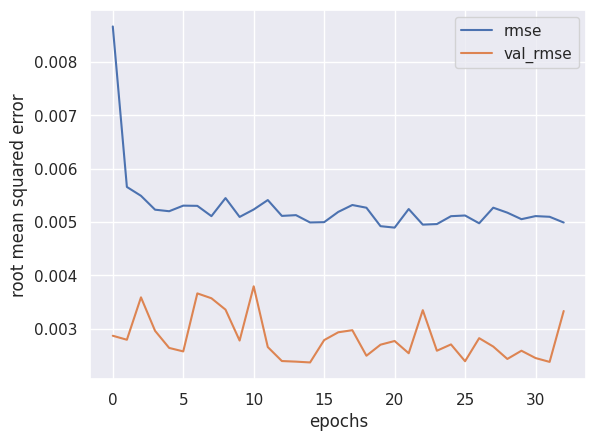

In [1131]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

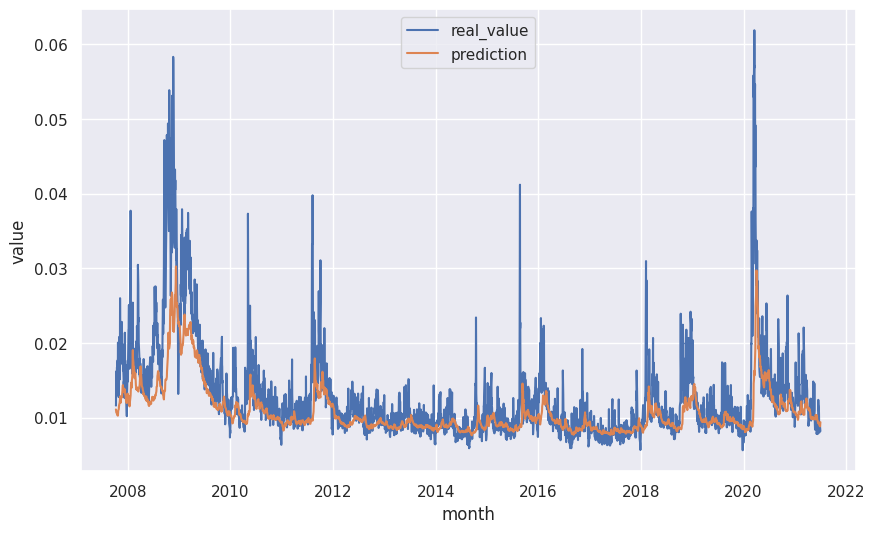

In [1132]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

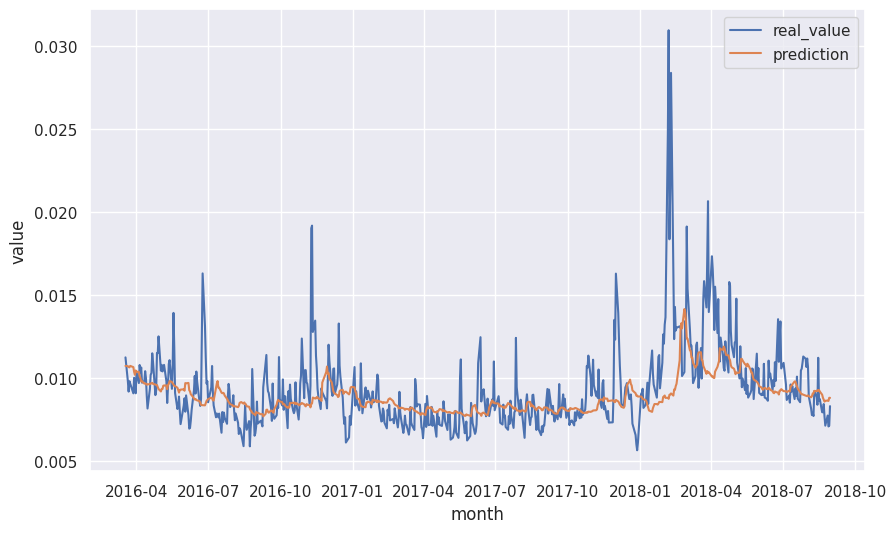

In [1133]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [1134]:
# variables
fh = 10
fold = 3

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 16,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.001
}

In [1135]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [1136]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 38,369 (149.88 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

In [1137]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

2024-12-10 17:20:53.097410: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 12792663592633999557
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)
2024-12-10 17:20:53.622187: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:20:53.622250: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:20:53.622260: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272
2024-12-10 17:20:55.100136: I tensorflow/core/framework/local_rendezvous.cc:423] Local

In [1138]:
# evaluate model
model.evaluate(example_test_ds)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 12.4533 - mean_squared_error: 6.1259e-06 - root_mean_squared_error: 0.0025


2024-12-10 17:22:10.689130: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:22:10.689185: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:22:10.689197: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272


[13.700860977172852, 6.99082420396735e-06, 0.0026440166402608156]

In [1139]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step


In [1140]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step


In [1141]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [1142]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 114,853 (448.65 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 76,484 (298.77 KB)

##### Test Evaluate Model (50% 80:20)

In [1143]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

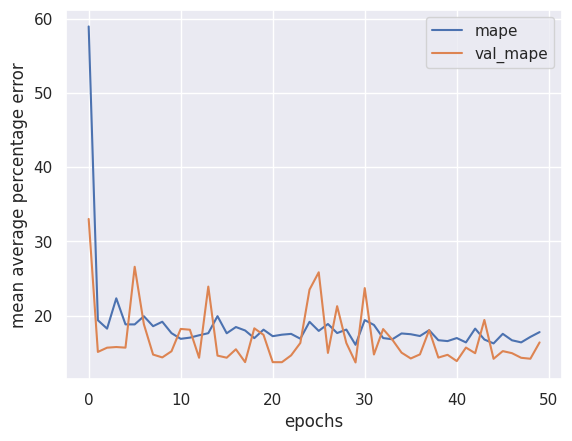

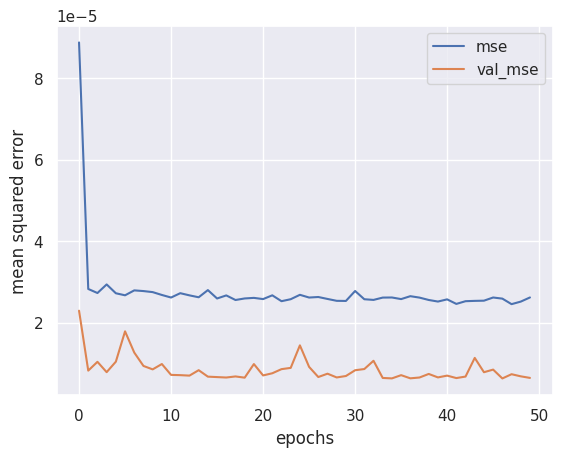

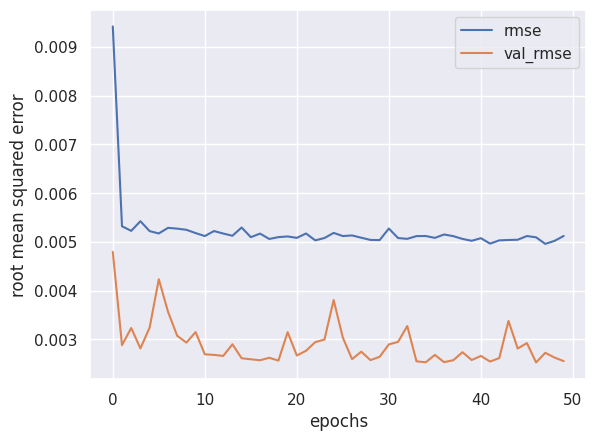

In [1144]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

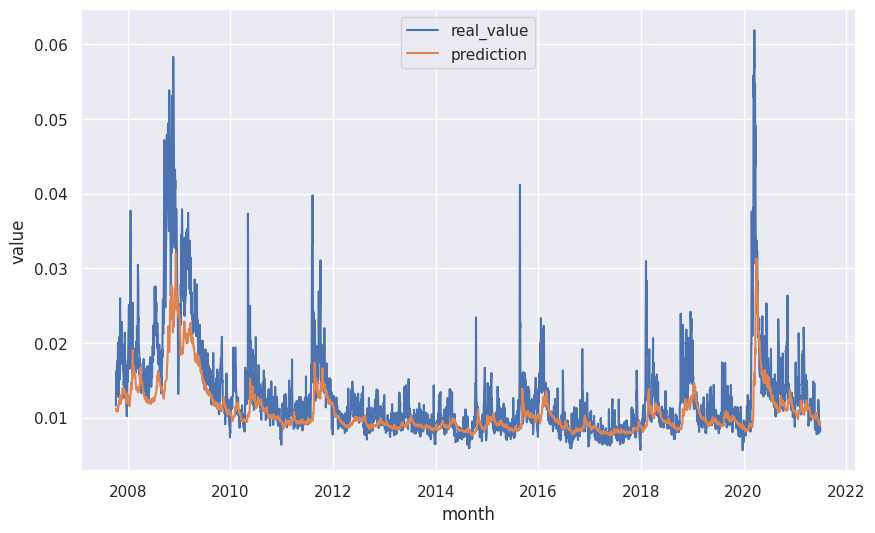

In [1145]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

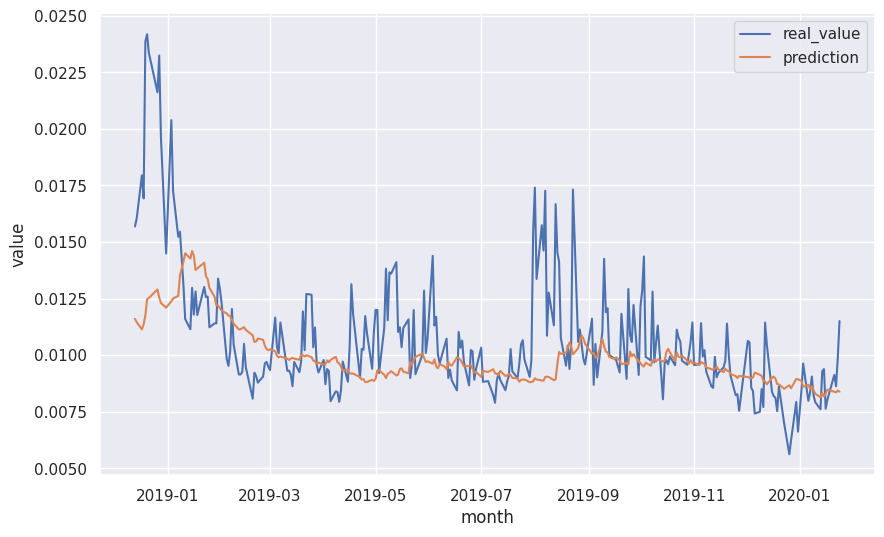

In [1146]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Fold 4

##### Test Train & Predict Model

In [1147]:
# variables
fh = 10
fold = 4

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 16,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.001
}

In [1148]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [1149]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 38,369 (149.88 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

In [1150]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

W0000 00:00:1733847740.995290    3534 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733847741.001616    3534 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733847741.007675    3534 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733847741.013934    3534 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733847741.020425    3534 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733847741.026749    3534 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733847741.032991    3534 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733847741.039197    3534 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733847741.045732    3534 gp

2024-12-10 17:22:53.357487: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:22:53.357532: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:22:53.357540: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272
2024-12-10 17:23:01.589177: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:23:01.589261: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:23:01.589280: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272
2024-12-10 17:23:04.430721: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv

In [1151]:
# evaluate model
model.evaluate(example_test_ds)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 16.8273 - mean_squared_error: 3.3212e-05 - root_mean_squared_error: 0.0056


[17.16489601135254, 4.165774225839414e-05, 0.00645428104326129]

In [1152]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


In [1153]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv', index=False)

20/20 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step


In [1154]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv', index=False)

In [1155]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 114,853 (448.65 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 76,484 (298.77 KB)

##### Test Evaluate Model

In [1156]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_fh_{fh}_fold_{fold}.csv')

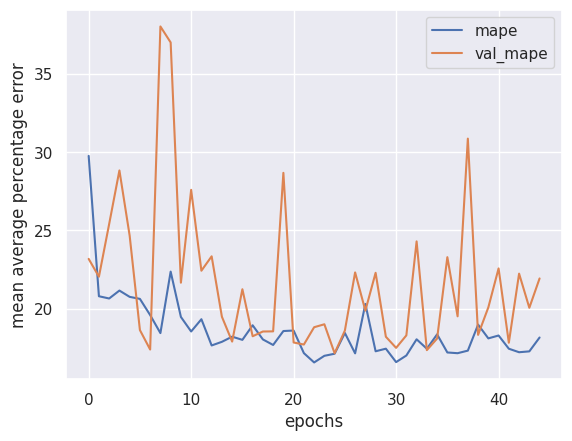

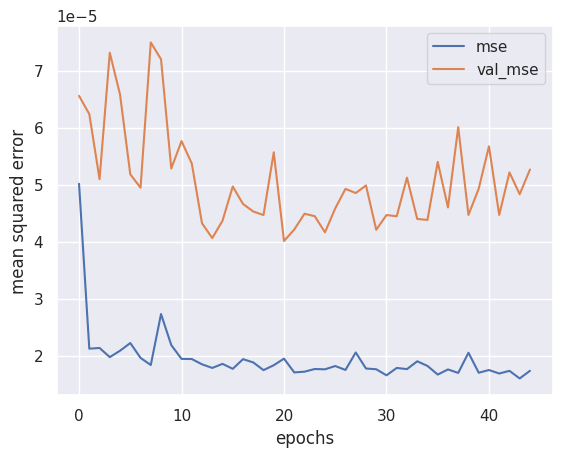

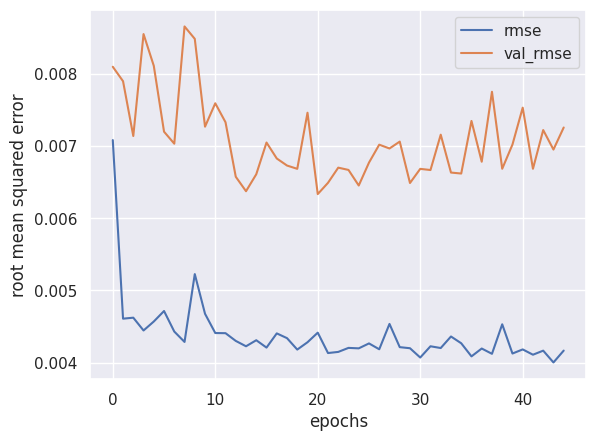

In [1157]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

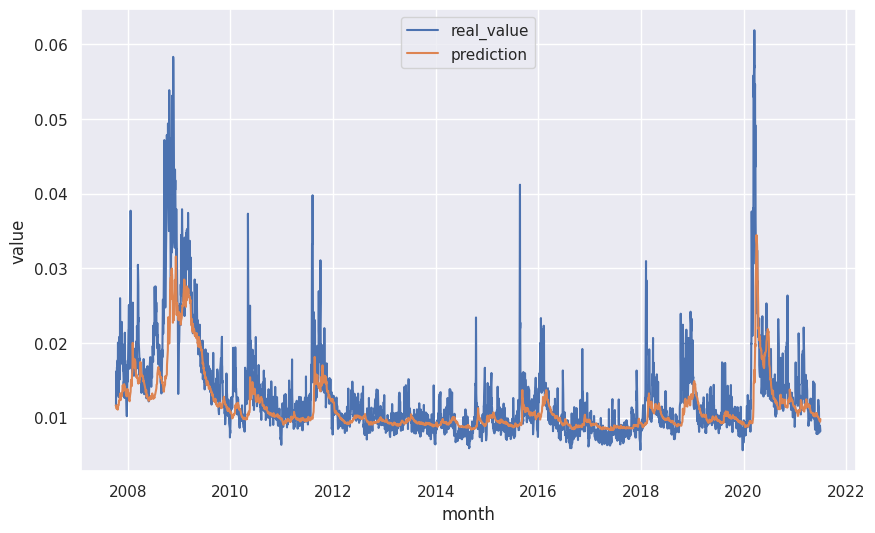

In [1158]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

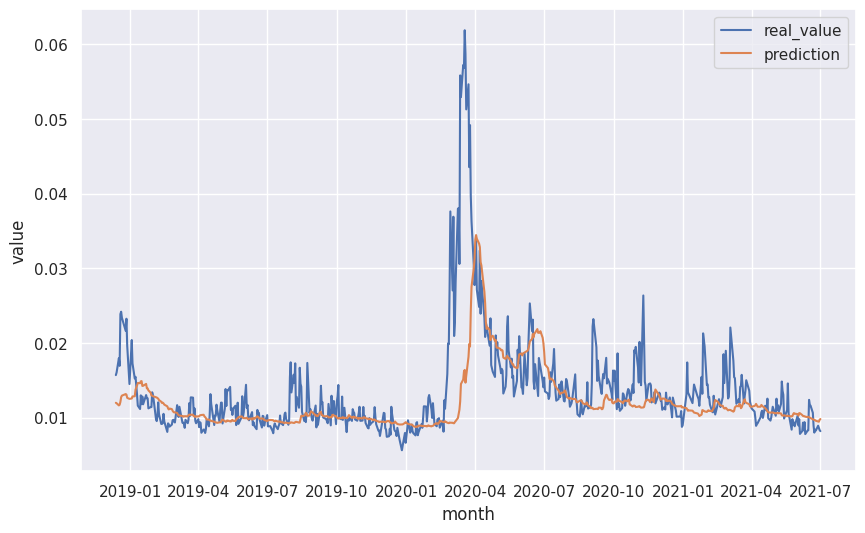

In [1159]:
# prediction vs real value (test data)
plot_series(
    time=date_series[prediction_test_data['date_idx'].values],
    series=np.stack((series[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

##### Test Train & Predict Model (50% 80:20)

In [1160]:
# variables
fh = 10
fold = 4

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 16,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.001
}

In [1161]:
# Create window data & convert data into tf.data.Dataset format
example_train_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/train_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)
example_test_ds = create_window_dataset(
    series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=batch_size,
    shuffle_buffer=shuffle_buffer,
)

In [1162]:
# create model
model = VolatilityForecastConvBiLSTM(
    input_shape=[example_hps['window_size'], 1],
    cnn=Conv1DMaxPool(arch=[[example_hps['conv_0_filters'], 3, 2], [example_hps['conv_1_filters'], 3, 2]], batch_normalization=True, name='cnn'),
    bilstm=BidirectionalLSTM2D(arch=[example_hps['lstm_0_nodes'], example_hps['lstm_1_nodes']], name=f'bilstm'),
    mlp=MultilayerPerceptron(arch=[example_hps['perceptron_0_nodes'], example_hps['perceptron_1_nodes'], example_hps['perceptron_2_nodes']], activation=None, name='mlp'),
    dropout_rate_0=example_hps['dropout_rate_0'],
    dropout_rate_1=example_hps['dropout_rate_1'],
)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=example_hps['learning_rate']),
    loss=tf.keras.losses.MeanAbsolutePercentageError(),
    metrics=[
        tf.keras.metrics.MeanSquaredError(),
        tf.keras.metrics.RootMeanSquaredError(),
    ],
)
model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 38,369 (149.88 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

In [1163]:
# train model
history = model.fit(
    example_train_ds,
    validation_data=example_test_ds,
    epochs=1000,
    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)],
    verbose=0,
)

W0000 00:00:1733847878.532805    3535 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733847878.535353    3535 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733847878.537842    3535 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733847878.540219    3535 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733847878.542565    3535 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733847878.545120    3535 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733847878.547554    3535 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733847878.549984    3535 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733847878.552484    3535 gp

2024-12-10 17:24:53.287843: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:24:54.979909: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:24:54.979962: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:24:54.979972: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272
2024-12-10 17:24:56.492444: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:24:56.492512: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:24:56.492524: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv 

In [1164]:
# evaluate model
model.evaluate(example_test_ds)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 15.6483 - mean_squared_error: 1.0784e-05 - root_mean_squared_error: 0.0033


2024-12-10 17:25:38.690833: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:25:38.690886: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:25:38.690895: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272


[15.237504959106445, 1.0456943527969997e-05, 0.003233719849959016]

In [1165]:
# predict using model using all data folds
temp_data = series
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = time[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

105/105 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step


In [1166]:
# predict using model using test data fold
temp_data = np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy')
temp_ds = create_window_dataset(
    series=np.expand_dims(temp_data, axis=-1),
    window_size=example_hps['window_size'],
    forecast_horizon=fh,
    batch_size=len(temp_data),
)

for inputs, label in temp_ds.take(1):
    prediction = model.predict(inputs)

temp_ds = pd.DataFrame(prediction, columns=['prediction'])
temp_ds['date_idx'] = np.load(f'{data_folder}/50%_80:20_fold/test_time_{fold}.npy')[example_hps['window_size']+fh-1:]

temp_ds.to_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


In [1167]:
# save model in keras format
model.save(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')

# save training history
pd.DataFrame(history.history).to_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv', index=False)

In [1168]:
# load model in keras format
loaded_model = tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras')
loaded_model.summary()

Model: "VolatilityForecastConvBiLSTM"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input (InputLayer)              │ (None, 60, 1)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ cnn (Sequential)                │ (None, 30, 64)         │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_0 (Dropout)             │ (None, 30, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bilstm (Sequential)             │ (None, 32)             │        35,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mlp (Sequential)                │ (None, 16)             │         2,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output (Dense)                  │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 114,853 (448.65 KB)

 Trainable params: 38,241 (149.38 KB)

 Non-trainable params: 128 (512.00 B)

 Optimizer params: 76,484 (298.77 KB)

##### Test Evaluate Model (50% 80:20)

In [1169]:
# load training history
history_df = pd.read_csv(f'{archive_folder}/cnnbilstm/test_train_history_50%_80:20_fh_{fh}_fold_{fold}.csv')

# load predictions using test data and all data
prediction_test_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_test_data_50%_80:20_fh_{fh}_fold_{fold}.csv')
prediction_all_data = pd.read_csv(f'{archive_folder}/cnnbilstm/test_predict_all_data_50%_80:20_fh_{fh}_fold_{fold}.csv')

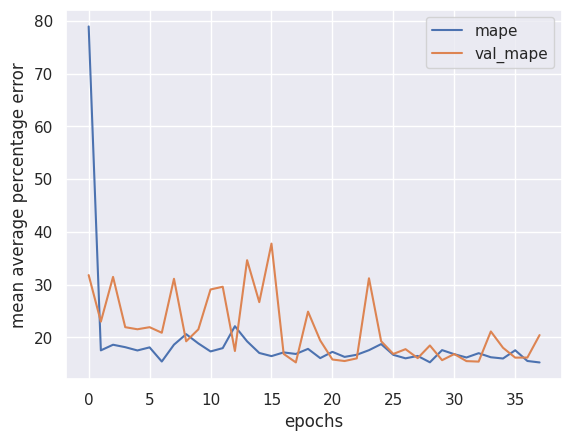

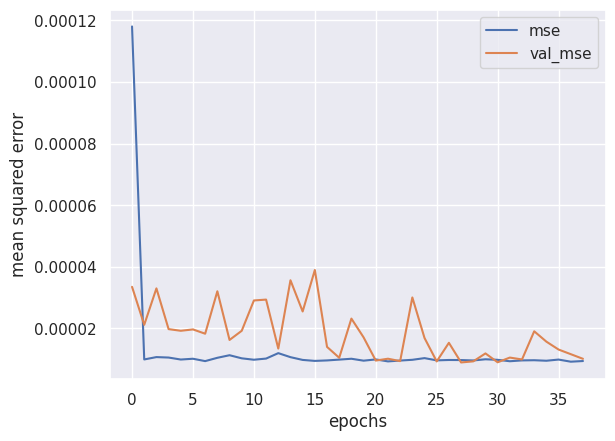

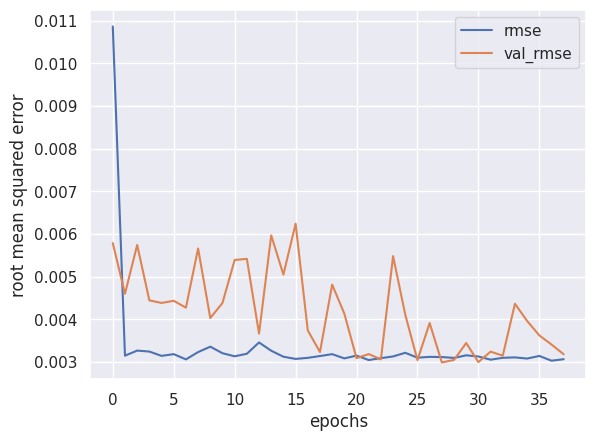

In [1170]:
# Plot the loss
plt.plot(history_df['loss'])
plt.plot(history_df['val_loss'])
plt.xlabel('epochs')
plt.ylabel('mean average percentage error')
plt.legend(['mape', 'val_mape'])
plt.show()

# Plot the loss
plt.plot(history_df['mean_squared_error'])
plt.plot(history_df['val_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('mean squared error')
plt.legend(['mse', 'val_mse'])
plt.show()

# Plot the loss
plt.plot(history_df['root_mean_squared_error'])
plt.plot(history_df['val_root_mean_squared_error'])
plt.xlabel('epochs')
plt.ylabel('root mean squared error')
plt.legend(['rmse', 'val_rmse'])
plt.show()

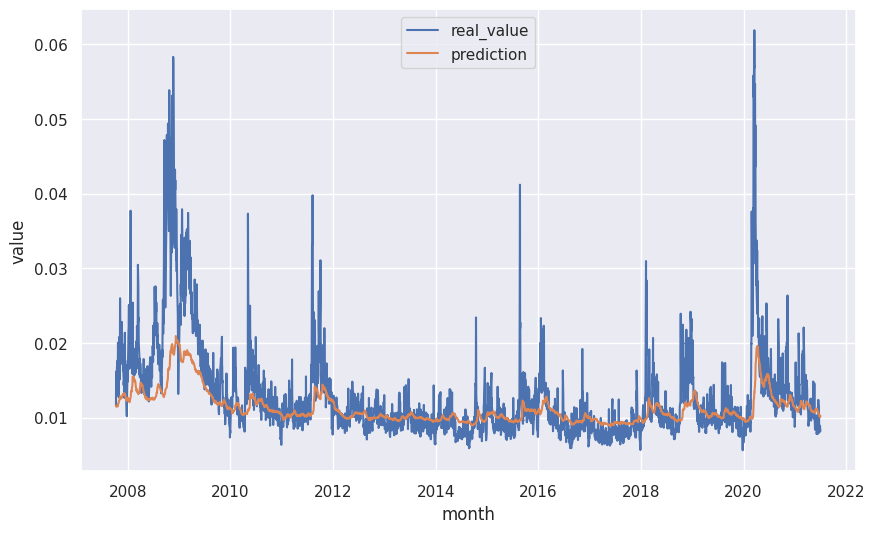

In [1171]:
# prediction vs real value (all data)
plot_series(
    time=date_series[prediction_all_data['date_idx'].values],
    series=np.stack((series[prediction_all_data['date_idx'].values], prediction_all_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

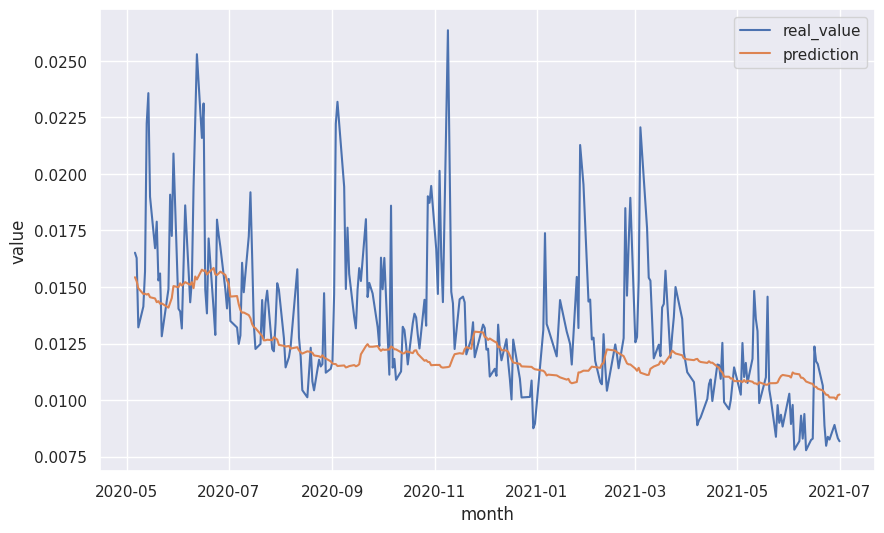

In [1172]:
# prediction vs real value (test data)
plot_series(
    time=date_series_50[prediction_test_data['date_idx'].values],
    series=np.stack((series_50[prediction_test_data['date_idx'].values], prediction_test_data.prediction.values), axis=1),
    legend=['real_value', 'prediction'],
    format='-',
    start=0,
    end=None,
    xlabel='month',
)

#### Summary

In [1173]:
# variables
fh = 10

# cnn_bilstm_hyperparameters
example_hps = {
    'window_size': 60,
    'conv_0_filters': 64,
    'conv_1_filters': 0,
    'lstm_0_nodes': 32,
    'lstm_1_nodes': 16,
    'perceptron_0_nodes': 32,
    'perceptron_1_nodes': 32,
    'perceptron_2_nodes': 16,
    'dropout_rate_0': 0.0,
    'dropout_rate_1': 0.0,
    'learning_rate': 0.001
}

60:40

In [1174]:
# load model in keras format
cnnbilstm_models = [tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_60:40_fh_{fh}_fold_{fold}.keras') for fold in range(4)]

# load test dataset
example_test_dss = []
for fold in range(4):
    example_test_dss.append(create_window_dataset(
        series=np.expand_dims(np.load(f'{data_folder}/60:40_fold/test_{fold}.npy'), axis=-1),
        window_size=example_hps['window_size'],
        forecast_horizon=fh,
        batch_size=batch_size,
        shuffle_buffer=shuffle_buffer,
    ))

In [1175]:
# evaluate model
evaluation_results = np.array([cnnbilstm_models[fold].evaluate(example_test_dss[fold]) for fold in range(4)])

41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 15.4486 - mean_squared_error: 2.5138e-05 - root_mean_squared_error: 0.0050


2024-12-10 17:25:44.661571: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:25:44.661624: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:25:44.661632: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - loss: 14.6446 - mean_squared_error: 6.5765e-06 - root_mean_squared_error: 0.0025


2024-12-10 17:25:45.751850: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:25:45.751902: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:25:45.751910: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272


41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - loss: 14.4107 - mean_squared_error: 7.3783e-06 - root_mean_squared_error: 0.0027


2024-12-10 17:25:46.789688: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:25:46.789741: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:25:46.789750: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272


     39/Unknown 1s 13ms/step - loss: 15.3478 - mean_squared_error: 2.9939e-05 - root_mean_squared_error: 0.0054

W0000 00:00:1733847947.871204    3535 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733847947.878054    3535 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733847947.883998    3535 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733847947.890019    3535 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733847947.895969    3535 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733847947.901849    3535 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733847947.908221    3535 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733847947.914108    3535 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1733847947.920246    3535 gp

41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - loss: 15.3398 - mean_squared_error: 2.9517e-05 - root_mean_squared_error: 0.0054


2024-12-10 17:25:48.079536: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:25:48.079578: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:25:48.079586: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272


In [1176]:
evaluation_results

array([[1.53617983e+01, 2.60395063e-05, 5.10289194e-03],
       [1.44005623e+01, 7.61374531e-06, 2.75930157e-03],
       [1.41901112e+01, 7.55958899e-06, 2.74947053e-03],
       [1.52368202e+01, 2.39748206e-05, 4.89640888e-03]])

In [1177]:
np.mean(evaluation_results, axis=0)

array([1.47973230e+01, 1.62969153e-05, 3.87701823e-03])

50% 80:20

In [1178]:
# load model in keras format
cnnbilstm_models = [tf.keras.models.load_model(f'{archive_folder}/cnnbilstm/test_train_model_50%_80:20_fh_{fh}_fold_{fold}.keras') for fold in range(5)]

# load test dataset
example_test_dss = []
for fold in range(5):
    example_test_dss.append(create_window_dataset(
        series=np.expand_dims(np.load(f'{data_folder}/50%_80:20_fold/test_{fold}.npy'), axis=-1),
        window_size=example_hps['window_size'],
        forecast_horizon=fh,
        batch_size=batch_size,
        shuffle_buffer=shuffle_buffer,
    ))

In [1179]:
# evaluate model
evaluation_results = np.array([cnnbilstm_models[fold].evaluate(example_test_dss[fold]) for fold in range(5)])

9/9 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - loss: 15.0879 - mean_squared_error: 1.5685e-05 - root_mean_squared_error: 0.0039


2024-12-10 17:25:50.112580: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:25:50.112623: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:25:50.112630: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272


9/9 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - loss: 12.1087 - mean_squared_error: 2.5894e-06 - root_mean_squared_error: 0.0016
9/9 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - loss: 15.0110 - mean_squared_error: 9.6758e-06 - root_mean_squared_error: 0.0031


2024-12-10 17:25:51.229209: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:25:51.229253: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:25:51.229261: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272


9/9 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - loss: 13.1709 - mean_squared_error: 6.0613e-06 - root_mean_squared_error: 0.0024


2024-12-10 17:25:51.754882: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:25:51.754995: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:25:51.755014: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272


9/9 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - loss: 14.5971 - mean_squared_error: 9.5105e-06 - root_mean_squared_error: 0.0031


2024-12-10 17:25:52.487077: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 13703672291177929237
2024-12-10 17:25:52.487135: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6892483720170272575
2024-12-10 17:25:52.487148: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 17776196235888326272


In [1180]:
evaluation_results

array([[1.51846066e+01, 1.04430674e-05, 3.23157362e-03],
       [1.21187353e+01, 2.98026589e-06, 1.72634458e-03],
       [1.45568161e+01, 1.00830048e-05, 3.17537459e-03],
       [1.37008619e+01, 6.99081920e-06, 2.64401571e-03],
       [1.52375355e+01, 1.04569590e-05, 3.23372218e-03]])

In [1181]:
np.mean(evaluation_results, axis=0)

array([1.41597111e+01, 8.19082325e-06, 2.80220613e-03])

# Experiment

## Bidirectional LSTM

In [29]:
# creating search space
search_space = list(itertools.product(
    bilstm_hyperparameters['window_size'],
    bilstm_hyperparameters['lstm_0_nodes'],
    bilstm_hyperparameters['lstm_1_nodes'],
    bilstm_hyperparameters['perceptron_0_nodes'],
    bilstm_hyperparameters['perceptron_1_nodes'],
    bilstm_hyperparameters['perceptron_2_nodes'],
    bilstm_hyperparameters['dropout_rate'],
    bilstm_hyperparameters['learning_rate'],
))
search_space_df = pd.DataFrame(search_space, columns=[
    'window_size',
    'lstm_0_nodes',
    'lstm_1_nodes',
    'perceptron_0_nodes',
    'perceptron_1_nodes',
    'perceptron_2_nodes',
    'dropout_rate',
    'learning_rate',
])

# jika perceptron_1_nodes == 0 maka perceptron_2_nodes hanya bisa bernilai 0
search_space_df = search_space_df.drop(search_space_df[(search_space_df['perceptron_1_nodes'] == 0) & (search_space_df['perceptron_2_nodes'] != 0)].index)
# perceptron_2_nodes harus lebih kecil daripada perceptron_1_nodes dan perceptron_0_nodes | perceptron_1_nodes harus lebih kecil daripada perceptron_0_nodes
search_space_df = search_space_df.drop(search_space_df[(search_space_df['perceptron_0_nodes'] < search_space_df['perceptron_1_nodes']) | (search_space_df['perceptron_0_nodes'] < search_space_df['perceptron_2_nodes']) | (search_space_df['perceptron_1_nodes'] < search_space_df['perceptron_2_nodes'])].index)
# lstm_1_nodes harus lebih kecil daripada lstm_0_nodes
search_space_df = search_space_df.drop(search_space_df[search_space_df['lstm_0_nodes'] < search_space_df['lstm_1_nodes']].index)

# shuffling search space
search_space_df = search_space_df.sample(frac=1, random_state=42, ignore_index=True)
for i in range(k):
    for j in forecast_horizons:
        search_space_df[f'fh{j}_mape_fold{i}'] = .0
        search_space_df[f'fh{j}_mse_fold{i}'] = .0
        search_space_df[f'fh{j}_rmse_fold{i}'] = .0

# # saving search space
# search_space_df.to_csv(f'{experiment_folder}/bilstm/search_space.csv', index_label=False)

# preview
search_space_df

,window_size,lstm_0_nodes,lstm_1_nodes,perceptron_0_nodes,perceptron_1_nodes,perceptron_2_nodes,dropout_rate,learning_rate,fh1_mape_fold0,fh1_mse_fold0,...,fh10_rmse_fold3,fh1_mape_fold4,fh1_mse_fold4,fh1_rmse_fold4,fh5_mape_fold4,fh5_mse_fold4,fh5_rmse_fold4,fh10_mape_fold4,fh10_mse_fold4,fh10_rmse_fold4
0,60,16,4,16,16,16,0.2,0.0015,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,60,16,0,16,16,4,0.2,0.0020,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,40,16,16,32,32,0,0.4,0.0010,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,60,32,4,32,32,0,0.0,0.0010,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,20,32,4,32,32,32,0.0,0.0015,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6151,40,32,16,32,4,0,0.2,0.0005,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6152,60,16,16,32,16,16,0.2,0.0020,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6153,60,16,16,32,32,16,0.2,0.0015,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6154,60,32,0,32,16,0,0.0,0.0015,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [19]:
# loading search space
search_space_df = pd.read_csv(f'{experiment_folder}/bilstm/search_space.csv')

# preview
search_space_df

,window_size,lstm_0_nodes,lstm_1_nodes,perceptron_0_nodes,perceptron_1_nodes,perceptron_2_nodes,dropout_rate,learning_rate,fh1_mape_fold0,fh1_mse_fold0,...,fh10_rmse_fold3,fh1_mape_fold4,fh1_mse_fold4,fh1_rmse_fold4,fh5_mape_fold4,fh5_mse_fold4,fh5_rmse_fold4,fh10_mape_fold4,fh10_mse_fold4,fh10_rmse_fold4
0,60,16,4,16,16,16,0.2,0.0015,10.644346,0.000012,...,0.002475,11.171724,0.000009,0.003050,15.341084,0.000031,0.005565,17.033066,0.000047,0.006853
1,60,16,0,16,16,4,0.2,0.0020,9.558330,0.000010,...,0.002516,11.149268,0.000009,0.002998,15.353055,0.000032,0.005625,16.578337,0.000044,0.006651
2,40,16,16,32,32,0,0.4,0.0010,9.832432,0.000011,...,0.002427,11.249720,0.000010,0.003212,15.588613,0.000030,0.005474,17.401106,0.000046,0.006805
3,60,32,4,32,32,0,0.0,0.0010,9.489175,0.000010,...,0.002448,11.102371,0.000010,0.003120,15.178937,0.000029,0.005380,16.851404,0.000043,0.006544
4,20,32,4,32,32,32,0.0,0.0015,10.204002,0.000011,...,0.002701,11.373239,0.000010,0.003113,15.675298,0.000027,0.005216,17.147438,0.000037,0.006111
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6151,40,32,16,32,4,0,0.2,0.0005,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6152,60,16,16,32,16,16,0.2,0.0020,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6153,60,16,16,32,32,16,0.2,0.0015,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6154,60,32,0,32,16,0,0.0,0.0015,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [19]:
# temp_df = pd.read_csv(f'{experiment_folder}/bilstm/old_search_space.csv')
# temp_df.loc[600:, ['fh1_mape_fold0', 'fh1_mse_fold0', 'fh1_rmse_fold0', 'fh5_mape_fold0', 'fh5_mse_fold0', 'fh5_rmse_fold0', 'fh10_mape_fold0', 'fh10_mse_fold0', 'fh10_rmse_fold0', 'fh1_mape_fold1', 'fh1_mse_fold1', 'fh1_rmse_fold1', 'fh5_mape_fold1', 'fh5_mse_fold1', 'fh5_rmse_fold1', 'fh10_mape_fold1', 'fh10_mse_fold1', 'fh10_rmse_fold1', 'fh1_mape_fold2', 'fh1_mse_fold2', 'fh1_rmse_fold2', 'fh5_mape_fold2', 'fh5_mse_fold2', 'fh5_rmse_fold2', 'fh10_mape_fold2', 'fh10_mse_fold2', 'fh10_rmse_fold2', 'fh1_mape_fold3', 'fh1_mse_fold3', 'fh1_rmse_fold3', 'fh5_mape_fold3', 'fh5_mse_fold3', 'fh5_rmse_fold3', 'fh10_mape_fold3', 'fh10_mse_fold3', 'fh10_rmse_fold3', 'fh1_mape_fold4', 'fh1_mse_fold4', 'fh1_rmse_fold4', 'fh5_mape_fold4', 'fh5_mse_fold4', 'fh5_rmse_fold4', 'fh10_mape_fold4', 'fh10_mse_fold4', 'fh10_rmse_fold4']] = 0
# temp_df.to_csv(f'{experiment_folder}/bilstm/new_search_space.csv', index=False)

In [15]:
# searching best hyperparameters combination
for idx, items in search_space_df.iterrows():

    # set limit
    if idx == 625:
        break

    # k-fold cross validation (run on each folds combination)
    for fold in range(k):

        # run on each forecast horizon
        for fh in forecast_horizons:

            # continuous experiment
            if items[f'fh{fh}_mape_fold{fold}'] == .0:

                # loading search space
                search_space_df = pd.read_csv(f'{experiment_folder}/bilstm/search_space.csv')

                # convert some variables into integer type
                window_size = int(items.window_size)
                lstm_0_nodes = int(items.lstm_0_nodes)
                lstm_1_nodes = int(items.lstm_1_nodes)
                perceptron_0_nodes = int(items.perceptron_0_nodes)
                perceptron_1_nodes = int(items.perceptron_1_nodes)
                perceptron_2_nodes = int(items.perceptron_2_nodes)

                print(f'=========== TRIAL:{idx} FOLD:{fold} FORECAST HORIZON:{fh} =========== window_size:{window_size}, lstm_0_nodes:{lstm_0_nodes}, lstm_1_nodes:{lstm_1_nodes}, perceptron_0_nodes:{perceptron_0_nodes}, perceptron_1_nodes:{perceptron_1_nodes}, perceptron_2_nodes:{perceptron_2_nodes}, dropout_rate:{items.dropout_rate}, learning_rate:{items.learning_rate} ===========')

                # Load data, create window data & convert data into tf.data.Dataset format
                train_ds = create_window_dataset(
                    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
                    window_size=window_size,
                    forecast_horizon=fh,
                    batch_size=batch_size,
                    shuffle_buffer=shuffle_buffer,
                )
                test_ds = create_window_dataset(
                    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
                    window_size=window_size,
                    forecast_horizon=fh,
                    batch_size=batch_size,
                    shuffle_buffer=shuffle_buffer,
                )

                # define model
                model = VolatilityForecast(
                    input_shape=[window_size, 1],
                    bilstm=BidirectionalLSTM2D(arch=[lstm_0_nodes, lstm_1_nodes], name=f'bidirectional_lstm'),
                    mlp=MultilayerPerceptron(arch=[perceptron_0_nodes, perceptron_1_nodes, perceptron_2_nodes], activation=None, name='multilayer_perceptron'),
                    dropout_rate=items.dropout_rate,
                )
                model.compile(
                    optimizer=tf.keras.optimizers.Adam(learning_rate=items.learning_rate),
                    loss=tf.keras.losses.MeanAbsolutePercentageError(),
                    metrics=[
                        tf.keras.metrics.MeanSquaredError(),
                        tf.keras.metrics.RootMeanSquaredError(),
                    ],
                )

                # train model
                history = model.fit(
                    train_ds,
                    validation_data=test_ds,
                    epochs=1000,
                    callbacks=[
                        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True),
                        tf.keras.callbacks.CSVLogger(filename=f'{experiment_folder}/bilstm/training_history/fold_{fold}/fh_{fh}/trial_{idx}.csv', separator=',', append=False)
                    ],
                    verbose=1,
                )

                # append result
                mape, mse, rmse = model.evaluate(test_ds)
                search_space_df.iloc[idx, search_space_df.columns.get_loc(f'fh{fh}_mape_fold{fold}')] = mape
                search_space_df.iloc[idx, search_space_df.columns.get_loc(f'fh{fh}_mse_fold{fold}')] = mse
                search_space_df.iloc[idx, search_space_df.columns.get_loc(f'fh{fh}_rmse_fold{fold}')] = rmse

                # save result (checkpoint)
                search_space_df.to_csv(f'{experiment_folder}/bilstm/search_space.csv', index=False)

                # clear output
                clear_output()

=========== TRIAL:624 FOLD:2 FORECAST HORIZON:5 =========== window_size:60, lstm_0_nodes:4, lstm_1_nodes:4, perceptron_0_nodes:16, perceptron_1_nodes:16, perceptron_2_nodes:16, dropout_rate:0.4, learning_rate:0.0015 ===========
Epoch 1/1000
     84/Unknown 4s 27ms/step - loss: 35.4477 - mean_squared_error: 5.9514e-05 - root_mean_squared_error: 0.0075

2024-11-16 22:57:03.618089: I tensorflow/core/framework/local_rendezvous.cc:427] Local rendezvous send item cancelled. Key hash: 11151210841722076649
2024-11-16 22:57:03.618127: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:57:03.618132: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:57:03.618135: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:57:03.618138: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574
/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when 

84/84 ━━━━━━━━━━━━━━━━━━━━ 5s 34ms/step - loss: 35.4073 - mean_squared_error: 5.9347e-05 - root_mean_squared_error: 0.0075 - val_loss: 15.7420 - val_mean_squared_error: 6.0956e-06 - val_root_mean_squared_error: 0.0025
Epoch 2/1000


2024-11-16 22:57:04.111703: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:57:04.111781: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:57:04.111795: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


83/84 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 24.3355 - mean_squared_error: 4.1358e-05 - root_mean_squared_error: 0.0064

2024-11-16 22:57:06.327598: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:57:06.327672: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:57:06.327684: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:57:06.327692: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 28ms/step - loss: 24.3177 - mean_squared_error: 4.1216e-05 - root_mean_squared_error: 0.0064 - val_loss: 14.2312 - val_mean_squared_error: 7.5126e-06 - val_root_mean_squared_error: 0.0027
Epoch 3/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - loss: 29.0246 - mean_squared_error: 5.9321e-05 - root_mean_squared_error: 0.0077

2024-11-16 22:57:06.617651: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:57:06.617689: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:57:06.617694: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 22.2553 - mean_squared_error: 3.4147e-05 - root_mean_squared_error: 0.0058

2024-11-16 22:57:08.788277: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:57:08.788313: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:57:08.788319: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:57:08.788322: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 28ms/step - loss: 22.2631 - mean_squared_error: 3.4146e-05 - root_mean_squared_error: 0.0058 - val_loss: 14.1481 - val_mean_squared_error: 6.2218e-06 - val_root_mean_squared_error: 0.0025
Epoch 4/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 13s 157ms/step - loss: 17.5466 - mean_squared_error: 3.2741e-05 - root_mean_squared_error: 0.0057

2024-11-16 22:57:09.071673: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:57:09.071725: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:57:09.071730: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 20.8836 - mean_squared_error: 3.1425e-05 - root_mean_squared_error: 0.0056

2024-11-16 22:57:11.218740: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:57:11.218777: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:57:11.218783: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:57:11.218786: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - loss: 20.8836 - mean_squared_error: 3.1404e-05 - root_mean_squared_error: 0.0056 - val_loss: 17.4280 - val_mean_squared_error: 6.2825e-06 - val_root_mean_squared_error: 0.0025
Epoch 5/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 11s 143ms/step - loss: 14.8721 - mean_squared_error: 3.7293e-05 - root_mean_squared_error: 0.0061

2024-11-16 22:57:11.497114: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:57:11.497154: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:57:11.497159: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 19.7353 - mean_squared_error: 3.1167e-05 - root_mean_squared_error: 0.0056

2024-11-16 22:57:13.578938: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:57:13.578974: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:57:13.578979: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:57:13.578983: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - loss: 19.7465 - mean_squared_error: 3.1139e-05 - root_mean_squared_error: 0.0056 - val_loss: 20.3430 - val_mean_squared_error: 1.0884e-05 - val_root_mean_squared_error: 0.0033
Epoch 6/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 11s 144ms/step - loss: 32.8984 - mean_squared_error: 1.0194e-04 - root_mean_squared_error: 0.0101

2024-11-16 22:57:13.851909: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:57:13.851947: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:57:13.851951: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


82/84 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 22.1749 - mean_squared_error: 3.5442e-05 - root_mean_squared_error: 0.0059

2024-11-16 22:57:15.853591: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:57:15.853635: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:57:15.853641: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:57:15.853644: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 25ms/step - loss: 22.1321 - mean_squared_error: 3.5268e-05 - root_mean_squared_error: 0.0059 - val_loss: 17.3244 - val_mean_squared_error: 9.3167e-06 - val_root_mean_squared_error: 0.0031
Epoch 7/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 12s 150ms/step - loss: 29.1251 - mean_squared_error: 5.0863e-05 - root_mean_squared_error: 0.0071

2024-11-16 22:57:16.110928: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:57:16.111008: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:57:16.111013: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 21.5096 - mean_squared_error: 3.4144e-05 - root_mean_squared_error: 0.0058

2024-11-16 22:57:18.237742: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:57:18.237780: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:57:18.237786: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:57:18.237789: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - loss: 21.4878 - mean_squared_error: 3.4086e-05 - root_mean_squared_error: 0.0058 - val_loss: 14.0568 - val_mean_squared_error: 6.1932e-06 - val_root_mean_squared_error: 0.0025
Epoch 8/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 11s 141ms/step - loss: 15.1275 - mean_squared_error: 2.2143e-05 - root_mean_squared_error: 0.0047

2024-11-16 22:57:18.504724: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:57:18.504767: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:57:18.504781: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


82/84 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 17.3790 - mean_squared_error: 2.5460e-05 - root_mean_squared_error: 0.0050

2024-11-16 22:57:20.618564: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:57:20.618614: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:57:20.618620: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:57:20.618623: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - loss: 17.4198 - mean_squared_error: 2.5500e-05 - root_mean_squared_error: 0.0050 - val_loss: 14.0616 - val_mean_squared_error: 6.0627e-06 - val_root_mean_squared_error: 0.0025
Epoch 9/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 12s 154ms/step - loss: 16.3413 - mean_squared_error: 2.1219e-05 - root_mean_squared_error: 0.0046

2024-11-16 22:57:20.891287: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:57:20.891331: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:57:20.891336: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


82/84 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 17.6196 - mean_squared_error: 2.3557e-05 - root_mean_squared_error: 0.0049

2024-11-16 22:57:23.049043: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:57:23.049096: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:57:23.049102: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:57:23.049107: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - loss: 17.6353 - mean_squared_error: 2.3609e-05 - root_mean_squared_error: 0.0049 - val_loss: 15.0412 - val_mean_squared_error: 5.9237e-06 - val_root_mean_squared_error: 0.0024
Epoch 10/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 11s 144ms/step - loss: 16.5457 - mean_squared_error: 2.8743e-05 - root_mean_squared_error: 0.0054

2024-11-16 22:57:23.324286: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:57:23.324322: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:57:23.324327: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


83/84 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 19.0675 - mean_squared_error: 2.8218e-05 - root_mean_squared_error: 0.0053

2024-11-16 22:57:25.383862: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:57:25.383906: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:57:25.383912: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step - loss: 19.0719 - mean_squared_error: 2.8214e-05 - root_mean_squared_error: 0.0053 - val_loss: 21.3924 - val_mean_squared_error: 7.1083e-06 - val_root_mean_squared_error: 0.0027
Epoch 11/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 14s 172ms/step - loss: 14.4042 - mean_squared_error: 4.8081e-05 - root_mean_squared_error: 0.0069

2024-11-16 22:57:25.669593: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:57:25.669983: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:57:25.669990: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


83/84 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 17.6450 - mean_squared_error: 2.7090e-05 - root_mean_squared_error: 0.0052

2024-11-16 22:57:27.989718: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:57:27.989769: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:57:27.989775: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:57:27.989779: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 3s 30ms/step - loss: 17.6410 - mean_squared_error: 2.7025e-05 - root_mean_squared_error: 0.0052 - val_loss: 13.9330 - val_mean_squared_error: 7.0762e-06 - val_root_mean_squared_error: 0.0027
Epoch 12/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 13s 157ms/step - loss: 17.7912 - mean_squared_error: 2.6806e-05 - root_mean_squared_error: 0.0052

2024-11-16 22:57:28.292288: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:57:28.292330: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:57:28.292335: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 17.6045 - mean_squared_error: 2.6009e-05 - root_mean_squared_error: 0.0051

2024-11-16 22:57:30.400999: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:57:30.401035: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - loss: 17.6018 - mean_squared_error: 2.5987e-05 - root_mean_squared_error: 0.0051 - val_loss: 15.1253 - val_mean_squared_error: 7.8583e-06 - val_root_mean_squared_error: 0.0028
Epoch 13/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 11s 145ms/step - loss: 19.4087 - mean_squared_error: 6.2776e-05 - root_mean_squared_error: 0.0079

2024-11-16 22:57:30.687707: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:57:30.687747: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:57:30.687751: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


82/84 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 18.3282 - mean_squared_error: 2.5329e-05 - root_mean_squared_error: 0.0050

2024-11-16 22:57:32.774689: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:57:32.774730: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:57:32.774735: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:57:32.774739: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - loss: 18.3192 - mean_squared_error: 2.5322e-05 - root_mean_squared_error: 0.0050 - val_loss: 21.3053 - val_mean_squared_error: 1.1137e-05 - val_root_mean_squared_error: 0.0033
Epoch 14/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 12s 145ms/step - loss: 24.6089 - mean_squared_error: 2.4422e-05 - root_mean_squared_error: 0.0049

2024-11-16 22:57:33.040453: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:57:33.040490: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:57:33.040496: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


82/84 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 18.4382 - mean_squared_error: 2.3400e-05 - root_mean_squared_error: 0.0048

2024-11-16 22:57:35.145172: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:57:35.145209: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:57:35.145214: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:57:35.145218: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - loss: 18.4209 - mean_squared_error: 2.3431e-05 - root_mean_squared_error: 0.0048 - val_loss: 18.7352 - val_mean_squared_error: 6.4216e-06 - val_root_mean_squared_error: 0.0025
Epoch 15/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 13s 160ms/step - loss: 22.9852 - mean_squared_error: 1.6859e-05 - root_mean_squared_error: 0.0041

2024-11-16 22:57:35.434600: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:57:35.434669: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:57:35.434682: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 17.1539 - mean_squared_error: 2.5606e-05 - root_mean_squared_error: 0.0050

2024-11-16 22:57:37.593032: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:57:37.593067: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:57:37.593072: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:57:37.593075: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - loss: 17.1479 - mean_squared_error: 2.5581e-05 - root_mean_squared_error: 0.0050 - val_loss: 16.9192 - val_mean_squared_error: 6.0273e-06 - val_root_mean_squared_error: 0.0025
Epoch 16/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 11s 144ms/step - loss: 18.5291 - mean_squared_error: 2.4357e-05 - root_mean_squared_error: 0.0049

2024-11-16 22:57:37.853595: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:57:37.853649: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:57:37.853655: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


83/84 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 17.1663 - mean_squared_error: 2.2469e-05 - root_mean_squared_error: 0.0047

2024-11-16 22:57:39.939207: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:57:39.939242: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:57:39.939249: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:57:39.939252: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - loss: 17.1626 - mean_squared_error: 2.2470e-05 - root_mean_squared_error: 0.0047 - val_loss: 14.6118 - val_mean_squared_error: 7.5207e-06 - val_root_mean_squared_error: 0.0027
Epoch 17/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 11s 144ms/step - loss: 23.9546 - mean_squared_error: 4.3251e-05 - root_mean_squared_error: 0.0066

2024-11-16 22:57:40.206115: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:57:40.206149: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:57:40.206153: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


83/84 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 17.7234 - mean_squared_error: 2.3722e-05 - root_mean_squared_error: 0.0049

2024-11-16 22:57:42.372743: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:57:42.372791: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:57:42.372798: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:57:42.372801: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 28ms/step - loss: 17.7086 - mean_squared_error: 2.3701e-05 - root_mean_squared_error: 0.0049 - val_loss: 15.7116 - val_mean_squared_error: 8.0167e-06 - val_root_mean_squared_error: 0.0028
Epoch 18/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 12s 149ms/step - loss: 24.5694 - mean_squared_error: 4.3475e-05 - root_mean_squared_error: 0.0066

2024-11-16 22:57:42.654996: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:57:42.655034: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:57:42.655039: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


83/84 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 17.8104 - mean_squared_error: 2.6789e-05 - root_mean_squared_error: 0.0052

2024-11-16 22:57:44.800617: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:57:44.800664: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:57:44.800670: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:57:44.800673: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 28ms/step - loss: 17.7875 - mean_squared_error: 2.6714e-05 - root_mean_squared_error: 0.0052 - val_loss: 13.6130 - val_mean_squared_error: 6.7171e-06 - val_root_mean_squared_error: 0.0026
Epoch 19/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 11s 140ms/step - loss: 14.2212 - mean_squared_error: 3.6825e-05 - root_mean_squared_error: 0.0061

2024-11-16 22:57:45.097454: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:57:45.097507: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:57:45.097514: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


83/84 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 18.9158 - mean_squared_error: 2.7163e-05 - root_mean_squared_error: 0.0052

2024-11-16 22:57:47.269598: I tensorflow/core/framework/local_rendezvous.cc:427] Local rendezvous send item cancelled. Key hash: 11151210841722076649
2024-11-16 22:57:47.269678: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:57:47.269691: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:57:47.269701: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:57:47.269708: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 28ms/step - loss: 18.8914 - mean_squared_error: 2.7090e-05 - root_mean_squared_error: 0.0052 - val_loss: 17.5894 - val_mean_squared_error: 9.0808e-06 - val_root_mean_squared_error: 0.0030
Epoch 20/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 11s 143ms/step - loss: 18.6381 - mean_squared_error: 2.3486e-05 - root_mean_squared_error: 0.0048

2024-11-16 22:57:47.565097: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:57:47.565135: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:57:47.565140: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 16.9743 - mean_squared_error: 2.1446e-05 - root_mean_squared_error: 0.0046

2024-11-16 22:57:49.721122: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:57:49.721159: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:57:49.721166: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:57:49.721170: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - loss: 16.9661 - mean_squared_error: 2.1450e-05 - root_mean_squared_error: 0.0046 - val_loss: 14.4758 - val_mean_squared_error: 5.7811e-06 - val_root_mean_squared_error: 0.0024
Epoch 21/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 12s 148ms/step - loss: 17.2916 - mean_squared_error: 8.6950e-05 - root_mean_squared_error: 0.0093

2024-11-16 22:57:49.985762: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:57:49.985807: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:57:49.985812: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 15.8080 - mean_squared_error: 2.2552e-05 - root_mean_squared_error: 0.0047

2024-11-16 22:57:52.136160: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:57:52.136202: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:57:52.136207: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:57:52.136211: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - loss: 15.8146 - mean_squared_error: 2.2529e-05 - root_mean_squared_error: 0.0047 - val_loss: 16.1893 - val_mean_squared_error: 5.8890e-06 - val_root_mean_squared_error: 0.0024
Epoch 22/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 12s 149ms/step - loss: 15.7298 - mean_squared_error: 2.1761e-05 - root_mean_squared_error: 0.0047

2024-11-16 22:57:52.402564: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:57:52.402607: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:57:52.402612: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


83/84 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 16.5603 - mean_squared_error: 2.0744e-05 - root_mean_squared_error: 0.0045

2024-11-16 22:57:54.538458: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:57:54.538498: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:57:54.538504: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:57:54.538507: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - loss: 16.5559 - mean_squared_error: 2.0755e-05 - root_mean_squared_error: 0.0045 - val_loss: 13.2683 - val_mean_squared_error: 6.3246e-06 - val_root_mean_squared_error: 0.0025
Epoch 23/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 11s 144ms/step - loss: 23.6137 - mean_squared_error: 7.8320e-05 - root_mean_squared_error: 0.0088

2024-11-16 22:57:54.806056: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:57:54.806095: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:57:54.806100: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


83/84 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 15.8383 - mean_squared_error: 2.2501e-05 - root_mean_squared_error: 0.0047

2024-11-16 22:57:56.988697: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:57:56.988742: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:57:56.988748: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:57:56.988751: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 28ms/step - loss: 15.8376 - mean_squared_error: 2.2462e-05 - root_mean_squared_error: 0.0047 - val_loss: 14.0253 - val_mean_squared_error: 7.0857e-06 - val_root_mean_squared_error: 0.0027
Epoch 24/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 12s 147ms/step - loss: 20.5548 - mean_squared_error: 3.4205e-05 - root_mean_squared_error: 0.0058

2024-11-16 22:57:57.262662: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:57:57.262713: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:57:57.262718: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


82/84 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 17.1731 - mean_squared_error: 2.0839e-05 - root_mean_squared_error: 0.0046

2024-11-16 22:57:59.383547: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:57:59.383597: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:57:59.383605: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:57:59.383609: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - loss: 17.1537 - mean_squared_error: 2.0864e-05 - root_mean_squared_error: 0.0046 - val_loss: 13.6274 - val_mean_squared_error: 6.5903e-06 - val_root_mean_squared_error: 0.0026
Epoch 25/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 11s 141ms/step - loss: 14.8982 - mean_squared_error: 2.9350e-05 - root_mean_squared_error: 0.0054

2024-11-16 22:57:59.651599: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:57:59.651636: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:57:59.651641: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


83/84 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 17.0111 - mean_squared_error: 2.2148e-05 - root_mean_squared_error: 0.0047

2024-11-16 22:58:01.830311: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:58:01.830357: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:58:01.830363: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:58:01.830367: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 28ms/step - loss: 17.0065 - mean_squared_error: 2.2134e-05 - root_mean_squared_error: 0.0047 - val_loss: 13.6492 - val_mean_squared_error: 5.8696e-06 - val_root_mean_squared_error: 0.0024
Epoch 26/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 11s 139ms/step - loss: 17.6119 - mean_squared_error: 5.2744e-05 - root_mean_squared_error: 0.0073

2024-11-16 22:58:02.098298: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:58:02.098366: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:58:02.098378: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


83/84 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 15.7620 - mean_squared_error: 2.2355e-05 - root_mean_squared_error: 0.0047

2024-11-16 22:58:04.223723: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:58:04.223767: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:58:04.223772: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:58:04.223776: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - loss: 15.7736 - mean_squared_error: 2.2324e-05 - root_mean_squared_error: 0.0047 - val_loss: 13.1653 - val_mean_squared_error: 6.2860e-06 - val_root_mean_squared_error: 0.0025
Epoch 27/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 12s 148ms/step - loss: 19.3662 - mean_squared_error: 3.8165e-05 - root_mean_squared_error: 0.0062

2024-11-16 22:58:04.495305: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:58:04.495348: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:58:04.495353: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


83/84 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 15.9274 - mean_squared_error: 1.9999e-05 - root_mean_squared_error: 0.0045

2024-11-16 22:58:06.606089: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:58:06.606134: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:58:06.606141: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:58:06.606144: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - loss: 15.9287 - mean_squared_error: 1.9994e-05 - root_mean_squared_error: 0.0045 - val_loss: 13.3566 - val_mean_squared_error: 6.5900e-06 - val_root_mean_squared_error: 0.0026
Epoch 28/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 11s 142ms/step - loss: 21.9811 - mean_squared_error: 6.6165e-05 - root_mean_squared_error: 0.0081

2024-11-16 22:58:06.879841: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:58:06.879905: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:58:06.879913: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


83/84 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 17.7004 - mean_squared_error: 2.3231e-05 - root_mean_squared_error: 0.0048

2024-11-16 22:58:08.874892: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:58:08.875020: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:58:08.875027: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:58:08.875031: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 25ms/step - loss: 17.6854 - mean_squared_error: 2.3194e-05 - root_mean_squared_error: 0.0048 - val_loss: 13.2895 - val_mean_squared_error: 5.9996e-06 - val_root_mean_squared_error: 0.0024
Epoch 29/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 11s 143ms/step - loss: 16.5994 - mean_squared_error: 2.7265e-05 - root_mean_squared_error: 0.0052

2024-11-16 22:58:09.134466: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:58:09.134506: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:58:09.134511: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 16.4353 - mean_squared_error: 2.1709e-05 - root_mean_squared_error: 0.0047

2024-11-16 22:58:11.225121: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:58:11.225155: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:58:11.225160: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:58:11.225164: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - loss: 16.4332 - mean_squared_error: 2.1690e-05 - root_mean_squared_error: 0.0046 - val_loss: 16.2394 - val_mean_squared_error: 8.1640e-06 - val_root_mean_squared_error: 0.0029
Epoch 30/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 12s 150ms/step - loss: 17.8887 - mean_squared_error: 1.9714e-05 - root_mean_squared_error: 0.0044

2024-11-16 22:58:11.509304: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:58:11.509343: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:58:11.509348: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


82/84 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 15.9756 - mean_squared_error: 1.9241e-05 - root_mean_squared_error: 0.0044

2024-11-16 22:58:13.587641: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:58:13.587686: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:58:13.587692: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:58:13.587695: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - loss: 15.9705 - mean_squared_error: 1.9271e-05 - root_mean_squared_error: 0.0044 - val_loss: 13.6936 - val_mean_squared_error: 6.7494e-06 - val_root_mean_squared_error: 0.0026
Epoch 31/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 13s 164ms/step - loss: 23.2859 - mean_squared_error: 6.6894e-05 - root_mean_squared_error: 0.0082

2024-11-16 22:58:13.868727: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:58:13.868773: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:58:13.868780: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


83/84 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 17.7591 - mean_squared_error: 2.4809e-05 - root_mean_squared_error: 0.0049

2024-11-16 22:58:16.132485: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:58:16.132543: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:58:16.132550: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:58:16.132554: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 3s 29ms/step - loss: 17.7328 - mean_squared_error: 2.4712e-05 - root_mean_squared_error: 0.0049 - val_loss: 13.6530 - val_mean_squared_error: 6.6499e-06 - val_root_mean_squared_error: 0.0026
Epoch 32/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 13s 160ms/step - loss: 16.6493 - mean_squared_error: 4.2859e-05 - root_mean_squared_error: 0.0065

2024-11-16 22:58:16.441576: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:58:16.441620: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:58:16.441625: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


84/84 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 16.2288 - mean_squared_error: 2.2844e-05 - root_mean_squared_error: 0.0048

2024-11-16 22:58:19.026183: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:58:19.026287: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:58:19.026295: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:58:19.026301: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - loss: 16.2258 - mean_squared_error: 2.2816e-05 - root_mean_squared_error: 0.0048 - val_loss: 16.1316 - val_mean_squared_error: 5.8748e-06 - val_root_mean_squared_error: 0.0024
Epoch 33/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 12s 152ms/step - loss: 17.7026 - mean_squared_error: 1.9737e-05 - root_mean_squared_error: 0.0044

2024-11-16 22:58:19.327679: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:58:19.327721: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:58:19.327726: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


83/84 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 15.4143 - mean_squared_error: 2.0300e-05 - root_mean_squared_error: 0.0045

2024-11-16 22:58:21.438041: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 15385232273391622406
2024-11-16 22:58:21.438087: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 11493257006000421378
2024-11-16 22:58:21.438092: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 2053778263114386698
2024-11-16 22:58:21.438096: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 6261735432039814574


84/84 ━━━━━━━━━━━━━━━━━━━━ 2s 27ms/step - loss: 15.4182 - mean_squared_error: 2.0311e-05 - root_mean_squared_error: 0.0045 - val_loss: 13.2165 - val_mean_squared_error: 6.2343e-06 - val_root_mean_squared_error: 0.0025
Epoch 34/1000
 1/84 ━━━━━━━━━━━━━━━━━━━━ 12s 156ms/step - loss: 14.3237 - mean_squared_error: 5.0420e-05 - root_mean_squared_error: 0.0071

2024-11-16 22:58:21.738541: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 4964085157604543241
2024-11-16 22:58:21.738583: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 10983675460925132266
2024-11-16 22:58:21.738588: I tensorflow/core/framework/local_rendezvous.cc:423] Local rendezvous recv item cancelled. Key hash: 8522106325972489746


41/84 ━━━━━━━━━━━━━━━━━━━━ 1s 28ms/step - loss: 15.0182 - mean_squared_error: 2.3972e-05 - root_mean_squared_error: 0.0049

KeyboardInterrupt: 

## CNN Bidirectional LSTM

In [9]:
# creating search space
search_space = list(itertools.product(
    cnn_bilstm_hyperparameters['window_size'],
    cnn_bilstm_hyperparameters['conv_0_filters'],
    cnn_bilstm_hyperparameters['conv_1_filters'],
    cnn_bilstm_hyperparameters['lstm_0_nodes'],
    cnn_bilstm_hyperparameters['lstm_1_nodes'],
    cnn_bilstm_hyperparameters['perceptron_0_nodes'],
    cnn_bilstm_hyperparameters['perceptron_1_nodes'],
    cnn_bilstm_hyperparameters['perceptron_2_nodes'],
    cnn_bilstm_hyperparameters['dropout_rate_0'],
    cnn_bilstm_hyperparameters['dropout_rate_1'],
    cnn_bilstm_hyperparameters['learning_rate'],
))
search_space_df = pd.DataFrame(search_space, columns=[
    'window_size',
    'conv_0_filters',
    'conv_1_filters',
    'lstm_0_nodes',
    'lstm_1_nodes',
    'perceptron_0_nodes',
    'perceptron_1_nodes',
    'perceptron_2_nodes',
    'dropout_rate_0',
    'dropout_rate_1',
    'learning_rate',
])

# perceptron_2_nodes harus lebih kecil daripada perceptron_1_nodes dan perceptron_0_nodes | perceptron_1_nodes harus lebih kecil daripada perceptron_0_nodes
search_space_df = search_space_df.drop(search_space_df[(search_space_df['perceptron_0_nodes'] < search_space_df['perceptron_1_nodes']) | (search_space_df['perceptron_0_nodes'] < search_space_df['perceptron_2_nodes']) | (search_space_df['perceptron_1_nodes'] < search_space_df['perceptron_2_nodes'])].index)
# lstm_1_nodes harus lebih kecil daripada lstm_0_nodes
search_space_df = search_space_df.drop(search_space_df[search_space_df['lstm_0_nodes'] < search_space_df['lstm_1_nodes']].index)
# conv_1_filters harus lebih kecil daripada conv_0_filters
search_space_df = search_space_df.drop(search_space_df[search_space_df['conv_0_filters'] < search_space_df['conv_1_filters']].index)

# shuffling search space
search_space_df = search_space_df.sample(frac=1, random_state=42, ignore_index=True)
for i in range(k):
    for j in forecast_horizons:
        search_space_df[f'fh{j}_mape_fold{i}'] = .0
        search_space_df[f'fh{j}_mse_fold{i}'] = .0
        search_space_df[f'fh{j}_rmse_fold{i}'] = .0

# # saving search space
# search_space_df.to_csv(f'{experiment_folder}/cnnbilstm/search_space.csv', index_label=False)

# preview
search_space_df

,window_size,conv_0_filters,conv_1_filters,lstm_0_nodes,lstm_1_nodes,perceptron_0_nodes,perceptron_1_nodes,perceptron_2_nodes,dropout_rate_0,dropout_rate_1,...,fh10_rmse_fold3,fh1_mape_fold4,fh1_mse_fold4,fh1_rmse_fold4,fh5_mape_fold4,fh5_mse_fold4,fh5_rmse_fold4,fh10_mape_fold4,fh10_mse_fold4,fh10_rmse_fold4
0,60,32,32,16,0,32,32,32,0.0,0.2,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,40,32,16,8,0,32,16,8,0.0,0.2,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,60,32,0,16,16,16,0,0,0.2,0.2,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,60,64,32,32,16,32,32,8,0.2,0.2,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,60,64,32,8,8,32,32,32,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
66091,40,64,16,8,8,32,16,16,0.2,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
66092,20,32,0,32,0,4,0,0,0.2,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
66093,60,32,32,16,8,32,32,0,0.0,0.2,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
66094,20,16,0,16,8,16,8,0,0.2,0.2,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
# loading search space
search_space_df = pd.read_csv(f'{experiment_folder}/cnnbilstm/search_space.csv')

# preview
search_space_df

,window_size,conv_0_filters,conv_1_filters,lstm_0_nodes,lstm_1_nodes,perceptron_0_nodes,perceptron_1_nodes,perceptron_2_nodes,dropout_rate_0,dropout_rate_1,...,fh10_rmse_fold3,fh1_mape_fold4,fh1_mse_fold4,fh1_rmse_fold4,fh5_mape_fold4,fh5_mse_fold4,fh5_rmse_fold4,fh10_mape_fold4,fh10_mse_fold4,fh10_rmse_fold4
0,60,32,32,16,0,32,32,32,0.0,0.2,...,0.002599,12.716528,0.000016,0.004012,15.728473,0.000033,0.005709,17.218655,0.000041,0.006406
1,40,32,16,8,0,32,16,8,0.0,0.2,...,0.002431,13.324761,0.000016,0.003944,17.578407,0.000038,0.006204,20.014002,0.000050,0.007053
2,60,32,0,16,16,16,0,0,0.2,0.2,...,0.002503,11.839449,0.000012,0.003412,15.911234,0.000030,0.005500,16.735308,0.000045,0.006730
3,60,64,32,32,16,32,32,8,0.2,0.2,...,0.002383,12.738624,0.000017,0.004159,15.873450,0.000033,0.005781,16.728960,0.000041,0.006441
4,60,64,32,8,8,32,32,32,0.0,0.0,...,0.002532,18.275171,0.000031,0.005554,17.536211,0.000048,0.006901,17.185942,0.000047,0.006834
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
66091,40,64,16,8,8,32,16,16,0.2,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
66092,20,32,0,32,0,4,0,0,0.2,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
66093,60,32,32,16,8,32,32,0,0.0,0.2,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
66094,20,16,0,16,8,16,8,0,0.2,0.2,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [26]:
# temp_df = pd.concat([
#     pd.read_csv(f'{experiment_folder}/cnnbilstm/old_search_space.csv')[300:500],
#     pd.read_csv(f'{experiment_folder}/cnnbilstm/old_search_space.csv')[1000:1200],
#     pd.read_csv(f'{experiment_folder}/cnnbilstm/old_search_space.csv')[1300:1500],
#     pd.read_csv(f'{experiment_folder}/cnnbilstm/old_search_space.csv')[:300],
#     pd.read_csv(f'{experiment_folder}/cnnbilstm/old_search_space.csv')[500:1000],
#     pd.read_csv(f'{experiment_folder}/cnnbilstm/old_search_space.csv')[1200:1300],
#     pd.read_csv(f'{experiment_folder}/cnnbilstm/old_search_space.csv')[1500:],
# ], axis=0).reset_index(drop=True)
# temp_df.loc[600:, ['fh1_mape_fold0', 'fh1_mse_fold0', 'fh1_rmse_fold0', 'fh5_mape_fold0', 'fh5_mse_fold0', 'fh5_rmse_fold0', 'fh10_mape_fold0', 'fh10_mse_fold0', 'fh10_rmse_fold0', 'fh1_mape_fold1', 'fh1_mse_fold1', 'fh1_rmse_fold1', 'fh5_mape_fold1', 'fh5_mse_fold1', 'fh5_rmse_fold1', 'fh10_mape_fold1', 'fh10_mse_fold1', 'fh10_rmse_fold1', 'fh1_mape_fold2', 'fh1_mse_fold2', 'fh1_rmse_fold2', 'fh5_mape_fold2', 'fh5_mse_fold2', 'fh5_rmse_fold2', 'fh10_mape_fold2', 'fh10_mse_fold2', 'fh10_rmse_fold2', 'fh1_mape_fold3', 'fh1_mse_fold3', 'fh1_rmse_fold3', 'fh5_mape_fold3', 'fh5_mse_fold3', 'fh5_rmse_fold3', 'fh10_mape_fold3', 'fh10_mse_fold3', 'fh10_rmse_fold3', 'fh1_mape_fold4', 'fh1_mse_fold4', 'fh1_rmse_fold4', 'fh5_mape_fold4', 'fh5_mse_fold4', 'fh5_rmse_fold4', 'fh10_mape_fold4', 'fh10_mse_fold4', 'fh10_rmse_fold4']] = 0
# temp_df.to_csv(f'{experiment_folder}/cnnbilstm/new_search_space.csv', index=False)

In [47]:
# fold = 4
# tp = f'{experiment_folder}/cnnbilstm/training_history'
# old_names = np.concatenate([np.arange(300, 500), np.arange(1000, 1200), np.arange(1300, 1500)])
# new_names = np.arange(0, 600)

# for fh in (1, 5, 10):
#     for i in range(600):
#         try:
#             os.rename(f'{tp}/fold_{fold}/fh_{fh}/trial_{old_names[i]}.csv', f'{tp}/fold_{fold}/fh_{fh}/trial_{new_names[i]}.csv')
#         except FileNotFoundError:
#             print(f"File {f'{tp}/fold_{fold}/fh_{fh}/trial_{old_names[i]}.csv'} tidak ditemukan.")
#         except Exception as e:
#             print(f"Terjadi kesalahan: {e}")

In [11]:
# searching best hyperparameters combination
for idx, items in search_space_df.iterrows():

    # set start
    if idx < 2000:
        continue

    # set limit
    if idx == 2070:
        break

    # k-fold cross validation (run on each folds combination)
    for fold in range(k):

        # run on each forecast horizon
        for fh in forecast_horizons:

            # continuous experiment
            if items[f'fh{fh}_mape_fold{fold}'] == .0:

                # loading search space
                search_space_df = pd.read_csv(f'{experiment_folder}/cnnbilstm/search_space.csv')

                # convert some variables into integer type
                window_size = int(items.window_size)
                conv_0_filters = int(items.conv_0_filters)
                conv_1_filters = int(items.conv_1_filters)
                lstm_0_nodes = int(items.lstm_0_nodes)
                lstm_1_nodes = int(items.lstm_1_nodes)
                perceptron_0_nodes = int(items.perceptron_0_nodes)
                perceptron_1_nodes = int(items.perceptron_1_nodes)
                perceptron_2_nodes = int(items.perceptron_2_nodes)

                print(f'=========== TRIAL:{idx} FOLD:{fold} FORECAST HORIZON:{fh} =========== conv_0_filters:{conv_0_filters}, conv_1_filters:{conv_1_filters}, window_size:{window_size}, lstm_0_nodes:{lstm_0_nodes}, lstm_1_nodes:{lstm_1_nodes}, perceptron_0_nodes:{perceptron_0_nodes}, perceptron_1_nodes:{perceptron_1_nodes}, perceptron_2_nodes:{perceptron_2_nodes}, dropout_rate_0:{items.dropout_rate_0}, dropout_rate_1:{items.dropout_rate_1}, learning_rate:{items.learning_rate} ===========')

                # Create window data & convert data into tf.data.Dataset format
                train_ds = create_window_dataset(
                    series=np.expand_dims(np.load(f'{data_folder}/fold/train_{fold}.npy'), axis=-1),
                    window_size=window_size,
                    forecast_horizon=fh,
                    batch_size=batch_size,
                    shuffle_buffer=shuffle_buffer,
                )
                test_ds = create_window_dataset(
                    series=np.expand_dims(np.load(f'{data_folder}/fold/test_{fold}.npy'), axis=-1),
                    window_size=window_size,
                    forecast_horizon=fh,
                    batch_size=batch_size,
                    shuffle_buffer=shuffle_buffer,
                )

                # define model
                model = VolatilityForecastConvBiLSTM(
                    input_shape=[window_size, 1],
                    cnn=Conv1DMaxPool(arch=[[conv_0_filters, 3, 2], [conv_1_filters, 3, 2]], batch_normalization=True, name='cnn'),
                    bilstm=BidirectionalLSTM2D(arch=[lstm_0_nodes, lstm_1_nodes], name=f'bilstm'),
                    mlp=MultilayerPerceptron(arch=[perceptron_0_nodes, perceptron_1_nodes, perceptron_2_nodes], activation=None, name='mlp'),
                    dropout_rate_0=items.dropout_rate_0,
                    dropout_rate_1=items.dropout_rate_1,
                )
                model.compile(
                    optimizer=tf.keras.optimizers.Adam(learning_rate=items.learning_rate),
                    loss=tf.keras.losses.MeanAbsolutePercentageError(),
                    metrics=[
                        tf.keras.metrics.MeanSquaredError(),
                        tf.keras.metrics.RootMeanSquaredError(),
                    ],
                )

                # train model
                history = model.fit(
                    train_ds,
                    validation_data=test_ds,
                    epochs=1000,
                    callbacks=[
                        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True),
                        tf.keras.callbacks.CSVLogger(filename=f'{experiment_folder}/cnnbilstm/training_history/fold_{fold}/fh_{fh}/trial_{idx}.csv', separator=',', append=False)
                    ],
                    verbose=1,
                )

                # append result
                mape, mse, rmse = model.evaluate(test_ds)
                search_space_df.iloc[idx, search_space_df.columns.get_loc(f'fh{fh}_mape_fold{fold}')] = mape
                search_space_df.iloc[idx, search_space_df.columns.get_loc(f'fh{fh}_mse_fold{fold}')] = mse
                search_space_df.iloc[idx, search_space_df.columns.get_loc(f'fh{fh}_rmse_fold{fold}')] = rmse

                # save result (checkpoint)
                search_space_df.to_csv(f'{experiment_folder}/cnnbilstm/search_space.csv', index=False)

                # clear output
                clear_output()
                gc.collect()

# Experiment Evaluation

## Bidirectional LSTM

### Search Space Summary

In [3130]:
# search space
search_space = pd.read_csv(f'{experiment_folder}/bilstm/search_space.csv')

# remove untrained rows
search_space = search_space[search_space['fh10_rmse_fold4'] != 0]

# # drop selected row
# search_space = search_space.drop([533])

# # set limit
# search_space = search_space[100:600].copy()

# preview
search_space

,window_size,lstm_0_nodes,lstm_1_nodes,perceptron_0_nodes,perceptron_1_nodes,perceptron_2_nodes,dropout_rate,learning_rate,fh1_mape_fold0,fh1_mse_fold0,...,fh10_rmse_fold3,fh1_mape_fold4,fh1_mse_fold4,fh1_rmse_fold4,fh5_mape_fold4,fh5_mse_fold4,fh5_rmse_fold4,fh10_mape_fold4,fh10_mse_fold4,fh10_rmse_fold4
0,60,16,4,16,16,16,0.2,0.0015,10.644346,0.000012,...,0.002475,11.171724,0.000009,0.003050,15.341084,0.000031,0.005565,17.033066,0.000047,0.006853
1,60,16,0,16,16,4,0.2,0.0020,9.558330,0.000010,...,0.002516,11.149268,0.000009,0.002998,15.353055,0.000032,0.005625,16.578337,0.000044,0.006651
2,40,16,16,32,32,0,0.4,0.0010,9.832432,0.000011,...,0.002427,11.249720,0.000010,0.003212,15.588613,0.000030,0.005474,17.401106,0.000046,0.006805
3,60,32,4,32,32,0,0.0,0.0010,9.489175,0.000010,...,0.002448,11.102371,0.000010,0.003120,15.178937,0.000029,0.005380,16.851404,0.000043,0.006544
4,20,32,4,32,32,32,0.0,0.0015,10.204002,0.000011,...,0.002701,11.373239,0.000010,0.003113,15.675298,0.000027,0.005216,17.147438,0.000037,0.006111
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
619,60,16,16,16,16,4,0.0,0.0015,9.983624,0.000010,...,0.002557,11.283372,0.000010,0.003176,15.481754,0.000029,0.005424,16.705292,0.000045,0.006736
620,40,16,0,32,16,4,0.2,0.0020,9.567628,0.000010,...,0.002471,11.299814,0.000009,0.003050,15.369335,0.000033,0.005751,16.930370,0.000044,0.006634
621,20,32,16,16,0,0,0.0,0.0005,9.916424,0.000011,...,0.002745,11.500954,0.000009,0.003059,15.767498,0.000028,0.005334,17.599146,0.000040,0.006302
622,60,4,4,16,4,4,0.2,0.0015,10.285071,0.000013,...,0.002475,11.474974,0.000010,0.003110,15.810786,0.000038,0.006202,17.623344,0.000046,0.006792


In [3131]:
# best result in each forecast horizons
search_space_summary = search_space[bilstm_hyperparameters.keys()].copy()
for fh in forecast_horizons:
    search_space_summary[f'fh{fh}_mape'] = search_space[[f'fh{fh}_mape_fold{fold}' for fold in range(5)]].mean(axis=1)
    search_space_summary[f'fh{fh}_mse'] = search_space[[f'fh{fh}_mse_fold{fold}' for fold in range(5)]].mean(axis=1)
    search_space_summary[f'fh{fh}_rmse'] = search_space[[f'fh{fh}_rmse_fold{fold}' for fold in range(5)]].mean(axis=1)

In [3132]:
search_space_summary

,window_size,lstm_0_nodes,lstm_1_nodes,perceptron_0_nodes,perceptron_1_nodes,perceptron_2_nodes,dropout_rate,learning_rate,fh1_mape,fh1_mse,fh1_rmse,fh5_mape,fh5_mse,fh5_rmse,fh10_mape,fh10_mse,fh10_rmse
0,60,16,4,16,16,16,0.2,0.0015,10.412471,0.000006,0.002451,13.613416,0.000015,0.003652,14.987368,0.000022,0.004298
1,60,16,0,16,16,4,0.2,0.0020,10.033125,0.000006,0.002368,13.685827,0.000016,0.003751,15.003553,0.000022,0.004261
2,40,16,16,32,32,0,0.4,0.0010,10.155347,0.000006,0.002414,13.793737,0.000016,0.003705,15.010460,0.000021,0.004230
3,60,32,4,32,32,0,0.0,0.0010,10.029145,0.000006,0.002371,13.660488,0.000016,0.003704,14.914532,0.000021,0.004243
4,20,32,4,32,32,32,0.0,0.0015,10.421025,0.000006,0.002444,14.138712,0.000016,0.003742,15.299161,0.000021,0.004229
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
619,60,16,16,16,16,4,0.0,0.0015,10.163911,0.000006,0.002384,13.759782,0.000016,0.003753,14.891311,0.000022,0.004312
620,40,16,0,32,16,4,0.2,0.0020,10.028529,0.000006,0.002351,13.687847,0.000017,0.003781,15.186225,0.000024,0.004406
621,20,32,16,16,0,0,0.0,0.0005,10.245298,0.000006,0.002401,14.333535,0.000017,0.003833,15.636969,0.000023,0.004343
622,60,4,4,16,4,4,0.2,0.0015,10.305782,0.000007,0.002477,13.966755,0.000019,0.003968,15.425508,0.000025,0.004492


### Best Hyperparameter each Metric, each Forecast Horizon

#### FH 1

In [3133]:
# lowest mean absoute percentage error in fh 1
best_mape_idx_fh1 = search_space_summary[search_space_summary.fh1_mape != 0].fh1_mape.idxmin()
best_mape_fh1 = search_space_summary.iloc[best_mape_idx_fh1].fh1_mape

# lowest mean squared error in fh 1
best_mse_idx_fh1 = search_space_summary[search_space_summary.fh1_mse != 0].fh1_mse.idxmin()
best_mse_fh1 = search_space_summary.iloc[best_mse_idx_fh1].fh1_mse

# lowest root mean squared error in fh 1
best_rmse_idx_fh1 = search_space_summary[search_space_summary.fh1_rmse != 0].fh1_rmse.idxmin()
best_rmse_fh1 = search_space_summary.iloc[best_rmse_idx_fh1].fh1_rmse

In [3134]:
# best mape
search_space_summary[list(bilstm_hyperparameters.keys()) + ['fh1_mape', 'fh1_mse', 'fh1_rmse']].iloc[best_mape_idx_fh1]

window_size           40.000000
lstm_0_nodes          16.000000
lstm_1_nodes           0.000000
perceptron_0_nodes    32.000000
perceptron_1_nodes     0.000000
perceptron_2_nodes     0.000000
dropout_rate           0.000000
learning_rate          0.002000
fh1_mape               9.989408
fh1_mse                0.000006
fh1_rmse               0.002340
Name: 130, dtype: float64

In [3135]:
# best mse
search_space_summary[list(bilstm_hyperparameters.keys()) + ['fh1_mape', 'fh1_mse', 'fh1_rmse']].iloc[best_mse_idx_fh1]

window_size           40.000000
lstm_0_nodes           4.000000
lstm_1_nodes           0.000000
perceptron_0_nodes    16.000000
perceptron_1_nodes    16.000000
perceptron_2_nodes     0.000000
dropout_rate           0.400000
learning_rate          0.002000
fh1_mape              10.019163
fh1_mse                0.000006
fh1_rmse               0.002302
Name: 97, dtype: float64

In [3136]:
# best rmse
search_space_summary[list(bilstm_hyperparameters.keys()) + ['fh1_mape', 'fh1_mse', 'fh1_rmse']].iloc[best_rmse_idx_fh1]

window_size           40.000000
lstm_0_nodes           4.000000
lstm_1_nodes           0.000000
perceptron_0_nodes    16.000000
perceptron_1_nodes    16.000000
perceptron_2_nodes     0.000000
dropout_rate           0.400000
learning_rate          0.002000
fh1_mape              10.019163
fh1_mse                0.000006
fh1_rmse               0.002302
Name: 97, dtype: float64

#### FH 5

In [3137]:
# lowest mean absoute percentage error in fh 5
best_mape_idx_fh5 = search_space_summary[search_space_summary.fh5_mape != 0].fh5_mape.idxmin()
best_mape_fh5 = search_space_summary.iloc[best_mape_idx_fh5].fh5_mape

# lowest mean squared error in fh 5
best_mse_idx_fh5 = search_space_summary[search_space_summary.fh5_mse != 0].fh5_mse.idxmin()
best_mse_fh5 = search_space_summary.iloc[best_mse_idx_fh5].fh5_mse

# lowest root mean squared error in fh 5
best_rmse_idx_fh5 = search_space_summary[search_space_summary.fh5_rmse != 0].fh5_rmse.idxmin()
best_rmse_fh5 = search_space_summary.iloc[best_rmse_idx_fh5].fh5_rmse

In [3138]:
# best mape
search_space_summary[list(bilstm_hyperparameters.keys()) + ['fh5_mape', 'fh5_mse', 'fh5_rmse']].iloc[best_mape_idx_fh5]

window_size           60.000000
lstm_0_nodes          32.000000
lstm_1_nodes          16.000000
perceptron_0_nodes    32.000000
perceptron_1_nodes    32.000000
perceptron_2_nodes    32.000000
dropout_rate           0.400000
learning_rate          0.001000
fh5_mape              13.498951
fh5_mse                0.000015
fh5_rmse               0.003615
Name: 475, dtype: float64

In [3139]:
# best mse
search_space_summary[list(bilstm_hyperparameters.keys()) + ['fh5_mape', 'fh5_mse', 'fh5_rmse']].iloc[best_mse_idx_fh5]

window_size           60.000000
lstm_0_nodes          32.000000
lstm_1_nodes          16.000000
perceptron_0_nodes    16.000000
perceptron_1_nodes    16.000000
perceptron_2_nodes    16.000000
dropout_rate           0.200000
learning_rate          0.001500
fh5_mape              13.615870
fh5_mse                0.000014
fh5_rmse               0.003573
Name: 52, dtype: float64

In [3140]:
# best rmse
search_space_summary[list(bilstm_hyperparameters.keys()) + ['fh5_mape', 'fh5_mse', 'fh5_rmse']].iloc[best_rmse_idx_fh5]

window_size           40.000000
lstm_0_nodes          32.000000
lstm_1_nodes          32.000000
perceptron_0_nodes    16.000000
perceptron_1_nodes    16.000000
perceptron_2_nodes    16.000000
dropout_rate           0.200000
learning_rate          0.002000
fh5_mape              13.623885
fh5_mse                0.000014
fh5_rmse               0.003573
Name: 337, dtype: float64

#### FH 10

In [3141]:
# lowest mean absoute percentage error in fh 10
best_mape_idx_fh10 = search_space_summary[search_space_summary.fh10_mape != 0].fh10_mape.idxmin()
best_mape_fh10 = search_space_summary.iloc[best_mape_idx_fh10].fh10_mape

# lowest mean squared error in fh 10
best_mse_idx_fh10 = search_space_summary[search_space_summary.fh10_mse != 0].fh10_mse.idxmin()
best_mse_fh10 = search_space_summary.iloc[best_mse_idx_fh10].fh10_mse

# lowest root mean squared error in fh 10
best_rmse_idx_fh10 = search_space_summary[search_space_summary.fh10_rmse != 0].fh10_rmse.idxmin()
best_rmse_fh10 = search_space_summary.iloc[best_rmse_idx_fh10].fh10_rmse

In [3142]:
# best mape
search_space_summary[list(bilstm_hyperparameters.keys()) + ['fh10_mape', 'fh10_mse', 'fh10_rmse']].iloc[best_mape_idx_fh10]

window_size           60.000000
lstm_0_nodes          16.000000
lstm_1_nodes           4.000000
perceptron_0_nodes    16.000000
perceptron_1_nodes     0.000000
perceptron_2_nodes     0.000000
dropout_rate           0.000000
learning_rate          0.002000
fh10_mape             14.810663
fh10_mse               0.000021
fh10_rmse              0.004243
Name: 533, dtype: float64

In [3143]:
# best mse
search_space_summary[list(bilstm_hyperparameters.keys()) + ['fh10_mape', 'fh10_mse', 'fh10_rmse']].iloc[best_mse_idx_fh10]

window_size           20.000000
lstm_0_nodes          16.000000
lstm_1_nodes           4.000000
perceptron_0_nodes    32.000000
perceptron_1_nodes     4.000000
perceptron_2_nodes     0.000000
dropout_rate           0.200000
learning_rate          0.002000
fh10_mape             15.385473
fh10_mse               0.000020
fh10_rmse              0.004150
Name: 223, dtype: float64

In [3144]:
# best rmse
search_space_summary[list(bilstm_hyperparameters.keys()) + ['fh10_mape', 'fh10_mse', 'fh10_rmse']].iloc[best_rmse_idx_fh10]

window_size           20.000000
lstm_0_nodes          16.000000
lstm_1_nodes           4.000000
perceptron_0_nodes    32.000000
perceptron_1_nodes     4.000000
perceptron_2_nodes     0.000000
dropout_rate           0.200000
learning_rate          0.002000
fh10_mape             15.385473
fh10_mse               0.000020
fh10_rmse              0.004150
Name: 223, dtype: float64

## CNN Bidirectional LSTM

### Search Space Summary

In [3145]:
# search space
search_space_2 = pd.read_csv(f'{experiment_folder}/cnnbilstm/search_space.csv')

# 
search_space_2 = search_space_2[search_space_2['fh10_rmse_fold4'] != 0]

# # drop selected row
# search_space_2 = search_space_2.drop([])

# # set limit
# search_space_2 = search_space_2[100:600].copy()


# preview
search_space_2

,window_size,conv_0_filters,conv_1_filters,lstm_0_nodes,lstm_1_nodes,perceptron_0_nodes,perceptron_1_nodes,perceptron_2_nodes,dropout_rate_0,dropout_rate_1,...,fh10_rmse_fold3,fh1_mape_fold4,fh1_mse_fold4,fh1_rmse_fold4,fh5_mape_fold4,fh5_mse_fold4,fh5_rmse_fold4,fh10_mape_fold4,fh10_mse_fold4,fh10_rmse_fold4
0,60,32,32,16,0,32,32,32,0.0,0.2,...,0.002599,12.716528,0.000016,0.004012,15.728473,0.000033,0.005709,17.218655,0.000041,0.006406
1,40,32,16,8,0,32,16,8,0.0,0.2,...,0.002431,13.324761,0.000016,0.003944,17.578407,0.000038,0.006204,20.014002,0.000050,0.007053
2,60,32,0,16,16,16,0,0,0.2,0.2,...,0.002503,11.839449,0.000012,0.003412,15.911234,0.000030,0.005500,16.735308,0.000045,0.006730
3,60,64,32,32,16,32,32,8,0.2,0.2,...,0.002383,12.738624,0.000017,0.004159,15.873450,0.000033,0.005781,16.728960,0.000041,0.006441
4,60,64,32,8,8,32,32,32,0.0,0.0,...,0.002532,18.275171,0.000031,0.005554,17.536211,0.000048,0.006901,17.185942,0.000047,0.006834
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3042,60,64,0,16,16,16,8,0,0.2,0.0,...,0.002409,11.650952,0.000010,0.003206,15.478679,0.000033,0.005776,17.421314,0.000044,0.006605
3043,60,64,64,8,8,16,0,0,0.0,0.2,...,0.002691,12.971987,0.000019,0.004386,15.861568,0.000029,0.005354,17.000494,0.000041,0.006400
3044,20,32,16,32,8,16,0,0,0.0,0.0,...,0.002845,13.000653,0.000016,0.004016,16.510805,0.000031,0.005596,19.708185,0.000049,0.006968
3045,60,16,0,32,32,32,0,0,0.2,0.0,...,0.002498,11.916070,0.000012,0.003418,15.183663,0.000030,0.005492,17.419846,0.000048,0.006935


In [3146]:
# best result in each forecast horizons
search_space_summary_2 = search_space_2[cnn_bilstm_hyperparameters.keys()].copy()
for fh in forecast_horizons:
    search_space_summary_2[f'fh{fh}_mape'] = search_space_2[[f'fh{fh}_mape_fold{fold}' for fold in range(5)]].mean(axis=1)
    search_space_summary_2[f'fh{fh}_mse'] = search_space_2[[f'fh{fh}_mse_fold{fold}' for fold in range(5)]].mean(axis=1)
    search_space_summary_2[f'fh{fh}_rmse'] = search_space_2[[f'fh{fh}_rmse_fold{fold}' for fold in range(5)]].mean(axis=1)

In [3147]:
search_space_summary_2

,window_size,conv_0_filters,conv_1_filters,lstm_0_nodes,lstm_1_nodes,perceptron_0_nodes,perceptron_1_nodes,perceptron_2_nodes,dropout_rate_0,dropout_rate_1,learning_rate,fh1_mape,fh1_mse,fh1_rmse,fh5_mape,fh5_mse,fh5_rmse,fh10_mape,fh10_mse,fh10_rmse
0,60,32,32,16,0,32,32,32,0.0,0.2,0.0020,12.697696,0.000010,0.003121,16.205303,0.000022,0.004395,15.097504,0.000021,0.004214
1,40,32,16,8,0,32,16,8,0.0,0.2,0.0010,11.731783,0.000009,0.002760,15.423744,0.000021,0.004226,15.921139,0.000022,0.004272
2,60,32,0,16,16,16,0,0,0.2,0.2,0.0020,10.643178,0.000007,0.002534,13.763666,0.000016,0.003726,14.911022,0.000022,0.004338
3,60,64,32,32,16,32,32,8,0.2,0.2,0.0015,11.105286,0.000009,0.002814,14.475250,0.000018,0.003988,15.096589,0.000022,0.004257
4,60,64,32,8,8,32,32,32,0.0,0.0,0.0005,12.432237,0.000011,0.003045,15.225282,0.000020,0.004039,15.912292,0.000024,0.004509
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3042,60,64,0,16,16,16,8,0,0.2,0.0,0.0005,10.477507,0.000007,0.002477,13.698407,0.000017,0.003801,15.069828,0.000022,0.004242
3043,60,64,64,8,8,16,0,0,0.0,0.2,0.0020,12.679679,0.000011,0.003069,14.122414,0.000016,0.003746,16.303950,0.000020,0.004186
3044,20,32,16,32,8,16,0,0,0.0,0.0,0.0010,12.298510,0.000010,0.003076,14.757839,0.000016,0.003780,16.565222,0.000024,0.004469
3045,60,16,0,32,32,32,0,0,0.2,0.0,0.0010,10.808206,0.000007,0.002551,13.650354,0.000016,0.003766,14.988955,0.000022,0.004326


### Best Hyperparameter each Metric, each Forecast Horizon

#### FH 1

In [3148]:
# lowest mean absoute percentage error in fh 1
best_mape_idx_fh1_2 = search_space_summary_2[search_space_summary_2.fh1_mape != 0].fh1_mape.idxmin()
best_mape_fh1_2 = search_space_summary_2.iloc[best_mape_idx_fh1_2].fh1_mape

# lowest mean squared error in fh 1
best_mse_idx_fh1_2 = search_space_summary_2[search_space_summary_2.fh1_mse != 0].fh1_mse.idxmin()
best_mse_fh1_2 = search_space_summary_2.iloc[best_mse_idx_fh1_2].fh1_mse

# lowest root mean squared error in fh 1
best_rmse_idx_fh1_2 = search_space_summary_2[search_space_summary_2.fh1_rmse != 0].fh1_rmse.idxmin()
best_rmse_fh1_2 = search_space_summary_2.iloc[best_rmse_idx_fh1_2].fh1_rmse

In [3149]:
# best mape
search_space_summary_2[list(cnn_bilstm_hyperparameters.keys()) + ['fh1_mape', 'fh1_mse', 'fh1_rmse']].iloc[best_mape_idx_fh1_2]

window_size           40.000000
conv_0_filters        32.000000
conv_1_filters         0.000000
lstm_0_nodes          32.000000
lstm_1_nodes          16.000000
perceptron_0_nodes    16.000000
perceptron_1_nodes     0.000000
perceptron_2_nodes     0.000000
dropout_rate_0         0.000000
dropout_rate_1         0.000000
learning_rate          0.002000
fh1_mape              10.219067
fh1_mse                0.000006
fh1_rmse               0.002389
Name: 412, dtype: float64

In [3150]:
# best mse
search_space_summary_2[list(cnn_bilstm_hyperparameters.keys()) + ['fh1_mape', 'fh1_mse', 'fh1_rmse']].iloc[best_mse_idx_fh1_2]

window_size           40.000000
conv_0_filters        32.000000
conv_1_filters         0.000000
lstm_0_nodes          16.000000
lstm_1_nodes          16.000000
perceptron_0_nodes    16.000000
perceptron_1_nodes    16.000000
perceptron_2_nodes     8.000000
dropout_rate_0         0.000000
dropout_rate_1         0.200000
learning_rate          0.000500
fh1_mape              10.395300
fh1_mse                0.000006
fh1_rmse               0.002348
Name: 1038, dtype: float64

In [3151]:
# best rmse
search_space_summary_2[list(cnn_bilstm_hyperparameters.keys()) + ['fh1_mape', 'fh1_mse', 'fh1_rmse']].iloc[best_rmse_idx_fh1_2]

window_size           40.000000
conv_0_filters        32.000000
conv_1_filters         0.000000
lstm_0_nodes          16.000000
lstm_1_nodes          16.000000
perceptron_0_nodes    16.000000
perceptron_1_nodes    16.000000
perceptron_2_nodes     8.000000
dropout_rate_0         0.000000
dropout_rate_1         0.200000
learning_rate          0.000500
fh1_mape              10.395300
fh1_mse                0.000006
fh1_rmse               0.002348
Name: 1038, dtype: float64

#### FH 5

In [3152]:
# lowest mean absoute percentage error in fh 5
best_mape_idx_fh5_2 = search_space_summary_2[search_space_summary_2.fh5_mape != 0].fh5_mape.idxmin()
best_mape_fh5_2 = search_space_summary_2.iloc[best_mape_idx_fh5_2].fh5_mape

# lowest mean squared error in fh 5
best_mse_idx_fh5_2 = search_space_summary_2[search_space_summary_2.fh5_mse != 0].fh5_mse.idxmin()
best_mse_fh5_2 = search_space_summary_2.iloc[best_mse_idx_fh5_2].fh5_mse

# lowest root mean squared error in fh 5
best_rmse_idx_fh5_2 = search_space_summary_2[search_space_summary_2.fh5_rmse != 0].fh5_rmse.idxmin()
best_rmse_fh5_2 = search_space_summary_2.iloc[best_rmse_idx_fh5_2].fh5_rmse

In [3153]:
# best mape
search_space_summary_2[list(cnn_bilstm_hyperparameters.keys()) + ['fh5_mape', 'fh5_mse', 'fh5_rmse']].iloc[best_mape_idx_fh5_2]

window_size           60.000000
conv_0_filters        64.000000
conv_1_filters         0.000000
lstm_0_nodes          16.000000
lstm_1_nodes           0.000000
perceptron_0_nodes    32.000000
perceptron_1_nodes     0.000000
perceptron_2_nodes     0.000000
dropout_rate_0         0.200000
dropout_rate_1         0.000000
learning_rate          0.001500
fh5_mape              13.483342
fh5_mse                0.000014
fh5_rmse               0.003523
Name: 1083, dtype: float64

In [3154]:
# best mse
search_space_summary_2[list(cnn_bilstm_hyperparameters.keys()) + ['fh5_mape', 'fh5_mse', 'fh5_rmse']].iloc[best_mse_idx_fh5_2]

window_size           60.000000
conv_0_filters        64.000000
conv_1_filters         0.000000
lstm_0_nodes          16.000000
lstm_1_nodes           0.000000
perceptron_0_nodes    32.000000
perceptron_1_nodes     0.000000
perceptron_2_nodes     0.000000
dropout_rate_0         0.200000
dropout_rate_1         0.000000
learning_rate          0.001500
fh5_mape              13.483342
fh5_mse                0.000014
fh5_rmse               0.003523
Name: 1083, dtype: float64

In [3155]:
# best rmse
search_space_summary_2[list(cnn_bilstm_hyperparameters.keys()) + ['fh5_mape', 'fh5_mse', 'fh5_rmse']].iloc[best_rmse_idx_fh5_2]

window_size           60.000000
conv_0_filters        64.000000
conv_1_filters         0.000000
lstm_0_nodes          16.000000
lstm_1_nodes           0.000000
perceptron_0_nodes    32.000000
perceptron_1_nodes     0.000000
perceptron_2_nodes     0.000000
dropout_rate_0         0.200000
dropout_rate_1         0.000000
learning_rate          0.001500
fh5_mape              13.483342
fh5_mse                0.000014
fh5_rmse               0.003523
Name: 1083, dtype: float64

#### FH 10

In [3156]:
# lowest mean absoute percentage error in fh 10
best_mape_idx_fh10_2 = search_space_summary_2[search_space_summary_2.fh10_mape != 0].fh10_mape.idxmin()
best_mape_fh10_2 = search_space_summary_2.iloc[best_mape_idx_fh10_2].fh10_mape

# lowest mean squared error in fh 10
best_mse_idx_fh10_2 = search_space_summary_2[search_space_summary_2.fh10_mse != 0].fh10_mse.idxmin()
best_mse_fh10_2 = search_space_summary_2.iloc[best_mse_idx_fh10_2].fh10_mse

# lowest root mean squared error in fh 10
best_rmse_idx_fh10_2 = search_space_summary_2[search_space_summary_2.fh10_rmse != 0].fh10_rmse.idxmin()
best_rmse_fh10_2 = search_space_summary_2.iloc[best_rmse_idx_fh10_2].fh10_rmse

In [3157]:
# best mape
search_space_summary_2[list(cnn_bilstm_hyperparameters.keys()) + ['fh10_mape', 'fh10_mse', 'fh10_rmse']].iloc[best_mape_idx_fh10_2]

window_size           60.000000
conv_0_filters        64.000000
conv_1_filters         0.000000
lstm_0_nodes          32.000000
lstm_1_nodes          16.000000
perceptron_0_nodes    32.000000
perceptron_1_nodes    32.000000
perceptron_2_nodes    16.000000
dropout_rate_0         0.000000
dropout_rate_1         0.000000
learning_rate          0.001000
fh10_mape             14.777965
fh10_mse               0.000021
fh10_rmse              0.004235
Name: 1423, dtype: float64

In [3158]:
# best mse
search_space_summary_2[list(cnn_bilstm_hyperparameters.keys()) + ['fh10_mape', 'fh10_mse', 'fh10_rmse']].iloc[best_mse_idx_fh10_2]

window_size           20.000000
conv_0_filters        64.000000
conv_1_filters        64.000000
lstm_0_nodes          32.000000
lstm_1_nodes          16.000000
perceptron_0_nodes    32.000000
perceptron_1_nodes    32.000000
perceptron_2_nodes    16.000000
dropout_rate_0         0.200000
dropout_rate_1         0.000000
learning_rate          0.001500
fh10_mape             15.617447
fh10_mse               0.000019
fh10_rmse              0.004021
Name: 192, dtype: float64

In [3159]:
# best rmse
search_space_summary_2[list(cnn_bilstm_hyperparameters.keys()) + ['fh10_mape', 'fh10_mse', 'fh10_rmse']].iloc[best_rmse_idx_fh10_2]

window_size           20.000000
conv_0_filters        64.000000
conv_1_filters        64.000000
lstm_0_nodes          32.000000
lstm_1_nodes          16.000000
perceptron_0_nodes    32.000000
perceptron_1_nodes    32.000000
perceptron_2_nodes    16.000000
dropout_rate_0         0.200000
dropout_rate_1         0.000000
learning_rate          0.001500
fh10_mape             15.617447
fh10_mse               0.000019
fh10_rmse              0.004021
Name: 192, dtype: float64